In [1990]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from sklearn.linear_model import LinearRegression
from datetime import date, timedelta
from scipy.optimize import leastsq
#from sklearn.linear_model import LinearRegression
from matplotlib.dates import DateFormatter
from scipy.stats import chisquare

#from datetime import date, timedelta
yesterday = date.today() - timedelta(days=1)
d1 = yesterday.strftime("%Y-%m-%d")
#yesterday1 = date.today() - timedelta(days=3)
d12f = lambda x:(date.today() - timedelta(days=x)).strftime("%Y-%m-%d")

countriesEU = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania",\
               "Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands",\
               "Denmark","Poland","Estonia","Portugal","Finland","Romania","France",\
               "Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
#x = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
d0 = date(2020, 3, 29)
d2 = date.today()
deltaT = d2 - d0
print(deltaT.days)
dT = deltaT.days
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
RkoreaCoeffs=[ 0.36242246,  2.56241634,  1.84890887,  0.13324732]
%matplotlib inline
expPopWorld = 2.67152730e+06
def moving_average(a, n=3) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

def linreg(dfLT,population):
    
    dfLT['date'] = pd.to_datetime(dfLT['date'])
    yy = np.log(dfLT['cases'].values*10000./population)
    xx = np.array(range(dfLT['cases'].size)).reshape((-1, 1))
    model1 = LinearRegression().fit(xx, yy)
    r_sq1 = model1.score(xx, yy)
    return model1, r_sq1, dfLT

def plotpred(dfLT1, population, dateStart, dateEnd, filename, model1, country,level):
    
    #fig, ax = plt.subplots(figsize=(12, 12))
    plt.plot(dfLT1['date'].values,dfLT1['cases']*10000./population)
    date_form = DateFormatter("%m-%d")
    ax = plt.axes()
    ax.xaxis.set_major_formatter(date_form)
    ix1 = pd.date_range(dateStart, dateEnd, freq='D')
    ss1 = pd.DataFrame({'date': ix1},index=range(len(ix1)))
    y_pred1 = np.exp(model1.intercept_ + model1.coef_ * range(len(ix1)))
    ax.plot(ss1['date'].values,y_pred1)
    plt.xticks(rotation=90)
    plt.title(country)
    plt.ylabel('Tolat COVID-19 cases per 10000')
    ax.fill_between(ss1['date'].values, 1,level, facecolor='red', alpha=0.3)
    ax.fill_between(ss1['date'].values, yc,1, facecolor='m', alpha=0.3)
    ax.fill_between(ss1['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
    plt.xlabel('Date')
    #plt.yscale('log')
    plt.yscale('log')
    plt.grid()
    plt.savefig(filename)
    plt.show()
    ss1a = pd.DataFrame({'cases': (y_pred1*population/10000).astype(int)},index=range(len(y_pred1)))
    ss1t = pd.concat([ss1,ss1a], axis=1)
    return ss1t

def forecast(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases',pMAPE=True):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))#+coeffs[0]*.25/(1 + np.exp( - coeffs[1] * (t - 3.5*coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    if pMAPE:
        print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logistic')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecast2(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'bi-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: bi-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("bi-logistic approximation splitting point: %d"%(vL))
    print(output0)
    print(output)
    return x

def forecast3(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))+coeffsUS[3]/(1 + np.exp( - coeffsUS[4] * (t - coeffsUS[5])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendS1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: tri-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('forecast rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("tri-logistic approximation splitting points: %d,%d"%(vL[0],vL[1]))
    print(output0)
    print(output1)
    print(output)
    
    return x

def trend3(dfLV,dfLT1,dfES,lLV,lLT,lES,pLV,pLT,pES):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #dfLT1 = pd.read_csv("~/Desktop/coronaLT1.csv",",")
    y = np.log(np.diff(dfLT1["cases"].values)[:]/dfLT1["cases"].values[1:]**2)
    x = np.array(range(len(dfLT1["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLT)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLT) 
    plt.plot(range(len(x)+pLT),y_pred12,label='%s tr'%(lLT))

    y = np.log(np.diff(dfES["cases"].values)[:]/dfES["cases"].values[1:]**2)
    x = np.array(range(len(dfES["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lES)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pES) 
    plt.plot(range(len(x)+pES),y_pred12,label='%s tr'%(lES))
    plt.xlabel('t, days')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s%s%s.png"%(lLV,lLT,lES))
    plt.show()
    
def trend(dfLV,lLV,pLV):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    plt.xlabel('t [days]')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s.png"%(lLV))
    plt.show()

def trendS(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendS0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend0 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x[:vL])+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL])+pLV,y_pred12, output

def trendS1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output
    
def forecastR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t, output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: Richards')
    print('coeffs: ',x)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1])) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print (output)
    return x

def forecast2R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] *coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])-coeffs2[0]/(1 + np.exp( - coeffs2[3] *coeffs2[1] * (tt - coeffs2[2])))**(1./coeffs2[3])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: bi-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print(output)
    return x

def forecast3R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] * coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7] * coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(waveform_1-model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel-6*diffStd0*np.ones(len(tt)),allmodel+6*diffStd0*np.ones(len(tt)), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model']) 
    ax2.set_xlabel('t, days')
    ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(np.diff(waveform_1)-np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)-3*diffStd*np.ones(len(tt)-1), np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t [days]')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s_R.png"%(Cntr))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    rint('model: tri-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    print('\t total death: ', int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0]))
    print(output)
    return x

def get_cases(df,threshold):    
    dfA = df[df[['Country','TotCasesper1Mpop']].TotCasesper1Mpop>=threshold]
    #y = df[df['Country','TotCasesper1Mpop'].TotCasesper1Mpop>=56.]
    dfA = dfA.sort_values(by=['TotCasesper1Mpop'], ascending=False)
    country = dfA['Country']
    #country = country.tolist()
    cases = dfA['TotCasesper1Mpop']/100
    #case = cases.tolist()
    return country, cases

def stat_picture(country, cases, high=35, picname="pictures/coronage0.png"):
# Import the necessary packages and modules


    # Prepare the data
    #x = dfA['Country']
    fig = plt.figure( figsize=(6, high))
    fig.subplots_adjust(bottom=0.2, left=0.1)
    # Plot the data
    y_pos = cases
    #barh(y_pos, performance, xerr=error, align='center')
    plt.barh(country,y_pos)
    #plt.xticks(rotation=90)
    plt.xlabel('COVID-19 cases per 10000')
    # Add a legend
    plt.legend()
    ax = plt.axes() 
    x = range(len(country))
    ax.fill_betweenx(x, 1,1000, facecolor='red', alpha=0.3)
    yc = 0.56
    ax.fill_betweenx(x, yc,1, facecolor='m', alpha=0.3)
    ax.fill_betweenx(x, 1e-4,yc, facecolor='y', alpha=0.3)
    plt.vlines(yc, 0, len(country)-1, colors='g', linestyles='solid')
    #plt.ylim([1e-2,60])
    ax.xaxis.grid() # horizontal lines
    #ax.xaxis.grid() # vertical lines

    ax.set_yticks(range(len(country)))
    ax.set_yticklabels(country)
    #ax.invert_yaxis()
    plt.xscale("log")
    # Show the plot

    plt.savefig(picname, bbox_inches='tight')
    plt.show()
    
def read_df(dfRM,lRM):
    dfRM = pd.read_csv("data/corona%s.csv"%(lRM),",")
    dfRM['date'] = pd.to_datetime(dfRM['date'])
    print("%s\n"%(lRM),dfRM.tail())
    return dfRM

175


In [1991]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

def forecastRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    locStr = 'upper left'
    if Cntr in ['New Zealand']:
        locStr = 'lower right'
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc=locStr) 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecastRRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]) )))#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2RRR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * ((t- coeffsUS[2])*(t- coeffsUS[3]))))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    24.31714688, 0.00530186**2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RRR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))+coeffsUS[4]/(1 + np.exp( - coeffsUS[5] * (t - coeffsUS[6])* (t - coeffsUS[7])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.01 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSQ1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def trendSQ(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL:], y[vL:]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSQ0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[:vL], y[:vL]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL]),y_pred12, output

def trendSQ1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL[1], np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL[1]]),y_pred12, output

def trendSS(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS0(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS1(dfLV,vL=[0,1],pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

In [1992]:
def forecastQR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * coeffs[4] * ((t- coeffs[2])**0.5*(t- coeffs[3])**0.5 )))**(1./coeffs[4])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3],xcoef[4]*x[4]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3],xcoef[4]*x_1[4]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'RichardsQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_QR.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_QR.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: RichardsQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x


def forecast2RR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL,nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-Richards approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases',zoom=1.):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7]*coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop/4,  2.61212092e+01, -9.65961409e-01,  5.96529356e-03], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    if zoom != 1.:
        ax3.set_ylim([0,zoom])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL[1],nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL[0],nu=x[3])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSS1(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2QR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])+coeffsUS[0]/(1 + np.exp( - coeffsUS[4]*coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))**(1./coeffsUS[4])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

In [2014]:
dfp = pd.read_csv("data/population.csv",",")
#dfp[dfp['Country (or dependency)']=='China'].Population.tolist()[0]
dfp.head()

,Country (or dependency),Population,Yearly\nChange,Net\nChange,Density\n(P/Km²),Land Area\n(Km²),Migrants\n(net),Fert.\nRate,Med.\nAge,Urban\nPop %,World\nShare
0,World,7774108745,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,European Union,445250514,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,China,1439323776,0.39 %,5540090.0,153.0,9388211.0,-348399.0,1.7,38,61 %,18.47 %
3,India,1380004385,0.99 %,13586631.0,464.0,2973190.0,-532687.0,2.2,28,35 %,17.70 %
4,United States,331002651,0.59 %,1937734.0,36.0,9147420.0,954806.0,1.8,38,83 %,4.25 %


In [2015]:
popEU = sum(dfp[dfp["Country (or dependency)"].isin(countriesEU) ].Population)

In [2016]:
#df = pd.read_csv("~/Desktop/coronaAllT.csv","\t")
df = pd.read_csv("data/coronaAll_%s.csv"%(d1),",")
dfAll = df#pd.read_csv("~/Desktop/coronaAll_2020-03-28.csv",",")

In [2017]:
df.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,NaN,North America,8309552,7366.0,298209.0,498.0,5171211.0,"+5,301",2840132,17745.0,NaN,NaN,NaN,NaN,NaN,North America,\n,NaN,NaN
1,NaN,Asia,9373052,24549.0,175839.0,452.0,7662188.0,"+33,219",1535025,19663.0,NaN,NaN,NaN,NaN,NaN,Asia,\n,NaN,NaN
2,NaN,South America,7490758,419.0,237143.0,36.0,6227260.0,575,1026355,15475.0,NaN,NaN,NaN,NaN,NaN,South America,\n,NaN,NaN
3,NaN,Europe,4413290,14958.0,216084.0,191.0,2380679.0,"+5,738",1816527,7040.0,NaN,NaN,NaN,NaN,NaN,Europe,\n,NaN,NaN
4,NaN,Africa,1406759,786.0,33900.0,21.0,1153747.0,108,219112,1455.0,NaN,NaN,NaN,NaN,NaN,Africa,\n,NaN,NaN


In [2018]:
df.tail()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
225,NaN,Total:,4413290,14958.0,216084.0,191.0,2380679.0,"+5,738",1816527,7040.0,NaN,NaN,NaN,NaN,NaN,Europe,,NaN,NaN
226,NaN,Total:,1406759,786.0,33900.0,21.0,1153747.0,108,219112,1455.0,NaN,NaN,NaN,NaN,NaN,Africa,,NaN,NaN
227,NaN,Total:,30558,17.0,884.0,5.0,27093.0,100,2581,18.0,NaN,NaN,NaN,NaN,NaN,Australia/Oceania,,NaN,NaN
228,NaN,Total:,721,NaN,15.0,NaN,651.0,NaN,55,4.0,NaN,NaN,NaN,NaN,NaN,NaN,,NaN,NaN
229,NaN,European Union,2459883,5633.0,144220.0,66.0,935949.0,NaN,582844,3797.0,5524.716811,323.907543,73150810.0,164291.354417,NaN,Europe,NaN,NaN,NaN


In [2019]:
dfAll.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,NaN,North America,8309552,7366.0,298209.0,498.0,5171211.0,"+5,301",2840132,17745.0,NaN,NaN,NaN,NaN,NaN,North America,\n,NaN,NaN
1,NaN,Asia,9373052,24549.0,175839.0,452.0,7662188.0,"+33,219",1535025,19663.0,NaN,NaN,NaN,NaN,NaN,Asia,\n,NaN,NaN
2,NaN,South America,7490758,419.0,237143.0,36.0,6227260.0,575,1026355,15475.0,NaN,NaN,NaN,NaN,NaN,South America,\n,NaN,NaN
3,NaN,Europe,4413290,14958.0,216084.0,191.0,2380679.0,"+5,738",1816527,7040.0,NaN,NaN,NaN,NaN,NaN,Europe,\n,NaN,NaN
4,NaN,Africa,1406759,786.0,33900.0,21.0,1153747.0,108,219112,1455.0,NaN,NaN,NaN,NaN,NaN,Africa,\n,NaN,NaN


In [2020]:
dfAll.fillna(0, inplace=True)
dfAll[dfAll["Country"]=="Lithuania"]

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
134,128.0,Lithuania,3744,80.0,87.0,0.0,2198.0,1,1459,0.0,1380.0,32.0,725127.0,267221.0,"2,713,589",Europe,725,"31,191",4


No handles with labels found to put in legend.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:815: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


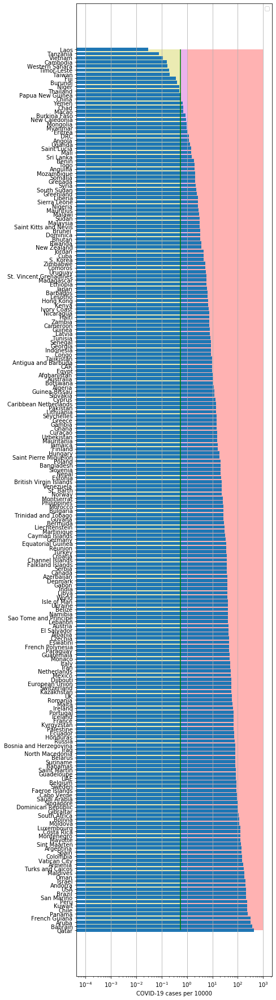

In [2021]:
country, cases = get_cases(df,0.01)
country.values, cases.values
stat_picture(country.values, cases.values, high=35, picname="pictures/coronage0.png")

No handles with labels found to put in legend.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:815: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


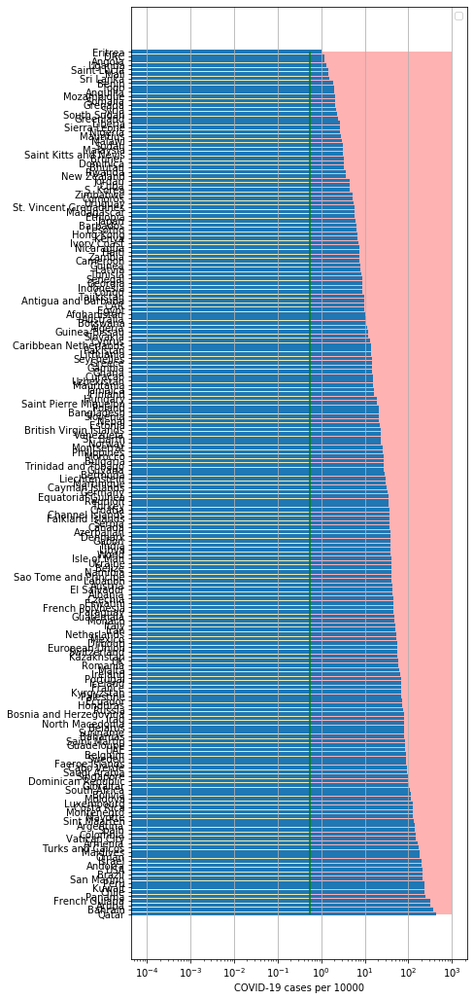

In [2022]:
country, cases = get_cases(df,100.0)
stat_picture(country.values, cases.values, high=20, picname="pictures/coronage1.png")

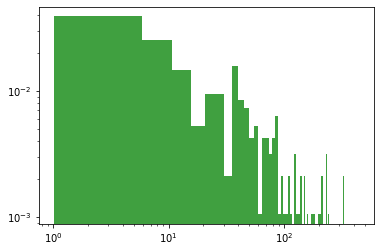

In [2023]:
n, bins, patches = plt.hist(cases, 90, density=True,facecolor='g', alpha=0.75)
plt.yscale("log")
plt.xscale("log")

In [2024]:
dfSP = read_df(pd.DataFrame(),"SP")
dfGB = read_df(pd.DataFrame(),"GB")
dfIT = read_df(pd.DataFrame(),"IT")
dfLT = read_df(pd.DataFrame(),"LT")
dfUkr = read_df(pd.DataFrame(),"Ukr")
dfUS = read_df(pd.DataFrame(),"US")
dfCN = read_df(pd.DataFrame(),"CN")
dfFR = read_df(pd.DataFrame(),"FR")
dfKR = read_df(pd.DataFrame(),"KR")
dfW = read_df(pd.DataFrame(),"World")
dfDK = read_df(pd.DataFrame(),"DK")
dfNG = read_df(pd.DataFrame(),"NG")
dfGR = read_df(pd.DataFrame(),"GR")
dfES = read_df(pd.DataFrame(),"ES")
dfSW = read_df(pd.DataFrame(),"SW")
dfPL = read_df(pd.DataFrame(),"PL")
dfIS = read_df(pd.DataFrame(),"IS")
dfUR = read_df(pd.DataFrame(),"Ukr")
dfSZ = read_df(pd.DataFrame(),"SZ")
dfIN = read_df(pd.DataFrame(),"IN")
#dfKRA = read_df(pd.DataFrame(),"KRA")
dfRS = read_df(pd.DataFrame(),"RS")
dfJP = read_df(pd.DataFrame(),"JP")
dfNL = read_df(pd.DataFrame(),"NL")
dfAT = read_df(pd.DataFrame(),"AT")
dfBG = read_df(pd.DataFrame(),"BG")
dfSG = read_df(pd.DataFrame(),"SG")
dfLV = read_df(pd.DataFrame(),"LV")
dfCA = read_df(pd.DataFrame(),"CA")
dfPT = read_df(pd.DataFrame(),"PT")
dfTR = read_df(pd.DataFrame(),"TR")
dfBZ = read_df(pd.DataFrame(),"BZ")
dfAS = read_df(pd.DataFrame(),"AS")
dfML = read_df(pd.DataFrame(),"ML")
dfZL = read_df(pd.DataFrame(),"ZL")
dfBR = read_df(pd.DataFrame(),"BR")
dfIR = read_df(pd.DataFrame(),"IR")
dfCL = read_df(pd.DataFrame(),"CL")
dfCH = read_df(pd.DataFrame(),"CH")
dfRM = read_df(pd.DataFrame(),"RM")
dfFI = read_df(pd.DataFrame(),"FI")
dfID = read_df(pd.DataFrame(),"ID")
dfED = read_df(pd.DataFrame(),"ED")
dfPH = read_df(pd.DataFrame(),"PH")
#dfPK = read_df(pd.DataFrame(),"PK")
dfLX = read_df(pd.DataFrame(),"LX")
dfTH = read_df(pd.DataFrame(),"TH")
dfIE = read_df(pd.DataFrame(),"IE")
dfMX = read_df(pd.DataFrame(),"MX")
dfPM = read_df(pd.DataFrame(),"PM")
dfPU = read_df(pd.DataFrame(),"PU")
dfSB = read_df(pd.DataFrame(),"SB")
dfAG = read_df(pd.DataFrame(),"AG")
dfCT = read_df(pd.DataFrame(),"CT")
dfEG = read_df(pd.DataFrame(),"EG")
dfSV = read_df(pd.DataFrame(),"SV")
dfMR = read_df(pd.DataFrame(),"MR")
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIC = read_df(pd.DataFrame(),"IC")
dfQR = read_df(pd.DataFrame(),"QR")
dfCB = read_df(pd.DataFrame(),"CB")
dfBL = read_df(pd.DataFrame(),"BL")
dfAG = read_df(pd.DataFrame(),"AR")
dfEU = read_df(pd.DataFrame(),"EU")
dfMT = read_df(pd.DataFrame(),"MT")
dfCP = read_df(pd.DataFrame(),"CP")

SP
           date   cases  active    death
213 2020-09-15  603167       0  30004.0
214 2020-09-16  614360       0  30243.0
215 2020-09-17  625651       0  30405.0
216 2020-09-18  659334       0  30495.0
217 2020-09-19  659334       0  30495.0
GB
           date   cases  active    death
202 2020-09-15  374228       0  41664.0
203 2020-09-16  378219       0  41684.0
204 2020-09-17  381614       0  41705.0
205 2020-09-18  385936       0  41732.0
206 2020-09-19  390358       0  41759.0
IT
           date   cases  active    death
205 2020-09-15  289990   39712  35633.0
206 2020-09-16  291442   40532  35645.0
207 2020-09-17  293025   41413  35658.0
208 2020-09-18  294932   42457  35668.0
209 2020-09-19  296569   43161  35692.0
LT
           date   cases  active  death     tests
190 2020-09-15  3442.0    1230   87.0  706219.0
191 2020-09-16  3504.0    1268   87.0  711108.0
192 2020-09-17  3565.0    1297   87.0  716972.0
193 2020-09-18  3664.0    1380   87.0  722897.0
194 2020-09-19  3744.0  

           date   cases   active   death
192 2020-09-15  272934  60344.0  4732.0
193 2020-09-16  276289  63408.0  4785.0
194 2020-09-17  279851  63408.0  4785.0
195 2020-09-18  283460  68645.0  4930.0
196 2020-09-19  286743  51894.0  4984.0
LX
           date   cases  active  death
192 2020-09-15  7284.0     599  124.0
193 2020-09-16  7394.0     677  124.0
194 2020-09-17  7541.0     776  124.0
195 2020-09-18  7718.0     891  124.0
196 2020-09-19  7804.0     977  124.0
TH
           date   cases  active  death
201 2020-09-15  3490.0   116.0   58.0
202 2020-09-16  3490.5   107.0   58.0
203 2020-09-17  3497.0   111.0   58.0
204 2020-09-18  3500.0   103.0   59.0
205 2020-09-19  3506.0   107.0   59.0
IE
           date   cases   active   death
190 2020-09-15  225030  55000.0  8965.0
191 2020-09-16  228993  55792.0  9100.0
192 2020-09-17  232628  56720.0  9222.0
193 2020-09-18  240687  56889.0  9448.0
194 2020-09-19  244676  57796.0  9553.0
MX
           date   cases    active    death
191 2

In [2025]:
dfBL = dfBL.fillna(0)
dfRM = dfRM.fillna(0)
dfSV = dfSV.fillna(0)
dfCT = dfCT.fillna(0)
#dfAR = dfAR.fillna(0)
dfSB = dfSB.fillna(0)
dfCP = dfCP.fillna(0)
dfID = dfID.fillna(0)
dfAG = dfAG.fillna(0)
dfMX = dfMX.fillna(0)
dfPU = dfPU.fillna(0)
dfIQ = dfIQ.fillna(0)
dfIE = dfIE.fillna(0)
dfPH = dfPH.fillna(0)
dfTH = dfTH.fillna(0)
dfMR = dfMR.fillna(0)
dfCP = dfCP.fillna(0)

In [2026]:
from sklearn.linear_model import LinearRegression
populationSp = dfp[dfp['Country (or dependency)']=='Spain'].Population.tolist()[0]
y = np.log(dfSP['cases'].values*10000./populationSp)
x = np.array(range(dfSP['cases'].size)).reshape((-1, 1))
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)


coefficient of determination: 0.5092190612507538
intercept: 1.3255119431613709
slope: [0.01975435]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:6: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  


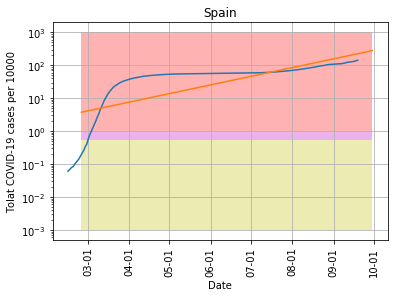

In [2027]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
yc = 0.56
plt.plot(dfSP['date'].values,dfSP['cases']*10000./populationSp)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix = pd.date_range('2020-02-25', '2020-09-30', freq='D')
ss = pd.DataFrame({'date': ix})
y_pred = np.exp(model.intercept_ + model.coef_ * range(len(ix)))
ax.plot(ss['date'].values,y_pred)
plt.xticks(rotation=90)
plt.title('Spain')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaSP.png")
plt.show()

In [2028]:
populationUK = dfp[dfp['Country (or dependency)']=='United Kingdom'].Population.tolist()[0]
model1, r_sql, dfGB1 = linreg(dfGB,populationUK)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.5418425866642433
intercept: -0.5258371061667262
slope: [0.02966171]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:51: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


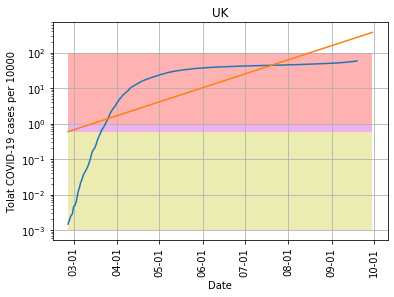

In [2029]:
ss1t = plotpred(dfGB1,populationUK,'2020-02-26', '2020-09-30', "pictures/coronaGB.png", model1, 'UK',100)

In [2030]:
populationIT = dfp[dfp['Country (or dependency)']=='Italy'].Population.tolist()[0]
coefIT = 5.01378751-0.3
yy1 = np.log(coefIT-np.log(dfIT['cases'].values*10000./populationIT))
xx1 = np.array(range(dfIT['cases'].size)).reshape((-1, 1))
model11 = LinearRegression().fit(xx1, yy1)
r_sq1 = model11.score(xx1, yy1)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.6348675507351456
intercept: 1.0369082917657177
slope: [-0.00709374]


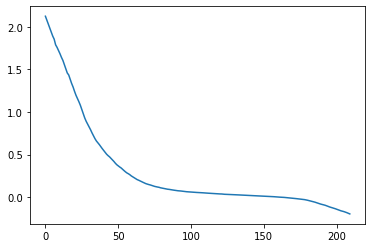

In [2031]:
plt.plot(xx1,yy1)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:5: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  """


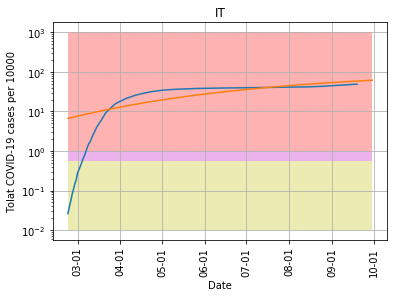

In [2032]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
plt.plot(dfIT['date'].values,dfIT['cases']*10000./populationIT)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix11 = pd.date_range('2020-02-23', '2020-09-30', freq='D')
ss11 = pd.DataFrame({'date': ix11})
y_pred11 = np.exp(coefIT-np.exp(model11.intercept_ + model11.coef_ * range(len(ix11))))
ax.plot(ss11['date'].values,y_pred11)
plt.xticks(rotation=90)
plt.title('IT')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss11['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss11['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss11['date'].values, 1e-2,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
#plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaIT.png")
plt.show()

In [2033]:
cs=y_pred11[-1]/10000.*populationIT

In [2034]:
cs

372746.31782000995

In [2035]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
model1, r_sql, dfLT1 = linreg(dfLT[1:],populationLT)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.4592043593832068
intercept: -0.07584320020261459
slope: [0.0162598]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:51: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


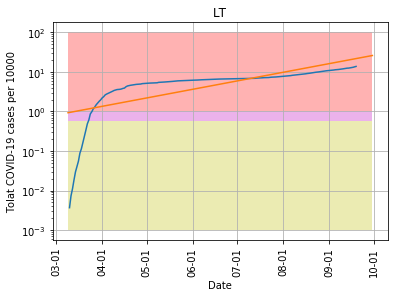

In [2036]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
ss1t = plotpred(dfLT[1:],populationLT,'2020-03-09', '2020-09-30', "pictures/coronaLT.png", model1, 'LT',100)

In [2037]:
populationUKr = dfp[dfp['Country (or dependency)']=='Ukraine'].Population.tolist()[0]
model11, r_sql, dfUkr1 = linreg(dfUkr, populationUKr)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.7081732090715902
intercept: -2.5136125904414772
slope: [0.03829319]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:51: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


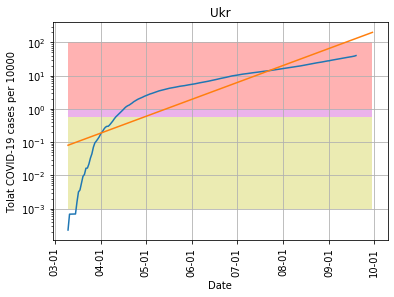

In [2038]:
ss1t1 = plotpred(dfUkr1,populationUKr,'2020-03-10', '2020-09-30', "pictures/coronaUkr.png", model11, 'Ukr',100)

No handles with labels found to put in legend.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  app.launch_new_instance()


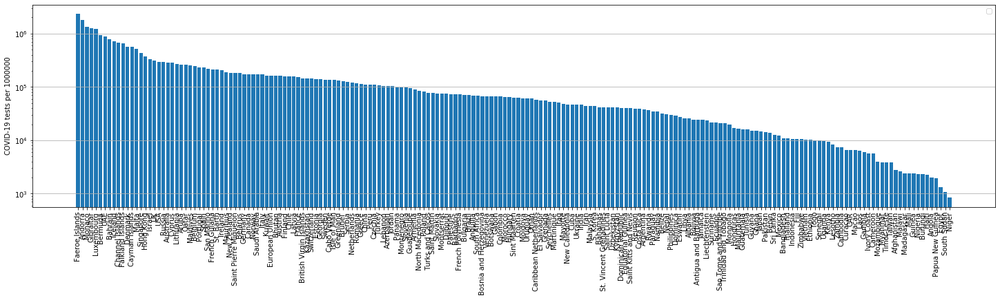

In [2039]:
# Prepare the data
dfTs = dfAll
dfTs = dfTs.sort_values(by=['Testsper1Mpop'], ascending=False)
dfTs = dfTs[dfTs['Testsper1Mpop']>0]
x = dfTs['Country']
y = dfTs['Testsper1Mpop']
fig = plt.figure( figsize=(25, 6))
fig.subplots_adjust(bottom=0.2)
# Plot the data
plt.bar(x, y)

plt.xticks(rotation=90)
plt.ylabel('COVID-19 tests per 1000000')
# Add a legend
plt.legend()
ax = plt.axes() 
#ax.fill_between(x, 1,10, facecolor='red', alpha=0.3)
yc = 0.56
#ax.fill_between(x, yc,1, facecolor='m', alpha=0.3)
#ax.fill_between(x, 1e-4,yc, facecolor='y', alpha=0.3)
#plt.hlines(yc, 0, len(df)-1, colors='g', linestyles='solid')
#plt.ylim([1e-4,10])
ax.yaxis.grid() # horizontal lines
#ax.xaxis.grid() # vertical lines
plt.yscale("log")
# Show the plot
plt.savefig("pictures/coronaTests.png")
plt.show()

In [2040]:
populationUS= dfp[dfp['Country (or dependency)']=='United States'].Population.tolist()[0]
model11, r_sql, dfUS1 = linreg(dfUS, populationUS)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.6315308628381195
intercept: -0.13738591953829626
slope: [0.03443244]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:51: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


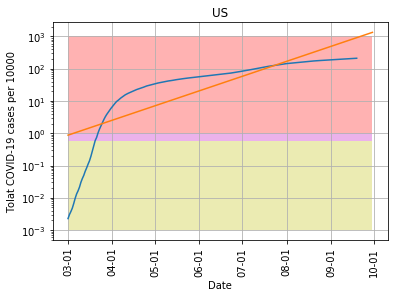

In [2041]:
ss1t = plotpred(dfUS1,populationUS,'2020-03-01', '2020-09-30', "pictures/coronaUS.png", model11, 'US',1000)

In [2042]:
dfAll[dfAll["Country"]=="Latvia"]
dfAll.fillna(0, inplace=True)

North America
            Country         0
229  European Union  0.058629


Text(0.5, 1.0, 'Death rate')

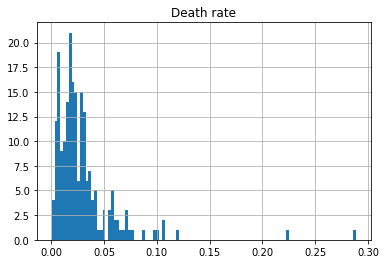

In [2043]:
dfT1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
print(dfTT.Country[0])
print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
hist = dfTTh[dfTTh[0]>0].hist(bins=9*12)
plt.title("Death rate")
#plt.xlim([0,0.15])

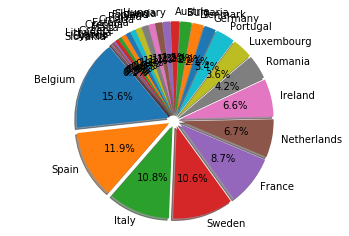

In [2044]:
cLst = countriesEU
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
#dfD1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["Deathsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfTTh = dfTT.sort_values(by=["Deathsper1Mpop"], ascending=False)
dfTTh.rename(columns={0: "DeathRate"})
#hist = dfTTh.hist(bins=9*16)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])
#plt.show()
#import matplotlib.pyplot as plt

labels = dfTTh.Country.tolist()#'apple', 'banana', 'cherry', 'durian', 'elderberries', 'figs', 'grapes'
sizes = dfTTh.Deathsper1Mpop.values#[32, 20, 15, 10, 10, 8, 5]

p = plt.pie(sizes, labels=labels, explode=(.07,)*len(sizes), autopct='%1.1f%%', startangle=130, shadow=True)
plt.axis('equal')

            
plt.show()

In [2045]:
dfTTh.head()

,Country,Deathsper1Mpop
41,Belgium,857.0
15,Spain,652.0
26,Italy,591.0
46,Sweden,580.0
18,France,479.0


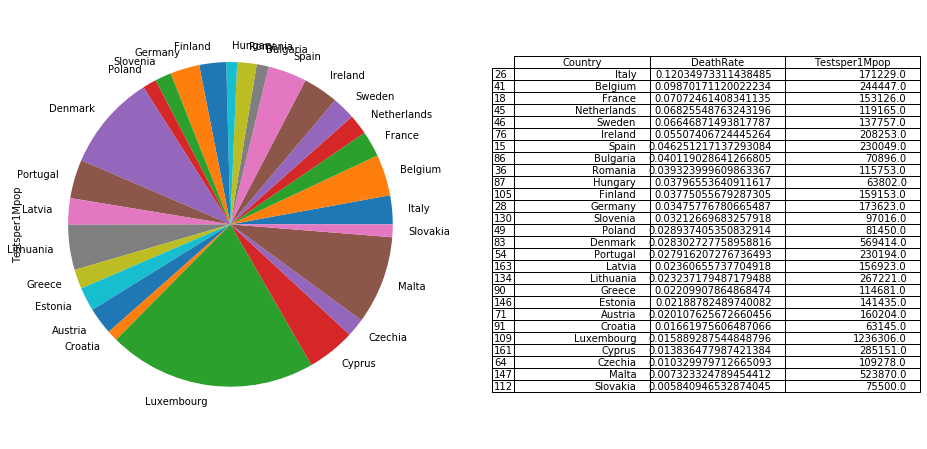

In [2046]:
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
#dfTTh = dfTT.sort_values(by=["Testsper1Mpop"], ascending=False)
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
#import matplotlib.pyplot as plt
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfTTh.plot.pie(y=["Testsper1Mpop"],ax=ax1,labels=dfTTh['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfTTh, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate2.png")
plt.show()

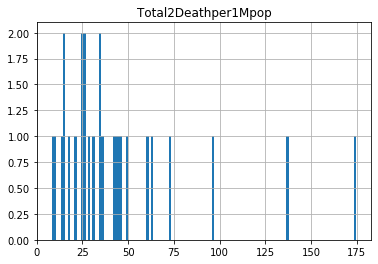

In [2047]:
dfD1 = dfAll[dfAll['Country'].isin(cLst)]#[dfAll["Total Cases"]>0]
dfDD = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"],dfD1["Deathsper1Mpop"]], axis=1)
dfDD2 = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"]/dfD1["Testsper1Mpop"]], axis=1)
dfDD = dfDD[dfDD["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfDD1 = pd.concat([dfDD["Country"],dfDD["TotCasesper1Mpop"]/dfDD["Deathsper1Mpop"]], axis=1)
dfDDh = dfDD1.sort_values(by=[0], ascending=False)
dfDDh=dfDDh.rename(columns={0:"Total2Deathper1Mpop"})
dfDDh2=dfDD2.rename(columns={0:"Cases2Testsper1Mpop"})
hist = dfDDh.hist(bins=9*15)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])

In [2048]:
dfDD.head()

,Country,TotCasesper1Mpop,Deathsper1Mpop
15,Spain,14101.0,652.0
18,France,6771.0,479.0
26,Italy,4907.0,591.0
28,Germany,3248.0,113.0
36,Romania,5871.0,231.0


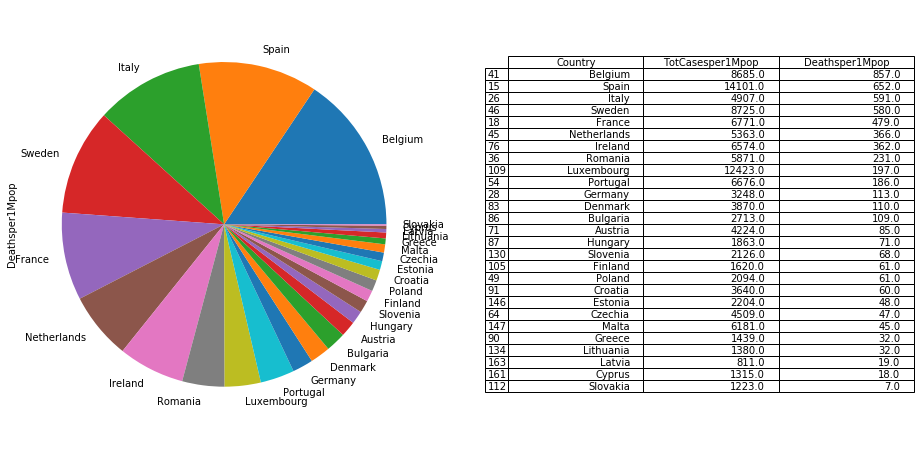

In [2049]:
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDD = dfDD.sort_values(by=['Deathsper1Mpop'], ascending=False)
dfDD.plot.pie(y='Deathsper1Mpop',ax=ax1,labels=dfDD['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDD, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate1.png")
plt.show()

In [2050]:
dfAll.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,0.0,North America,8309552,7366.0,298209.0,498.0,5171211.0,"+5,301",2840132,17745.0,0.0,0.0,0.0,0.0,0,North America,\n,0,0
1,0.0,Asia,9373052,24549.0,175839.0,452.0,7662188.0,"+33,219",1535025,19663.0,0.0,0.0,0.0,0.0,0,Asia,\n,0,0
2,0.0,South America,7490758,419.0,237143.0,36.0,6227260.0,575,1026355,15475.0,0.0,0.0,0.0,0.0,0,South America,\n,0,0
3,0.0,Europe,4413290,14958.0,216084.0,191.0,2380679.0,"+5,738",1816527,7040.0,0.0,0.0,0.0,0.0,0,Europe,\n,0,0
4,0.0,Africa,1406759,786.0,33900.0,21.0,1153747.0,108,219112,1455.0,0.0,0.0,0.0,0.0,0,Africa,\n,0,0


In [2051]:
dfDDh2.head()

,Country,Cases2Testsper1Mpop
15,Spain,0.061296
18,France,0.044218
26,Italy,0.028658
28,Germany,0.018707
36,Romania,0.050720


In [2052]:
dfDDh2 = dfDDh2.sort_values(by=["Cases2Testsper1Mpop"], ascending=False)

     Country  Cases2Testsper1Mpop
      Sweden             0.063336
       Spain             0.061296
     Croatia             0.057645
     Romania             0.050720
 Netherlands             0.045005
      France             0.044218
     Czechia             0.041262
    Bulgaria             0.038267
     Belgium             0.035529
     Ireland             0.031567
     Hungary             0.029200
    Portugal             0.029002
       Italy             0.028658
     Austria             0.026366
      Poland             0.025709
    Slovenia             0.021914
     Germany             0.018707
    Slovakia             0.016199
     Estonia             0.015583
      Greece             0.012548
       Malta             0.011799
     Finland             0.010179
  Luxembourg             0.010048
     Denmark             0.006796
      Latvia             0.005168
   Lithuania             0.005164
      Cyprus             0.004612


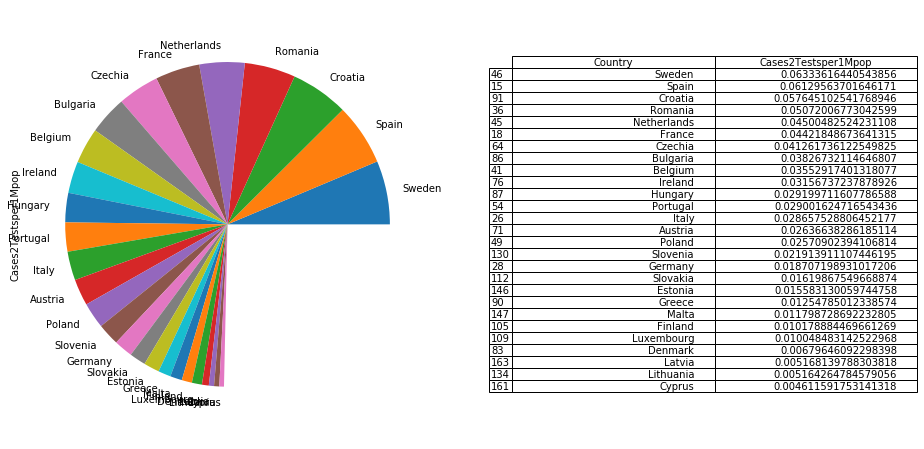

In [2053]:
print (dfDDh2[dfDDh2["Cases2Testsper1Mpop"]<1000].to_string(index=False))
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDDh2.plot.pie(y='Cases2Testsper1Mpop',ax=ax1,labels=dfDDh2['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDDh2, loc='center')
#tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.show()

In [2054]:
dfT1 = dfAll
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
dfTT[dfTT[0]>=0.000001].sort_values(by=[0], ascending=True)
#dfTT[dfTT.Country=="France"]

,Country,0,Testsper1Mpop
59,Singapore,0.000469,426259.0
166,French Polynesia,0.001574,72828.0
35,Qatar,0.001702,257880.0
180,Burundi,0.002114,2326.0
103,Maldives,0.003420,255454.0
...,...,...,...
13,Mexico,0.105541,12229.0
20,UK,0.106976,314402.0
26,Italy,0.120350,171229.0
219,MS Zaandam,0.222222,0.0


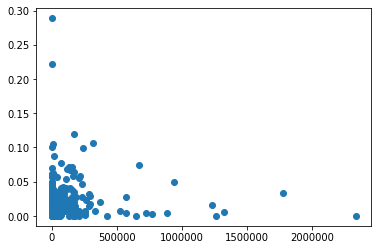

In [2055]:
plt.plot(dfTTh["Testsper1Mpop"],dfTTh['DeathRate'],'o')

/usr/local/lib/python3.7/site-packages/matplotlib/patches.py:715: RuntimeWarning: invalid value encountered in double_scalars
  self._x1 = self._x0 + self._width
/usr/local/lib/python3.7/site-packages/matplotlib/projections/polar.py:55: RuntimeWarning: invalid value encountered in greater_equal
  r = np.where(r >= 0, r, np.nan)


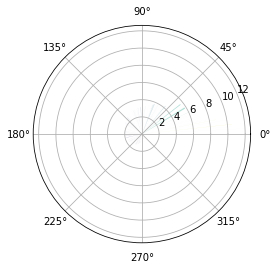

In [2056]:
import numpy as np
import matplotlib.pyplot as plt


# Fixing random state for reproducibility
np.random.seed(19680801)

# Compute pie slices
N = len(dfTTh)
theta = np.linspace(0.0, 2*np.pi, N, endpoint=False)
radii = 100 * dfTTh['DeathRate']
width = 2*np.pi* 3.5/ dfTTh["Testsper1Mpop"]
colors = plt.cm.viridis(radii / 10.)

ax = plt.subplot(111, projection='polar')
ax.bar(theta, radii, width=width, bottom=0.0, color=colors, alpha=0.35)

plt.show()

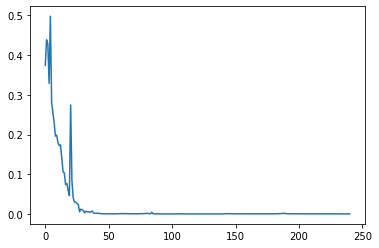

In [2057]:
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)))

In [2058]:
#np.diff(np.log(dfCN["cases"].values))

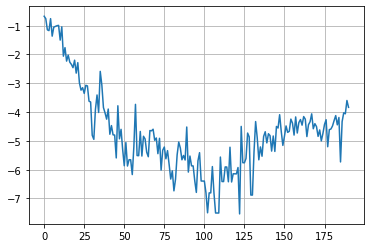

In [2059]:
plt.plot(range(len(dfLT["cases"].values[3:])-1),np.log(np.diff(np.log(dfLT["cases"].values[3:]))))
plt.grid()

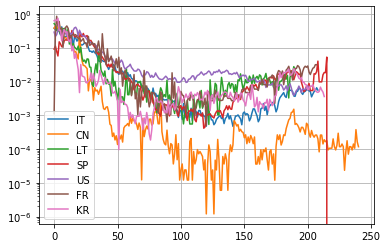

In [2060]:
plt.plot(range(len(dfIT["cases"].values)-1),np.diff(np.log(dfIT["cases"].values))[:],label='IT')
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)),label='CN')
plt.plot(range(len(dfLT["cases"].values)-4),np.diff(np.log(dfLT["cases"].values))[3:],label='LT')
plt.plot(range(len(dfSP["cases"].values)-1),np.diff(np.log(dfSP["cases"].values)),label='SP')
plt.plot(range(len(dfUS["cases"].values)-1),np.diff(np.log(dfUS["cases"].values)),label='US')
plt.plot(range(len(dfFR["cases"].values)-10),np.diff(np.log(dfFR["cases"].values))[9:],label='FR')
plt.plot(range(len(dfKR["cases"].values)-4),np.diff(np.log(dfKR["cases"].values))[3:],label='KR')
plt.yscale('log')
plt.grid()
plt.legend()
plt.show()

202 202
coefficient of determination: 0.7081301112956166
intercept: -12.472918945433412
slope: [-0.05083697]


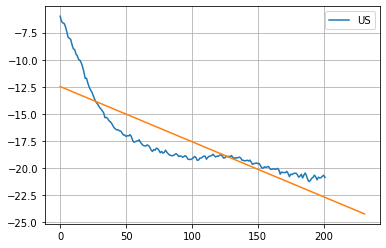

In [2061]:
y = np.log(np.diff(dfUS["cases"].values)[:]/dfUS["cases"].values[1:]**2)
x = np.array(range(len(dfUS["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='US')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+30) 
plt.plot(range(len(x)+30),y_pred11)
plt.grid()
plt.legend()
plt.savefig("pictures/logdiffUS.png")
plt.show()

In [2062]:
#np.diff(dfIT["cases"])

209 209
coefficient of determination: 0.5600373576261477
intercept: -13.086799988007321
slope: [-0.03738445]


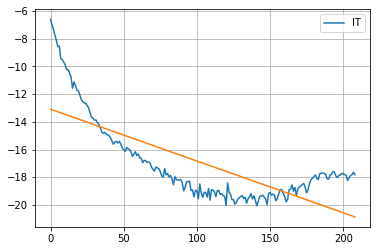

In [2063]:
y = np.log(np.diff(dfIT["cases"].values)[:]/dfIT["cases"].values[1:]**2)
x = np.array(range(len(dfIT["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='IT')
y_pred12 = model.intercept_ + model.coef_ * range(len(x)) 
plt.plot(x,y_pred12)
plt.grid()
plt.legend()
plt.show()

In [2064]:
#model11.coef_

In [2065]:
#np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)

191 191
coefficient of determination: 0.8756154030170374
intercept: -16.362415052874844
slope: [-0.03324367]


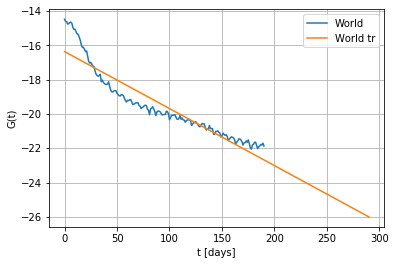

In [2066]:
y = np.log(np.diff(dfW["cases"].values)[50:]/dfW["cases"].values[51:]**2)
x = np.array(range(len(dfW["cases"].values[50:])-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='World')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+100)
plt.plot(range(len(x)+100),y_pred11,label='World tr')
plt.legend()
plt.xlabel('t [days]')
plt.ylabel('G(t)')
plt.grid()
plt.savefig("pictures/logdifflogcoronaW.png")

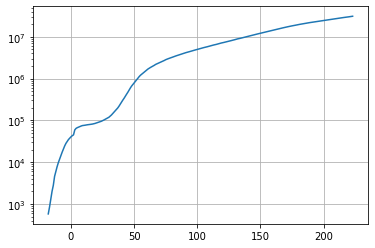

In [2067]:
waveform_1 = dfW['cases'].values
waveform_A = dfW['active'].values
t = np.arange(-18,len(waveform_1)-18)
plt.plot(t, waveform_1) 
plt.yscale("log")
plt.grid()
plt.show()

In [2068]:
dfW['cases'].values

array([     580,      845,     1317,     2015,     2800,     4581,
           6058,     7813,     9823,    11950,    14553,    17391,
          20630,    24545,    28266,    31439,    34876,    37552,
          40553,    43099,    45134,    59287,    64438,    67100,
          69197,    71329,    73332,    75184,    75700,    76677,
          77673,    78651,    79205,    80087,    80828,    81820,
          83112,    84615,    86604,    88585,    90443,    93016,
          95314,    98425,   102050,   106099,   109991,   114381,
         118948,   126214,   134576,   145483,   156653,   169593,
         182490,   198238,   218822,   244933,   275597,   305036,
         337489,   378860,   422629,   471035,   531864,   596366,
         663079,   723279,   784738,   858355,   936237,  1016330,
        1117928,  1203058,  1274578,  1347566,  1432869,  1519195,
        1605277,  1700004,  1780713,  1853505,  1925330,  2000065,
        2084633,  2183942,  2252370,  2332650,  2407467,  2482

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in true_divide
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


[ 9.83074140e+07  2.83792145e-01 -1.92413839e+02  2.87359589e-02]


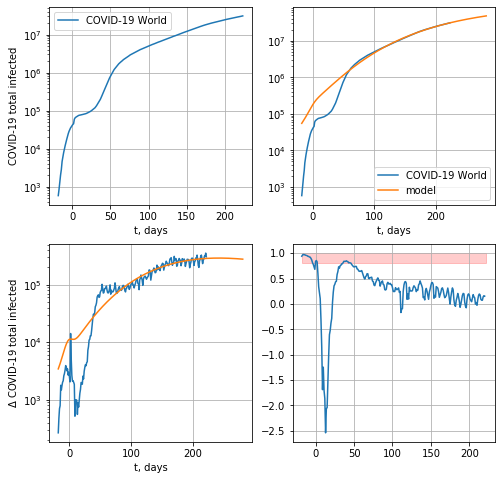

270594.7507866208


In [2069]:
def model(t, coeffs):
    coeffsCN = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
    #coeffsCN = [2.06174475e+06, 1.67277852e-01, 5.36255447e+01]
    return coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]) + coeffsCN[0]/(1 + np.exp( - coeffsCN[1] * (t - coeffsCN[2])))

x0 = np.array([2.06174475e+06, 1.67277852e-01, 5.36255447e+01, 0.9 ], dtype=float)
#x0 = np.array([8.08757112e+04,  2.24114193e-01, -6.94900467e-01 ], dtype=float)
def residuals(coeffs, y, t):
    return y - model(t, coeffs)
from scipy.optimize import leastsq
x, flag = leastsq(residuals, x0, args=(waveform_1, t))
print(x)
tt = np.arange(-18,len(waveform_1)-18+59)
fig, ((ax3,ax1),(ax2,ax4)) = plt.subplots(2,2,figsize=(8,8), sharex=False, sharey=False)
ax3.plot(t, waveform_1) 
ax3.legend(['COVID-19 World']) 
ax3.set_xlabel('t, days')
ax3.set_yscale("log")
ax3.set_ylabel(r'COVID-19 total infected')
ax3.grid()
ax1.plot(t, waveform_1, tt, model(tt, x)) 
ax1.legend(['COVID-19 World', 'model']) 
ax1.set_xlabel('t, days')
ax1.set_yscale("log")
ax1.grid()
ax2.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(model(tt, x)))
ax2.set_ylabel(r'$\Delta$ COVID-19 total infected')
ax2.set_yscale("log")
ax2.grid()
ax2.set_xlabel('t, days')
z = np.diff(moving_average(waveform_A, n=3) )/np.diff(moving_average(waveform_1, n=3))
ax4.plot(t[:-3],z)
#ax4.axhline(y=2.2587741081036339/2, color='r')
ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
#ax4.set_yscale("log")
ax4.grid()
plt.savefig("pictures/covidworld.png")

plt.show()
print(np.std(residuals(x, waveform_1, t)))
#expPopWorld = x[0]
expPopWorld = 2.67152730e+06

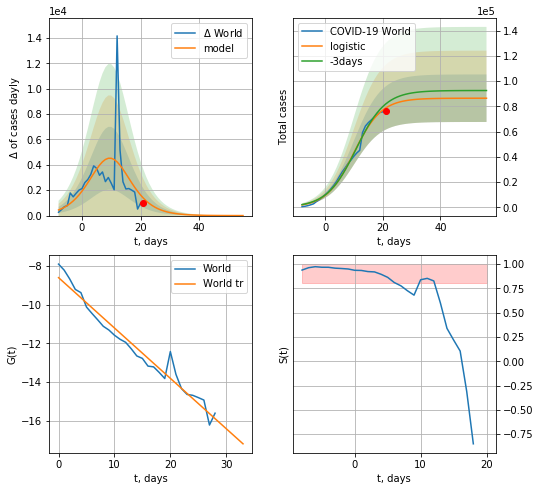

World data at: 2020-09-19
+3 day model MAPE: 0.04256770161128604
model: logistic
coeffs:  [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.2178111789766563
forecast at the end of period: +35 days
	 deltaDaycases:  1
	 total cases:  86467 ± 18833
	 total death:  2681 ± 1751
trend coefficient of determination: 0.960820
 intercept: -8.598458
 slope: -0.260482


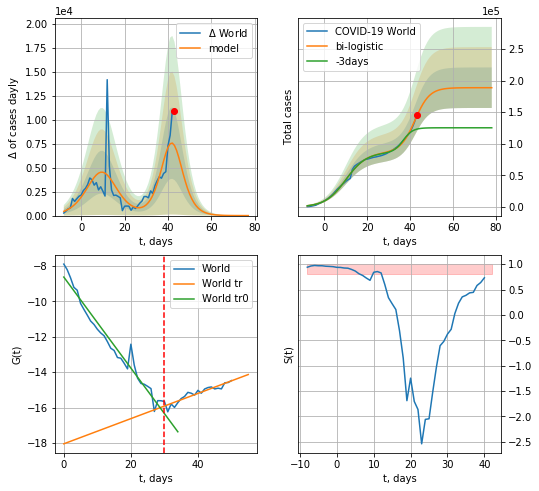

World data at: 2020-09-19
+3 day model MAPE: 0.21572977405755475
model: bi-logistic
coeffs:  [1.02227620e+05 2.95650803e-01 4.22367007e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.16992860967254475
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  188698 ± 32065
	 total death:  5851 ± 2982
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend coefficient of determination: 0.868835
 intercept: -18.049568
 slope: 0.071157


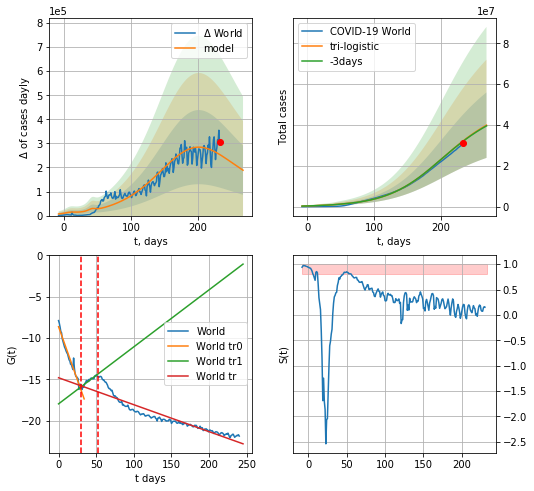

World data at: 2020-09-19
+3 day model MAPE: 0.004848245119542644
model: tri-logistic
coeffs:  [4.20802536e+07 2.51194705e-02 1.96160786e+02] [8.64735804e+04 2.09600360e-01 9.98515269e+00 1.02227620e+05
 2.95650803e-01 4.22367007e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.40197171563508877
forecast at the end of period: +35 days
	 deltaDaycases:  188549
	 total cases:  39909738 ± 16042586
	 total death:  1237598 ± 1492438
tri-logistic approximation splitting points: 30,52
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend1 coefficient of determination: 0.872494
 intercept: -17.970431
 slope: 0.068998
trend coefficient of determination: 0.876815
 intercept: -14.810828
 slope: -0.032619


In [2071]:
vL = 30
T18 = 30
x = forecast("World",dfW[:vL],d1,7*T18-dT,1.0,False)
xx = forecast2("World",dfW[:52],d1,7*T18-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("World",dfW,d1,7*T18-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,52])

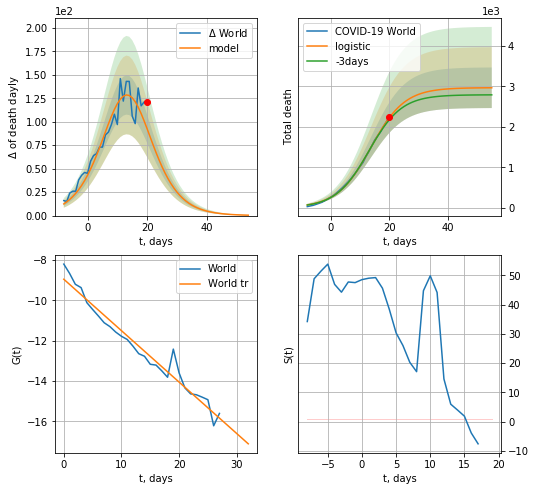

World data at: 2020-09-19
+3 day model MAPE: 0.027312195038559757
model: logistic
coeffs:  [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.16928081921473714
forecast at the end of period: +35 days
	 total death:  2967 ± 502
trend coefficient of determination: 0.959176
 intercept: -8.958870
 slope: -0.254930


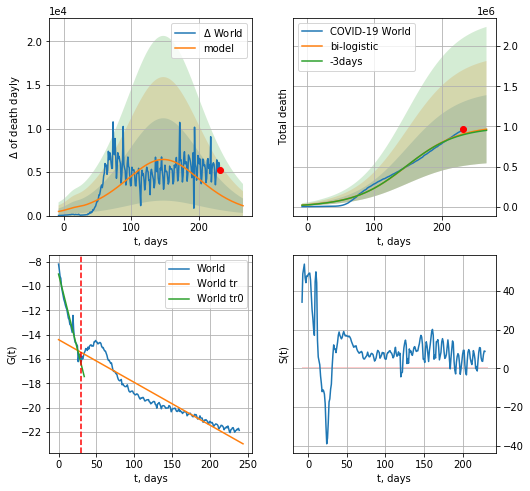

World data at: 2020-09-19
+3 day model MAPE: 0.010696050680846387
model: bi-logistic
coeffs:  [1.00752506e+06 2.55995952e-02 1.48074664e+02] [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.4407577672834541
forecast at the end of period: +35 days
	 deltaDaydeath:  1132
	 total death:  964694 ± 425196
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.960969
 intercept: -9.026339
 slope: -0.247583
trend coefficient of determination: 0.898526
 intercept: -14.413785
 slope: -0.035074


In [2072]:
vL = 30
vL1=52
x = forecast("World",dfW[1:vL],d1,7*T18-dT,1.0,False,cases='death')
xx = forecast2("World",dfW[1:],d1,7*T18-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("World",dfW,d1,7*20-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

In [2073]:
#vL = 30
#x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
#xx = forecast2("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.7],vL=vL)
#trend(dfW,"W",10)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


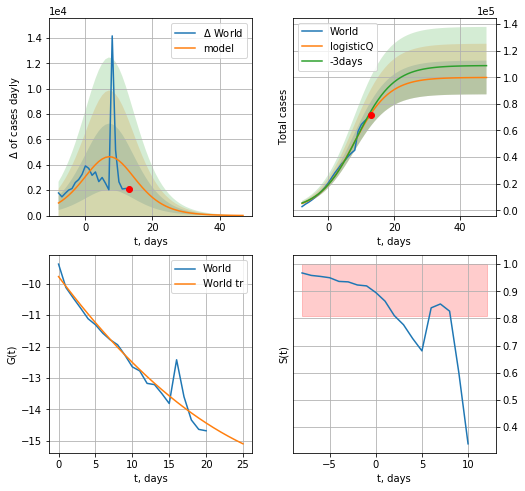

World data at: 2020-09-19
+3 day model MAPE: 0.031856
model: logisticQ
coeffs: [ 9.98643061e+04  1.79654926e-05  7.63889443e+00 -1.03374511e+04]
rational stdev: 0.126959
forecast at the end of period: +35 days
	 deltaDaycases: 11
	 total cases: 99810 ± 12671
	 total death: 3095 ± 1178
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


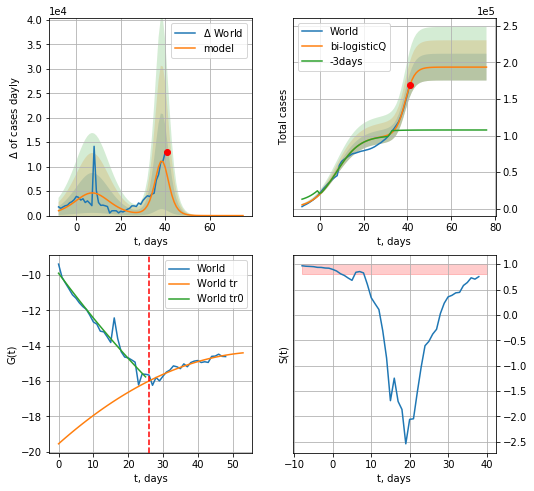

World data at: 2020-09-19
+3 day model MAPE: 0.635592
model: bi-logisticQ
coeffs: [ 9.37621522e+04  2.37764402e-05  3.89555041e+01 -2.00834102e+04]
rational stdev: 0.094698
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 193626 ± 18336
	 total death: 6004 ± 1705
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.893677
 intercept_: -19.558019139425994
 coeffs_: [ 0.          0.17538587 -0.00147405]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


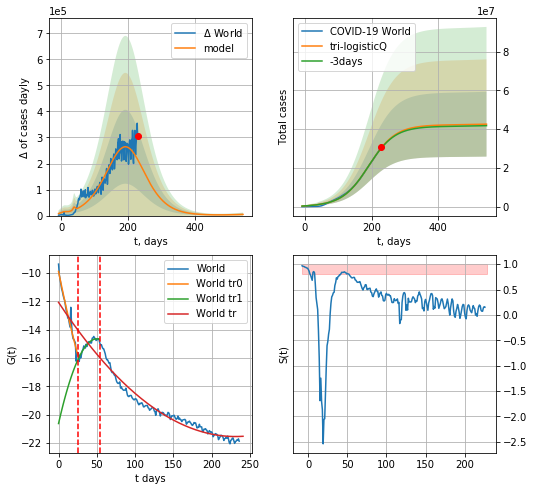

World data at: 2020-09-19
+3 day model MAPE: 0.006224
model: tri-logisticQ
coeffs: [ 4.20204032e+07  2.20844745e-07  1.92063610e+02 -1.13705341e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.393246
forecast at the end of period: +315 days
	 deltaDaycases: 4532
	 total cases: 42565732 ± 16738824
	 total death: 1319961 ± 1557210
tri-logisticQ approximation splitting points: 26,54
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.900515
 intercept_: -20.622215746086294
 coeffs_: [ 0.          0.23801537 -0.00236922]
trend coefficient of determination: 0.955995
 intercept_: -12.07296831510946
 coeffs_: [ 0.         -0.08198033  0.00017748]


In [2074]:
vL=30 - 4
vL1=59 - 5
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
x = forecastRRR("World",dfW[4:vL],d1,7*T18-dT,1.0,False)
xx = forecast2RRR("World",dfW[4:vL1],d1,7*T18-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*70-dT, xx, shift=1.,addpred=True,xcoef=koreaCoeffs,vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


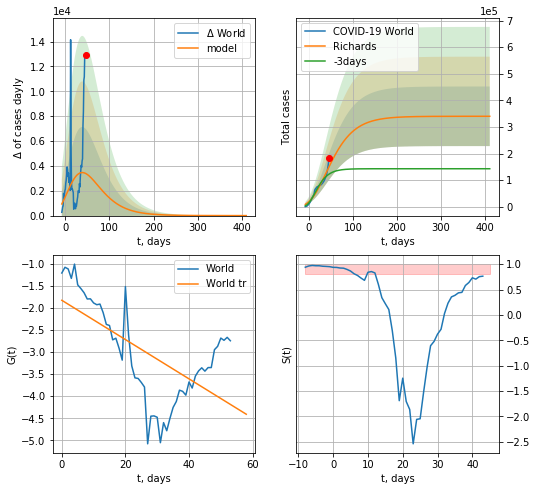

World data at: 2020-09-19
+3 day model MAPE: 0.241623
model: Richards
coeffs: [ 3.40076103e+05  3.50838629e+00 -1.35190892e+02  7.92527881e-03]
rational stdev: 0.329278
forecast at the end of period: +365 days
	 deltaDaycases: 0
	 total cases: 340065 ± 111975
	 total death: 10545 ± 10416
trend coefficient of determination: 0.389869
 intercept: -1.829859
 slope: -0.044449


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


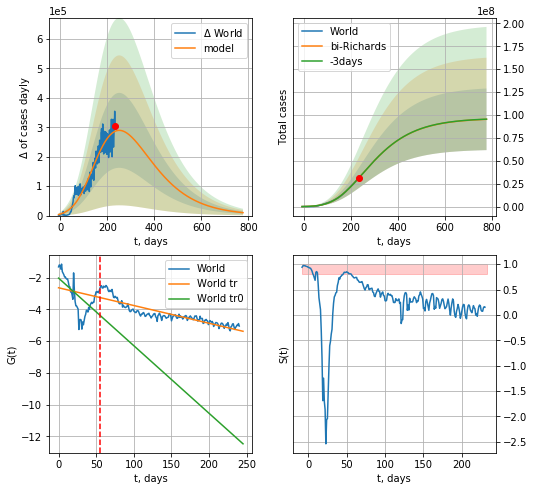

World data at: 2020-09-19
+3 day model MAPE: 0.000269
model: bi-Richards
coeffs: [ 9.61370265e+07  3.28369858e-01 -1.92828167e+02  2.52538344e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.352851
forecast at the end of period: +545 days
	 deltaDaycases: 9986
	 total cases: 95271274 ± 33616600
	 total death: 2954357 ± 3127346
bi-Richards approximation splitting point: 55
trend coefficient of determination: 0.365896
 intercept: -2.037512
 slope: -0.042546
trend coefficient of determination: 0.786842
 intercept: -2.645668
 slope: -0.011168


In [2075]:
vL = 55
x = forecastRR("World",dfW[:vL],d1,60*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[:],d1,80*9-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

242


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


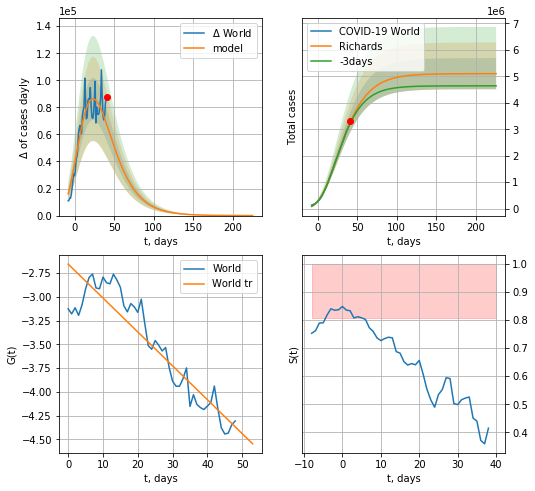

World data at: 2020-09-19
+3 day model MAPE: 0.014871
model: Richards
coeffs: [ 5.10253376e+06  1.04389323e+00 -4.20529569e+01  4.49999517e-02]
rational stdev: 0.115528
forecast at the end of period: +185 days
	 deltaDaycases: 18
	 total cases: 5102148 ± 589439
	 total death: 158217 ± 54835
trend coefficient of determination: 0.854894
 intercept: -2.655671
 slope: -0.035657


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


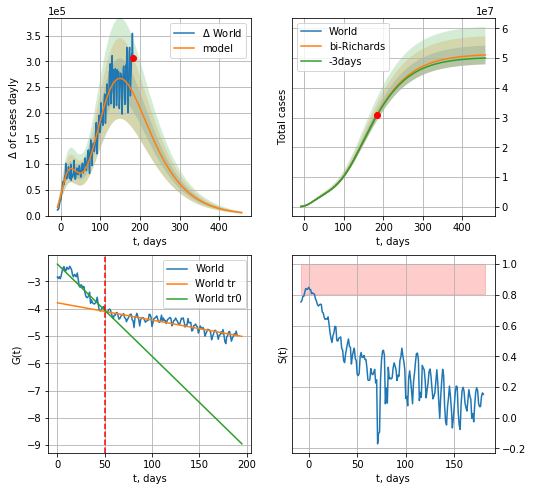

World data at: 2020-09-19
+3 day model MAPE: 0.003974
model: bi-Richards
coeffs: [ 4.62879521e+07  7.61701661e-01 -9.46604462e+01  2.07418793e-02]
rational stdev: 0.061546
forecast at the end of period: +275 days
	 deltaDaycases: 5690
	 total cases: 51031702 ± 3140773
	 total death: 1582490 ± 292185
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.844626
 intercept: -2.363186
 slope: -0.033780
trend coefficient of determination: 0.788242
 intercept: -3.781619
 slope: -0.006309


In [2076]:
print (len(dfW))
vL = 100
x = forecastRR("World",dfW[50:vL],d1,40*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[50:],d1,50*9-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-50)
#x = forecastQR("World",dfW[50:],d1,30*9-dT,1.0,addpred=False)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


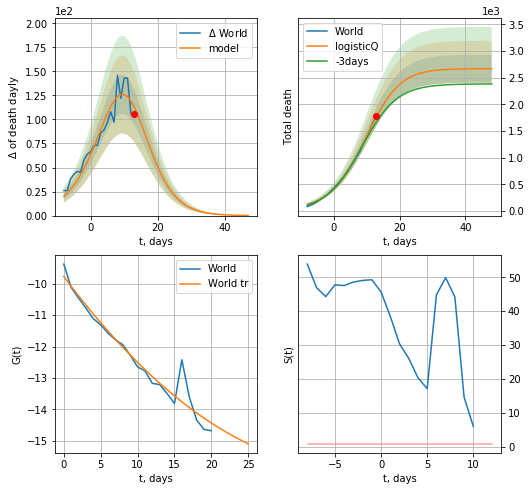

World data at: 2020-09-19
+3 day model MAPE: 0.067194
model: logisticQ
coeffs: [ 2.67018329e+03  8.28113131e-04  9.49649422e+00 -2.18461064e+02]
rational stdev: 0.098000
forecast at the end of period: +35 days
	 total death: 2669 ± 261
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


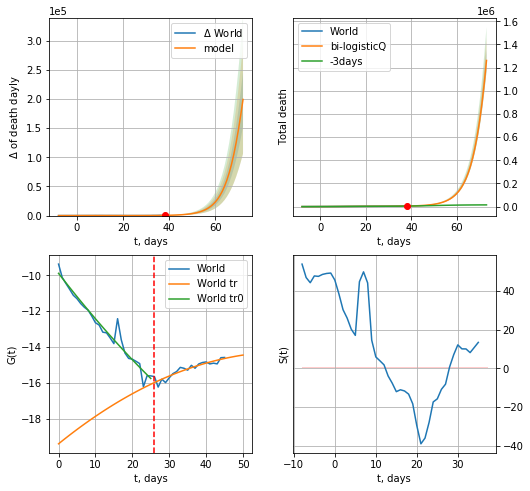

World data at: 2020-09-19
+3 day model MAPE: 0.105641
model: bi-logisticQ
coeffs: [ 6.44010385e+06  6.89934025e-04  7.95796325e+01 -2.38740330e+02]
rational stdev: 0.076590
forecast at the end of period: +35 days
	 total death: 1261215 ± 96596
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.866834
 intercept_: -19.41123113056416
 coeffs_: [ 0.          0.16686573 -0.0013545 ]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:477: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


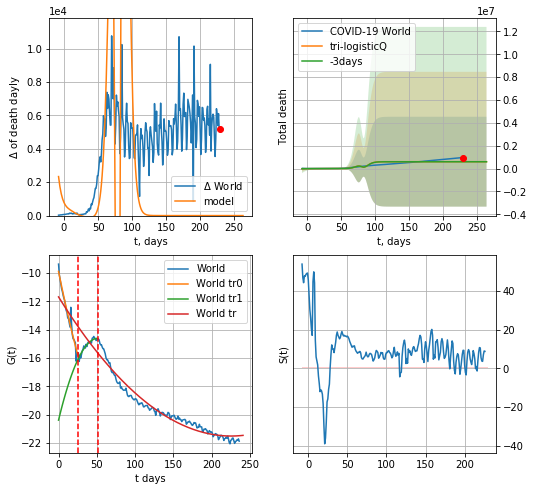

World data at: 2020-09-19
+3 day model MAPE: 0.013320
model: tri-logisticQ
coeffs: [-5.84143980e+06  2.17531985e-03 -3.78644832e+01  7.92258908e+01]
rational stdev: 6.539531
forecast at the end of period: +35 days
	 total death: 601334 ± 3932443
tri-logisticQ approximation splitting points: 26,51
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.890965
 intercept_: -20.382525077358043
 coeffs_: [ 0.          0.22422642 -0.00217733]
trend coefficient of determination: 0.955526
 intercept_: -11.689343942184632
 coeffs_: [ 0.         -0.08708899  0.00019317]


In [2077]:
vL=30 - 4
vL1=51
x = forecastRRR("World",dfW[4:vL],d1,7*T18-dT,1.0,False,cases='death')
xx = forecast2RRR("World",dfW[4:vL1],d1,7*T18-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*T18-dT, xx, shift=1.,addpred=False,xcoef=[.35,.5,4.,1.],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


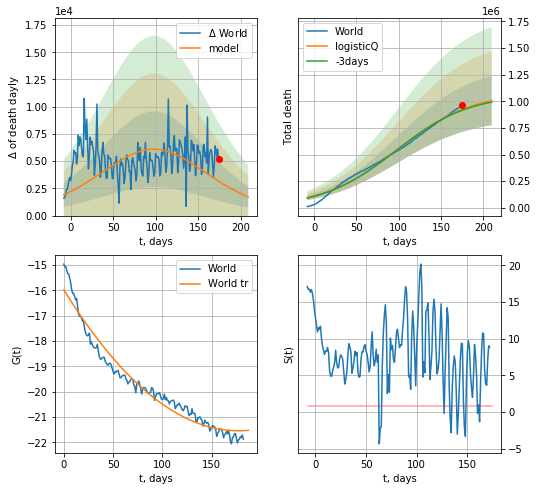

World data at: 2020-09-19
+3 day model MAPE: 0.008971
model: logisticQ
coeffs: [ 1.08808244e+06  5.10183013e-07  9.81678997e+01 -4.38407170e+04]
rational stdev: 0.229182
forecast at the end of period: +35 days
	 total death: 1006551 ± 230683
trend coefficient of determination: 0.955995
 intercept_: -15.982319872467404
 coeffs_: [ 0.         -0.06281481  0.00017749]


In [2078]:
x = forecastRRR("World",dfW[58:],d1,7*T18-dT,1.0,False,cases='death')

In [2079]:
#trend(dfSP,'SP',10)

In [2080]:
#vL = len(dfSP[:])-16-dT
#x = forecast('Spain',dfSP[:vL],d1,30-dT,1.0)
#xx = forecast2('Spain',dfSP,d1,7*6-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.8],vL=vL)

SP
           date   cases  active    death
213 2020-09-15  603167       0  30004.0
214 2020-09-16  614360       0  30243.0
215 2020-09-17  625651       0  30405.0
216 2020-09-18  659334       0  30495.0
217 2020-09-19  659334       0  30495.0


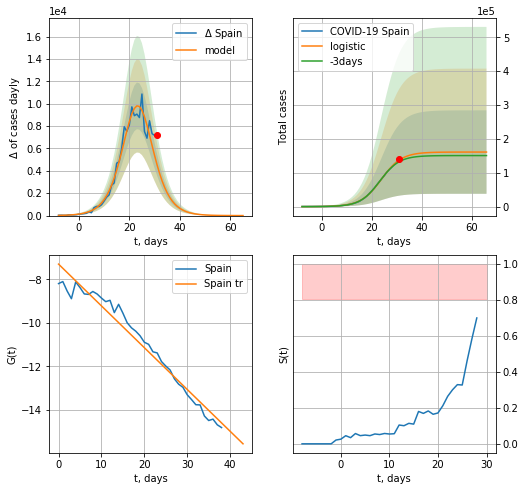

Spain data at: 2020-09-19
+3 day model MAPE: 0.04065647450118455
model: logistic
coeffs:  [1.61048783e+05 2.44209245e-01 2.38061166e+01]
rational stdev:  0.7646314126726975
forecast at the end of period: +35 days
	 deltaDaycases:  1
	 total cases:  161043 ± 123138
	 total death:  7448 ± 17084
trend coefficient of determination: 0.963842
 intercept: -7.302330
 slope: -0.192029
Exception occurs


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:485: RuntimeWarning: divide by zero encountered in log


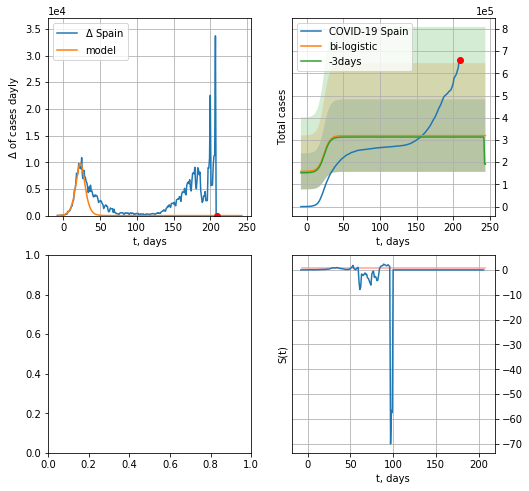

In [2081]:
try:
    dfSP = read_df(pd.DataFrame(),"SP")
    vL = 40#len(dfSP[:])-7-dT
    x = forecast('Spain',dfSP[:vL],d1,7*T18-dT,1.0,cases='cases')
    xx = forecast2('Spain',dfSP[:],d1,7*T18-dT,x,1.0,addpred=True,xcoef=[.25,1.,1.6],vL=vL,cases='cases')
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: divide by zero encountered in true_divide


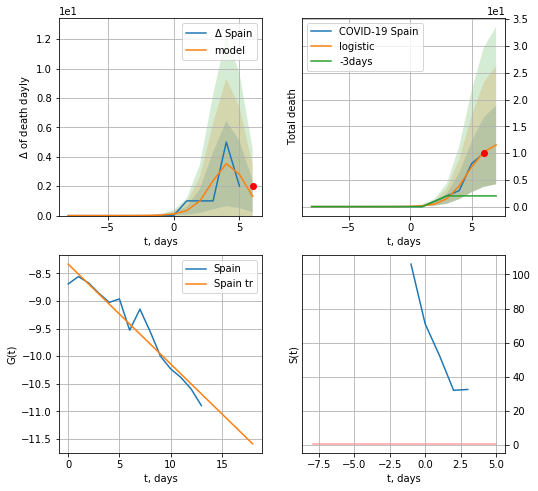

Spain data at: 2020-09-18
+3 day model MAPE: 4.756036700963932
model: logistic
coeffs:  [12.18291976  1.20295815  4.63698223]
rational stdev:  0.6384450788145528
forecast at the end of period: +1 days
	 total death:  11 ± 7
trend coefficient of determination: 0.932343
 intercept: -8.335143
 slope: -0.180548


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:251: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:251: RuntimeWarning: invalid value encountered in true_divide


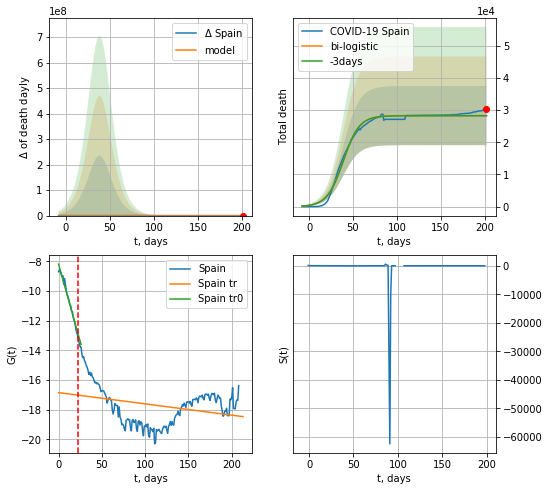

Spain data at: 2020-09-18
+3 day model MAPE: 0.0018051185440711558
model: bi-logistic
coeffs:  [2.8285683e+04 1.0927104e-01 3.8889862e+01] [12.18291976  1.20295815  4.63698223]
rational stdev:  0.3248531613543908
forecast at the end of period: +1 days
	 deltaDaydeath:  0
	 total death:  28297 ± 9192
bi-logistic approximation splitting point: 22
trend0 coefficient of determination: 0.977622
 intercept: -8.181737
 slope: -0.208457
trend coefficient of determination: 0.084840
 intercept: -16.840933
 slope: -0.007603


In [1672]:
vL = 22#len(dfSP[:])-7-dT
#dfSP = read_df(pd.DataFrame(),"SP")
x = forecast('Spain',dfSP[7:vL],d1,7*T18-dT,1.0,cases='death')
xx = forecast2('Spain',dfSP[7:],d1,7*T18-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.8],vL=vL,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


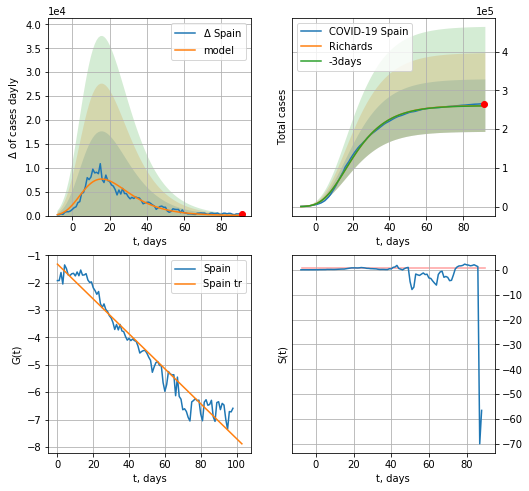

Spain data at: 2020-09-18
+3 day model MAPE: 0.002063
model: Richards
coeffs: [ 2.61234581e+05  1.11545617e+01 -4.55891964e+01  7.16375241e-03]
rational stdev: 0.259932
forecast at the end of period: +1 days
	 deltaDaycases: 50
	 total cases: 260622 ± 67744
	 total death: 12054 ± 9399
trend coefficient of determination: 0.950456
 intercept: -1.320749
 slope: -0.063751


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


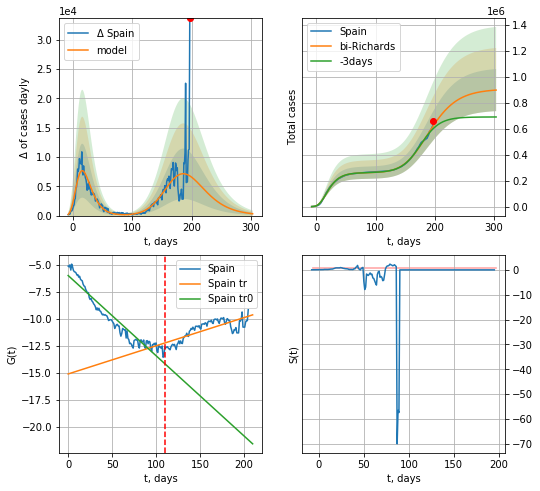

Spain data at: 2020-09-18
+3 day model MAPE: 0.040477
model: bi-Richards
coeffs: [6.44118483e+05 8.01031056e-02 1.65414686e+02 4.59618454e-01]
rational stdev: 0.180650
forecast at the end of period: +106 days
	 deltaDaycases: 313
	 total cases: 896910 ± 162026
	 total death: 41483 ± 22481
bi-Richards approximation splitting point: 110
trend coefficient of determination: 0.919766
 intercept: -5.963157
 slope: -0.074262
trend coefficient of determination: 0.608978
 intercept: -15.084373
 slope: 0.026085


In [1673]:
iL = 10
vL = 110+iL#75+iL#135+1
x = forecastRR('Spain',dfSP[iL:vL-iL],d1,7*T18-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Spain',dfSP[iL:],d1,7*40-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


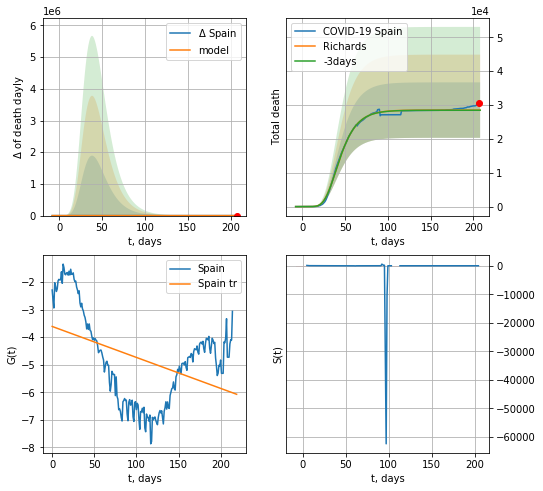

Spain data at: 2020-09-18
+3 day model MAPE: 0.001768
model: Richards
coeffs: [ 2.85017046e+04  1.14343849e+01 -2.92999145e+01  6.46059224e-03]
rational stdev: 0.287347
forecast at the end of period: +1 days
	 total death: 28501 ± 8189
trend coefficient of determination: 0.177932
 intercept: -3.609083
 slope: -0.011248


In [1674]:
x = forecastRR('Spain',dfSP[1:],d1,7*T18-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1],cases='death')

In [1676]:
#x = forecastRRR('Spain',dfSP[:50],d1,7*T18-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])
#xx = forecast2RRR('Spain',dfSP[:],d1,7*T18-dT,x,1.0,addpred=False,xcoef=koreaCoeffs,vL=50)#[.35,.5,3.,1])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


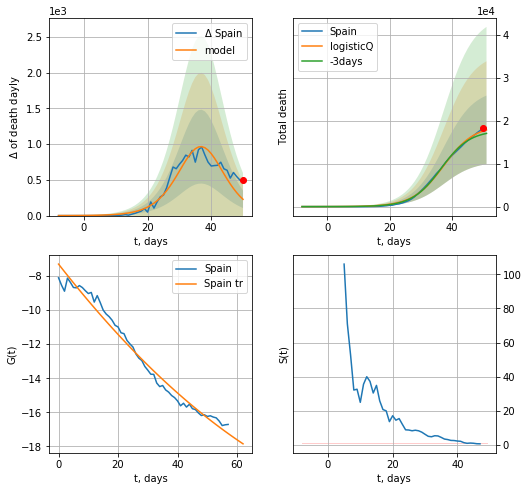

Spain data at: 2020-09-18
+3 day model MAPE: 0.047871
model: logisticQ
coeffs: [ 1.89599654e+04  5.38912704e-06  3.72491565e+01 -3.78046979e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.447682
forecast at the end of period: +1 days
	 total death: 17878 ± 8003
trend coefficient of determination: 0.978811
 intercept_: -7.301838938937334
 coeffs_: [ 0.         -0.22359908  0.00086295]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:347: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:347: RuntimeWarning: invalid value encountered in true_divide


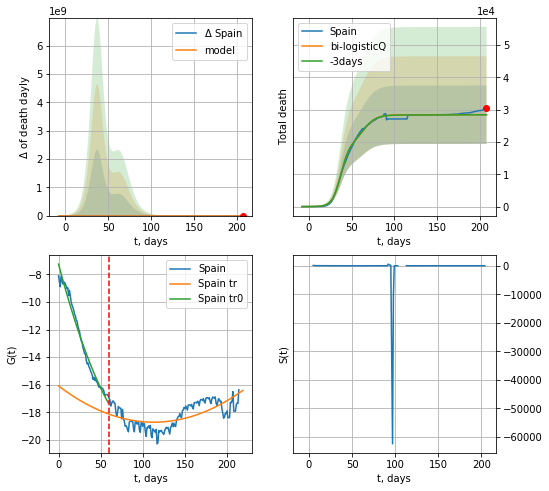

Spain data at: 2020-09-18
+3 day model MAPE: 0.001963
model: bi-logisticQ
coeffs: [ 9.46914008e+03  2.40070001e-07  6.36585315e+01 -5.49426204e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.318034
forecast at the end of period: +1 days
	 total death: 28462 ± 9051
bi-logisticQ approximation splitting point: 60
trend coefficient of determination: 0.978897
 intercept_: -7.2487934110171
 coeffs_: [ 0.         -0.2311524   0.00102662]
trend coefficient of determination: 0.404075
 intercept_: -16.087681610698745
 coeffs_: [ 0.         -0.0466275   0.00020627]


In [1677]:
x = forecastRRR('Spain',dfSP[1:60],d1,7*T18-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[1:],d1,7*T18-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,cases='death',vL=60)

In [1678]:
#x = forecastQR('Spain',dfSP[5:],d1,7*16-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])

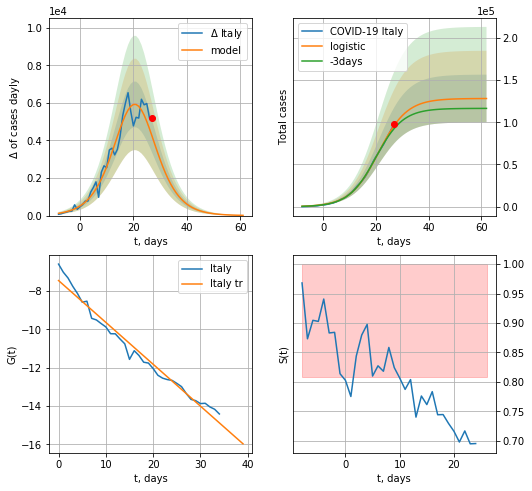

Italy data at: 2020-09-19
+3 day model MAPE: 0.0455783779571316
model: logistic
coeffs:  [1.28139025e+05 1.85112184e-01 2.10100291e+01]
rational stdev:  0.22065596629973358
forecast at the end of period: +35 days
	 deltaDaycases:  13
	 total cases:  128074 ± 28260
	 total death:  15413 ± 10202
trend coefficient of determination: 0.974872
 intercept: -7.448746
 slope: -0.218671


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp


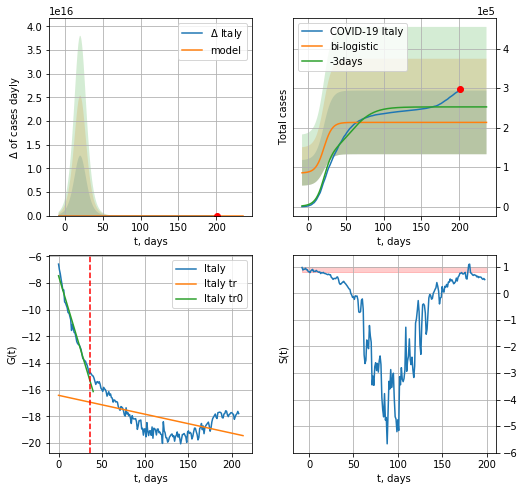

Italy data at: 2020-09-19
+3 day model MAPE: 0.15537646910690117
model: bi-logistic
coeffs:  [ 8.51339636e+04 -4.89241423e+01  2.53664204e+02] [1.28139025e+05 1.85112184e-01 2.10100291e+01]
rational stdev:  0.37776504067744754
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  213272 ± 80567
	 total death:  25667 ± 29088
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975965
 intercept: -7.466589
 slope: -0.217097
trend coefficient of determination: 0.295864
 intercept: -16.432316
 slope: -0.014184


In [2082]:
vL = 36#len(dfIT)-6-dT
x = forecast('Italy',dfIT[:vL],d1,T18*7-dT,1.0)
xx = forecast2('Italy',dfIT,d1,T18*7-dT,x,1.0,vL=vL)

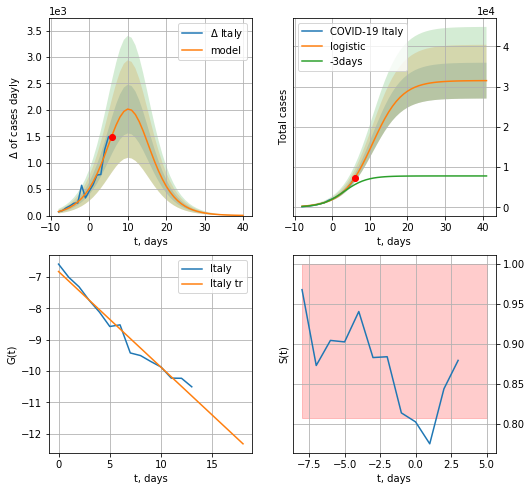

Italy data at: 2020-09-19
+3 day model MAPE: 0.4426444096966454
model: logistic
coeffs:  [3.14978219e+04 2.56455865e-01 1.06869170e+01]
rational stdev:  0.1414781796365507
forecast at the end of period: +35 days
	 deltaDaycases:  3
	 total cases:  31484 ± 4454
	 total death:  3789 ± 1608
trend coefficient of determination: 0.972594
 intercept: -6.827533
 slope: -0.305163


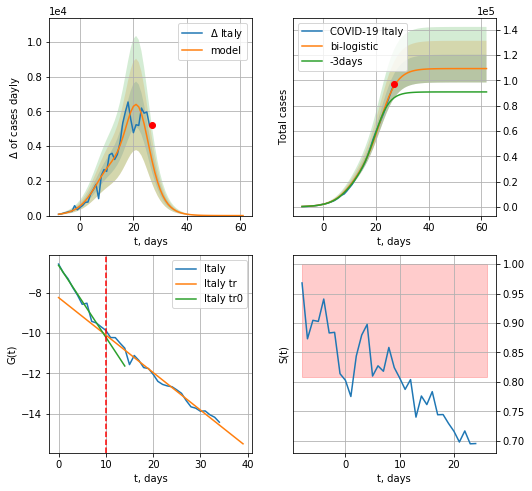

Italy data at: 2020-09-19
+3 day model MAPE: 0.1273932630183904
model: bi-logistic
coeffs:  [7.78644566e+04 3.07215545e-01 2.18188310e+01] [3.14978219e+04 2.56455865e-01 1.06869170e+01]
rational stdev:  0.10049358712471239
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  109361 ± 10990
	 total death:  13161 ± 3967
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:311: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:353: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


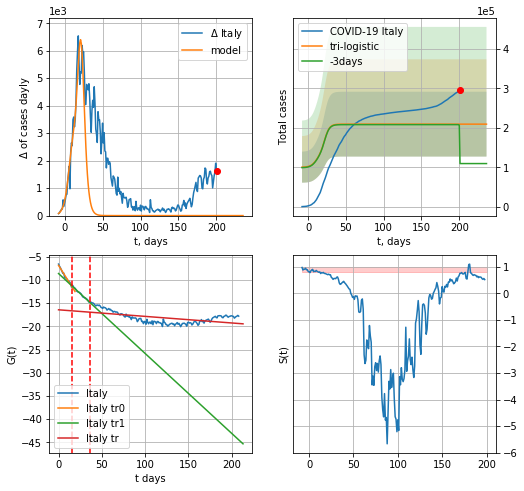

Italy data at: 2020-09-19
+3 day model MAPE: 0.9145207332884462
model: tri-logistic
coeffs:  [ 1.00014071e+05 -4.86894276e+01  2.50605550e+02] [3.14978219e+04 2.56455865e-01 1.06869170e+01 7.78644566e+04
 3.07215545e-01 2.18188310e+01]
forecast rational stdev:  0.392801756037044
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  209376 ± 82243
	 total death:  25198 ± 29693
tri-logistic approximation splitting points: 15,36
trend0 coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498
trend1 coefficient of determination: 0.980669
 intercept: -8.621660
 slope: -0.172200
trend coefficient of determination: 0.295864
 intercept: -16.432316
 slope: -0.014184


In [2083]:
vL = 15#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*T18-dT,1.0)
xx = forecast2('Italy',dfIT[:vL1],d1,7*T18-dT,x,1.0)#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*T18-dT, xx, shift=1.,addpred=False,xcoef=[.35,1.,1.5],vL=[vL,vL1])

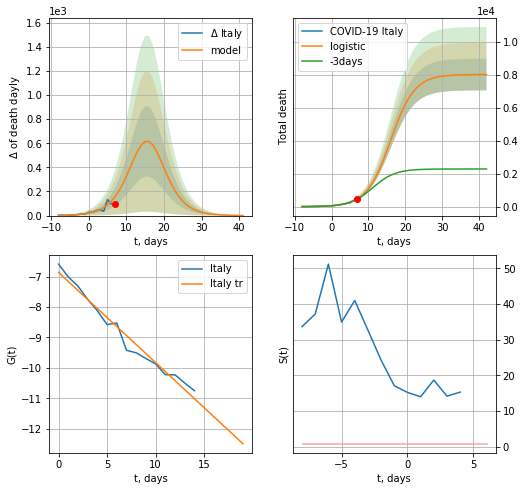

Italy data at: 2020-09-19
+3 day model MAPE: 0.04050488963495004
model: logistic
coeffs:  [8.02165383e+03 3.09187965e-01 1.60041387e+01]
rational stdev:  0.12009378173020563
forecast at the end of period: +35 days
	 total death:  8019 ± 963
trend coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498


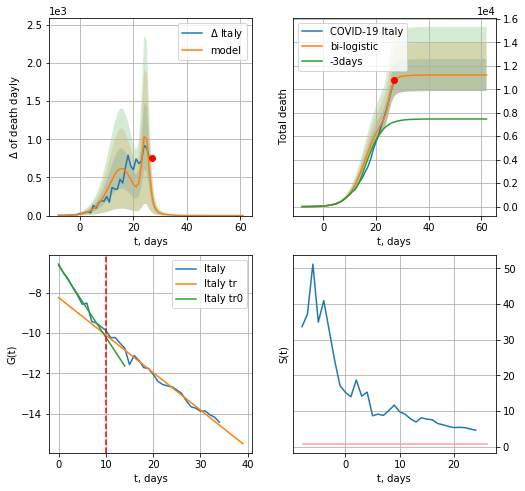

Italy data at: 2020-09-19
+3 day model MAPE: 0.5045402783114736
model: bi-logistic
coeffs:  [3.18986478e+03 1.24682064e+00 2.50159742e+01] [8.02165383e+03 3.09187965e-01 1.60041387e+01]
rational stdev:  0.12176299197618909
forecast at the end of period: +35 days
	 deltaDaydeath:  0
	 total death:  11211 ± 1365
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


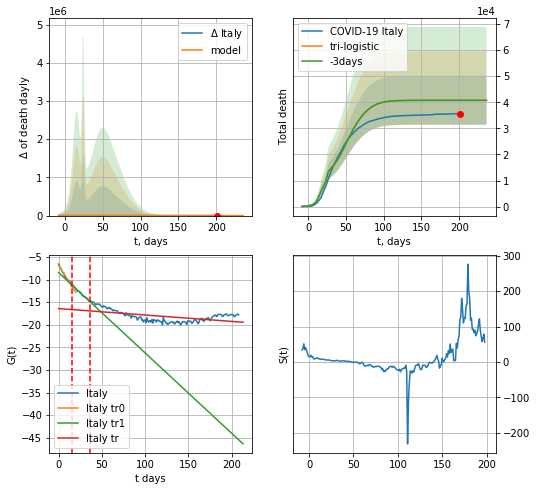

Italy data at: 2020-09-19
+3 day model MAPE: 0.0007117457810406952
model: tri-logistic
coeffs:  [2.36583413e+04 9.26922563e-02 4.92740401e+01] [8.02165383e+03 3.09187965e-01 1.60041387e+01 3.18986478e+03
 1.24682064e+00 2.50159742e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.22986705063305413
forecast at the end of period: +35 days
	 deltaDaydeath:  0
	 total death:  40784 ± 9374
tri-logistic approximation splitting points: 16,36
trend0 coefficient of determination: 0.976775
 intercept: -6.838969
 slope: -0.302094
trend1 coefficient of determination: 0.986358
 intercept: -8.457993
 slope: -0.177909
trend coefficient of determination: 0.295864
 intercept: -16.432316
 slope: -0.014184


In [2084]:
vL = 16#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*T18-dT,1.0,cases='death')
xx = forecast2('Italy',dfIT[:vL1],d1,7*T18-dT,x,1.0,cases='death')#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*T18-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


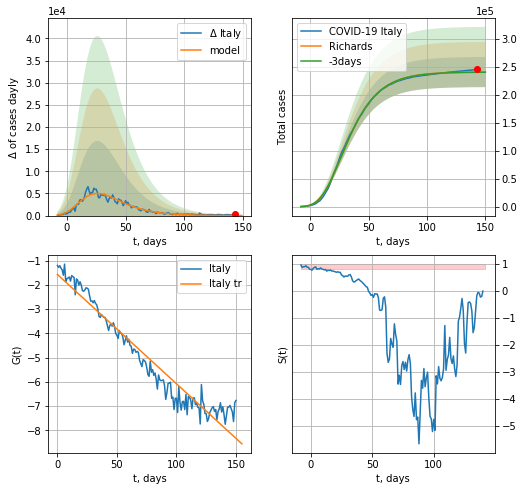

Italy data at: 2020-09-19
+3 day model MAPE: 0.001137
model: Richards
coeffs: [ 2.40825315e+05  8.29717345e+00 -6.16464143e+01  6.82557212e-03]
rational stdev: 0.111816
forecast at the end of period: +7 days
	 deltaDaycases: 12
	 total cases: 240605 ± 26903
	 total death: 28956 ± 9713
trend coefficient of determination: 0.940744
 intercept: -1.565853
 slope: -0.045125


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


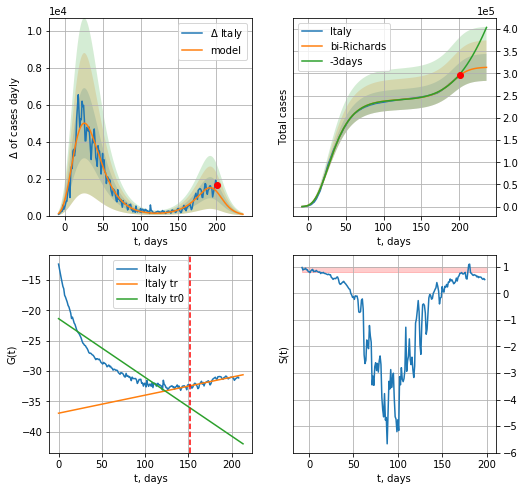

Italy data at: 2020-09-19
+3 day model MAPE: 0.012300
model: bi-Richards
coeffs: [7.34781880e+04 5.25371217e-02 1.98932304e+02 2.05867309e+00]
rational stdev: 0.096846
forecast at the end of period: +35 days
	 deltaDaycases: 72
	 total cases: 313662 ± 30377
	 total death: 37749 ± 10967
bi-Richards approximation splitting point: 152
trend coefficient of determination: 0.752433
 intercept: -21.350025
 slope: -0.097081
trend coefficient of determination: 0.701765
 intercept: -36.970437
 slope: 0.029804


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


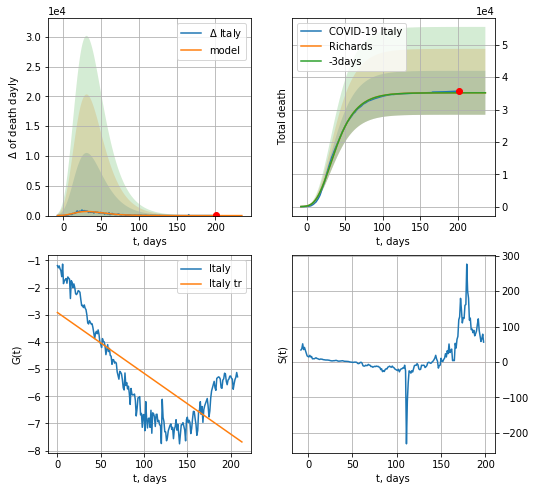

Italy data at: 2020-09-19
+3 day model MAPE: 0.000442
model: Richards
coeffs: [ 3.51822827e+04  8.16023899e+00 -6.26929887e+01  6.57946089e-03]
rational stdev: 0.192879
forecast at the end of period: +35 days
	 total death: 35181 ± 6785
trend coefficient of determination: 0.546678
 intercept: -2.917637
 slope: -0.022355


In [2085]:
vL=152
x = forecastRR('Italy',dfIT[:vL],d1,26*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Italy',dfIT[:],d1,30*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRR('Italy',dfIT[:],d1,T18*7-dT,1.0,cases='death')

In [2086]:
#x = forecastRRR('Italy',dfIT[:],d1,7*T18-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


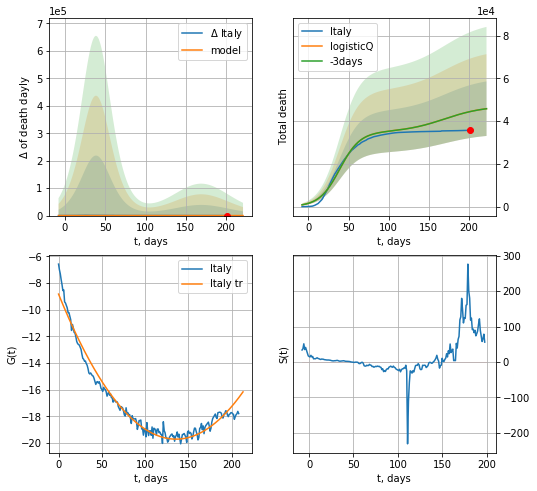

Italy data at: 2020-09-19
+3 day model MAPE: 0.000329
model: logisticQ
coeffs: [ 3.48196689e+04  1.62276440e-07  3.89166870e+01 -4.87506069e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.278371
forecast at the end of period: +21 days
	 total death: 45788 ± 12746
trend coefficient of determination: 0.968701
 intercept_: -8.840076064371729
 coeffs_: [ 0.         -0.16047833  0.0005918 ]


In [2087]:
x = forecastRRR('Italy',dfIT[:],d1,7*28-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

In [2088]:
dT

175

FR
           date     cases  active    death
213 2020-09-15  395104.0  274214  30999.0
214 2020-09-16  404888.0  283508  31045.0
215 2020-09-17  415481.0  293546  31095.0
216 2020-09-18  428696.0  305873  31249.0
217 2020-09-19  442194.0  319346  31274.0


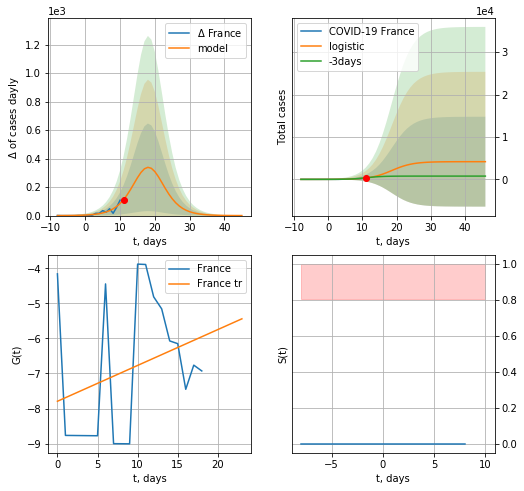

France data at: 2020-09-19
+3 day model MAPE: 0.04053351776025477
model: logistic
coeffs:  [4.17382756e+03 3.25568782e-01 1.85948993e+01]
rational stdev:  2.5390566064289986
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  4173 ± 10596
	 total death:  295 ± 2247
trend coefficient of determination: 0.083417
 intercept: -7.793073
 slope: 0.102246


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


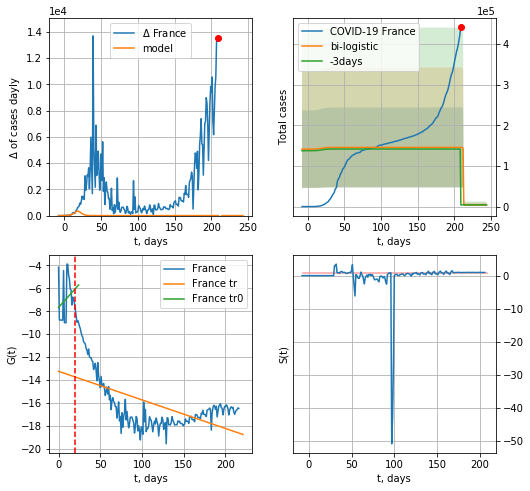

France data at: 2020-09-19
+3 day model MAPE: 33.892157960260704
model: bi-logistic
coeffs:  [ 1.41460024e+05 -9.02647208e+00  2.12443395e+02] [4.17382756e+03 3.25568782e-01 1.85948993e+01]
rational stdev:  0.6749027055287379
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  4173 ± 2816
	 total death:  295 ± 597
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.062178
 intercept: -7.670498
 slope: 0.081817
trend coefficient of determination: 0.352714
 intercept: -13.250104
 slope: -0.024987


In [2089]:
# prideta 1990 2020-04-17
# prideta 3824 2020-04-18
dfFR = read_df(pd.DataFrame(),"FR")
vL=20
try:
    x = forecast('France',dfFR[:vL],d1,T18*7-dT,1.0)
    xx = forecast2('France',dfFR,d1,T18*7-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.5],vL=vL)
except:
    print ("Exception occurs")

In [2090]:
#vL=len(dfFR)-9-5-dT
#x = forecast('France',dfFR[10:-9-dT],d1,7*5-dT-4,1.0)
#xx = forecast2('France',dfFR[10:],d1,7*7-dT-4,x,1.0,addpred=True,xcoef=[.25,1.,1.4],vL=vL)

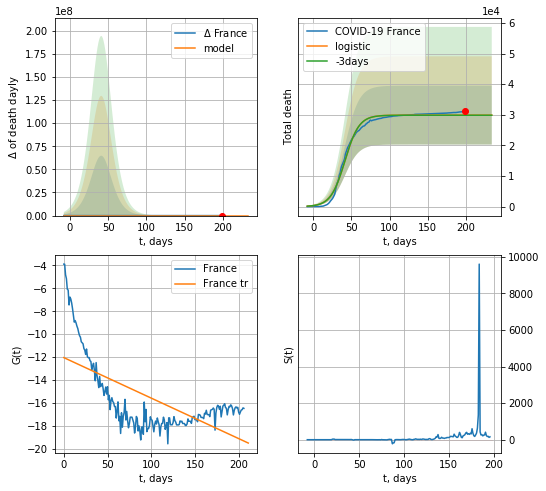

France data at: 2020-09-19
+3 day model MAPE: 0.0011541929399121217
model: logistic
coeffs:  [2.98760377e+04 1.08080779e-01 4.13613939e+01]
rational stdev:  0.3214271959888108
forecast at the end of period: +35 days
	 total death:  29876 ± 9602
trend coefficient of determination: 0.427558
 intercept: -12.052956
 slope: -0.035389


In [2091]:
#dfFR = read_df(pd.DataFrame(),"FR")
x = forecast('France',dfFR[10:],d1,7*T18-dT,1.0,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


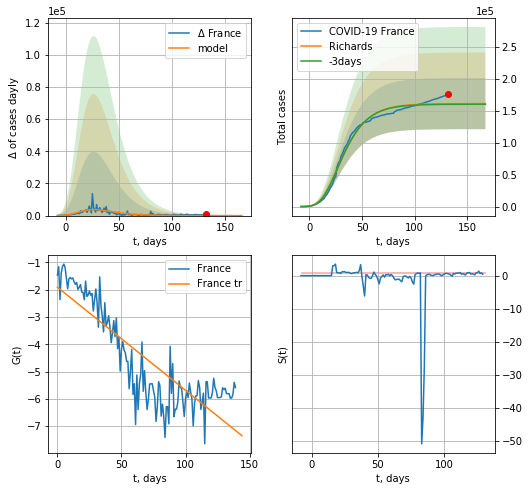

France data at: 2020-09-19
+3 day model MAPE: 0.006316
model: Richards
coeffs: [ 1.60997599e+05  1.46350142e+01 -5.95952768e+01  4.31594545e-03]
rational stdev: 0.248135
forecast at the end of period: +35 days
	 deltaDaycases: 1
	 total cases: 160974 ± 39943
	 total death: 11384 ± 8474
trend coefficient of determination: 0.728995
 intercept: -1.912518
 slope: -0.037751


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


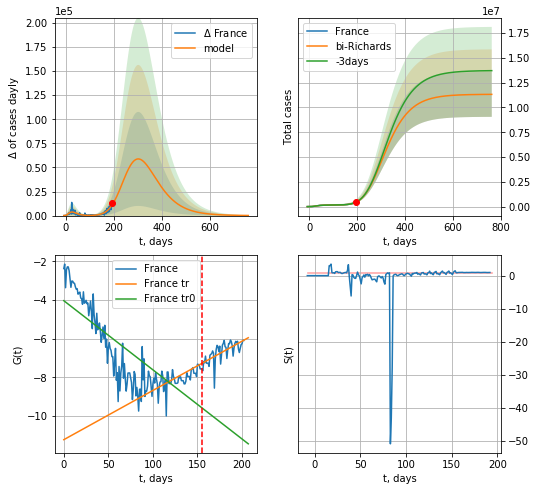

France data at: 2020-09-19
+3 day model MAPE: 0.002084
model: bi-Richards
coeffs: [1.11663992e+07 7.87047305e-02 2.00434543e+02 1.99831655e-01]
rational stdev: 0.200311
forecast at the end of period: +567 days
	 deltaDaycases: 129
	 total cases: 11319243 ± 2267372
	 total death: 800549 ± 481077
bi-Richards approximation splitting point: 155
trend coefficient of determination: 0.647490
 intercept: -4.032425
 slope: -0.035753
trend coefficient of determination: 0.475397
 intercept: -11.219617
 slope: 0.025469


In [2092]:
vL = 86+14+40+29
x = forecastRR('France',dfFR[14:vL-14],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('France',dfFR[14:],d1,106*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-14)

In [2093]:
#x = forecastRRR('France',dfFR[10:],d1,34*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,3.,1.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


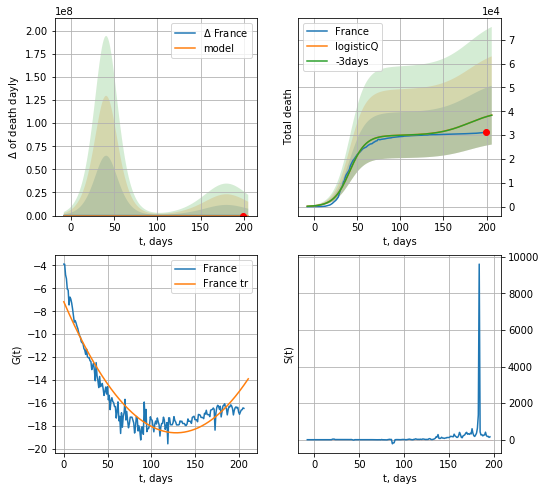

France data at: 2020-09-19
+3 day model MAPE: 0.000480
model: logisticQ
coeffs: [ 2.98760647e+04  2.30862482e-07  4.13622526e+01 -4.67963557e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.321469
forecast at the end of period: +7 days
	 total death: 38360 ± 12331
trend coefficient of determination: 0.896586
 intercept_: -7.171762142271097
 coeffs_: [ 0.         -0.17825403  0.00069352]


In [2094]:
x = forecastRRR('France',dfFR[10:],d1,26*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1.])

In [2095]:
#x = forecastR('France',dfFR[:],d1,8*7-dT-4,1.0,addpred=True,xcoef=[0.25,1.,20.,1])

In [2096]:
#trend3(dfGR,dfUS,dfGB[:],'GR','US','GB',40,40,40)

GR
           date   cases  active   death
204 2020-09-15  264844   16299  9445.0
205 2020-09-16  266865   18316  9449.0
206 2020-09-17  269042   18285  9457.0
207 2020-09-18  271244   18780  9464.0
208 2020-09-19  272342   19376  9466.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:86: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


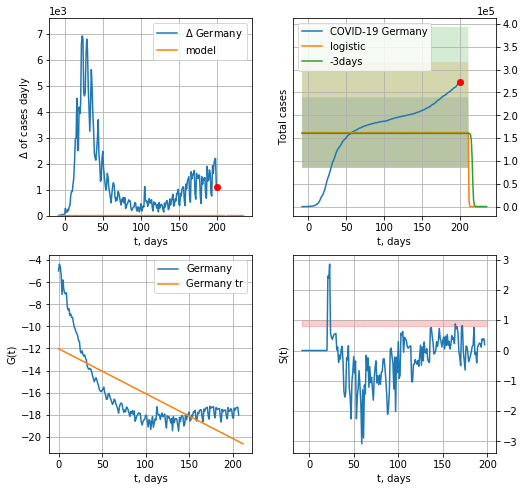

Germany data at: 2020-09-19
+3 day model MAPE: 0.009896145684493582
model: logistic
coeffs:  [ 1.61922297e+05 -3.70718582e+01  2.11932519e+02]
rational stdev:  0.47630618217819354
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  0 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.523197
 intercept: -12.018757
 slope: -0.040626


In [2097]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[:],d1,7*T18-dT,1.0)
#xx = forecast2('Germany',dfGR,d1,7*7-dT,x,1.0)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


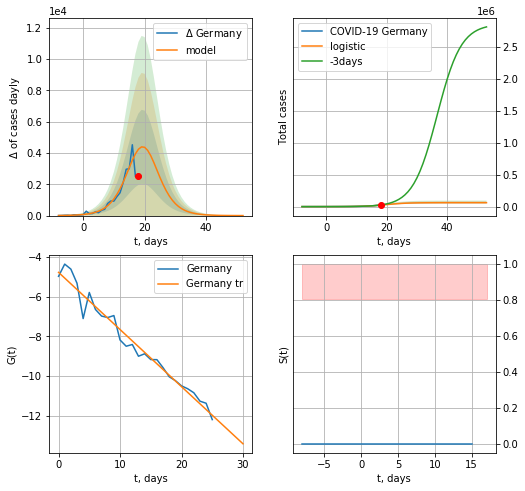

Germany data at: 2020-09-19
+3 day model MAPE: 0.1832688253569737
model: logistic
coeffs:  [6.15503848e+04 2.86340373e-01 1.98405530e+01]
rational stdev:  0.17812668621711658
forecast at the end of period: +35 days
	 deltaDaycases:  1
	 total cases:  61545 ± 10962
	 total death:  2139 ± 1143
trend coefficient of determination: 0.966755
 intercept: -4.774386
 slope: -0.288157


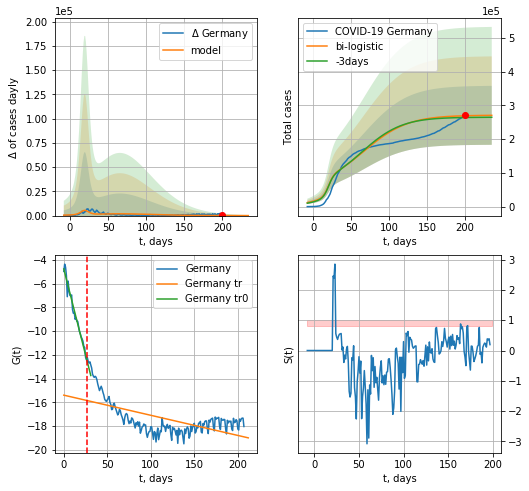

Germany data at: 2020-09-19
+3 day model MAPE: 0.019822254902772094
model: bi-logistic
coeffs:  [1.67489718e+05 3.82818794e-02 6.09050370e+01] [6.15503848e+04 2.86340373e-01 1.98405530e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.32296950880093045
forecast at the end of period: +35 days
	 deltaDaycases:  16
	 total cases:  270484 ± 87358
	 total death:  9401 ± 9108
bi-logistic approximation splitting point: 27
trend0 coefficient of determination: 0.970316
 intercept: -4.764587
 slope: -0.289333
trend coefficient of determination: 0.368049
 intercept: -15.388490
 slope: -0.016952


In [2098]:
vL = 27
x = forecast('Germany',dfGR[:vL],d1,T18*7-dT,1.0)#,addpred=True,xcoef=[0.25,1.,2.0,1])
xx = forecast2('Germany',dfGR,d1,7*T18-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.6],vL=vL)

In [2099]:
dfGR = read_df(pd.DataFrame(),"GR")
#x = forecast('Germany',dfGR[14:],d1,24*7-dT,1.0,cases='death')

GR
           date   cases  active   death
204 2020-09-15  264844   16299  9445.0
205 2020-09-16  266865   18316  9449.0
206 2020-09-17  269042   18285  9457.0
207 2020-09-18  271244   18780  9464.0
208 2020-09-19  272342   19376  9466.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


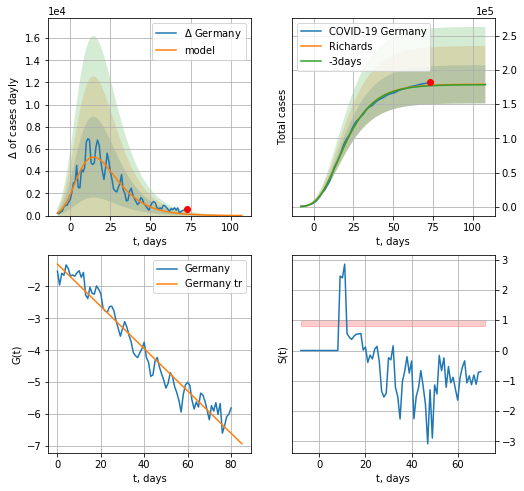

Germany data at: 2020-09-19
+3 day model MAPE: 0.003910
model: Richards
coeffs: [ 1.79110642e+05  9.15687169e+00 -4.39392677e+01  8.78226811e-03]
rational stdev: 0.155919
forecast at the end of period: +35 days
	 deltaDaycases: 8
	 total cases: 179009 ± 27911
	 total death: 6221 ± 2909
trend coefficient of determination: 0.956451
 intercept: -1.304276
 slope: -0.066178


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


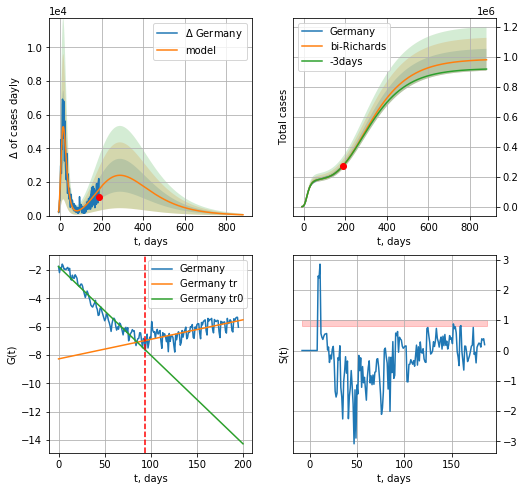

Germany data at: 2020-09-19
+3 day model MAPE: 0.002008
model: bi-Richards
coeffs: [ 8.09201127e+05  1.94001465e-01 -9.62536606e+01  4.24073981e-02]
rational stdev: 0.074589
forecast at the end of period: +693 days
	 deltaDaycases: 50
	 total cases: 982185 ± 73259
	 total death: 34138 ± 7638
bi-Richards approximation splitting point: 94
trend coefficient of determination: 0.950348
 intercept: -1.768082
 slope: -0.062476
trend coefficient of determination: 0.453270
 intercept: -8.276165
 slope: 0.013777


In [2100]:
vL = 94+12
x = forecastRR('Germany',dfGR[12:vL-12],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Germany',dfGR[12:],d1,124*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)

In [2101]:
#x = forecastRRR('Germany',dfGR[:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.0,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


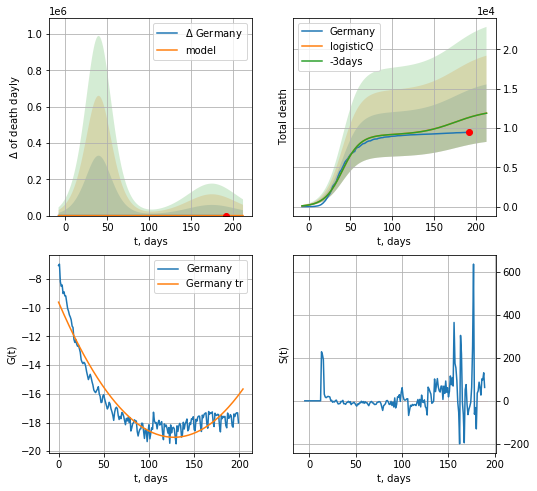

Germany data at: 2020-09-19
+3 day model MAPE: 0.000420
model: logisticQ
coeffs: [ 9.13317073e+03  2.00181911e-07  4.02315657e+01 -4.66080080e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.307594
forecast at the end of period: +21 days
	 total death: 11895 ± 3659
trend coefficient of determination: 0.903547
 intercept_: -9.607198393601212
 coeffs_: [ 0.         -0.14759138  0.000578  ]


In [2102]:
x = forecastRRR('Germany',dfGR[8:],d1,28*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.0,1])

US
           date    cases   active     death
198 2020-09-15  6788147  2519864  200197.0
199 2020-09-16  6828301  2507795  201348.0
200 2020-09-17  6874596  2517344  202213.0
201 2020-09-18  6925941  2530876  203171.0
202 2020-09-19  6968918  2541156  203844.0


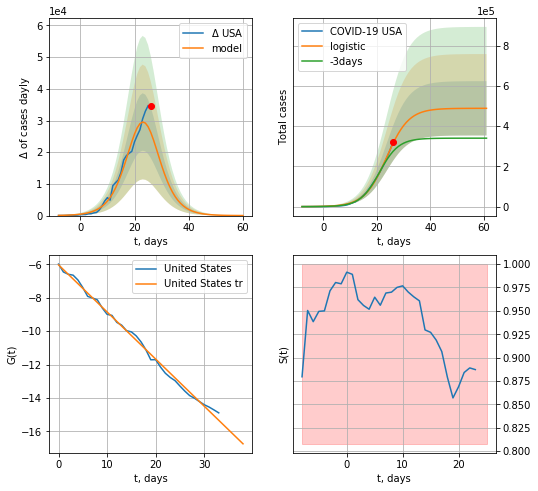

USA data at: 2020-09-19
+3 day model MAPE: 0.17962965905806133
model: logistic
coeffs:  [4.89025787e+05 2.41973856e-01 2.36121759e+01]
rational stdev:  0.27607026078318453
forecast at the end of period: +35 days
	 deltaDaycases:  15
	 total cases:  488968 ± 134989
	 total death:  14302 ± 11845
trend coefficient of determination: 0.995387
 intercept: -6.036925
 slope: -0.281840


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


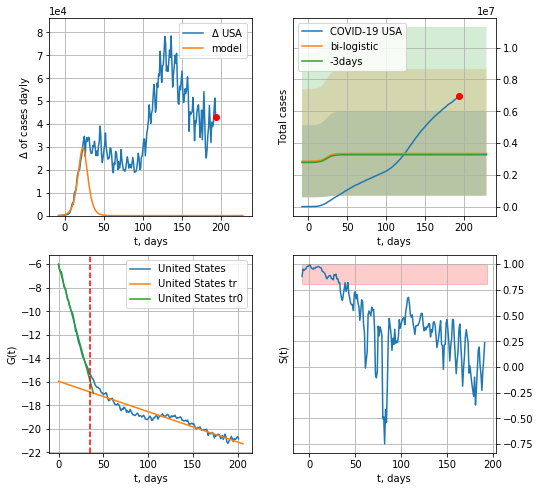

USA data at: 2020-09-19
+3 day model MAPE: 0.023856210560559327
model: bi-logistic
coeffs:  [ 2.28186689e+06 -2.65174941e+01  6.37679747e+02] [4.89025787e+05 2.41973856e-01 2.36121759e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
rational stdev:  0.794843970455466
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  3341359 ± 2655859
	 total death:  97736 ± 233054
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.995488
 intercept: -6.051468
 slope: -0.280518
trend coefficient of determination: 0.894184
 intercept: -15.954782
 slope: -0.025800


In [2103]:
vL=35
dfUS = read_df(pd.DataFrame(),"US")
x = forecast('USA',dfUS[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=[0.25,1.,2.])
xx = forecast2('USA',dfUS[:],d1,T18*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.5],vL=vL)

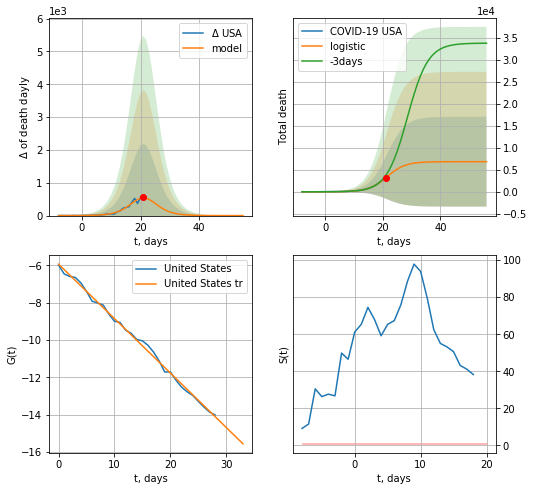

USA data at: 2020-09-19
+3 day model MAPE: 0.21421329662103625
model: logistic
coeffs:  [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  1.4929056707100332
forecast at the end of period: +35 days
	 total death:  6833 ± 10202
trend coefficient of determination: 0.996549
 intercept: -5.938291
 slope: -0.291586


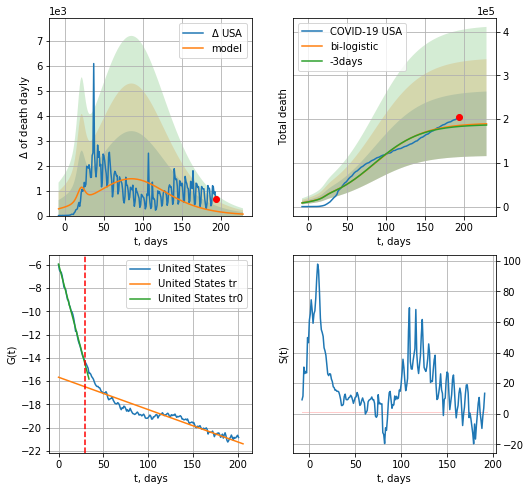

USA data at: 2020-09-19
+3 day model MAPE: 0.012776257709244912
model: bi-logistic
coeffs:  [1.84332208e+05 3.20276872e-02 8.56601390e+01] [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  0.390082620428202
forecast at the end of period: +35 days
	 deltaDaydeath:  59
	 total death:  189315 ± 73848
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.996707
 intercept: -5.949158
 slope: -0.290421
trend coefficient of determination: 0.870269
 intercept: -15.668658
 slope: -0.027774


In [2104]:
vL=30
x = forecast('USA',dfUS[:vL],d1,7*T18-dT,1.0,cases='death')
xx = forecast2('USA',dfUS,d1,7*T18-dT,x,1.0,cases='death',vL=vL)
#x = forecast('USA',dfUS[:],d1,28*3-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


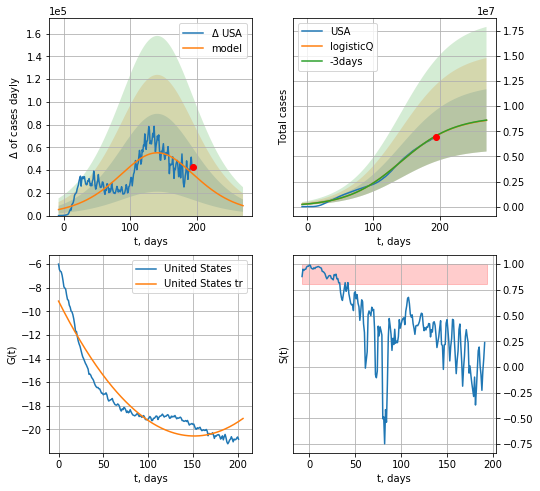

USA data at: 2020-09-19
+3 day model MAPE: 0.001485
model: logisticQ
coeffs: [ 8.88584278e+06  3.45018511e-07  1.41084322e+02 -7.17471940e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.361210
forecast at the end of period: +77 days
	 deltaDaycases: 8727
	 total cases: 8589883 ± 3102751
	 total death: 251257 ± 272269
trend coefficient of determination: 0.893618
 intercept_: -9.130553157413495
 coeffs_: [ 0.         -0.15110839  0.00049886]


In [2105]:
x = forecastRRR('USA',dfUS[:],d1,7*36-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.,1.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


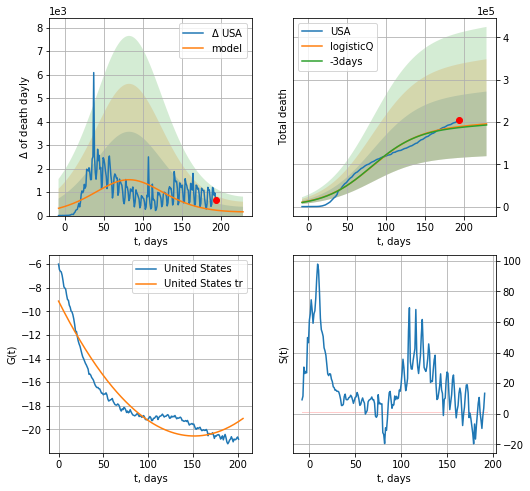

USA data at: 2020-09-19
+3 day model MAPE: 0.012229
model: logisticQ
coeffs: [ 1.89938828e+05  3.92394832e-08  8.24090664e+01 -8.13281398e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.390648
forecast at the end of period: +35 days
	 total death: 195593 ± 76408
trend coefficient of determination: 0.893618
 intercept_: -9.130553157413495
 coeffs_: [ 0.         -0.15110839  0.00049886]


In [2106]:
x = forecastRRR('USA',dfUS[:],d1,7*30-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.,1.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


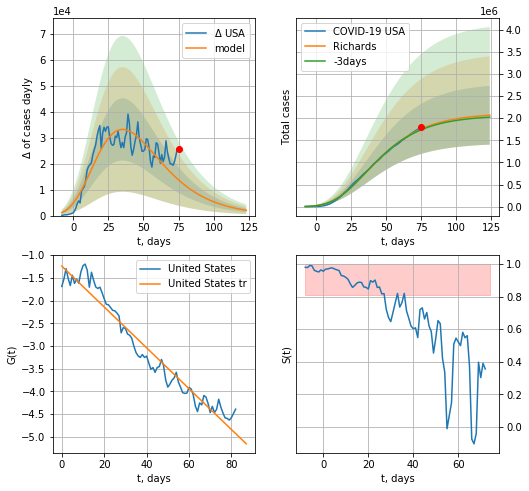

USA data at: 2020-09-19
+3 day model MAPE: 0.011172
model: Richards
coeffs: [ 2.11547275e+06  4.55740072e+00 -7.32299429e+01  9.40207859e-03]
rational stdev: 0.321873
forecast at the end of period: +49 days
	 deltaDaycases: 2055
	 total cases: 2067945 ± 665615
	 total death: 60488 ± 58408
trend coefficient of determination: 0.952323
 intercept: -1.242017
 slope: -0.044961


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


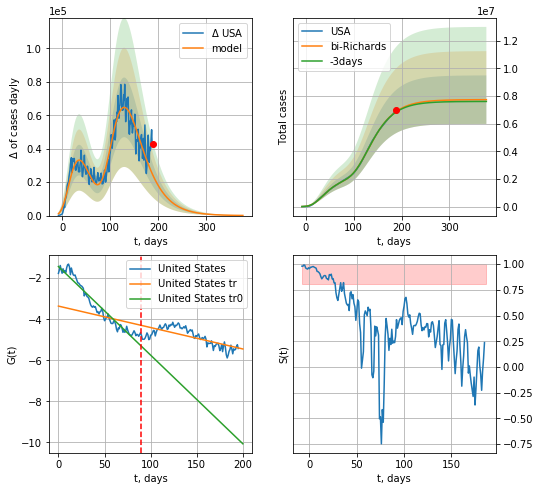

USA data at: 2020-09-19
+3 day model MAPE: 0.005358
model: bi-Richards
coeffs: [5.61929227e+06 1.44317156e+00 5.95790306e+00 2.13918045e-02]
rational stdev: 0.226836
forecast at the end of period: +189 days
	 deltaDaycases: 87
	 total cases: 7731980 ± 1753890
	 total death: 226163 ± 153905
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.944891
 intercept: -1.429075
 slope: -0.043228
trend coefficient of determination: 0.532171
 intercept: -3.359339
 slope: -0.010454


In [2107]:
iL = 6
vL = 90+iL
x = forecastRR('USA',dfUS[iL:vL-iL],d1,7*32-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('USA',dfUS[iL:],d1,7*52-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [2108]:
#x = forecastQR('USA',dfUS[20:],d1,7*18-dT,1.0,addpred=False,xcoef=[0.35,.5,3.,1.,1.])

GB
           date   cases  active    death
202 2020-09-15  374228       0  41664.0
203 2020-09-16  378219       0  41684.0
204 2020-09-17  381614       0  41705.0
205 2020-09-18  385936       0  41732.0
206 2020-09-19  390358       0  41759.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


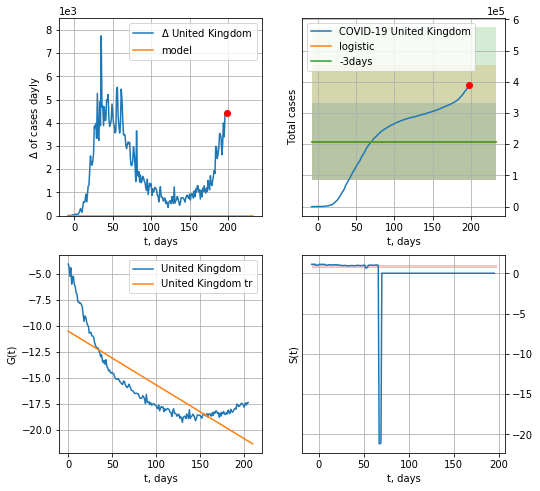

United Kingdom data at: 2020-09-19
+3 day model MAPE: 0.012667963974135834
model: logistic
coeffs:  [ 2.08559295e+05 -1.11010640e+01  2.81691643e+02]
rational stdev:  0.5870046203788324
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  208559 ± 122425
	 total death:  22310 ± 39288
trend coefficient of determination: 0.673209
 intercept: -10.485244
 slope: -0.051616


In [2109]:
try:
    dfGB = read_df(pd.DataFrame(),"GB")
    x = forecast('United Kingdom',dfGB[:],d1,7*T18-dT,1.)
    #x = forecast('United Kingdom',dfGB[:-8-dT],d1,4*7-dT,1.)
    #xx = forecast2('United Kingdom',dfGB[:],d1,4*7-dT,x,1.)
except:
    print ("Exception occurs")

In [2110]:
#x = forecast('United Kingdom',dfGB[:],d1,T18*7-dT,1.,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: divide by zero encountered in true_divide


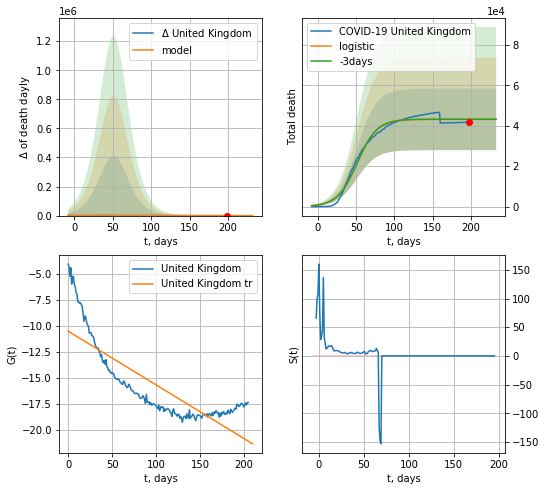

United Kingdom data at: 2020-09-19
+3 day model MAPE: 0.001068755660218507
model: logistic
coeffs:  [4.31600155e+04 7.75886570e-02 5.14219389e+01]
rational stdev:  0.35283792007617437
forecast at the end of period: +35 days
	 total death:  43159 ± 15228
trend coefficient of determination: 0.673209
 intercept: -10.485244
 slope: -0.051616


In [2111]:
x = forecast('United Kingdom',dfGB[:],d1,T18*7-dT,1.,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


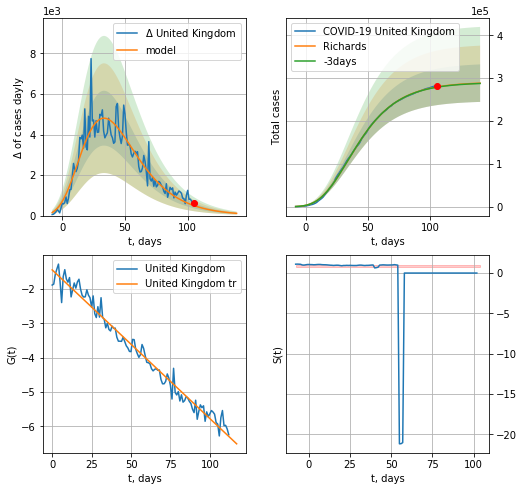

United Kingdom data at: 2020-09-19
+3 day model MAPE: 0.001972
model: Richards
coeffs: [ 2.90643686e+05  4.49558792e+00 -6.80115567e+01  1.00515002e-02]
rational stdev: 0.151739
forecast at the end of period: +35 days
	 deltaDaycases: 109
	 total cases: 288260 ± 43740
	 total death: 30836 ± 14037
trend coefficient of determination: 0.975910
 intercept: -1.441262
 slope: -0.043308


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


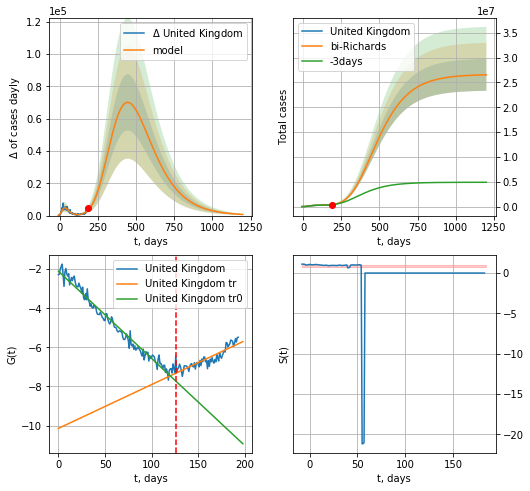

United Kingdom data at: 2020-09-19
+3 day model MAPE: 0.011297
model: bi-Richards
coeffs: [2.63282212e+07 9.63195426e-02 1.06771437e+02 7.80885235e-02]
rational stdev: 0.121166
forecast at the end of period: +1015 days
	 deltaDaycases: 675
	 total cases: 26529181 ± 3214427
	 total death: 2837989 ± 1031600
bi-Richards approximation splitting point: 126
trend coefficient of determination: 0.975221
 intercept: -2.107846
 slope: -0.044569
trend coefficient of determination: 0.762733
 intercept: -10.143715
 slope: 0.022407


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide


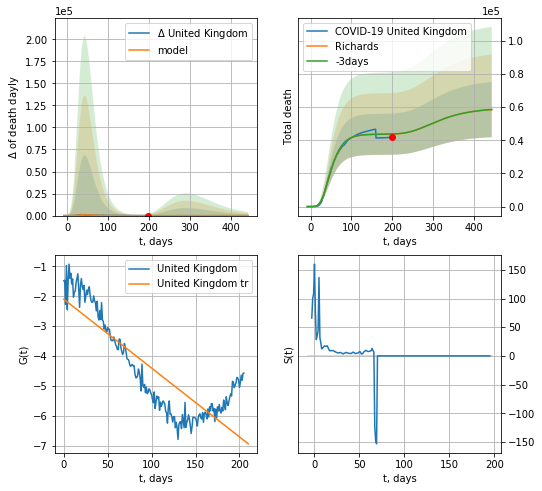

United Kingdom data at: 2020-09-19
+3 day model MAPE: 0.001478
model: Richards
coeffs: [ 4.36111314e+04  7.64703437e+00 -4.97939821e+01  6.98119417e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.284155
forecast at the end of period: +245 days
	 total death: 58459 ± 16611
trend coefficient of determination: 0.717214
 intercept: -2.100964
 slope: -0.023007


In [2112]:
vL = 126+12
x = forecastRR('United Kingdom',dfGB[12:vL-12],d1,30*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('United Kingdom',dfGB[12:],d1,170*7-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)
x = forecastRR('United Kingdom',dfGB[:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


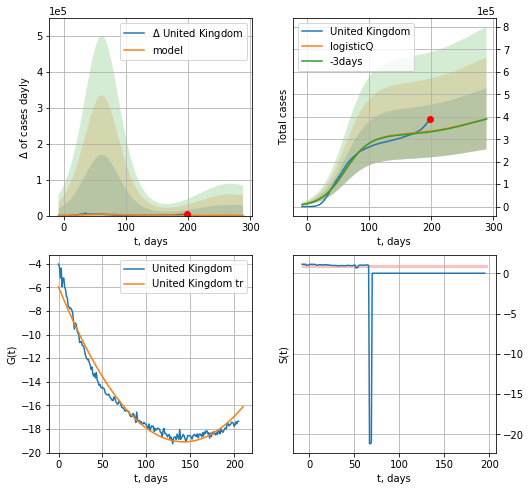

United Kingdom data at: 2020-09-19
+3 day model MAPE: 0.010134
model: logisticQ
coeffs: [ 3.20389609e+05  5.47181023e-08  6.16354992e+01 -9.26148103e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.348202
forecast at the end of period: +91 days
	 deltaDaycases: 679
	 total cases: 391524 ± 136329
	 total death: 41883 ± 43751
trend coefficient of determination: 0.974106
 intercept_: -5.963232542400554
 coeffs_: [ 0.         -0.18461644  0.00064879]


In [2113]:
x = forecastRRR('United Kingdom',dfGB[:],d1,38*7-dT,1.,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


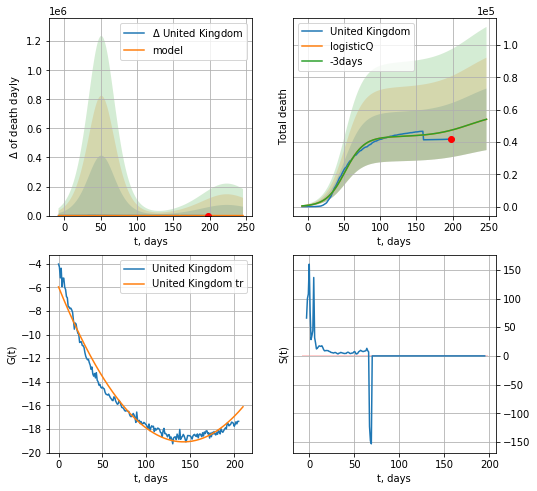

United Kingdom data at: 2020-09-19
+3 day model MAPE: 0.000732
model: logisticQ
coeffs: [ 4.31598704e+04  1.72359485e-07  5.14224400e+01 -4.49969432e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.352859
forecast at the end of period: +49 days
	 total death: 54003 ± 19055
trend coefficient of determination: 0.974106
 intercept_: -5.963232542400554
 coeffs_: [ 0.         -0.18461644  0.00064879]


In [2114]:
x = forecastRRR('United Kingdom',dfGB[:],d1,32*7-dT,1.,addpred=True,xcoef=koreaCoeffs,cases='death')

In [1714]:
#x = forecastQR('United Kingdom',dfGB[:],d1,18*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1,1])

In [1715]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,2.4,1])

In [1716]:
#trend3(dfDK,dfNG,dfSW[:],'DK','NG','SW',40,40,40)

In [1717]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,4.,1])

In [1718]:
#x = forecast('Denmark',dfDK[:15],d1,2*7-dT,1.0)
#xx = forecast2('Denmark',dfDK[:],d1,4*7-dT, x,1.0)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3('Denmark',dfDK[:],d1,14-dT, xx)

DK
           date    cases  active  death
201 2020-09-15  20571.0    3381  633.0
202 2020-09-16  20977.0    3381  633.0
203 2020-09-17  21393.0    3840  635.0
204 2020-09-18  21847.0    4102  635.0
205 2020-09-19  22436.0    4485  635.0


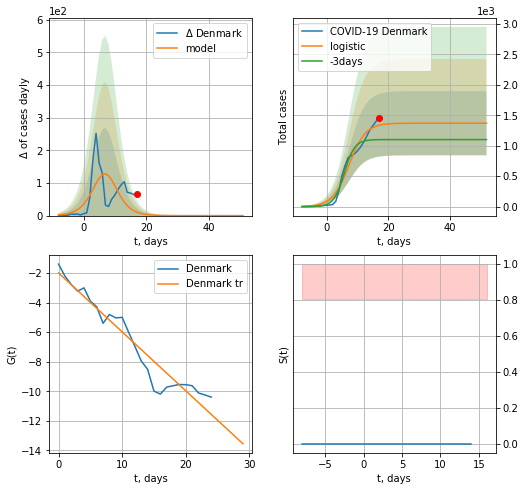

Denmark data at: 2020-09-19
+3 day model MAPE: 0.22309164797181072
model: logistic
coeffs:  [1.36966074e+03 3.75718857e-01 7.30059730e+00]
rational stdev:  0.3847660616131427
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  1369 ± 526
	 total death:  38 ± 43
trend coefficient of determination: 0.928037
 intercept: -1.984791
 slope: -0.399221


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp


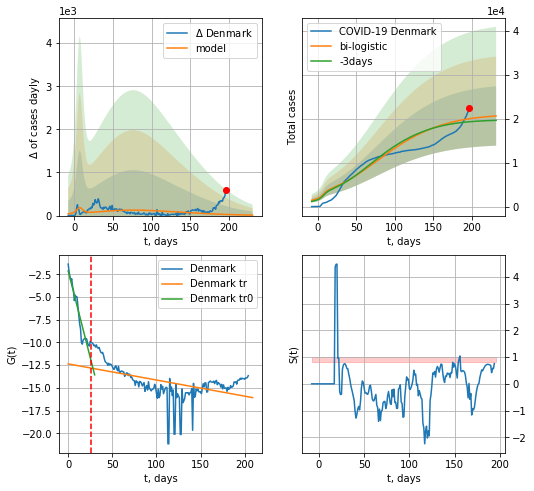

Denmark data at: 2020-09-19
+3 day model MAPE: 0.03617908121883605
model: bi-logistic
coeffs:  [1.57296029e+04 2.95462795e-02 7.09949985e+01] [1.36966074e+03 3.75718857e-01 7.30059730e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3275543882850917
forecast at the end of period: +35 days
	 deltaDaycases:  11
	 total cases:  20640 ± 6760
	 total death:  584 ± 573
bi-logistic approximation splitting point: 26
trend0 coefficient of determination: 0.914728
 intercept: -2.128126
 slope: -0.381304
trend coefficient of determination: 0.240893
 intercept: -12.360833
 slope: -0.017739


In [2115]:
dfDK = read_df(pd.DataFrame(),"DK")
vL = 26
try:
    x = forecast('Denmark',dfDK[:vL],d1,7*T18-dT,1.0)
    xx = forecast2('Denmark',dfDK[:],d1,T18*7-dT, x,1.0,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
except:
    print("Exception occurs")

In [2116]:
d12f(4)

'2020-09-16'

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


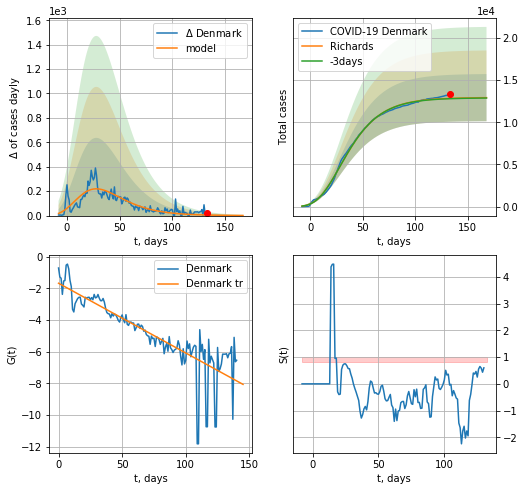

Denmark data at: 2020-09-19
+3 day model MAPE: 0.003205
model: Richards
coeffs: [ 1.29346492e+04  5.54024476e+00 -7.51621135e+01  8.35187087e-03]
rational stdev: 0.216347
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 12914 ± 2794
	 total death: 365 ± 236
trend coefficient of determination: 0.712007
 intercept: -1.674251
 slope: -0.044008


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


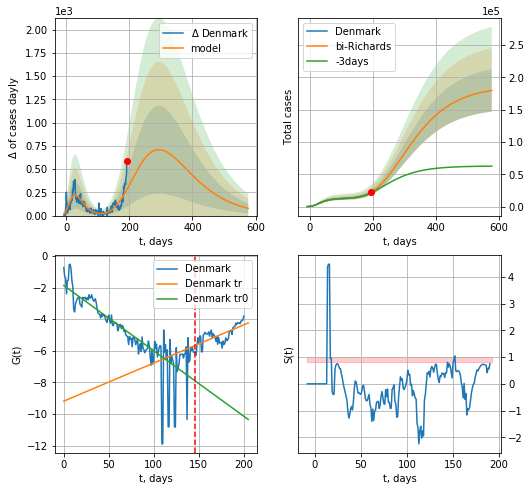

Denmark data at: 2020-09-19
+3 day model MAPE: 0.031576
model: bi-Richards
coeffs: [ 1.74119104e+05  6.63547996e-01 -7.21488971e+01  1.68227759e-02]
rational stdev: 0.182188
forecast at the end of period: +385 days
	 deltaDaycases: 78
	 total cases: 179910 ± 32777
	 total death: 5091 ± 2782
bi-Richards approximation splitting point: 146
trend coefficient of determination: 0.686393
 intercept: -1.866502
 slope: -0.041369
trend coefficient of determination: 0.471725
 intercept: -9.184555
 slope: 0.024135


In [2117]:
vL = 150#125+4
x = forecastRR('Denmark',dfDK[4:vL-4],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Denmark',dfDK[4:],d1,80*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-4)
#x2 = forecast2R('Denmark',dfDK[:],d1,16*7-dT,x,1.0)

In [2118]:
#x = forecastRRR('Denmark',dfDK[:18],d1,T18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[0.35,0.5,4.5,1.])
#x = forecast2RRR('Denmark',dfDK[:],d1,26*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=18)

NG
           date    cases  active  death
202 2020-09-15  12393.0    1757  265.0
203 2020-09-16  12498.0    1862  265.0
204 2020-09-17  12644.0    2007  266.0
205 2020-09-18  12769.0    2131  267.0
206 2020-09-19  12858.0    2220  267.0


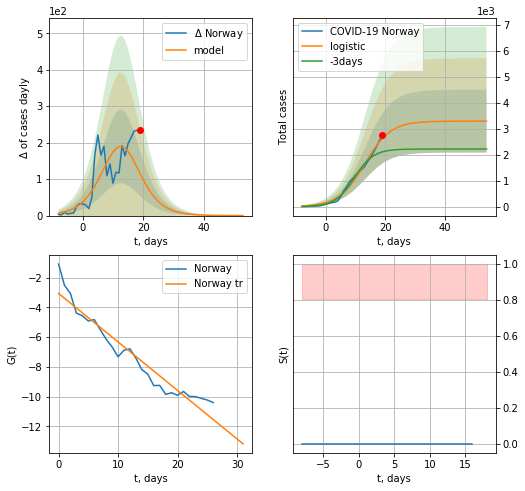

Norway data at: 2020-09-19
+3 day model MAPE: 0.28148190042351234
model: logistic
coeffs:  [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.36743919108062534
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  3297 ± 1211
	 total death:  68 ± 74
trend coefficient of determination: 0.927855
 intercept: -3.067798
 slope: -0.326083


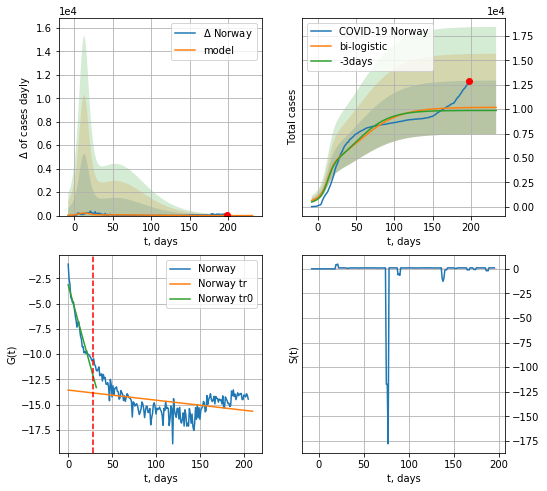

Norway data at: 2020-09-19
+3 day model MAPE: 0.030305907000562585
model: bi-logistic
coeffs:  [6.89498319e+03 3.80088537e-02 5.38420743e+01] [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.27029722865308115
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  10185 ± 2753
	 total death:  211 ± 171
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.135903
 intercept: -13.547079
 slope: -0.009954


In [2119]:
dfNG = read_df(pd.DataFrame(),"NG")
vL=28
x = forecast('Norway',dfNG[:vL],d1,7*T18-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,T18*7-dT,x,1.0,vL=vL)
#xx = np.concatenate((x, xx), axis=0)

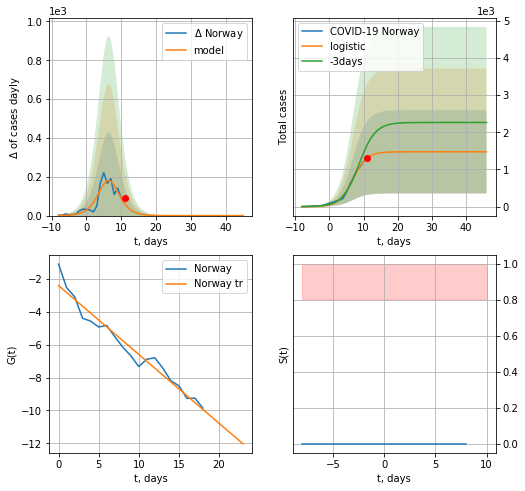

Norway data at: 2020-09-19
+3 day model MAPE: 0.24765534865647335
model: logistic
coeffs:  [1.47478892e+03 4.95866797e-01 6.87524750e+00]
rational stdev:  0.7596156046192828
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  1474 ± 1120
	 total death:  30 ± 68
trend coefficient of determination: 0.956890
 intercept: -2.403448
 slope: -0.418410


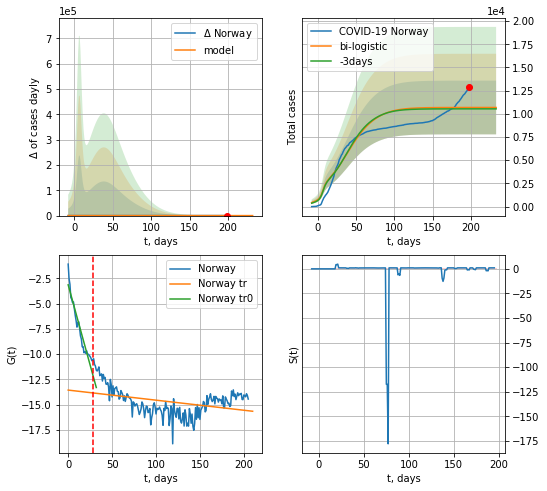

Norway data at: 2020-09-19
+3 day model MAPE: 0.013924356680352107
model: bi-logistic
coeffs:  [8.18542111e+03 6.33163419e-02 3.77448749e+01] [1.47478892e+03 4.95866797e-01 6.87524750e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.27100259118567444
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  10683 ± 2895
	 total death:  221 ± 179
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.135903
 intercept: -13.547079
 slope: -0.009954


In [2120]:
vL = 28#len(dfNG)-13-dT
x = forecast('Norway',dfNG[:-12-dT],d1,7*T18-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,T18*7-dT,x,1.0,addpred=True,xcoef=[0.25/2,1.,2.],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


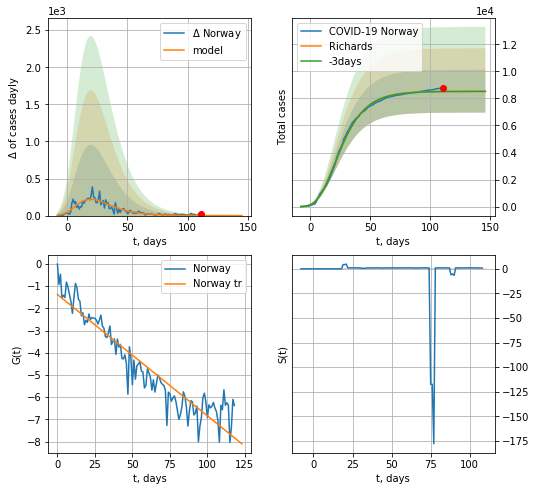

Norway data at: 2020-09-19
+3 day model MAPE: 0.002349
model: Richards
coeffs: [ 8.53893504e+03  9.40298407e+00 -4.93140335e+01  7.49676920e-03]
rational stdev: 0.185681
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 8537 ± 1585
	 total death: 177 ± 98
trend coefficient of determination: 0.886133
 intercept: -1.376205
 slope: -0.054692


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


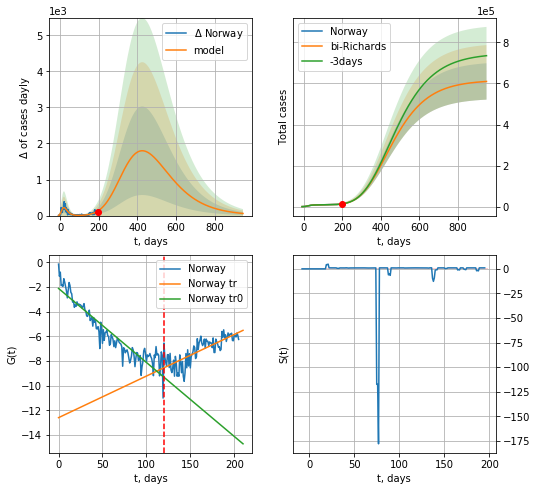

Norway data at: 2020-09-19
+3 day model MAPE: 0.000122
model: bi-Richards
coeffs: [6.08202211e+05 6.36528588e-02 1.91546676e+02 1.34742727e-01]
rational stdev: 0.145259
forecast at the end of period: +749 days
	 deltaDaycases: 58
	 total cases: 609857 ± 88587
	 total death: 12663 ± 5518
bi-Richards approximation splitting point: 120
trend coefficient of determination: 0.880197
 intercept: -2.119243
 slope: -0.059925
trend coefficient of determination: 0.617267
 intercept: -12.584489
 slope: 0.033675


In [2121]:
vL = 120#96+22
x = forecastRR('Norway',dfNG[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Norway',dfNG[:],d1,132*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Norway',dfNG[:],d1,8*7-dT,1.0)

In [2122]:
#x = forecastRRR('Norway',dfNG[:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


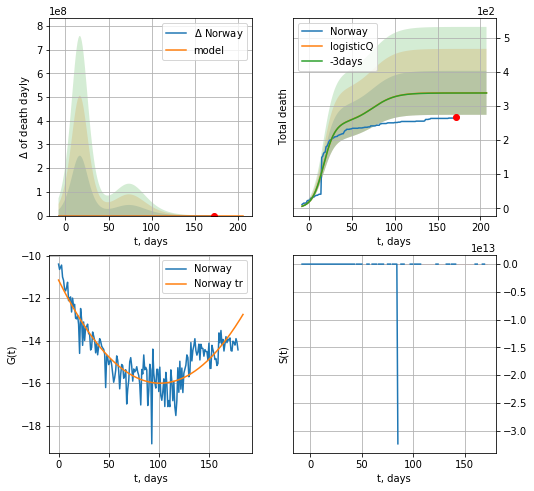

Norway data at: 2020-09-19
+3 day model MAPE: 0.001621
model: logisticQ
coeffs: [ 2.50519645e+02  2.63392398e-07  1.70655151e+01 -5.69647587e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.190428
forecast at the end of period: +35 days
	 total death: 339 ± 64
trend coefficient of determination: 0.782620
 intercept_: -11.150414027796712
 coeffs_: [ 0.         -0.09580766  0.00047291]


In [2123]:
x = forecastRRR('Norway',dfNG[26:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

SW
           date  cases  active   death
203 2020-09-15  87345       0  5851.0
204 2020-09-16  87575       0  5860.0
205 2020-09-17  87885       0  5864.0
206 2020-09-18  88237       0  5865.0
207 2020-09-19  88237       0  5865.0


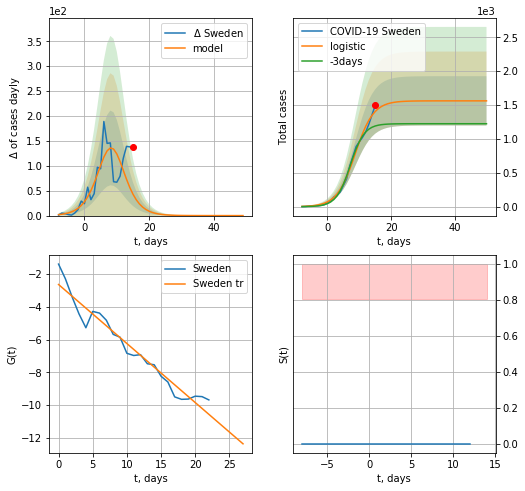

Sweden data at: 2020-09-19
+3 day model MAPE: 0.20348254679733155
model: logistic
coeffs:  [1.56232986e+03 3.49134536e-01 8.72829156e+00]
rational stdev:  0.2329336409619122
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  1562 ± 363
	 total death:  103 ± 71
trend coefficient of determination: 0.947679
 intercept: -2.633085
 slope: -0.360867
Exception occurs


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:485: RuntimeWarning: divide by zero encountered in log


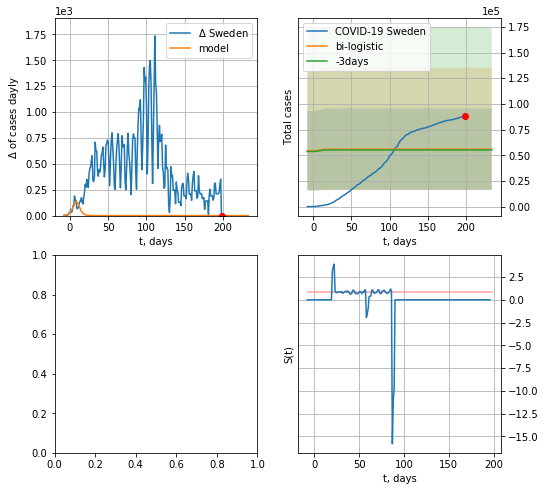

In [2124]:
vL = 15#len(dfSW)-12-dT
dfSW = read_df(pd.DataFrame(),"SW")
try:
    x = forecast('Sweden',dfSW[:-9-dT],d1,7*T18-dT,1.0)
    xx = forecast2('Sweden',dfSW[:],d1,7*T18-dT,x,1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)
except:
    print ("Exception occurs")

SW
           date  cases  active   death
202 2020-09-14  87134       0  5846.0
203 2020-09-15  87345       0  5851.0
204 2020-09-16  87575       0  5860.0
205 2020-09-17  87885       0  5864.0
206 2020-09-18  88237       0  5865.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


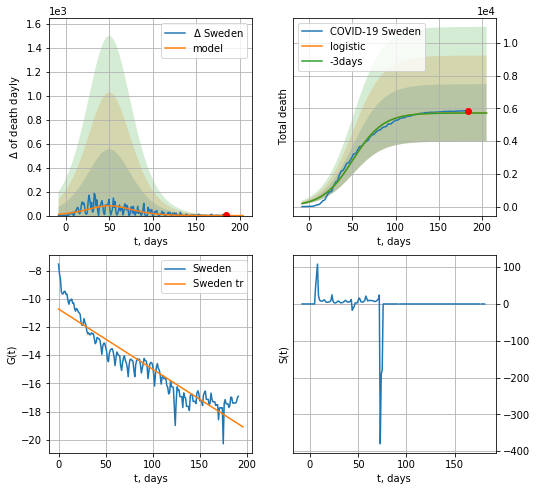

Sweden data at: 2020-09-18
+3 day model MAPE: 0.0011545843983639152
model: logistic
coeffs:  [5.72573744e+03 5.73343142e-02 5.07740320e+01]
rational stdev:  0.3058746711128703
forecast at the end of period: +21 days
	 total death:  5724 ± 1751
trend coefficient of determination: 0.881058
 intercept: -10.728839
 slope: -0.042674


In [1729]:
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[14:],d1,3*7,shift=1.0,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


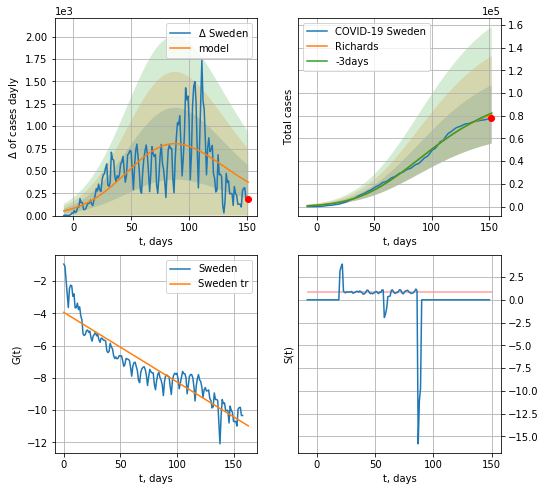

Sweden data at: 2020-09-18
+3 day model MAPE: 0.015048
model: Richards
coeffs: [9.67246034e+04 6.99759012e-02 5.25862336e+01 3.83189345e-01]
rational stdev: 0.316495
forecast at the end of period: +1 days
	 deltaDaycases: 373
	 total cases: 81157 ± 25685
	 total death: 5394 ± 5121
trend coefficient of determination: 0.860612
 intercept: -3.945277
 slope: -0.043120


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


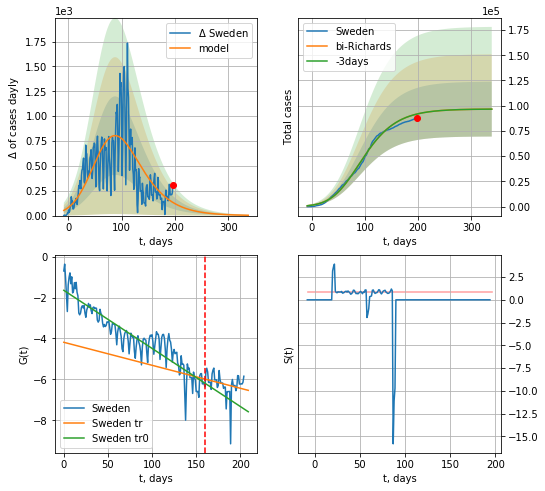

Sweden data at: 2020-09-18
+3 day model MAPE: 0.000000
model: bi-Richards
coeffs: [8.37301207e+02 6.79650389e-02 1.35195399e+01 1.72594460e-02]
rational stdev: 0.281162
forecast at the end of period: +141 days
	 deltaDaycases: 3
	 total cases: 96604 ± 27161
	 total death: 6421 ± 5416
bi-Richards approximation splitting point: 160
trend coefficient of determination: 0.846674
 intercept: -1.648940
 slope: -0.028363
trend coefficient of determination: 0.065167
 intercept: -4.186364
 slope: -0.011225


In [1730]:
iL = 0
vL = 160+iL
x = forecastRR('Sweden',dfSW[iL:vL-iL],d1,25*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Sweden',dfSW[iL:-1],d1,45*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


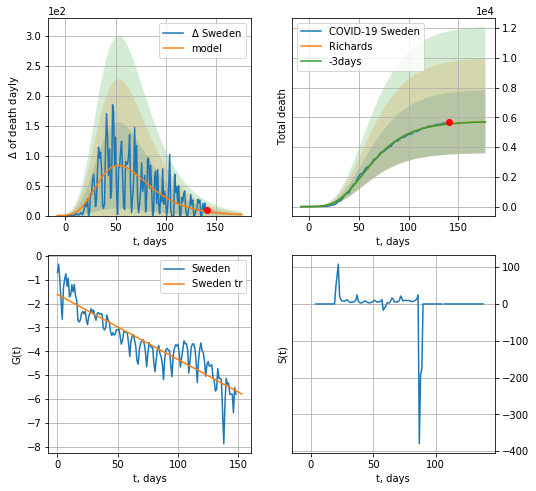

Sweden data at: 2020-09-18
+3 day model MAPE: 0.002445
model: Richards
coeffs: [ 5.75133549e+03  5.79293366e+00 -7.21072797e+01  6.85063513e-03]
rational stdev: 0.372383
forecast at the end of period: +36 days
	 total death: 5708 ± 2125
trend coefficient of determination: 0.814804
 intercept: -1.618399
 slope: -0.027247


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:209: RuntimeWarning: invalid value encountered in true_divide


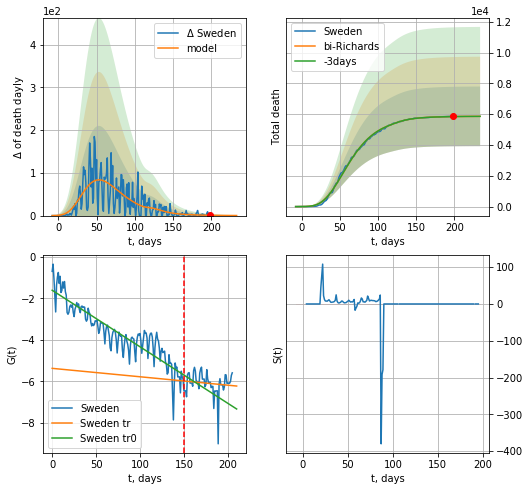

Sweden data at: 2020-09-18
+3 day model MAPE: 0.000232
model: bi-Richards
coeffs: [1.13702385e+02 1.85736408e+01 7.74581775e+01 5.73695615e-03]
rational stdev: 0.330262
forecast at the end of period: +36 days
	 total death: 5860 ± 1935
bi-Richards approximation splitting point: 150
trend coefficient of determination: 0.817986
 intercept: -1.608709
 slope: -0.027257
trend coefficient of determination: 0.014686
 intercept: -5.373477
 slope: -0.004060


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power


In [1731]:
vL = 150
x = forecastRR('Sweden',dfSW[:vL],d1,30*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death')
xx = forecast2RR('Sweden',dfSW[:],d1,30*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death',vL=vL)
#x = forecastQR('Sweden',dfSW[:],d1,16*7-dT,1.0)
#xx = forecast2R('Sweden',dfSW[:],d1,12*7-dT,x,1.0)#,addpred=True,xcoef=[0.25,1.,2.3,1]

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


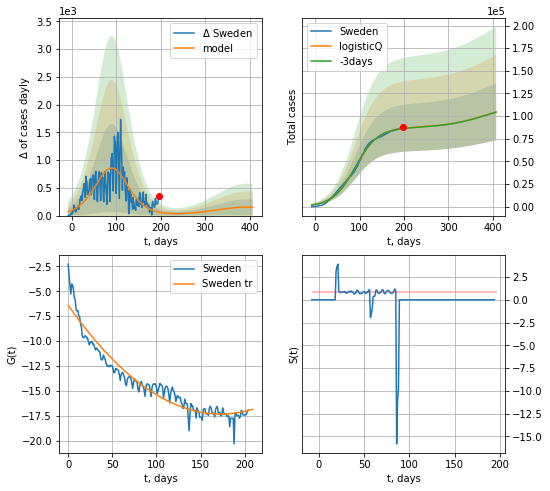

Sweden data at: 2020-09-18
+3 day model MAPE: 0.002391
model: logisticQ
coeffs: [ 8.69760418e+04  3.57469477e-07  9.03436594e+01 -1.10020363e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.299517
forecast at the end of period: +211 days
	 deltaDaycases: 149
	 total cases: 104532 ± 31309
	 total death: 6948 ± 6243
trend coefficient of determination: 0.929694
 intercept_: -6.411294611991694
 coeffs_: [ 0.         -0.12603315  0.00036433]


In [1732]:
x = forecastRRR('Sweden',dfSW[1:],d1,55*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


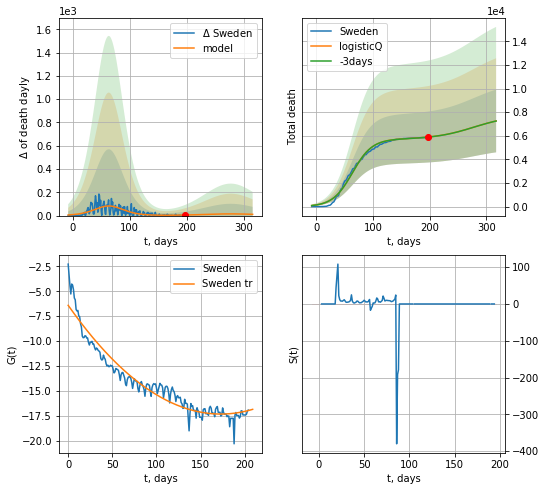

Sweden data at: 2020-09-18
+3 day model MAPE: 0.001120
model: logisticQ
coeffs: [ 5.72153008e+03  1.15070854e-07  6.37599976e+01 -5.02088316e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.366084
forecast at the end of period: +120 days
	 total death: 7255 ± 2656
trend coefficient of determination: 0.929694
 intercept_: -6.411294611991694
 coeffs_: [ 0.         -0.12603315  0.00036433]


In [1733]:
x = forecastRRR('Sweden',dfSW[1:],d1,42*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')

CN
           date    cases  active   death
237 2020-09-15  85214.0     143  4634.0
238 2020-09-16  85223.0     141  4634.0
239 2020-09-17  85255.0     165  4634.0
240 2020-09-18  85269.0     171  4634.0
241 2020-09-19  85279.0     168  4634.0


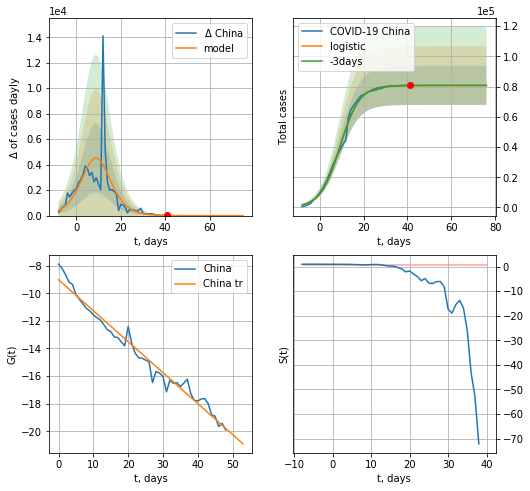

China data at: 2020-09-19
+3 day model MAPE: 0.00012785692963974442
model: logistic
coeffs:  [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.159713160092933
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  80810 ± 12906
	 total death:  4391 ± 2103
trend coefficient of determination: 0.972183
 intercept: -9.021396
 slope: -0.224243


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


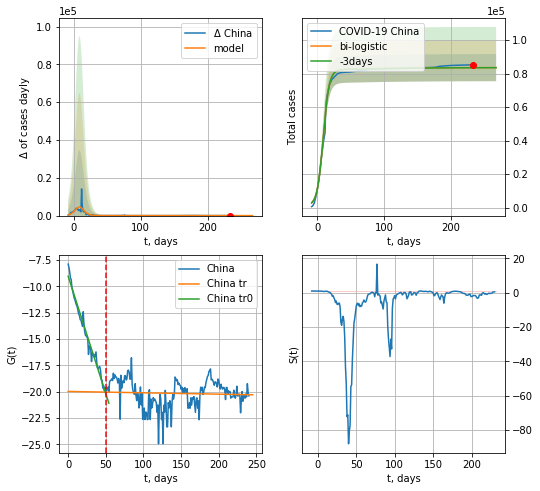

China data at: 2020-09-19
+3 day model MAPE: 0.0005086582540857048
model: bi-logistic
coeffs:  [2.83505784e+03 1.58013859e-02 1.16766137e+01] [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.09693073504012308
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  83596 ± 8103
	 total death:  4542 ± 1320
bi-logistic approximation splitting point: 50
trend0 coefficient of determination: 0.973282
 intercept: -9.036652
 slope: -0.223289
trend coefficient of determination: 0.003046
 intercept: -19.980109
 slope: -0.001294


In [2125]:
dfCN = read_df(pd.DataFrame(),"CN")
try:
    x = forecast('China',dfCN[:50],d1,7*T18-dT,1.0)
    #xx = forecast('China',dfCN[21:-32],d1,17)
    #xx = np.concatenate((x, xx), axis=0)
    xx = forecast2('China',dfCN[:],d1,T18*7-dT,x,1.0,vL=50)
except:
    print ("Exception occurs")

In [2126]:
#dfTT[dfTT.Country=='%s'%('China')][0].values[0]

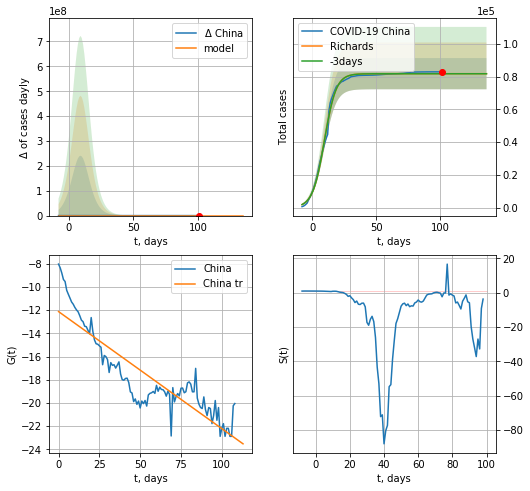

China data at: 2020-09-19
+3 day model MAPE: 0.000627
model: Richards
coeffs: [8.17736184e+04 2.15574455e-01 9.59539709e+00 1.02116174e+00]
rational stdev: 0.116457
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 81773 ± 9523
	 total death: 4443 ± 1552
trend coefficient of determination: 0.785239
 intercept: -12.125055
 slope: -0.100960


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


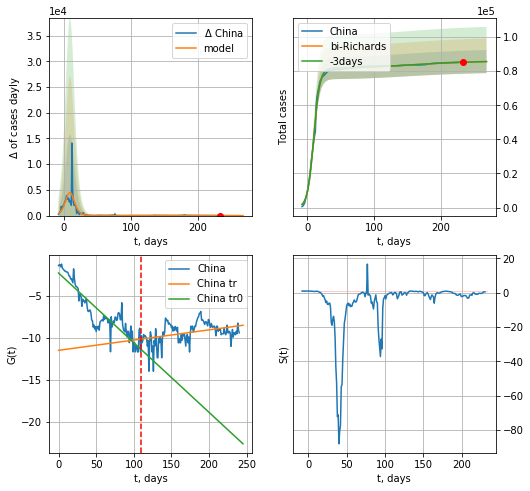

China data at: 2020-09-19
+3 day model MAPE: 0.000099
model: bi-Richards
coeffs: [ 4.54211808e+03  5.12364736e-01 -9.93099376e+01  2.85106404e-02]
rational stdev: 0.079098
forecast at the end of period: +35 days
	 deltaDaycases: 9
	 total cases: 85630 ± 6773
	 total death: 4653 ± 1104
bi-Richards approximation splitting point: 110
trend coefficient of determination: 0.820864
 intercept: -2.237651
 slope: -0.083140
trend coefficient of determination: 0.147379
 intercept: -11.457267
 slope: 0.012203


In [2127]:
vL = 110
x = forecastRR('China',dfCN[:vL],d1,T18*7-dT,1.0)
xx = forecast2RR('China',dfCN[:],d1,30*7-dT,x,1.0,vL=vL)
#x = forecastQR('China',dfCN[:],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
#xx = forecast2R('China',dfCN[:],d1,6*7-dT,x,1.0)

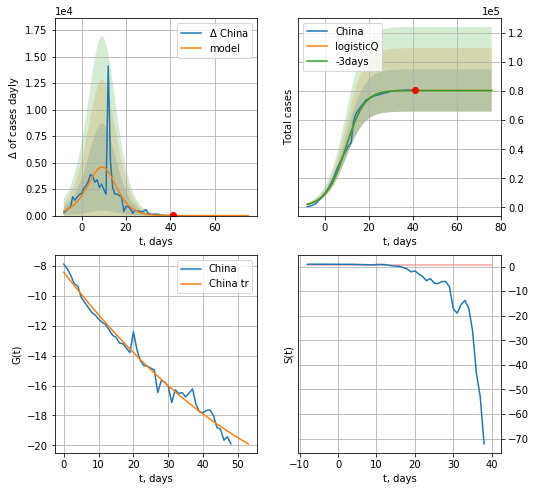

China data at: 2020-09-19
+3 day model MAPE: 0.001323
model: logisticQ
coeffs: [ 8.04175259e+04  1.07650464e-03  9.35257489e+00 -2.02425637e+02]
rational stdev: 0.181019
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 80417 ± 14557
	 total death: 4369 ± 2372
trend coefficient of determination: 0.979964
 intercept_: -8.428864441790822
 coeffs_: [ 0.         -0.29994819  0.00157784]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


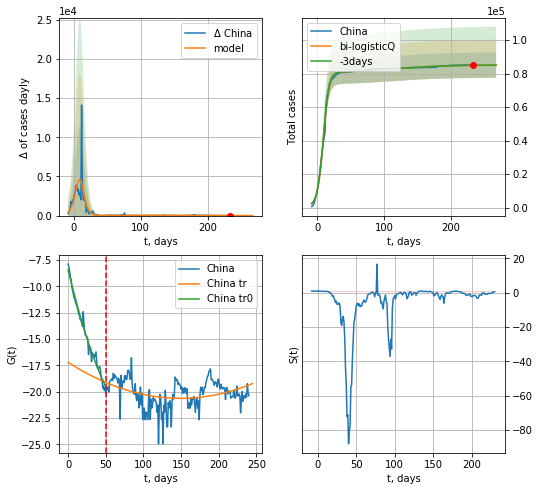

China data at: 2020-09-19
+3 day model MAPE: 0.000564
model: bi-logisticQ
coeffs: [ 4.76329202e+03  3.51349372e-08  1.12948973e+02 -6.89750273e+05]
rational stdev: 0.089184
forecast at the end of period: +35 days
	 deltaDaycases: 2
	 total cases: 85072 ± 7587
	 total death: 4622 ± 1236
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.980847
 intercept_: -8.442415731989867
 coeffs_: [ 0.         -0.29762768  0.00151769]
trend coefficient of determination: 0.107096
 intercept_: -17.221908193778738
 coeffs_: [ 0.         -0.04576889  0.00015336]


In [2128]:
x = forecastRRR('China',dfCN[:50],d1,7*T18-dT,1.0)
xx=forecast2RRR('China',dfCN[:],d1,T18*7-dT,x,1.0,vL=50)

In [2129]:
#x = forecastQR('China',dfCN[50:],d1,6*7-dT,1.0)

KR
           date  cases  active  death
213 2020-09-15  22504  2827.0  367.0
214 2020-09-16  22657  2742.0  372.0
215 2020-09-17  22783  2635.0  377.0
216 2020-09-18  22893  2545.0  378.0
217 2020-09-19  22975  2434.0  383.0


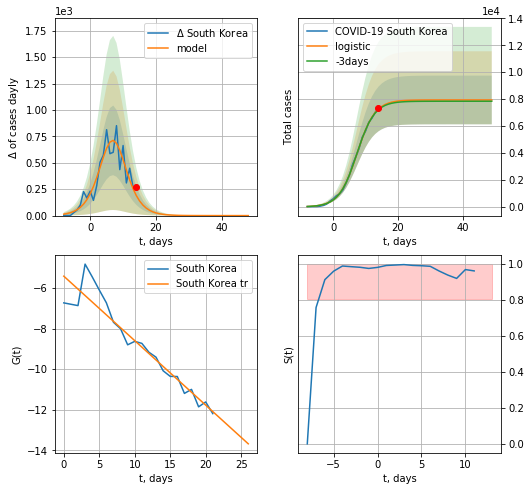

South Korea data at: 2020-09-19
model: logistic
coeffs:  [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.2275932520547523
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  7941 ± 1807
	 total death:  132 ± 90
trend coefficient of determination: 0.904554
 intercept: -5.419235
 slope: -0.317547


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


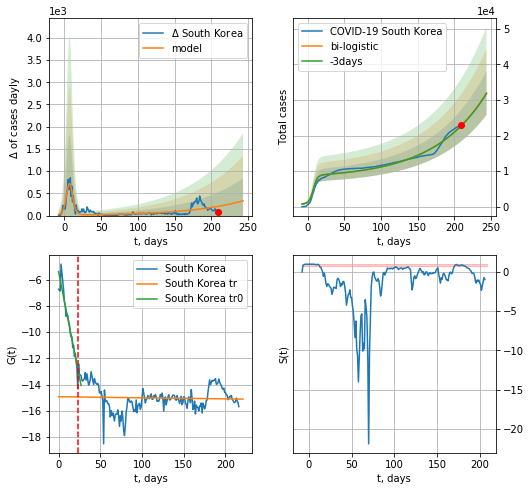

South Korea data at: 2020-09-19
+3 day model MAPE: 0.003335774388584947
model: bi-logistic
coeffs:  [3.37616714e+07 1.39337091e-02 7.64051103e+02] [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.19323653007706415
forecast at the end of period: +35 days
	 deltaDaycases:  332
	 total cases:  31991 ± 6181
	 total death:  533 ± 308
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.916463
 intercept: -5.394262
 slope: -0.321115
trend coefficient of determination: 0.002371
 intercept: -14.922697
 slope: -0.000817


In [2130]:
dfKR = read_df(pd.DataFrame(),"KR")
x = forecast('South Korea',dfKR[:23],d1,7*T18-dT,1.0,pMAPE=False)
xx=forecast2('South Korea',dfKR[:],d1,T18*7-dT,x,1.0,vL=23)

In [2131]:
#vL = 30
#x = forecastRRR('South Korea',dfKR[:vL],d1,8*7-dT,1.0)
#x1 = forecastRRR('South Korea',dfKR[39:],d1,12*7-dT,1.0)
#xx = np.concatenate((x, x1), axis=0)
#xx=forecast2RRR('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=vL)

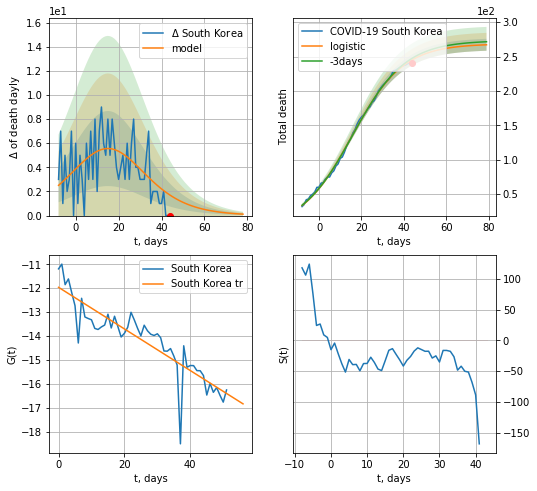

South Korea data at: 2020-09-19
model: logistic
coeffs:  [2.68513907e+02 8.28168907e-02 1.55065021e+01]
rational stdev:  0.032418936831668854
forecast at the end of period: +35 days
	 total death:  267 ± 8
trend coefficient of determination: 0.782213
 intercept: -11.965009
 slope: -0.087016


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:251: RuntimeWarning: divide by zero encountered in true_divide


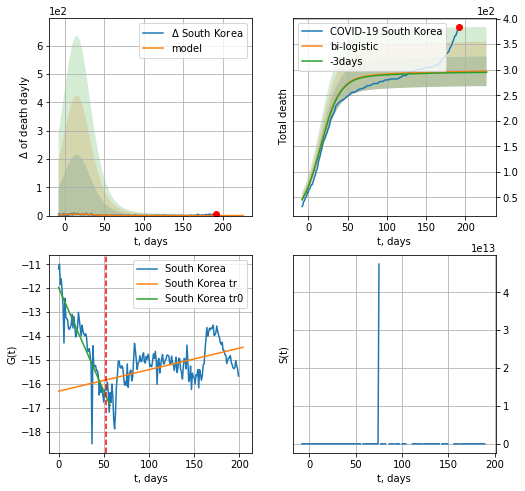

South Korea data at: 2020-09-19
+3 day model MAPE: 0.006739861753106295
model: bi-logistic
coeffs:  [2.96310207e+01 1.45247537e-02 9.67529548e+00] [2.68513907e+02 8.28168907e-02 1.55065021e+01]
rational stdev:  0.09754237276122138
forecast at the end of period: +35 days
	 deltaDaydeath:  0
	 total death:  296 ± 28
bi-logistic approximation splitting point: 53
trend0 coefficient of determination: 0.789613
 intercept: -11.973248
 slope: -0.086531
trend coefficient of determination: 0.260747
 intercept: -16.308974
 slope: 0.009001


In [2132]:
x = forecast('South Korea',dfKR[17:70],d1,T18*7-dT,1.0,cases='death',pMAPE=False)
xx=forecast2('South Korea',dfKR[17:],d1,T18*7-dT,x,1.0,vL=70-17,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


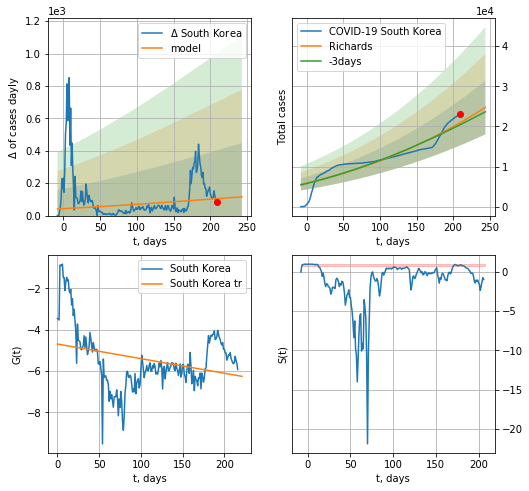

South Korea data at: 2020-09-19
+3 day model MAPE: 0.025031
model: Richards
coeffs: [ 2.99177373e+05  6.60890592e-02 -1.07534535e+03  2.95029238e-02]
rational stdev: 0.270498
forecast at the end of period: +35 days
	 deltaDaycases: 115
	 total cases: 24713 ± 6684
	 total death: 411 ± 333
trend coefficient of determination: 0.090283
 intercept: -4.698765
 slope: -0.007073


In [2133]:
x = forecastRR('South Korea',dfKR[:],d1,T18*7-dT,1.0)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


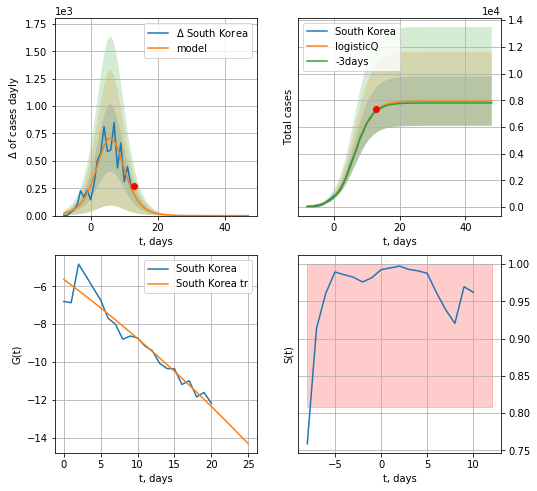

South Korea data at: 2020-09-19
+3 day model MAPE: 0.011158
model: logisticQ
coeffs: [ 7.93644740e+03  5.70893336e-05  6.37140939e+00 -6.30084107e+03]
rational stdev: 0.233522
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 7936 ± 1853
	 total death: 132 ± 92
trend coefficient of determination: 0.923340
 intercept_: -5.639271391154587
 coeffs_: [ 0.         -0.28882126 -0.00235709]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


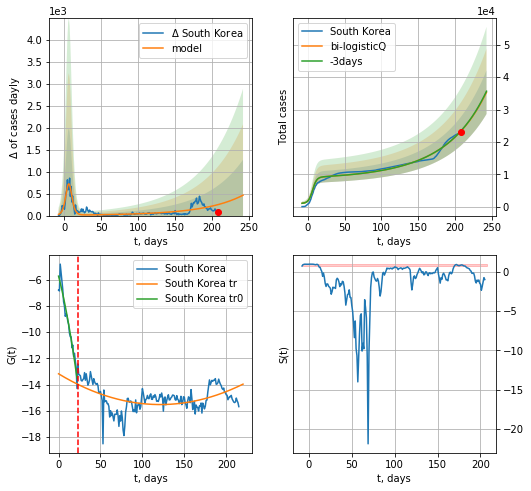

South Korea data at: 2020-09-19
+3 day model MAPE: 0.003038
model: bi-logisticQ
coeffs: [ 1.36203378e+06  1.66897621e-05  4.31813867e+02 -9.90145061e+02]
rational stdev: 0.190327
forecast at the end of period: +35 days
	 deltaDaycases: 463
	 total cases: 35334 ± 6725
	 total death: 589 ± 336
bi-logisticQ approximation splitting point: 23
trend coefficient of determination: 0.939645
 intercept_: -5.742054822567119
 coeffs_: [ 0.         -0.24685696 -0.00483449]
trend coefficient of determination: 0.222958
 intercept_: -13.177399692908743
 coeffs_: [ 0.         -0.0386382   0.00015935]


In [2134]:
vL=23
x = forecastRRR('South Korea',dfKR[1:vL],d1,T18*7-dT,1.0)
xx=forecast2RRR('South Korea',dfKR[1:],d1,T18*7-dT,x,1.0,vL=vL)

In [2135]:
#x = forecastRR('South Korea',dfKR[68:],d1,10*7-dT,1.0)

In [2136]:
#vL=25
#x = forecastQR('South Korea',dfKR[1:vL],d1,16*7-dT,1.0)
#xx=forecast2QR('South Korea',dfKR[1:],d1,16*7-dT,x,1.0,vL=vL)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


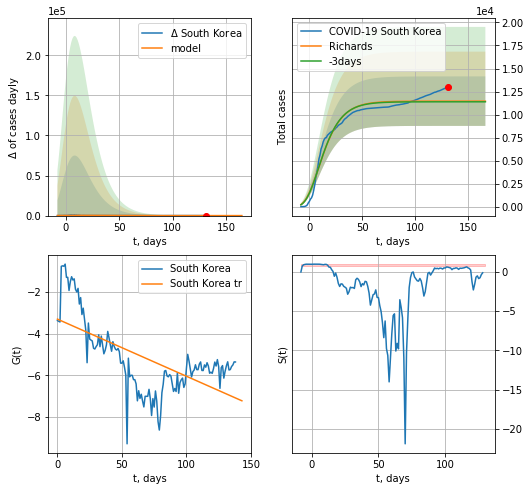

South Korea data at: 2020-09-19
+3 day model MAPE: 0.006245
model: Richards
coeffs: [ 1.14621909e+04  2.64955361e+01 -6.29475021e+01  3.05260511e-03]
rational stdev: 0.234092
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 11462 ± 2683
	 total death: 191 ± 134
trend coefficient of determination: 0.403266
 intercept: -3.307543
 slope: -0.027367


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


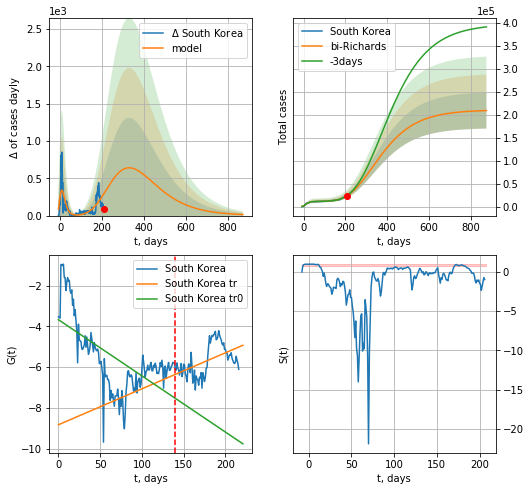

South Korea data at: 2020-09-19
+3 day model MAPE: 0.021193
model: bi-Richards
coeffs: [ 1.99449966e+05  1.90364106e-01 -1.20089781e+01  4.69498226e-02]
rational stdev: 0.187035
forecast at the end of period: +665 days
	 deltaDaycases: 13
	 total cases: 209372 ± 39160
	 total death: 3490 ± 1958
bi-Richards approximation splitting point: 140
trend coefficient of determination: 0.403212
 intercept: -3.669319
 slope: -0.027602
trend coefficient of determination: 0.259063
 intercept: -8.833161
 slope: 0.017676


In [2137]:
iL = 0
vL = 140+iL
x = forecastRR('South Korea',dfKR[iL:vL-iL],d1,T18*7-dT,1.0)
xx=forecast2RR('South Korea',dfKR[iL:],d1,120*7-dT,x,1.0,vL=vL-iL)
#xx = np.concatenate((x, xx), axis=0)
#print (xx)
#xxx=forecast3RR('South Korea',dfKR[1:],d1,12*7-dT,xx,1.0,vL=[vL,vL1],zoom=1e3)

In [2138]:
a = np.array([ 7.90607495e+03,  3.14377481e-03, -1.32150046e+02,  5.22462480e+00, 7.59593205e-01])
b = np.array([ 2.91876181e+03,  1.43325056e-01, -3.99886263e+01, -3.39427361e+02, 1.77367535e-03])
QRkoreaCoeffs=b/a
QRkoreaCoeffs,RkoreaCoeffs,koreaCoeffs

(array([ 3.69179628e-01,  4.55901153e+01,  3.02600169e-01, -6.49668395e+01,
         2.33503320e-03]),
 [0.36242246, 2.56241634, 1.84890887, 0.13324732],
 [0.35416971, 0.02606324, 4.35859408, 19.30413219])

In [2139]:
#x = forecastQR('South Korea',dfKR[:],d1,16*7-dT,1.0)

SG
           date    cases  active  death
236 2020-09-15  57515.0     604   27.0
237 2020-09-16  57532.0     550   27.0
238 2020-09-17  57543.0     477   27.0
239 2020-09-18  57558.0     460   27.0
240 2020-09-19  57576.0     407   27.0


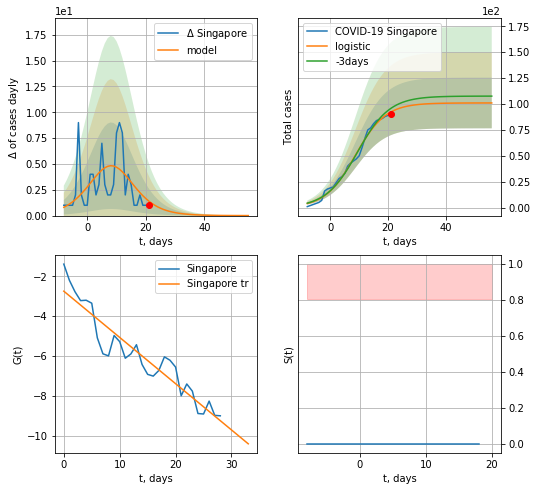

Singapore data at: 2020-09-19
+3 day model MAPE: 0.03963437966370839
model: logistic
coeffs:  [101.02990869   0.19128696   8.67555654]
rational stdev:  0.24212715882466435
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  101 ± 24
	 total death:  0 ± 0
trend coefficient of determination: 0.887345
 intercept: -2.744831
 slope: -0.232145


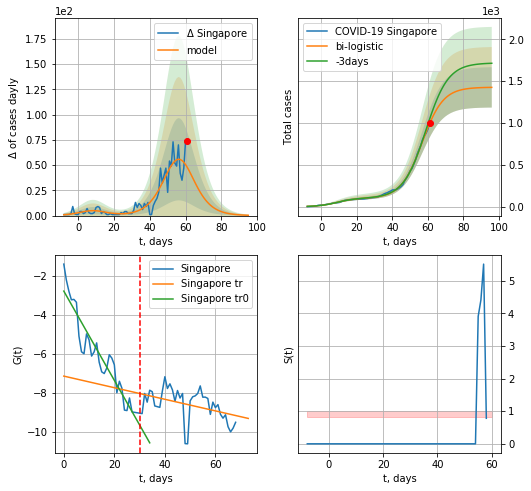

Singapore data at: 2020-09-19
+3 day model MAPE: 0.06119827726371909
model: bi-logistic
coeffs:  [1.32695355e+03 1.68329223e-01 5.66911530e+01] [101.02990869   0.19128696   8.67555654]
rational stdev:  0.16894112356490856
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  1426 ± 240
	 total death:  0 ± 0
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend coefficient of determination: 0.177815
 intercept: -7.138791
 slope: -0.029776


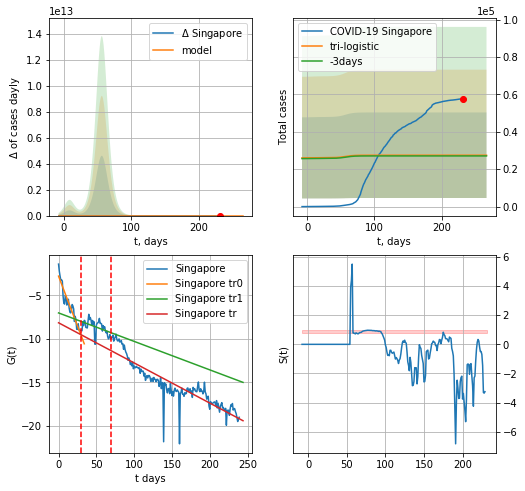

Singapore data at: 2020-09-19
+3 day model MAPE: 0.014000029078511155
model: tri-logistic
coeffs:  [ 2.60420970e+04 -1.66305163e+01  4.02522580e+02] [1.01029909e+02 1.91286963e-01 8.67555654e+00 1.32695355e+03
 1.68329223e-01 5.66911530e+01]
forecast rational stdev:  0.8324661816319074
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  27470 ± 22867
	 total death:  12 ± 29
tri-logistic approximation splitting points: 30,70
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend1 coefficient of determination: 0.215531
 intercept: -7.009854
 slope: -0.032798
trend coefficient of determination: 0.801894
 intercept: -8.145982
 slope: -0.046248


In [2140]:
vL = 30
vL1 = 70
try:
    dfSG = read_df(pd.DataFrame(),"SG")
    x = forecast('Singapore',dfSG[:vL],d1,7*T18-dT,1.0)
    xx = forecast2('Singapore',dfSG[:vL1],d1,T18*7-dT,x,1.0,vL=vL)
    xx = np.concatenate((x, xx), axis=0)
    xxx = forecast3("Singapore",dfSG,d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])
except:
    print ("Exception occurs")

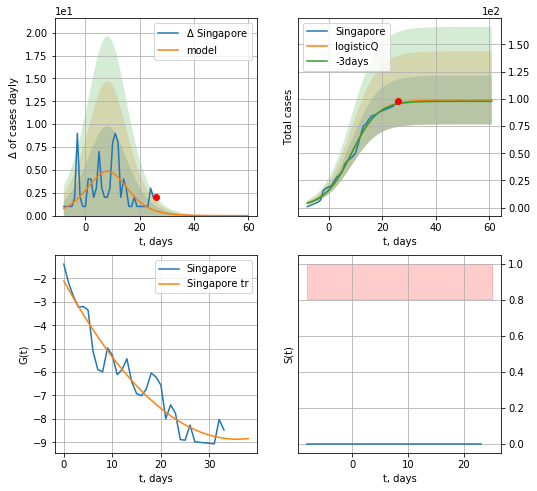

Singapore data at: 2020-09-19
+3 day model MAPE: 0.007575
model: logisticQ
coeffs: [ 9.88556613e+01  2.70689941e-04  8.43151450e+00 -7.17657610e+02]
rational stdev: 0.226599
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 98 ± 22
	 total death: 0 ± 0
trend coefficient of determination: 0.918167
 intercept_: -2.103369555726971
 coeffs_: [ 0.         -0.37832792  0.00528917]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


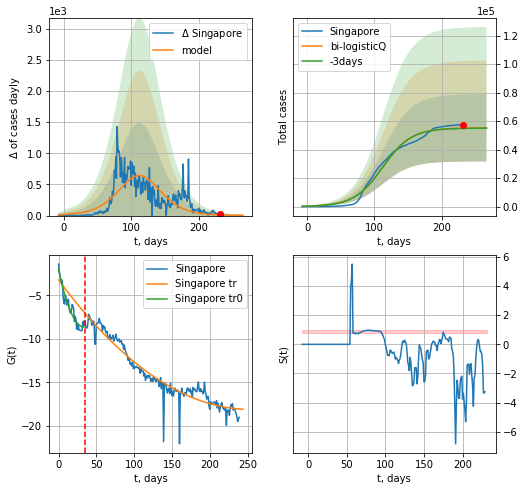

Singapore data at: 2020-09-19
+3 day model MAPE: 0.003497
model: bi-logisticQ
coeffs: [ 5.51139151e+04  5.51710010e-08  1.12363724e+02 -8.46169308e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.427062
forecast at the end of period: +35 days
	 deltaDaycases: 4
	 total cases: 55276 ± 23606
	 total death: 25 ± 32
bi-logisticQ approximation splitting point: 35
trend coefficient of determination: 0.914568
 intercept_: -2.036640634366525
 coeffs_: [ 0.         -0.39517788  0.00592335]
trend coefficient of determination: 0.922184
 intercept_: -3.211452923984222
 coeffs_: [ 0.         -0.11752328  0.00023143]


In [2141]:
vL = 35
x = forecastRRR('Singapore',dfSG[:vL],d1,7*T18-dT,1.0)
xx = forecast2RRR('Singapore',dfSG[:],d1,T18*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

In [2142]:
#vL = 31
#x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
#xx = forecast2('Singapore',dfSG[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


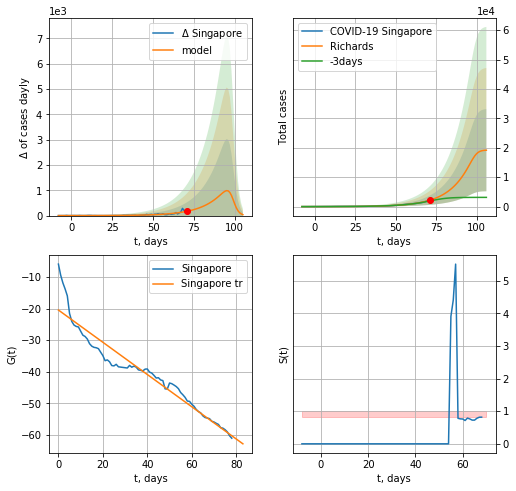

Singapore data at: 2020-09-19
+3 day model MAPE: 0.158856
model: Richards
coeffs: [1.92302023e+04 7.72500001e-02 9.92482833e+01 7.56752958e+00]
rational stdev: 0.728321
forecast at the end of period: +35 days
	 deltaDaycases: 37
	 total cases: 19181 ± 13970
	 total death: 8 ± 17
trend coefficient of determination: 0.919778
 intercept: -20.482187
 slope: -0.510333


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


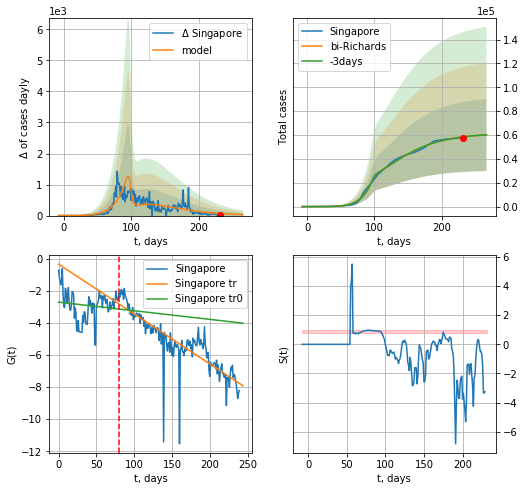

Singapore data at: 2020-09-19
+3 day model MAPE: 0.001685
model: bi-Richards
coeffs: [ 4.22183830e+04  1.75559294e+00 -5.85817944e+01  1.35016283e-02]
rational stdev: 0.502492
forecast at the end of period: +35 days
	 deltaDaycases: 32
	 total cases: 60080 ± 30189
	 total death: 28 ± 42
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.017409
 intercept: -2.702518
 slope: -0.005371
trend coefficient of determination: 0.710080
 intercept: -0.332095
 slope: -0.031090


In [2143]:
iL = 0
vL = 80+iL
x = forecastRR('Singapore',dfSG[iL:vL+iL],d1,T18*7-dT,1.0)
x = forecast2RR('Singapore',dfSG[iL:],d1,30*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#xx = forecast2R('Singapore',dfSG[:],d1,28*7-dT,x,1.0)
#x = forecastQR('Singapore',dfSG[60:],d1,16*7-dT,1.0)

ES
           date   cases  active  death
187 2020-09-15  2722.5     372   64.0
188 2020-09-16  2778.0     377   64.0
189 2020-09-17  2814.0     393   64.0
190 2020-09-18  2875.0     437   64.0
191 2020-09-19  2924.0     483   64.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


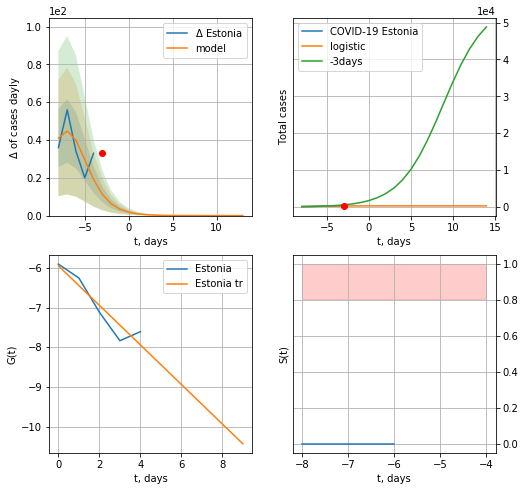

Estonia data at: 2020-09-19
+3 day model MAPE: 0.6707560325989319
model: logistic
coeffs:  [277.64023437   0.65084323  -6.57074778]
rational stdev:  0.028784635369283593
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  277 ± 7
	 total death:  6 ± 0
trend coefficient of determination: 0.881874
 intercept: -5.949047
 slope: -0.498463


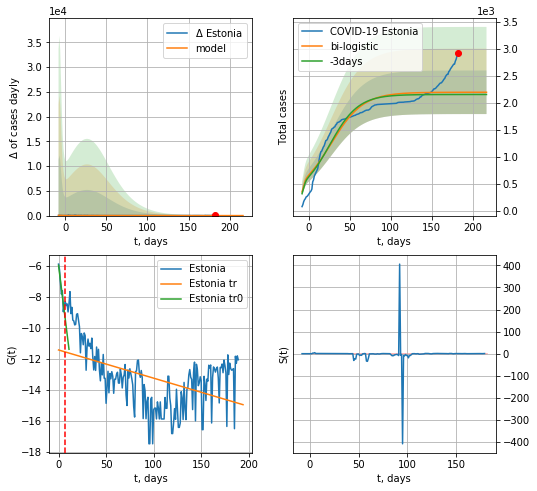

Estonia data at: 2020-09-19
+3 day model MAPE: 0.018970133537602366
model: bi-logistic
coeffs:  [1.92286156e+03 5.10444680e-02 2.70521356e+01] [277.64023437   0.65084323  -6.57074778]
rational stdev:  0.18369260394881542
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  2200 ± 404
	 total death:  48 ± 26
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.894917
 intercept: -5.986038
 slope: -0.491580
trend coefficient of determination: 0.227998
 intercept: -11.438565
 slope: -0.018169


In [2144]:
shift = 1.0
try:
    dfES = read_df(pd.DataFrame(),"ES")
    x = forecast('Estonia',dfES[1:7],d1,17,1.)
    xx = forecast2('Estonia',dfES[1:],d1,T18*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.5],vL=7)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


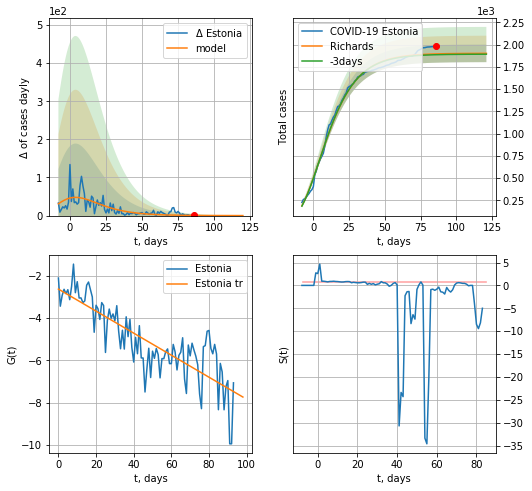

Estonia data at: 2020-09-19
+3 day model MAPE: 0.004828
model: Richards
coeffs: [ 1.90234229e+03  8.05122761e+00 -6.49439772e+01  8.53882183e-03]
rational stdev: 0.052085
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 1901 ± 99
	 total death: 41 ± 6
trend coefficient of determination: 0.683583
 intercept: -2.627136
 slope: -0.052184


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


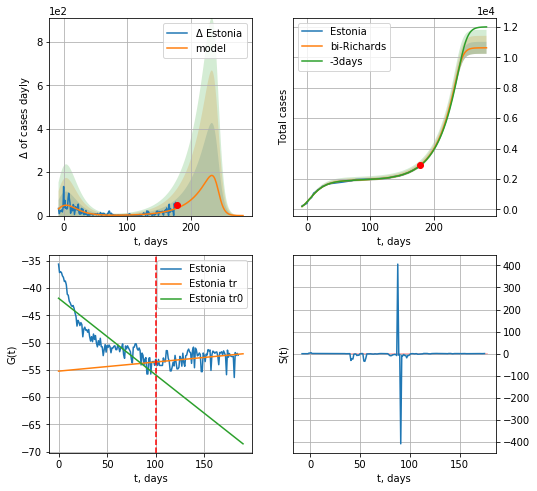

Estonia data at: 2020-09-19
+3 day model MAPE: 0.004856
model: bi-Richards
coeffs: [8.72532396e+03 3.41429835e-02 2.42114218e+02 6.04151793e+00]
rational stdev: 0.037087
forecast at the end of period: +105 days
	 deltaDaycases: 0
	 total cases: 10627 ± 394
	 total death: 232 ± 25
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.766205
 intercept: -41.857778
 slope: -0.140446
trend coefficient of determination: 0.104950
 intercept: -55.221463
 slope: 0.016733


In [2146]:
iL = 5
vL=100+iL
x = forecastRR('Estonia',dfES[iL:vL-iL],d1,7*T18-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
#x = forecastQR('Estonia',dfES[10:],d1,7*10-dT,1.)
xx = forecast2RR('Estonia',dfES[iL:],d1,7*40-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [2147]:
#x = forecastRRR('Estonia',dfES[:],d1,7*T18-dT,1.,addpred=True,xcoef=[0.35/8,.5,4.,1])

LV
           date   cases  active  death
192 2020-09-15  1486.0     203   35.0
193 2020-09-16  1494.0     210   36.0
194 2020-09-17  1498.0     214   36.0
195 2020-09-18  1515.0     231   36.0
196 2020-09-19  1525.0     241   36.0


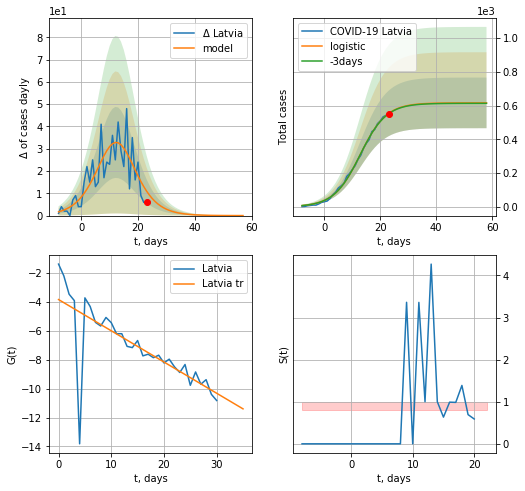

Latvia data at: 2020-09-19
+3 day model MAPE: 0.003263338184172393
model: logistic
coeffs:  [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.24373797630646024
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  616 ± 150
	 total death:  14 ± 10
trend coefficient of determination: 0.538666
 intercept: -3.837099
 slope: -0.216023


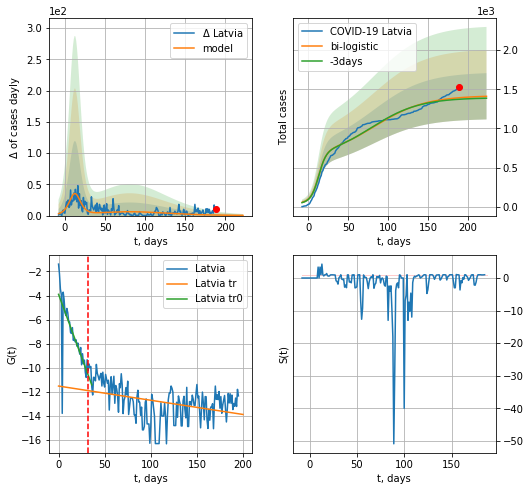

Latvia data at: 2020-09-19
+3 day model MAPE: 0.014153309069266559
model: bi-logistic
coeffs:  [8.03953200e+02 3.07790457e-02 8.11390092e+01] [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.20958318799399903
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  1409 ± 295
	 total death:  33 ± 20
bi-logistic approximation splitting point: 32
trend0 coefficient of determination: 0.543521
 intercept: -3.904452
 slope: -0.209287
trend coefficient of determination: 0.144473
 intercept: -11.539992
 slope: -0.011826


In [2148]:
vL=32
dfLV = read_df(pd.DataFrame(),"LV")
try:
    x = forecast('Latvia',dfLV[:vL],d1,T18*7-dT,1.)
    xx=forecast2('Latvia',dfLV[:],d1,T18*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.],vL=vL)
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


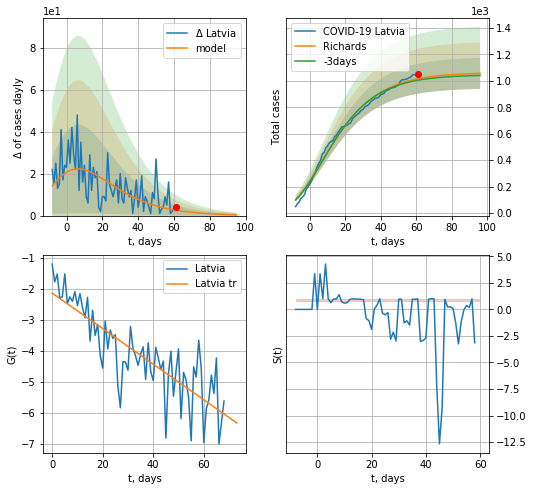

Latvia data at: 2020-09-19
+3 day model MAPE: 0.011078
model: Richards
coeffs: [ 1.06333537e+03  7.08982273e+00 -7.72639807e+01  8.06725773e-03]
rational stdev: 0.110885
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 1056 ± 117
	 total death: 24 ± 7
trend coefficient of determination: 0.685809
 intercept: -2.142789
 slope: -0.057409


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


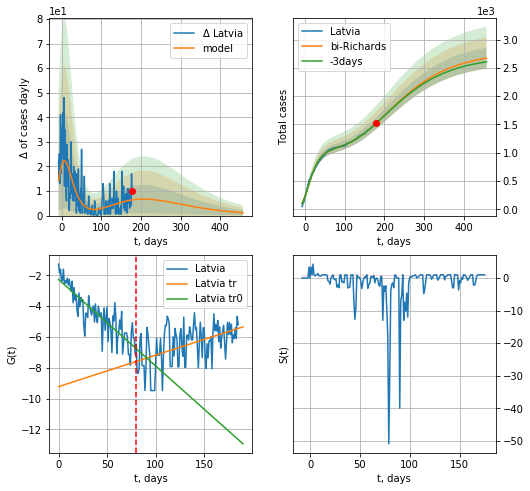

Latvia data at: 2020-09-19
+3 day model MAPE: 0.001452
model: bi-Richards
coeffs: [ 1.71820954e+03  4.53824488e-01 -1.42002302e+02  2.36671430e-02]
rational stdev: 0.069029
forecast at the end of period: +280 days
	 deltaDaycases: 1
	 total cases: 2670 ± 184
	 total death: 63 ± 13
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.733112
 intercept: -2.269485
 slope: -0.056153
trend coefficient of determination: 0.235727
 intercept: -9.226305
 slope: 0.020436


In [2150]:
iL=10
vL = 80+iL
x = forecastRR('Latvia',dfLV[iL:vL-iL],d1,7*T18-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Latvia',dfLV[iL:],d1,7*65-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastQR('Latvia',dfLV[:],d1,7*16-dT,1.)
#xx=forecast2R('Latvia',dfLV[:],d1,10*7-dT,x)

In [2151]:
#trend3(dfCA[12:],dfPT,dfTR[4:],'CA','PT','TR',40,40,40)
#x = forecastRRR('Latvia',dfLV[:],d1,7*T18-dT,1.,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


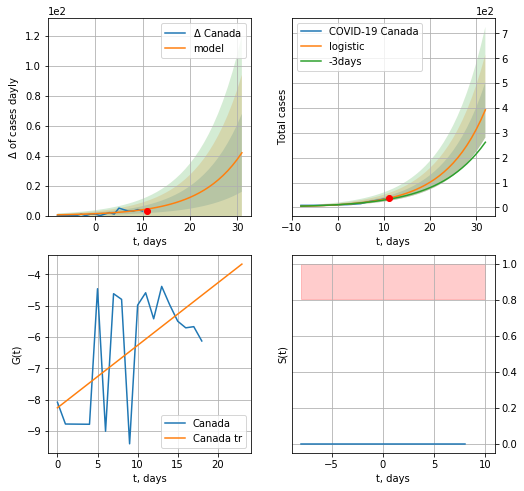

Canada data at: 2020-09-19
+3 day model MAPE: 0.14133490187696762
model: logistic
coeffs:  [1.25342997e+05 1.13222116e-01 8.29018541e+01]
rational stdev:  0.2833740936364515
forecast at the end of period: +21 days
	 deltaDaycases:  41
	 total cases:  392 ± 111
	 total death:  25 ± 21
trend coefficient of determination: 0.348503
 intercept: -8.254919
 slope: 0.199271


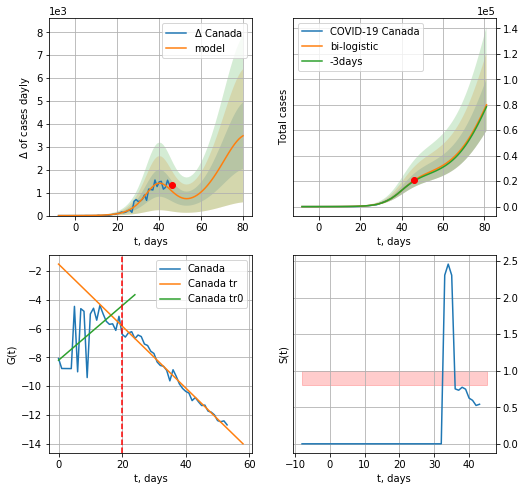

Canada data at: 2020-09-19
+3 day model MAPE: 0.029367009846107475
model: bi-logistic
coeffs:  [2.40153999e+04 2.16961374e-01 4.02658690e+01] [1.25342997e+05 1.13222116e-01 8.29018541e+01]
rational stdev:  0.2549294005106464
forecast at the end of period: +35 days
	 deltaDaycases:  3483
	 total cases:  79961 ± 20384
	 total death:  5158 ± 3944
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend coefficient of determination: 0.982767
 intercept: -1.518979
 slope: -0.215271


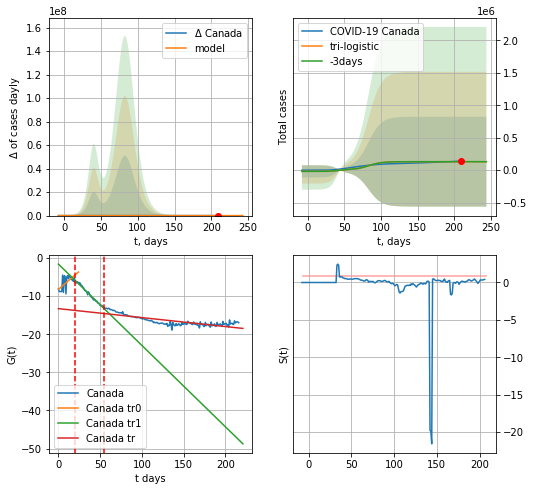

Canada data at: 2020-09-19
+3 day model MAPE: 0.001103500170779225
model: tri-logistic
coeffs:  [-1.78930068e+04  2.04477826e+00 -3.64097869e+01] [1.25342997e+05 1.13222116e-01 8.29018541e+01 2.40153999e+04
 2.16961374e-01 4.02658690e+01]
forecast rational stdev:  5.2682258016830765
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  131465 ± 692589
	 total death:  8481 ± 134039
tri-logistic approximation splitting points: 20,55
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend1 coefficient of determination: 0.983223
 intercept: -1.572806
 slope: -0.213535
trend coefficient of determination: 0.654812
 intercept: -13.266762
 slope: -0.023503


In [2152]:
vL=20
vL1=55
x = forecast('Canada',dfCA[:vL],d1,3*7,1.)
xx=forecast2('Canada',dfCA[:vL1],d1,T18*7-dT,x,1.,vL=vL)#,addpred=True,xcoef=[0.25,1.,2.]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Canada",dfCA[:],d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

CA
           date     cases  active   death
213 2020-09-15  138803.0    7775  9188.0
214 2020-09-16  139747.0    8105  9193.0
215 2020-09-17  140867.0    8558  9200.0
216 2020-09-18  141911.0    8983  9205.0
217 2020-09-19  142774.0    9376  9211.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


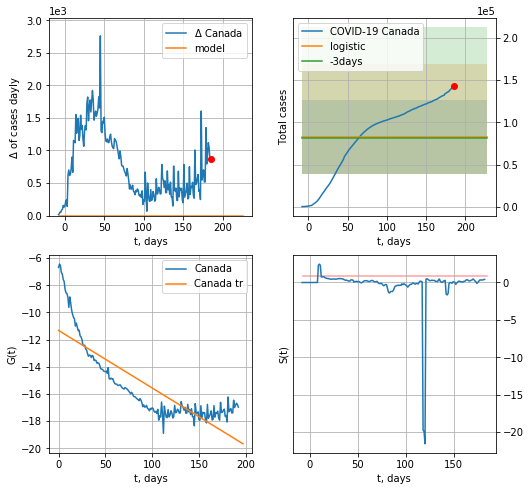

Canada data at: 2020-09-19
+3 day model MAPE: 0.011383608722424629
model: logistic
coeffs:  [82634.71649612  -101.66069262   248.91831001]
rational stdev:  0.526582614987734
forecast at the end of period: +42 days
	 deltaDaycases:  0
	 total cases:  82634 ± 43514
	 total death:  5331 ± 8421
trend coefficient of determination: 0.695650
 intercept: -11.326355
 slope: -0.042380


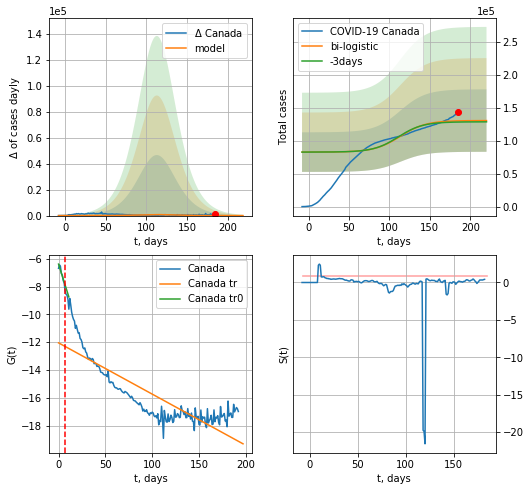

Canada data at: 2020-09-19
+3 day model MAPE: 0.013791145186762027
model: bi-logistic
coeffs:  [4.78095804e+04 6.33655501e-02 1.13349548e+02] [82634.71649612  -101.66069262   248.91831001]
rational stdev:  0.3626765865682281
forecast at the end of period: +35 days
	 deltaDaycases:  3
	 total cases:  130388 ± 47288
	 total death:  8411 ± 9151
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.859073
 intercept: -6.392122
 slope: -0.214001
trend coefficient of determination: 0.700072
 intercept: -12.047508
 slope: -0.036804


In [2153]:
dfCA = read_df(pd.DataFrame(),"CA")
x = forecast('Canada',dfCA[24:],d1,6*7,1.,cases='cases')
xx=forecast2('Canada',dfCA[24:],d1,T18*7-dT,x,1.,vL=31-24,cases='cases')

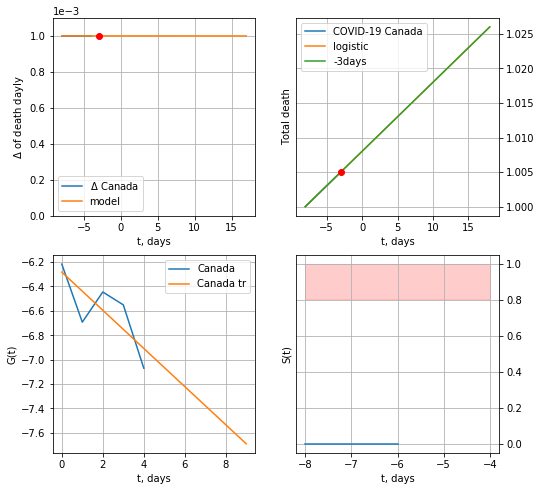

Canada data at: 2020-09-19
+3 day model MAPE: 6.189159426418585e-07
model: logistic
coeffs:  [2.01800807e+00 1.98223827e-03 1.00386171e+00]
rational stdev:  1.593569349221903e-08
forecast at the end of period: +21 days
	 total death:  1 ± 0
trend coefficient of determination: 0.608158
 intercept: -6.282802
 slope: -0.156326


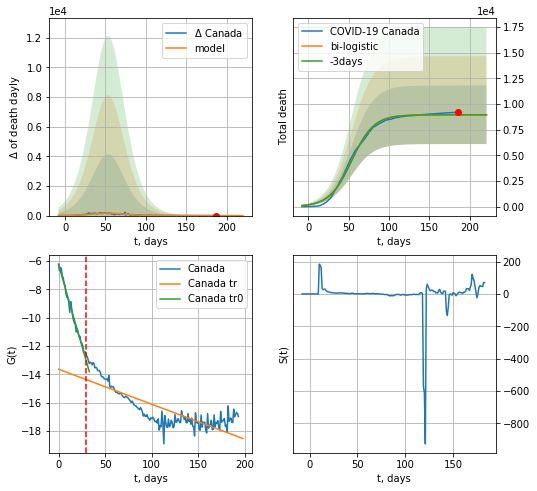

Canada data at: 2020-09-19
+3 day model MAPE: 0.0010856925310942318
model: bi-logistic
coeffs:  [8.95547848e+03 7.28308483e-02 5.35912340e+01] [2.01800807e+00 1.98223827e-03 1.00386171e+00]
rational stdev:  0.31874177051010527
forecast at the end of period: +35 days
	 deltaDaydeath:  0
	 total death:  8956 ± 2854
bi-logistic approximation splitting point: 29
trend0 coefficient of determination: 0.986075
 intercept: -6.260314
 slope: -0.228750
trend coefficient of determination: 0.669222
 intercept: -13.637068
 slope: -0.024728


In [2154]:
vL=29
vL1=50
x = forecast('Canada',dfCA[23:vL],d1,3*7,1.,cases='death')
xx=forecast2('Canada',dfCA[23:],d1,T18*7-dT,x,1.,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,2.]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Canada",dfCA[24:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


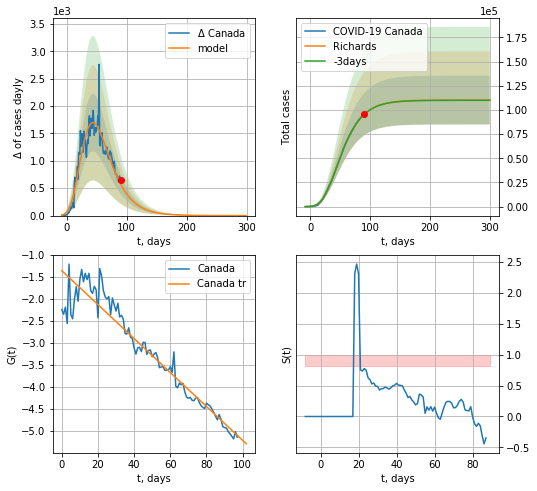

Canada data at: 2020-09-19
+3 day model MAPE: 0.001369
model: Richards
coeffs: [ 1.10207939e+05  3.57046378e+00 -6.12039169e+01  1.17938660e-02]
rational stdev: 0.228612
forecast at the end of period: +210 days
	 deltaDaycases: 0
	 total cases: 110205 ± 25194
	 total death: 7109 ± 4875
trend coefficient of determination: 0.921084
 intercept: -1.352092
 slope: -0.038614


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


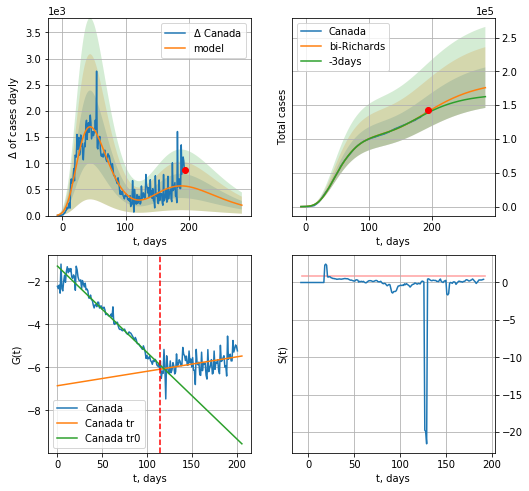

Canada data at: 2020-09-19
+3 day model MAPE: 0.010880
model: bi-Richards
coeffs: [ 7.63943603e+04  1.85264617e+00 -3.73371896e+01  1.07592334e-02]
rational stdev: 0.170289
forecast at the end of period: +91 days
	 deltaDaycases: 198
	 total cases: 175925 ± 29958
	 total death: 11349 ± 5797
bi-Richards approximation splitting point: 114
trend coefficient of determination: 0.948426
 intercept: -1.290879
 slope: -0.040159
trend coefficient of determination: 0.132924
 intercept: -6.859606
 slope: 0.006709


In [2155]:
iL = 15
vL = 114 + iL
x = forecastRR('Canada',dfCA[iL:vL-iL],d1,T18*7,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Canada',dfCA[iL:],d1,38*7-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastQR('Canada',dfCA[28:],d1,16*7,1.)

In [2156]:
#x = forecastRRR('Canada',dfCA[15:],d1,7*28,1.,addpred=True,xcoef=koreaCoeffs)

PT
           date  cases  active   death
197 2020-09-15  65021   18784  1875.0
198 2020-09-16  65626   19220  1878.0
199 2020-09-17  66396   19714  1888.0
200 2020-09-18  67176   20229  1894.0
201 2020-09-19  68025   20722  1899.0


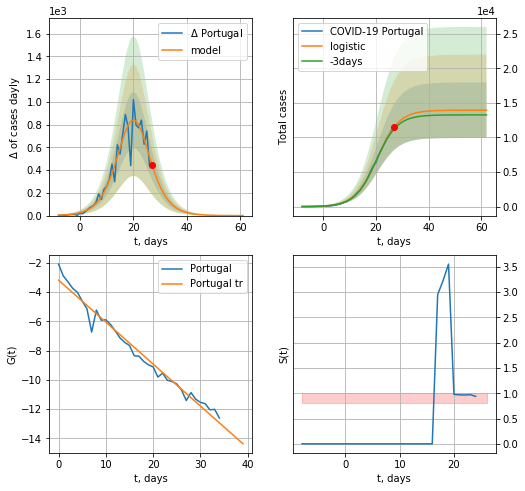

Portugal data at: 2020-09-19
+3 day model MAPE: 0.02876881186141646
model: logistic
coeffs:  [1.39435560e+04 2.41732854e-01 2.05234131e+01]
rational stdev:  0.28806592053196767
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  13942 ± 4016
	 total death:  389 ± 336
trend coefficient of determination: 0.976552
 intercept: -3.178197
 slope: -0.287215


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


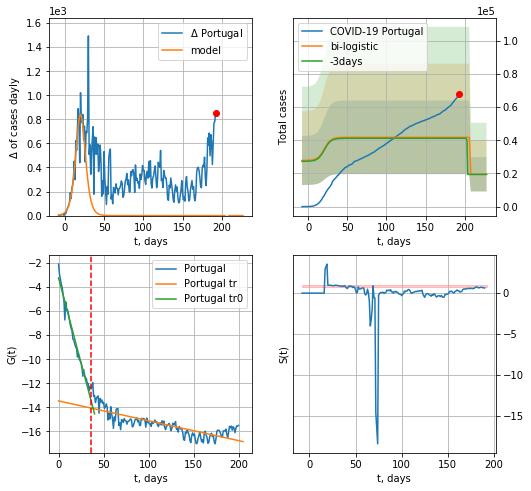

Portugal data at: 2020-09-19
+3 day model MAPE: 0.014135629883728913
model: bi-logistic
coeffs:  [ 2.23121083e+04 -8.20203407e+00  2.06970885e+02] [1.39435560e+04 2.41732854e-01 2.05234131e+01]
scenario coeffs:  [0.25, 1.0, 1.2]
rational stdev:  0.5308643850194602
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  19521 ± 10363
	 total death:  544 ± 866
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975262
 intercept: -3.226992
 slope: -0.282910
trend coefficient of determination: 0.635365
 intercept: -13.470958
 slope: -0.016530


In [2157]:
vL = 36
dfPT = read_df(pd.DataFrame(),"PT")
x = forecast('Portugal',dfPT[:vL],d1,T18*7-dT,1.)
xx=forecast2('Portugal',dfPT[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.2],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


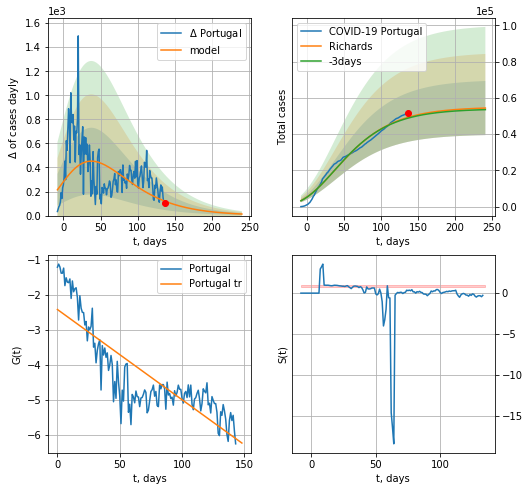

Portugal data at: 2020-09-19
+3 day model MAPE: 0.009022
model: Richards
coeffs: [ 5.49563957e+04  3.61472293e+00 -1.88142914e+02  6.21530343e-03]
rational stdev: 0.274071
forecast at the end of period: +105 days
	 deltaDaycases: 12
	 total cases: 54384 ± 14905
	 total death: 1518 ± 1248
trend coefficient of determination: 0.709889
 intercept: -2.420296
 slope: -0.025758


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


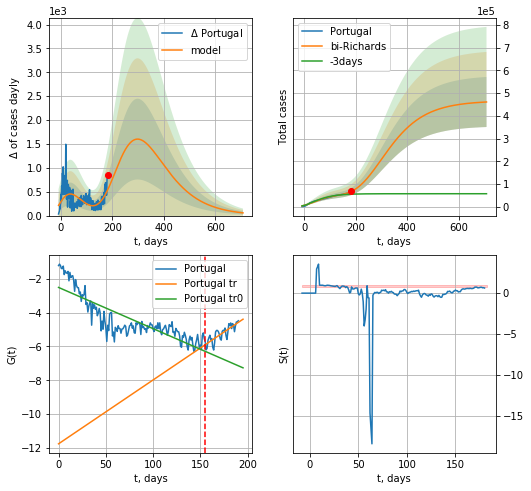

Portugal data at: 2020-09-19
+3 day model MAPE: 0.229900
model: bi-Richards
coeffs: [ 4.11436011e+05  1.17286735e+00 -1.44298893e+02  9.04456355e-03]
rational stdev: 0.239181
forecast at the end of period: +525 days
	 deltaDaycases: 56
	 total cases: 461040 ± 110272
	 total death: 12870 ± 9234
bi-Richards approximation splitting point: 155
trend coefficient of determination: 0.718846
 intercept: -2.516583
 slope: -0.024356
trend coefficient of determination: 0.668761
 intercept: -11.754211
 slope: 0.037747


In [2158]:
iL = 10
vL=155+iL
x = forecastRR('Portugal',dfPT[iL:vL-iL],d1,40*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Portugal',dfPT[iL:],d1,100*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [2159]:
#x = forecastRRR('Portugal',dfPT[:],d1,T18*7-dT,1.,addpred=True,xcoef=koreaCoeffs)

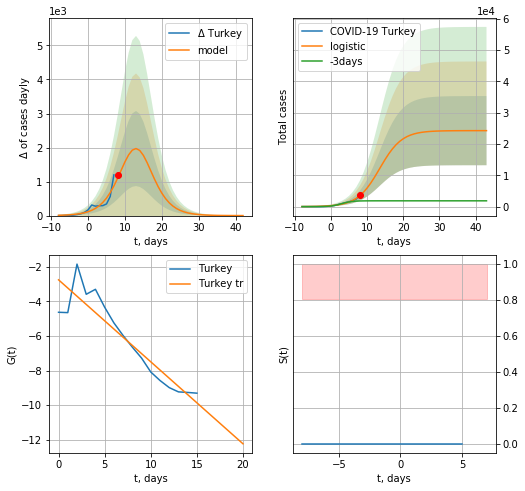

Turkey data at: 2020-09-19
+3 day model MAPE: 1.5246812178063545
model: logistic
coeffs:  [2.42671393e+04 3.25610709e-01 1.34529674e+01]
rational stdev:  0.45520285261707166
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  24265 ± 11045
	 total death:  599 ± 817
trend coefficient of determination: 0.850665
 intercept: -2.746555
 slope: -0.474541


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


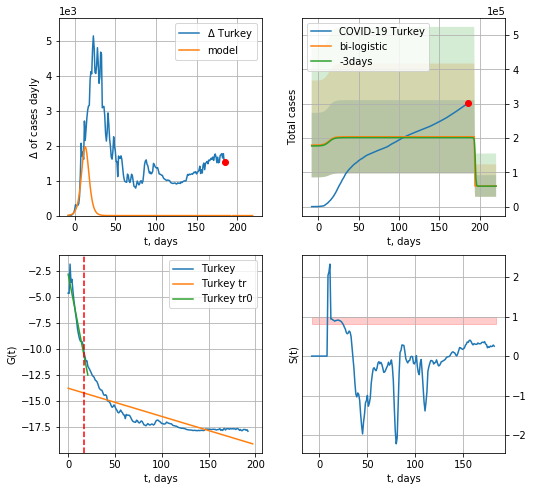

Turkey data at: 2020-09-19
+3 day model MAPE: 0.01289109257722467
model: bi-logistic
coeffs:  [ 1.43476969e+05 -4.90111103e+01  1.93635633e+02] [2.42671393e+04 3.25610709e-01 1.34529674e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.5244626446119285
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  60136 ± 31539
	 total death:  1485 ± 2336
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.862807
 intercept: -2.813054
 slope: -0.461241
trend coefficient of determination: 0.644718
 intercept: -13.761104
 slope: -0.027106


In [2160]:
vL=17
x = forecast('Turkey',dfTR[:vL],d1,7*T18-dT,1.)
xx=forecast2('Turkey',dfTR[:],d1,T18*7-dT,x,1.,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


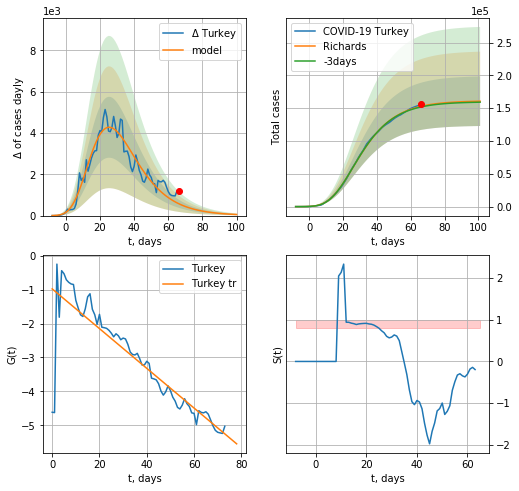

Turkey data at: 2020-09-19
+3 day model MAPE: 0.006544
model: Richards
coeffs: [ 1.61234279e+05  5.77618311e+00 -3.44308441e+01  1.25694326e-02]
rational stdev: 0.235075
forecast at the end of period: +35 days
	 deltaDaycases: 51
	 total cases: 160547 ± 37740
	 total death: 3966 ± 2796
trend coefficient of determination: 0.775259
 intercept: -0.978843
 slope: -0.058549


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


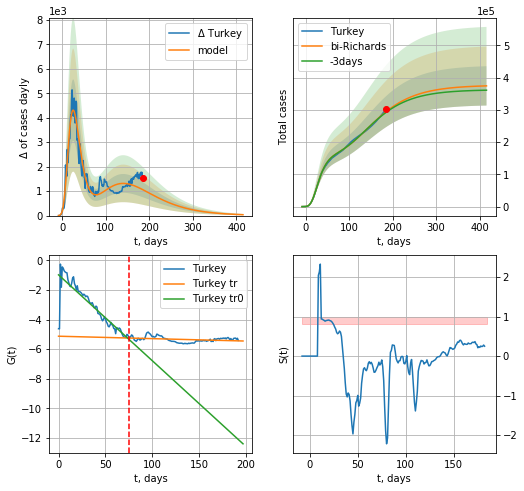

Turkey data at: 2020-09-19
+3 day model MAPE: 0.007680
model: bi-Richards
coeffs: [ 2.15259448e+05  1.64319390e+00 -1.34161339e+02  1.01414310e-02]
rational stdev: 0.162786
forecast at the end of period: +231 days
	 deltaDaycases: 36
	 total cases: 374290 ± 60929
	 total death: 9247 ± 4515
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.777811
 intercept: -0.971241
 slope: -0.058024
trend coefficient of determination: 0.094543
 intercept: -5.122405
 slope: -0.001638


In [2161]:
vL = 75
x = forecastRR('Turkey',dfTR[:vL],d1,T18*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Turkey',dfTR[:],d1,58*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [2162]:
#x = forecastQR('Turkey',dfTR[:],d1,16*7,1.,addpred=False,xcoef=[0.35,.5,3,1,1])

In [2163]:
#x = forecastRRR('Turkey',dfTR[:],d1,T18*7,1.,addpred=True,xcoef=koreaCoeffs)

#xx=forecast2R('Turkey',dfTR[:],d1,14*7-dT,x,1.)

In [2164]:
dfTT[dfTT.Country=='%s'%("Latvia")][0].values[0]

0.02360655737704918

In [2165]:
#trend3(dfPL[1:],dfIS[7:],dfSW,'PL','IS','SW',40,40,40)

PL
           date    cases  active   death
195 2020-09-15  75134.0   10797  2227.0
196 2020-09-16  75734.0   10772  2237.0
197 2020-09-17  76571.0   11593  2253.0
198 2020-09-18  77328.0   12187  2282.0
199 2020-09-19  78330.0   12645  2293.0


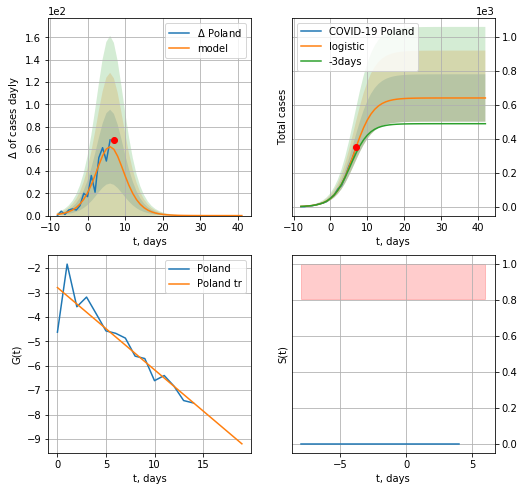

Poland data at: 2020-09-19
+3 day model MAPE: 0.14646235252259687
model: logistic
coeffs:  [6.41107575e+02 3.87606717e-01 6.46563504e+00]
rational stdev:  0.2177068805945458
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  641 ± 139
	 total death:  18 ± 11
trend coefficient of determination: 0.843228
 intercept: -2.795749
 slope: -0.337043


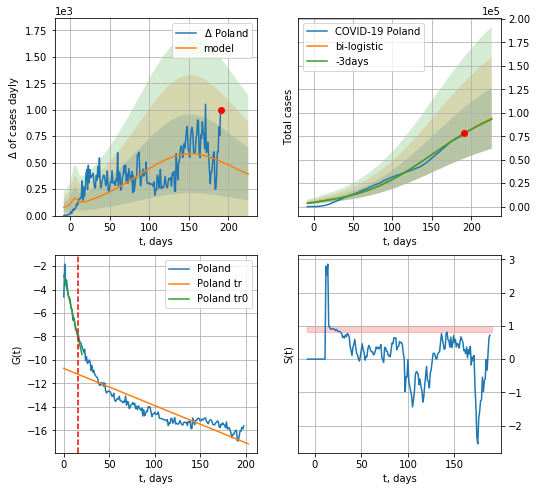

Poland data at: 2020-09-19
+3 day model MAPE: 0.006175774648952506
model: bi-logistic
coeffs:  [1.06122938e+05 2.11575664e-02 1.48930979e+02] [6.41107575e+02 3.87606717e-01 6.46563504e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.34481516806218826
forecast at the end of period: +35 days
	 deltaDaycases:  391
	 total cases:  94146 ± 32463
	 total death:  2724 ± 2817
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.867285
 intercept: -2.795308
 slope: -0.337138
trend coefficient of determination: 0.777139
 intercept: -10.727372
 slope: -0.031649


In [2168]:
vL=16
vL1=38
try:
    dfPL = read_df(pd.DataFrame(),"PL")
    x =  forecast('Poland',dfPL[:vL],d1,7*T18-dT,1.)
    xx = forecast2('Poland',dfPL[:],d1,T18*7-dT,x,1.,vL=vL,addpred=True,xcoef=[0.25,1.,2.])
    #xx = np.concatenate((x, xx), axis=0)
    #xxx = forecast3("Poland",dfPL,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.5,1.,1.3],vL=[vL,vL1])
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


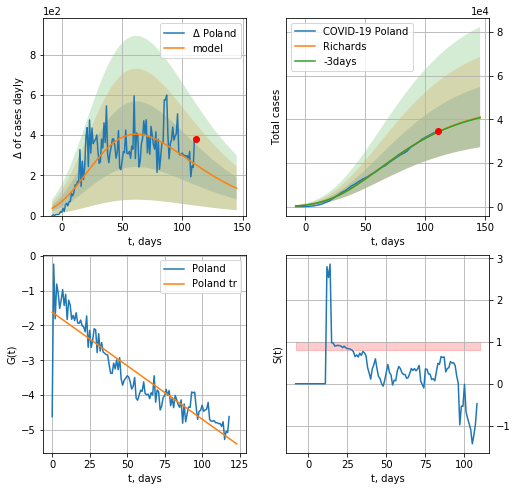

Poland data at: 2020-09-19
+3 day model MAPE: 0.004129
model: Richards
coeffs: [ 4.71367602e+04  2.41241361e+00 -1.35493652e+02  9.71752957e-03]
rational stdev: 0.335893
forecast at the end of period: +35 days
	 deltaDaycases: 135
	 total cases: 40977 ± 13763
	 total death: 1185 ± 1194
trend coefficient of determination: 0.829985
 intercept: -1.620348
 slope: -0.030685


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


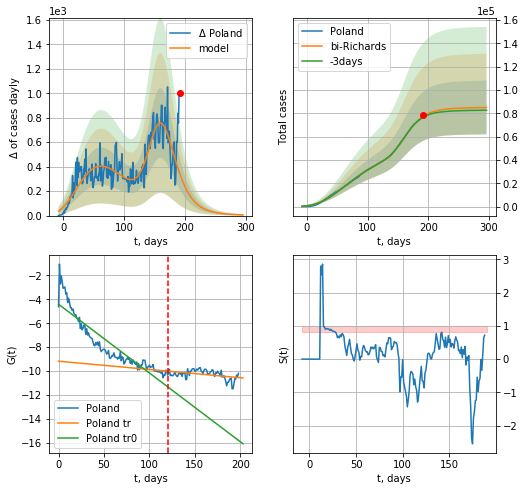

Poland data at: 2020-09-19
+3 day model MAPE: 0.008812
model: bi-Richards
coeffs: [3.80271801e+04 1.13875711e-01 1.49932900e+02 5.16363252e-01]
rational stdev: 0.271211
forecast at the end of period: +105 days
	 deltaDaycases: 5
	 total cases: 84954 ± 23040
	 total death: 2458 ± 1999
bi-Richards approximation splitting point: 120
trend coefficient of determination: 0.838570
 intercept: -4.407546
 slope: -0.057454
trend coefficient of determination: 0.173277
 intercept: -9.169039
 slope: -0.006903


In [2169]:
vL = 120
x =  forecastRR('Poland',dfPL[:vL],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx =  forecast2RR('Poland',dfPL[:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#xx = forecast2R('Poland',dfPL[:],d1,8*7-dT,x)

In [2170]:
#x =  forecastRRR('Poland',dfPL[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

IS
           date     cases  active   death
206 2020-09-15  164402.0   42862  1147.0
207 2020-09-16  170445.0   44984  1165.0
208 2020-09-17  175256.0   46370  1169.0
209 2020-09-18  179071.0   47851  1196.0
210 2020-09-19  183602.0   49927  1226.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


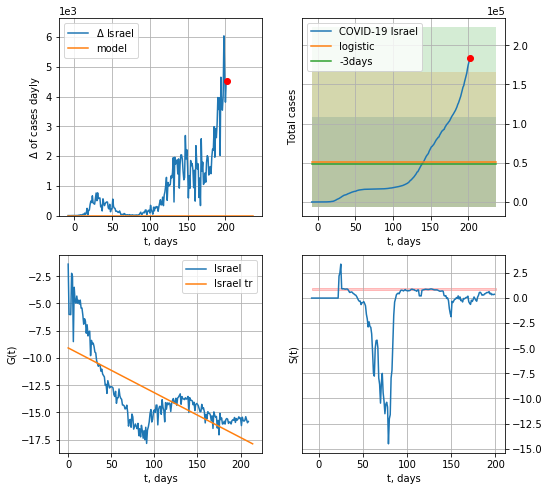

Israel data at: 2020-09-19
+3 day model MAPE: 0.050864113380402615
model: logistic
coeffs:  [ 4.11649244e+04 -1.76032282e+01  4.34627952e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  1.1140209634538076
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  51456 ± 57323
	 total death:  343 ± 1146
trend coefficient of determination: 0.525138
 intercept: -9.076357
 slope: -0.041117


In [2171]:
dfIS = read_df(pd.DataFrame(),"IS")
try:
    x = forecast('Israel',dfIS[:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,1.8])
except:
    print ("Exception occurs")
#xx = forecast2('Israel',dfIS[:],d1,20-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


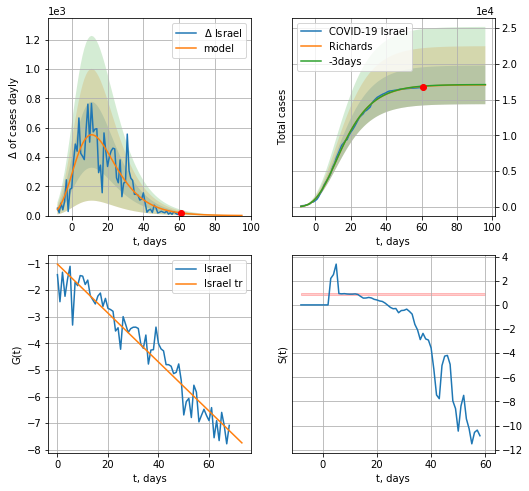

Israel data at: 2020-09-19
+3 day model MAPE: 0.001940
model: Richards
coeffs: [ 1.70515692e+04  6.43104023e+00 -3.67761649e+01  1.37703182e-02]
rational stdev: 0.158197
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 17041 ± 2695
	 total death: 113 ± 53
trend coefficient of determination: 0.925544
 intercept: -1.027515
 slope: -0.091953


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


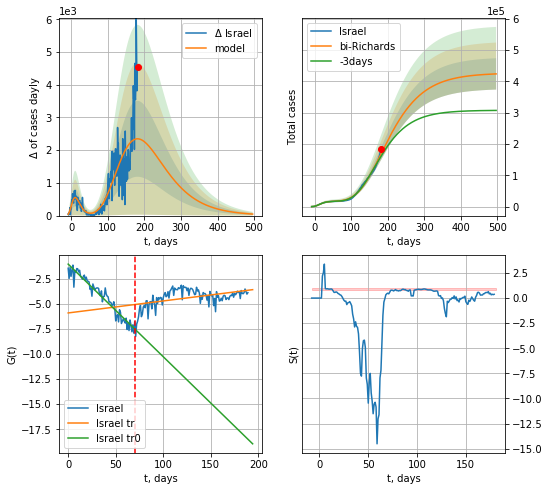

Israel data at: 2020-09-19
+3 day model MAPE: 0.047999
model: bi-Richards
coeffs: [ 4.10021696e+05  1.25706419e+00 -9.80404478e+01  1.24611614e-02]
rational stdev: 0.118008
forecast at the end of period: +315 days
	 deltaDaycases: 46
	 total cases: 424138 ± 50051
	 total death: 2832 ± 1002
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.928227
 intercept: -1.003395
 slope: -0.092538
trend coefficient of determination: 0.222107
 intercept: -5.881728
 slope: 0.011987


In [2172]:
x = forecastRR('Israel',dfIS[20:90],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Israel',dfIS[20:],d1,70*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=90-20)

In [2173]:
#x = forecastRRR('Israel',dfIS[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

In [2174]:
#x = forecastRRR('Israel',dfIS[27:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

SZ
           date    cases  active   death
203 2020-09-15  47751.0    5823  2028.0
204 2020-09-16  48265.0    6326  2039.0
205 2020-09-17  48795.0    6853  2042.0
206 2020-09-18  49283.0    6738  2045.0
207 2020-09-19  49283.0    6738  2045.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


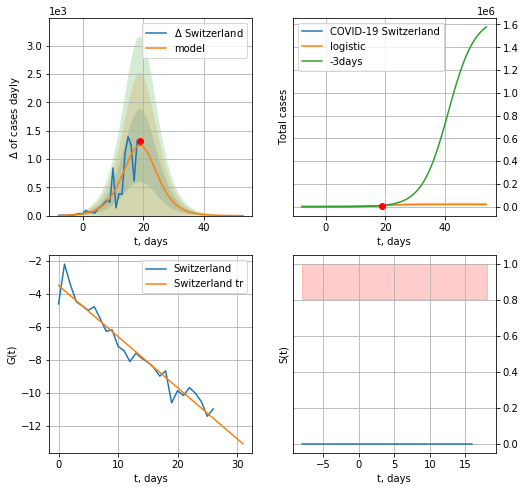

Switzerland data at: 2020-09-19
+3 day model MAPE: 0.24949882905970236
model: logistic
coeffs:  [1.87061213e+04 2.66466230e-01 1.93986309e+01]
rational stdev:  0.3060478989718857
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  18704 ± 5724
	 total death:  776 ± 712
trend coefficient of determination: 0.944448
 intercept: -3.508672
 slope: -0.309041
Exception occurs


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:485: RuntimeWarning: divide by zero encountered in log


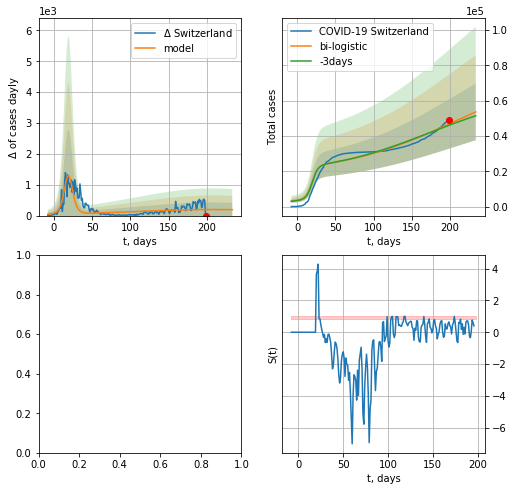

In [2175]:
vL= 28
try:
    dfSZ = read_df(pd.DataFrame(),"SZ")
    x = forecast('Switzerland',dfSZ[:vL],d1,7*T18-dT)
    xx = forecast2('Switzerland',dfSZ[:],d1,7*T18-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,2.])#,addpred=False,xcoef=[0.25,1.,2.5]
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


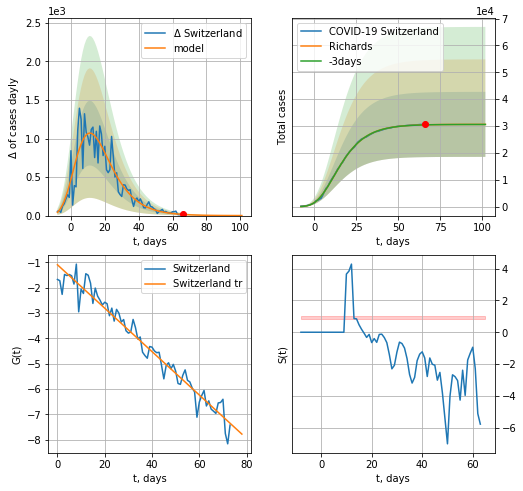

Switzerland data at: 2020-09-18
+3 day model MAPE: 0.000864
model: Richards
coeffs: [ 3.06308865e+04  7.16537801e+00 -3.34375097e+01  1.33541414e-02]
rational stdev: 0.394656
forecast at the end of period: +36 days
	 deltaDaycases: 0
	 total cases: 30625 ± 12086
	 total death: 1270 ± 1503
trend coefficient of determination: 0.958074
 intercept: -1.096880
 slope: -0.085687


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


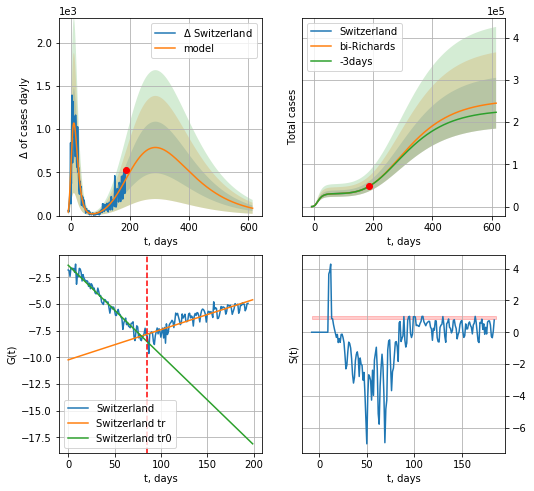

Switzerland data at: 2020-09-18
+3 day model MAPE: 0.001899
model: bi-Richards
coeffs: [ 2.23183848e+05  2.49846250e-01 -4.45607654e+01  3.91597592e-02]
rational stdev: 0.245756
forecast at the end of period: +428 days
	 deltaDaycases: 84
	 total cases: 245019 ± 60215
	 total death: 10167 ± 7495
bi-Richards approximation splitting point: 85
trend coefficient of determination: 0.963605
 intercept: -1.372522
 slope: -0.084049
trend coefficient of determination: 0.760125
 intercept: -10.236696
 slope: 0.028267


In [1784]:
iL = 10
vL = 85 + iL
x = forecastRR('Switzerland',dfSZ[iL:vL-iL],d1,7*30-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Switzerland',dfSZ[iL:-1],d1,7*86-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#xx = forecastR('Switzerland',dfSZ[:],d1,7*5-dT,x,vL=15)

In [1785]:
#x = forecastRRR('Switzerland',dfSZ[:],d1,7*T18-dT,addpred=False,xcoef=koreaCoeffs)

In [1786]:
#trend3(dfUR[5:],dfIN[7:],dfRS[5:],'UR','IN','RS',40,40,40)

Ukr
           date     cases  active   death
189 2020-09-15  159701.0   86996  3340.0
190 2020-09-16  162660.0   88931  3400.0
191 2020-09-17  166244.0   90518  3468.0
192 2020-09-18  169472.0   92442  3516.0
193 2020-09-19  172712.0   94609  3557.0


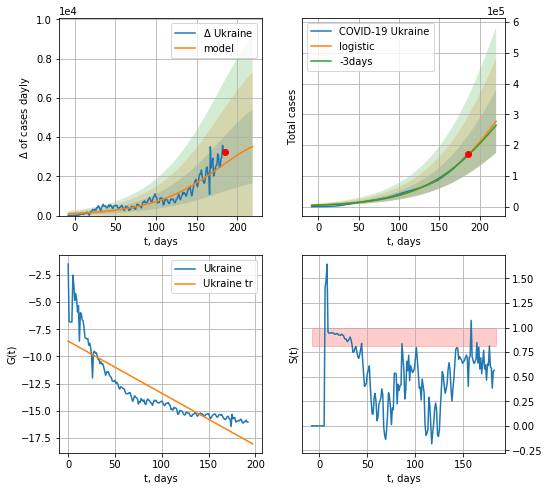

Ukraine data at: 2020-09-19
+3 day model MAPE: 0.014953845056630702
model: logistic
coeffs:  [7.38113568e+05 2.03292355e-02 2.45189425e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3691671402359939
forecast at the end of period: +35 days
	 deltaDaycases:  3521
	 total cases:  277328 ± 102380
	 total death:  5615 ± 6218
trend coefficient of determination: 0.739639
 intercept: -8.589133
 slope: -0.047924


In [2177]:
dfUR = read_df(pd.DataFrame(),"Ukr")
try:
    x=forecast('Ukraine',dfUR[:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,2.])
except:
      print("Exaption occurs") 

#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


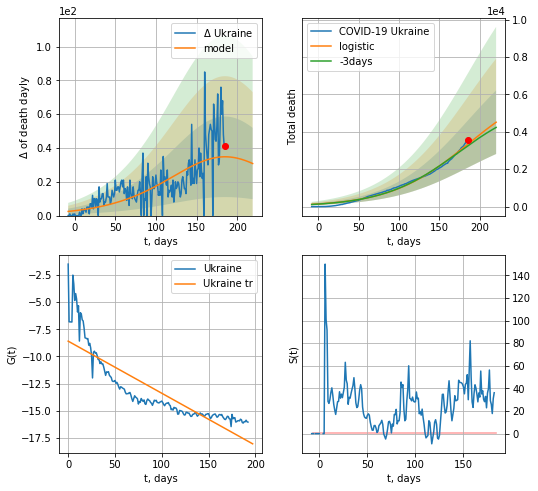

Ukraine data at: 2020-09-19
+3 day model MAPE: 0.028170315982023006
model: logistic
coeffs:  [6.71773307e+03 2.07307376e-02 1.85474797e+02]
rational stdev:  0.3765822400436281
forecast at the end of period: +35 days
	 total death:  4512 ± 1699
trend coefficient of determination: 0.739639
 intercept: -8.589133
 slope: -0.047924


In [2178]:
x=forecast('Ukraine',dfUR[:],d1,T18*7-dT,addpred=False,xcoef=[0.25,1.,2.],cases='death')
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


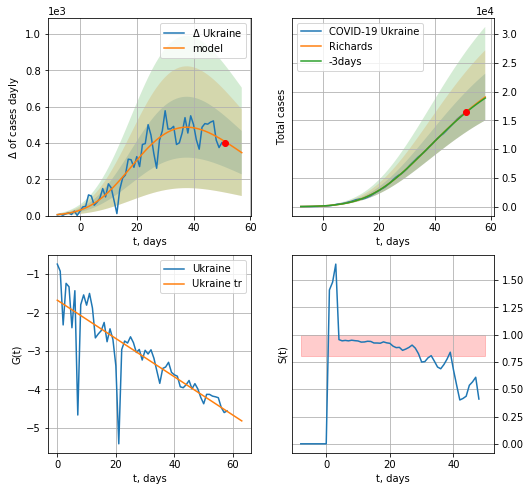

Ukraine data at: 2020-09-19
+3 day model MAPE: 0.005756
model: Richards
coeffs: [ 2.73152267e+04  5.78390591e-01 -1.00505553e+01  8.74755349e-02]
rational stdev: 0.213278
forecast at the end of period: +7 days
	 deltaDaycases: 346
	 total cases: 19062 ± 4065
	 total death: 385 ± 246
trend coefficient of determination: 0.678475
 intercept: -1.678868
 slope: -0.049847


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


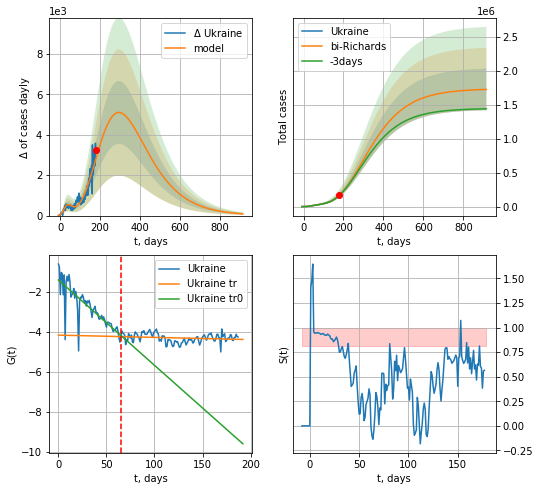

Ukraine data at: 2020-09-19
+3 day model MAPE: 0.008612
model: bi-Richards
coeffs: [ 1.71259174e+06  3.49452280e-01 -1.62652777e+02  2.34778823e-02]
rational stdev: 0.177804
forecast at the end of period: +735 days
	 deltaDaycases: 86
	 total cases: 1729391 ± 307493
	 total death: 35015 ± 18677
bi-Richards approximation splitting point: 65
trend coefficient of determination: 0.674912
 intercept: -1.410077
 slope: -0.042656
trend coefficient of determination: 0.033118
 intercept: -4.165805
 slope: -0.001127


In [2179]:
vL = 70#65+5 +55
x=forecastRR('Ukraine',dfUR[5:vL-5],d1,7*26-dT,addpred=False,xcoef=RkoreaCoeffs)
xx=forecast2RR('Ukraine',dfUR[5:],d1,7*130-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

In [2180]:
#x=forecastRRR('Ukraine',dfUR[5:],d1,7*86-dT,addpred=True,xcoef=koreaCoeffs)

In [2181]:
#np.log(np.diff(dfIS["cases"].values)[:]/dfIS["cases"].values[1:]**2)

IN
           date   cases  active    death
209 2020-09-15  407353   33916  23453.0
210 2020-09-16  410334   34683  23632.0
211 2020-09-17  413149   35493  23808.0
212 2020-09-18  416198   36741  23952.0
213 2020-09-19  419043   38269  24301.0


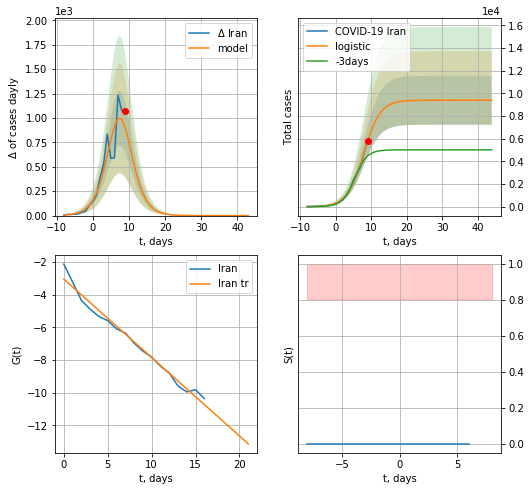

Iran data at: 2020-09-19
+3 day model MAPE: 0.4176898990261385
model: logistic
coeffs:  [9.38566043e+03 4.29600562e-01 7.92981700e+00]
rational stdev:  0.2297342183396625
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  9385 ± 2156
	 total death:  540 ± 372
trend coefficient of determination: 0.980602
 intercept: -3.037586
 slope: -0.480406


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


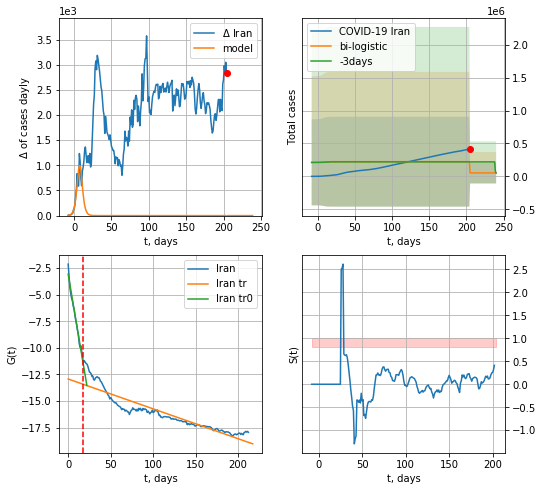

Iran data at: 2020-09-19
+3 day model MAPE: 0.7634125723261613
model: bi-logistic
coeffs:  [ 1.71027130e+05 -8.81481541e+01  2.04464446e+02] [9.38566043e+03 4.29600562e-01 7.92981700e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  3.0619261585817585
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  52142 ± 159656
	 total death:  3001 ± 27566
bi-logistic approximation splitting point: 18
trend0 coefficient of determination: 0.982944
 intercept: -3.059655
 slope: -0.476268
trend coefficient of determination: 0.848340
 intercept: -12.924466
 slope: -0.028095


In [2183]:
dfIN = read_df(pd.DataFrame(),"IN")
x = forecast('Iran',dfIN[:18],d1,7*T18-dT)
xx = forecast2('Iran',dfIN[:],d1,T18*7-dT,x,vL=18,addpred=True,xcoef=[0.25,1.,2.0])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


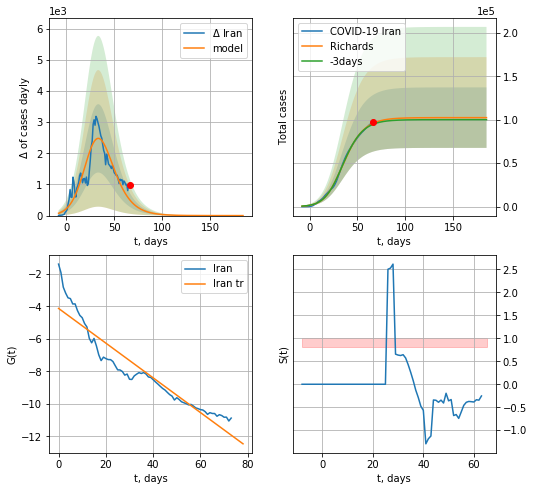

Iran data at: 2020-09-19
+3 day model MAPE: 0.012009
model: Richards
coeffs: [1.02478152e+05 1.52216307e-01 2.65523943e+01 5.45962781e-01]
rational stdev: 0.339941
forecast at the end of period: +119 days
	 deltaDaycases: 0
	 total cases: 102477 ± 34836
	 total death: 5899 ± 6015
trend coefficient of determination: 0.893485
 intercept: -4.118018
 slope: -0.106957


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


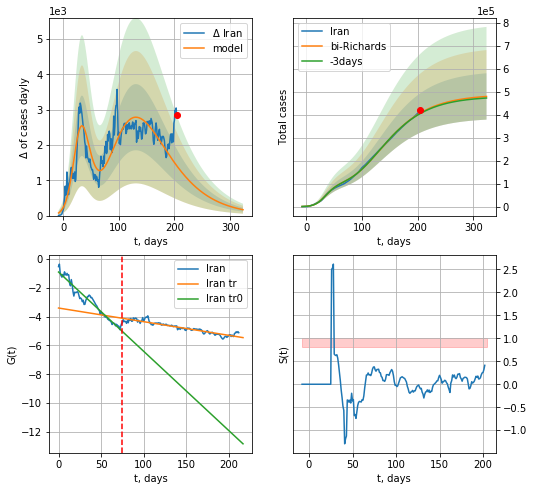

Iran data at: 2020-09-19
+3 day model MAPE: 0.005838
model: bi-Richards
coeffs: [ 3.84713179e+05  2.11114871e+00 -1.04848175e+02  9.36397408e-03]
rational stdev: 0.210451
forecast at the end of period: +119 days
	 deltaDaycases: 166
	 total cases: 478739 ± 100751
	 total death: 27559 ± 17399
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.949236
 intercept: -0.902040
 slope: -0.054941
trend coefficient of determination: 0.882880
 intercept: -3.400409
 slope: -0.009461


In [2184]:
vL = 75
x = forecastRR('Iran',dfIN[:vL],d1,42*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Iran',dfIN[:],d1,42*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


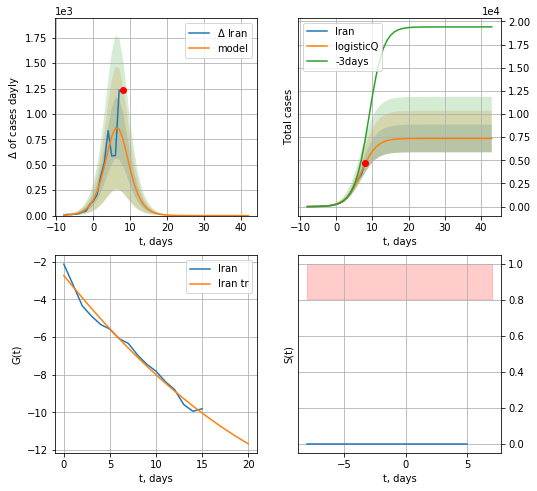

Iran data at: 2020-09-19
+3 day model MAPE: 0.437962
model: logisticQ
coeffs: [ 7.36885077e+03  7.42724103e-05 -6.37161781e+03  6.90116795e+00]
rational stdev: 0.203007
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 7368 ± 1495
	 total death: 424 ± 258
trend coefficient of determination: 0.985826
 intercept_: -2.7244557798652984
 coeffs_: [ 0.         -0.60810956  0.00802289]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


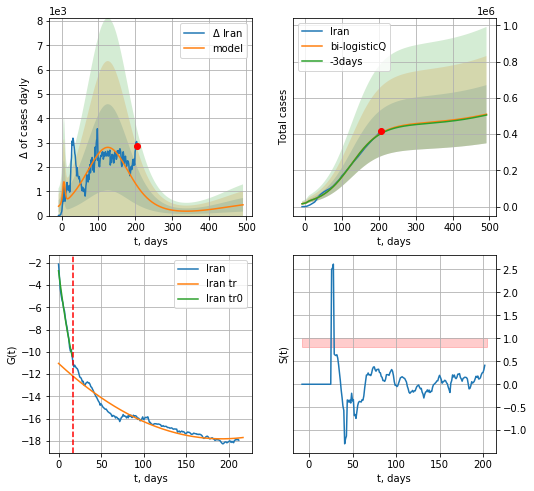

Iran data at: 2020-09-19
+3 day model MAPE: 0.006788
model: bi-logisticQ
coeffs: [ 4.49375581e+05  1.02109995e-07  1.25548730e+02 -2.43842511e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.314978
forecast at the end of period: +287 days
	 deltaDaycases: 443
	 total cases: 509796 ± 160574
	 total death: 29347 ± 27731
bi-logisticQ approximation splitting point: 17
trend coefficient of determination: 0.987745
 intercept_: -2.720144864989817
 coeffs_: [ 0.         -0.61067547  0.00823538]
trend coefficient of determination: 0.936165
 intercept_: -11.042477604174646
 coeffs_: [ 0.         -0.0706793   0.00018431]


In [2185]:
x = forecastRRR('Iran',dfIN[:17],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Iran',dfIN[:],d1,66*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=17)

RS
           date      cases  active    death
199 2020-09-15  1073849.0  170759  18785.0
200 2020-09-16  1079519.0  170352  19061.0
201 2020-09-17  1085281.0  170784  19195.0
202 2020-09-18  1091186.0  171450  19339.0
203 2020-09-19  1097251.0  174624  19418.0


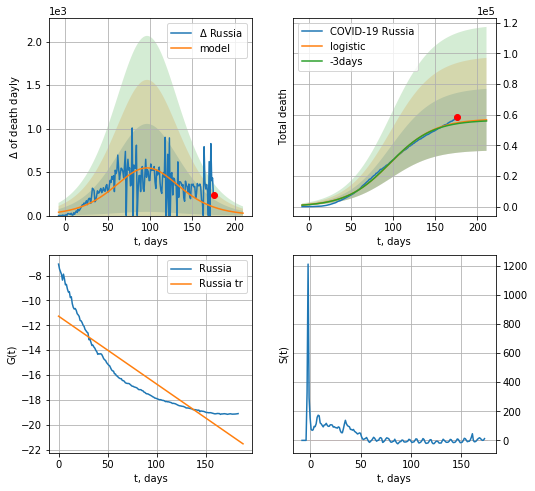

Russia data at: 2020-09-19
+3 day model MAPE: 0.010325206154202954
model: logistic
coeffs:  [5.73801846e+04 3.82571416e-02 9.70857301e+01]
rational stdev:  0.3571544102709294
forecast at the end of period: +35 days
	 total death:  56654 ± 20234
trend coefficient of determination: 0.815722
 intercept: -11.266740
 slope: -0.054631


In [2187]:
try:
    dfRS = read_df(pd.DataFrame(),"RS")
    x = forecast('Russia',dfRS[19:],d1,T18*7-dT,shift=3.,cases='death')
    #xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14)#,addpred=True,xcoef=[0.5,1.,3.5]
except:
    print ("Exeption occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


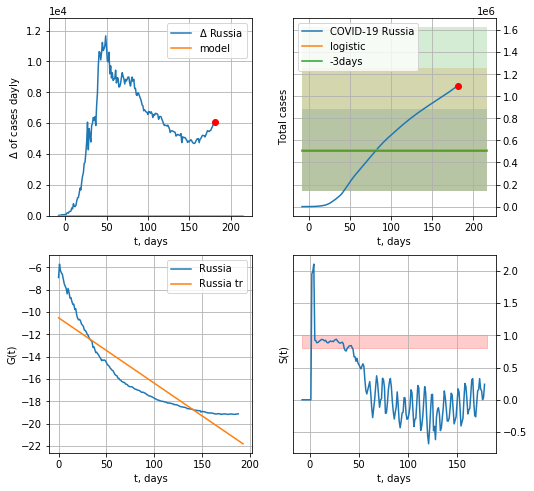

Russia data at: 2020-09-19
+3 day model MAPE: 0.018492393075930334
model: logistic
coeffs:  [ 5.11895127e+05 -1.31770562e+01  3.27296732e+02]
rational stdev:  0.7274921279769717
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  511895 ± 372399
	 total death:  9008 ± 19659
trend coefficient of determination: 0.810408
 intercept: -10.508136
 slope: -0.058472


In [2188]:
x = forecast('Russia',dfRS[14:],d1,T18*7-dT,shift=1.)
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14,shift=1.)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


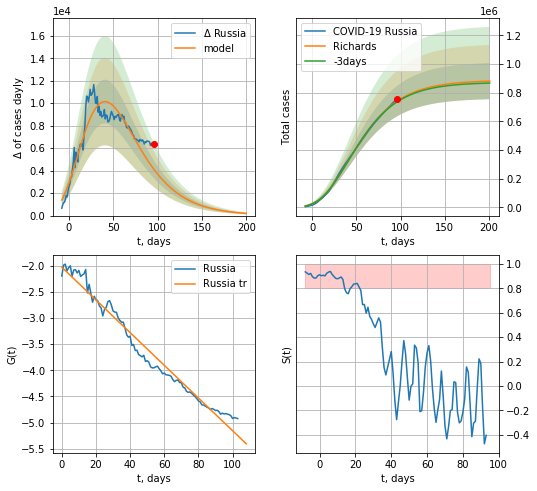

Russia data at: 2020-09-19
+3 day model MAPE: 0.007122
model: Richards
coeffs: [ 8.86415743e+05  2.82640365e+00 -1.02839969e+02  1.10681466e-02]
rational stdev: 0.143292
forecast at the end of period: +105 days
	 deltaDaycases: 188
	 total cases: 880471 ± 126164
	 total death: 15494 ± 6660
trend coefficient of determination: 0.972450
 intercept: -2.029426
 slope: -0.031275


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


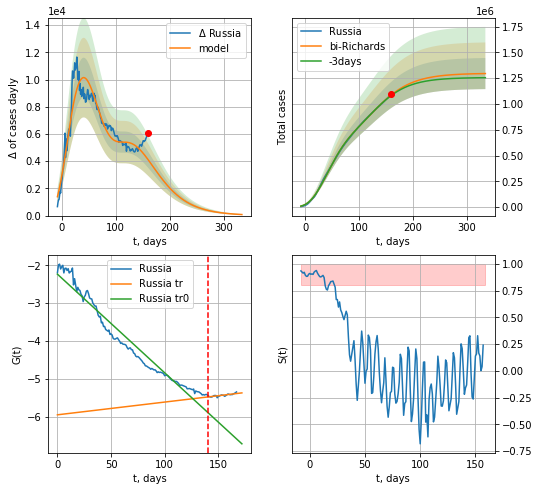

Russia data at: 2020-09-19
+3 day model MAPE: 0.004970
model: bi-Richards
coeffs: [ 4.11343677e+05  2.41024827e+00 -3.64844176e+01  1.06172968e-02]
rational stdev: 0.116429
forecast at the end of period: +175 days
	 deltaDaycases: 77
	 total cases: 1294797 ± 150751
	 total death: 22786 ± 7958
bi-Richards approximation splitting point: 140
trend coefficient of determination: 0.955613
 intercept: -2.231736
 slope: -0.026079
trend coefficient of determination: 0.633870
 intercept: -5.950547
 slope: 0.003369


In [2189]:
vL = 140 + 35
x = forecastRR('Russia',dfRS[35:vL-35],d1,40*7-dT,addpred=False,xcoef=RkoreaCoeffs)#,addpred=True,xcoef=[0.25,1.,1.5,1]
xx = forecast2RR('Russia',dfRS[35:],d1,50*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-35)
#x = forecastQR('Russia',dfRS[20:],d1,30*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]

In [2190]:
#x = forecastRRR('Russia',dfRS[:],d1,68*7-dT,addpred=True,xcoef=koreaCoeffs)

JP
           date    cases  active   death
237 2020-09-15  75958.0    6676  1451.0
238 2020-09-16  76448.0    6455  1461.0
239 2020-09-17  77009.0    6283  1473.0
240 2020-09-18  77494.0    6113  1482.0
241 2020-09-19  78073.0    6083  1495.0


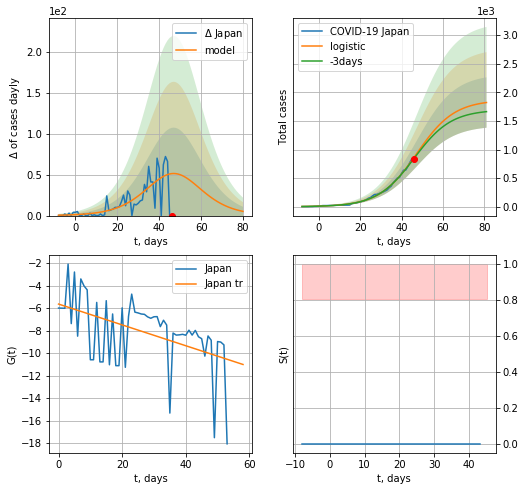

Japan data at: 2020-09-19
+3 day model MAPE: 0.024413899387998084
model: logistic
coeffs:  [1.86668600e+03 1.09971339e-01 4.74124631e+01]
rational stdev:  0.24188431732788906
forecast at the end of period: +35 days
	 deltaDaycases:  5
	 total cases:  1821 ± 440
	 total death:  34 ± 24
trend coefficient of determination: 0.226001
 intercept: -5.646499
 slope: -0.092589


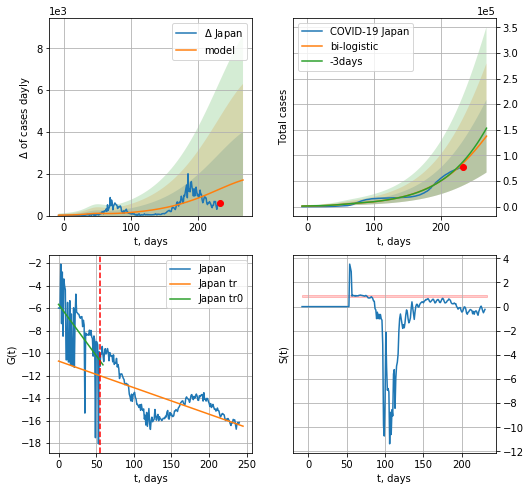

Japan data at: 2020-09-19
+3 day model MAPE: 0.033860298644824025
model: bi-logistic
coeffs:  [3.78843515e+05 1.95807665e-02 2.97755447e+02] [1.86668600e+03 1.09971339e-01 4.74124631e+01]
rational stdev:  0.5168398418883913
forecast at the end of period: +35 days
	 deltaDaycases:  1700
	 total cases:  137616 ± 71125
	 total death:  2635 ± 4085
bi-logistic approximation splitting point: 55
trend0 coefficient of determination: 0.229818
 intercept: -5.672459
 slope: -0.091119
trend coefficient of determination: 0.467783
 intercept: -10.715900
 slope: -0.023616


In [2191]:
dfJP = read_df(pd.DataFrame(),"JP")
try:
    x = forecast('Japan',dfJP[:55],d1,7*T18-dT)
    xx = forecast2('Japan',dfJP[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,1.25],vL=55)
except:
    print ("Exception occurs")

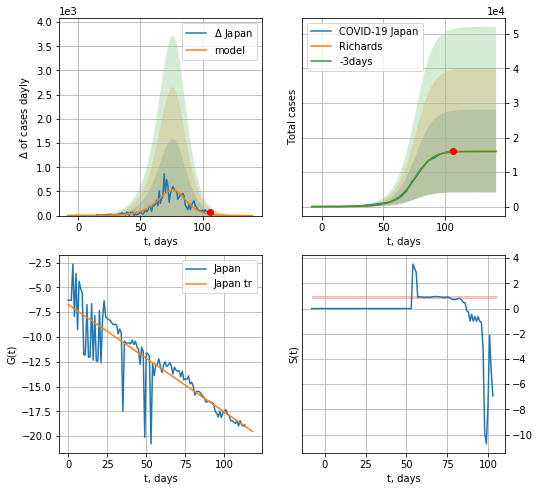

Japan data at: 2020-09-19
+3 day model MAPE: 0.009396
model: Richards
coeffs: [1.61043525e+04 1.05070375e-01 7.85362635e+01 1.40112814e+00]
rational stdev: 0.743333
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 16103 ± 11970
	 total death: 308 ± 686
trend coefficient of determination: 0.778576
 intercept: -6.726919
 slope: -0.108522


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


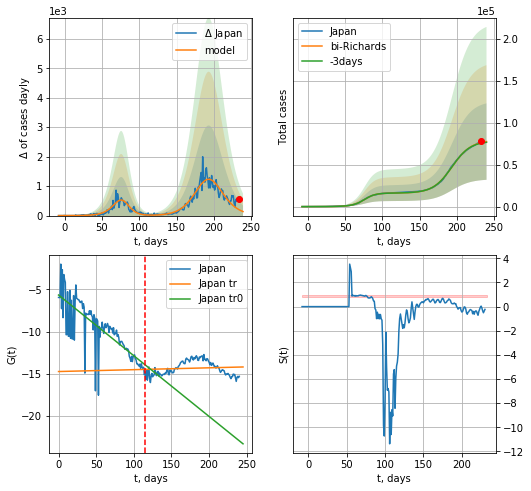

Japan data at: 2020-09-19
+3 day model MAPE: 0.009522
model: bi-Richards
coeffs: [6.33546833e+04 8.22949288e-02 1.92443479e+02 9.24567540e-01]
rational stdev: 0.587729
forecast at the end of period: +7 days
	 deltaDaycases: 137
	 total cases: 77670 ± 45649
	 total death: 1487 ± 2621
bi-Richards approximation splitting point: 115
trend coefficient of determination: 0.610816
 intercept: -5.660710
 slope: -0.072144
trend coefficient of determination: 0.009046
 intercept: -14.749085
 slope: 0.002205


In [2192]:
vL = 115
x = forecastRR('Japan',dfJP[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Japan',dfJP[:],d1,26*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


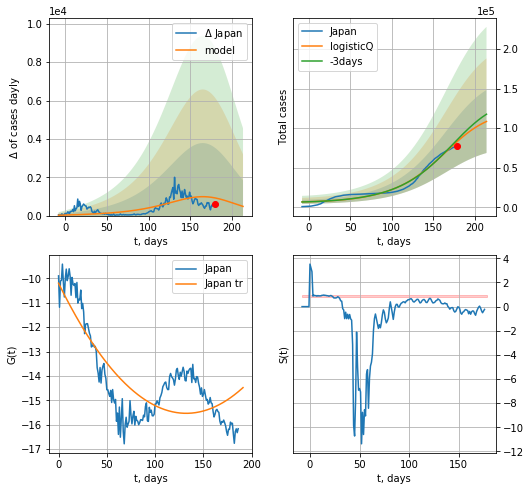

Japan data at: 2020-09-19
+3 day model MAPE: 0.027744
model: logisticQ
coeffs: [ 1.20374452e+05  8.89838785e-05  1.55428760e+02 -2.01766190e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.367409
forecast at the end of period: +35 days
	 deltaDaycases: 479
	 total cases: 108513 ± 39868
	 total death: 2077 ± 2289
trend coefficient of determination: 0.656482
 intercept_: -10.194190822307599
 coeffs_: [ 0.         -0.08081025  0.00030557]


In [2193]:
x = forecastRRR('Japan',dfJP[54:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

NL
           date    cases  active   death
201 2020-09-15  84778.0       0  6258.0
202 2020-09-16  86320.0       0  6260.0
203 2020-09-17  88073.0       0  6266.0
204 2020-09-18  90047.0       0  6273.0
205 2020-09-19  91934.0       0  6275.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


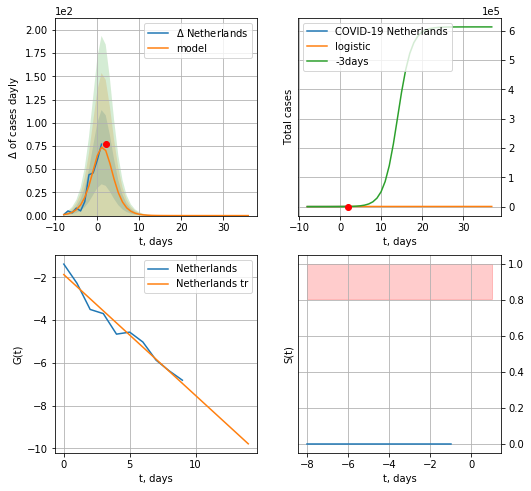

Netherlands data at: 2020-09-19
model: logistic
coeffs:  [487.7470779    0.61204075   1.72557626]
rational stdev:  0.23761281134430468
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  487 ± 115
	 total death:  33 ± 23
trend coefficient of determination: 0.966773
 intercept: -1.876651
 slope: -0.565279


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


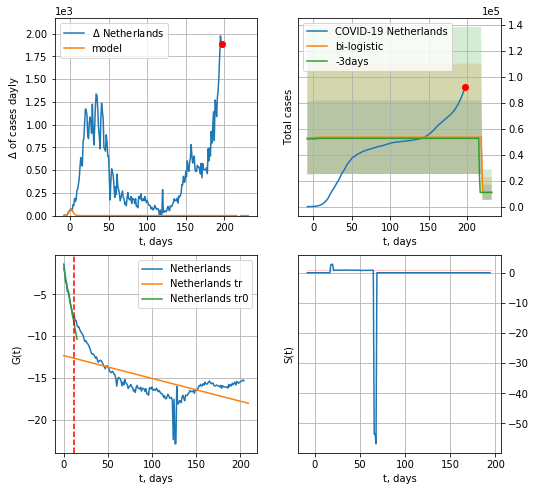

Netherlands data at: 2020-09-19
+3 day model MAPE: 0.016597429615737763
model: bi-logistic
coeffs:  [ 4.23322936e+04 -7.90877945e+00  2.19067539e+02] [487.7470779    0.61204075   1.72557626]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.5299803147264494
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  11070 ± 5867
	 total death:  755 ± 1200
bi-logistic approximation splitting point: 11
trend0 coefficient of determination: 0.974821
 intercept: -1.878275
 slope: -0.564738
trend coefficient of determination: 0.392544
 intercept: -12.316791
 slope: -0.027260


In [2194]:
vL=11
vL1=32
dfNL = read_df(pd.DataFrame(),"NL")
x = forecast('Netherlands',dfNL[:vL],d1,T18*7-dT,pMAPE=False)
xx = forecast2('Netherlands',dfNL[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


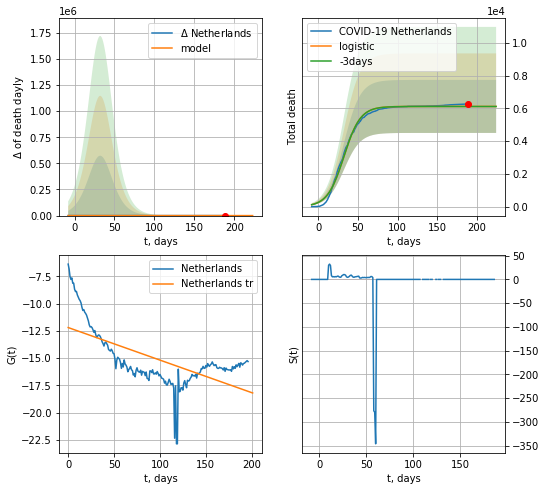

Netherlands data at: 2020-09-19
+3 day model MAPE: 0.0006552399295153004
model: logistic
coeffs:  [6.12039763e+03 9.68165091e-02 3.25578448e+01]
rational stdev:  0.26451858247188026
forecast at the end of period: +35 days
	 total death:  6120 ± 1618
trend coefficient of determination: 0.417877
 intercept: -12.195264
 slope: -0.029846


In [2195]:
x = forecast('Netherlands',dfNL[8:],d1,T18*7-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


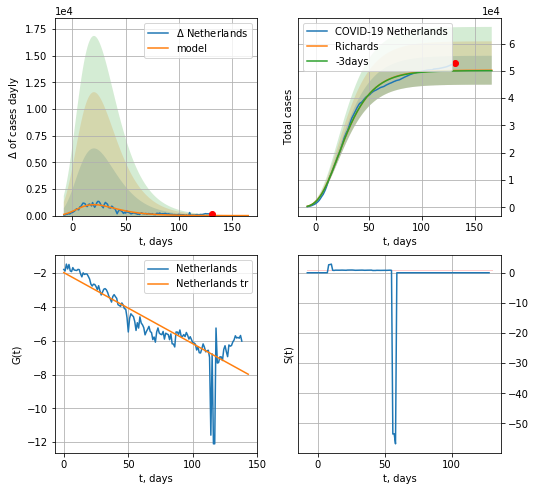

Netherlands data at: 2020-09-19
+3 day model MAPE: 0.003437
model: Richards
coeffs: [ 5.02415869e+04  8.73155449e+00 -6.99416502e+01  6.38067202e-03]
rational stdev: 0.105306
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 50226 ± 5289
	 total death: 3428 ± 1082
trend coefficient of determination: 0.744376
 intercept: -1.967578
 slope: -0.042068


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


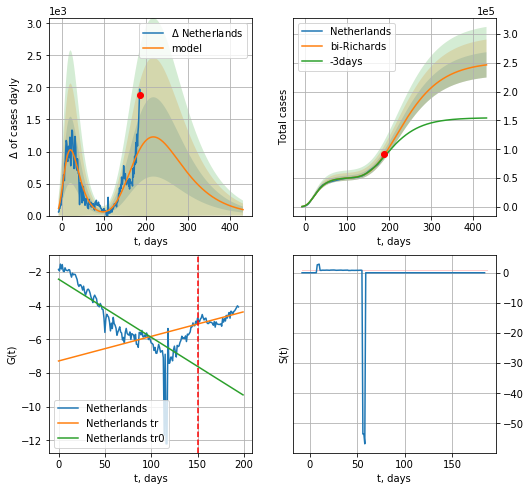

Netherlands data at: 2020-09-19
+3 day model MAPE: 0.029117
model: bi-Richards
coeffs: [ 2.02136101e+05  1.03932103e+00 -3.02435766e+01  1.60185188e-02]
rational stdev: 0.089156
forecast at the end of period: +245 days
	 deltaDaycases: 93
	 total cases: 246720 ± 21996
	 total death: 16840 ± 4504
bi-Richards approximation splitting point: 150
trend coefficient of determination: 0.623543
 intercept: -2.419272
 slope: -0.034557
trend coefficient of determination: 0.346513
 intercept: -7.281478
 slope: 0.014641


In [2196]:
iL = 10
vL = 150+iL
x = forecastRR('Netherlands',dfNL[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Netherlands',dfNL[iL:],d1,60*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [2197]:
#x = forecastQR('Netherlands',dfNL[7:],d1,16*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


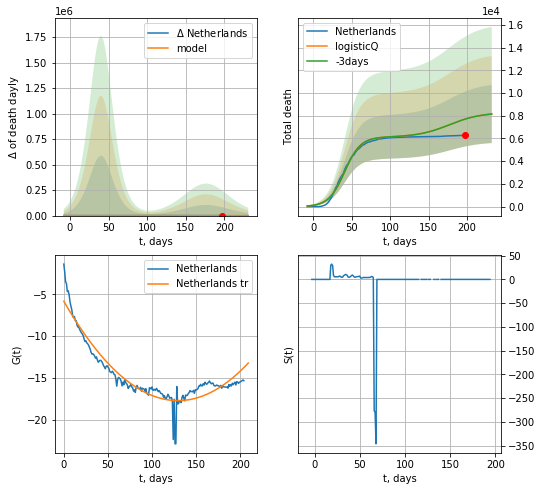

Netherlands data at: 2020-09-19
+3 day model MAPE: 0.000303
model: logisticQ
coeffs: [ 6.11975895e+03  2.68322717e-07  4.05600285e+01 -3.61684244e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.313565
forecast at the end of period: +35 days
	 total death: 8150 ± 2555
trend coefficient of determination: 0.893518
 intercept_: -5.823041334213052
 coeffs_: [ 0.         -0.18352458  0.00070913]


In [2198]:
#x = forecastRRR('Netherlands',dfNL[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Netherlands',dfNL[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

In [2199]:
#trend3(dfAT[1:],dfSG[:],dfBG[:],'AT','SG','BG',40,35,35)

AT
           date    cases  active  death
202 2020-09-15  34305.0    6194  757.0
203 2020-09-16  35073.0    6660  758.0
204 2020-09-17  35853.0    7051  758.0
205 2020-09-18  37474.0    7748  765.0
206 2020-09-19  38095.0    8100  766.0


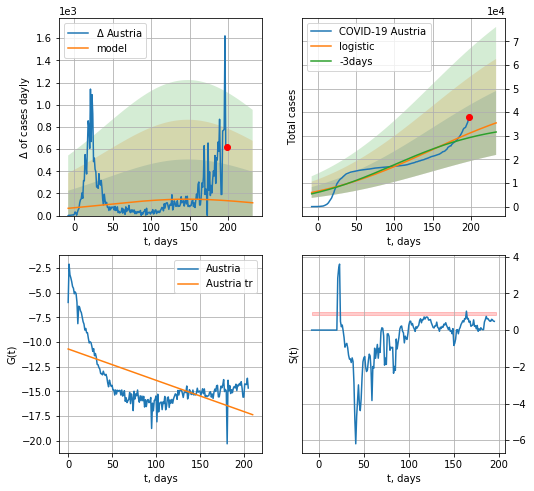

Austria data at: 2020-09-19
+3 day model MAPE: 0.06448270106691531
model: logistic
coeffs:  [4.58866633e+04 1.25249287e-02 1.44536727e+02]
scenario coeffs:  [0.0625, 1.0, 2.0]
rational stdev:  0.3821978833343432
forecast at the end of period: +35 days
	 deltaDaycases:  115
	 total cases:  35445 ± 13547
	 total death:  712 ± 816
trend coefficient of determination: 0.360509
 intercept: -10.712074
 slope: -0.031665


In [2200]:
dfAT = read_df(pd.DataFrame(),"AT")
try:
    x = forecast('Austria',dfAT[:],d1,7*T18-dT,addpred=True,xcoef=[0.25/4,1.,2.0])
except:
    print ("Exception occurs")
#xx = forecast2('Austria',dfAT[:],d1,7*7-dT,x,addpred=True,xcoef=[0.35*2,1.,1.5],vL=36)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


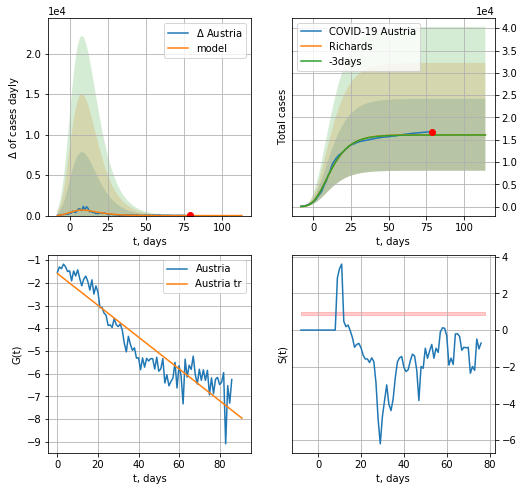

Austria data at: 2020-09-19
+3 day model MAPE: 0.003709
model: Richards
coeffs: [ 1.61192499e+04  1.98642454e+01 -3.60141550e+01  5.80916335e-03]
rational stdev: 0.499924
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 16119 ± 8058
	 total death: 324 ± 485
trend coefficient of determination: 0.864773
 intercept: -1.593329
 slope: -0.069938


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


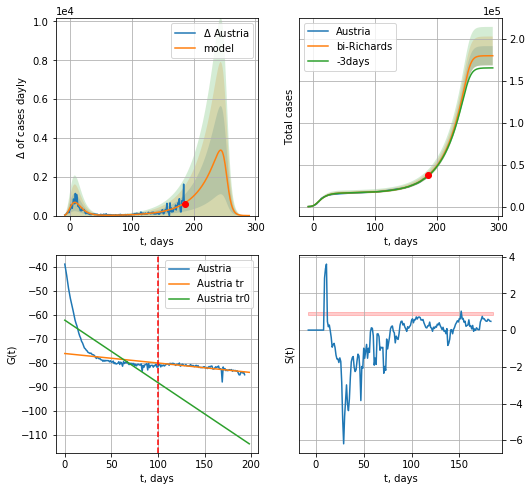

Austria data at: 2020-09-19
+3 day model MAPE: 0.010822
model: bi-Richards
coeffs: [1.64027345e+05 3.08163594e-02 2.52942123e+02 7.65973143e+00]
rational stdev: 0.063680
forecast at the end of period: +105 days
	 deltaDaycases: 0
	 total cases: 180143 ± 11471
	 total death: 3622 ± 691
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.578370
 intercept: -62.194610
 slope: -0.259939
trend coefficient of determination: 0.657746
 intercept: -76.072919
 slope: -0.039516


In [2201]:
vL=100+12
x = forecastRR('Austria',dfAT[12:vL-12],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Austria',dfAT[12:],d12f(1),40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)
#xx = forecast2R('Austria',dfAT[:],d1,8*7-dT,x)

In [2202]:
#vL = 68
#x = forecastRRR('Austria',dfAT[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR('Austria',dfAT[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=vL)

BG
           date     cases  active   death
198 2020-09-15   94795.0   66076  9930.0
199 2020-09-16   95948.0   67203  9935.0
200 2020-09-17   97976.0   69186  9936.0
201 2020-09-18   99649.0   70804  9937.0
202 2020-09-19  100748.0   71859  9944.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


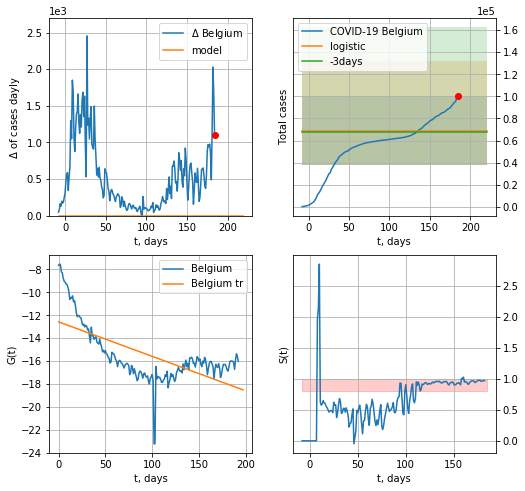

Belgium data at: 2020-09-19
+3 day model MAPE: 0.0127713908335468
model: logistic
coeffs:  [ 5.51666593e+04 -1.14253682e+01  3.39943783e+02]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.45380908203477444
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  68958 ± 31293
	 total death:  6806 ± 9265
trend coefficient of determination: 0.437402
 intercept: -12.577496
 slope: -0.030127


In [2203]:
vL=9
try:
    dfBG = read_df(pd.DataFrame(),"BG")
    x = forecast('Belgium',dfBG[vL:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,3.])
    #xx = forecast2('Belgium',dfBG[vL:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
except:
    print("Exception occurs")

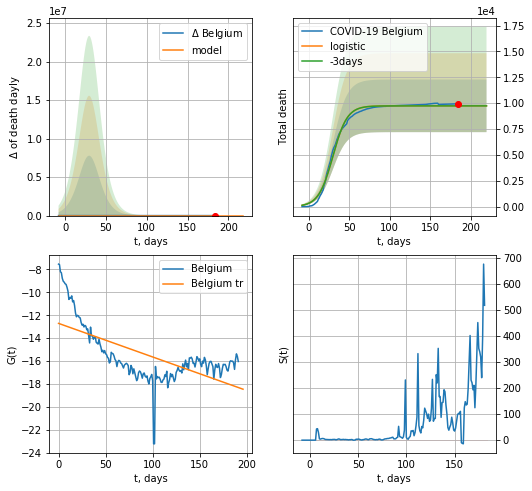

Belgium data at: 2020-09-19
+3 day model MAPE: 0.0005188522173146937
model: logistic
coeffs:  [9.74516633e+03 1.13500309e-01 2.99474580e+01]
rational stdev:  0.2609643203614611
forecast at the end of period: +35 days
	 total death:  9745 ± 2543
trend coefficient of determination: 0.429117
 intercept: -12.710308
 slope: -0.029321


In [2204]:
#dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[10:],d1,T18*7-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


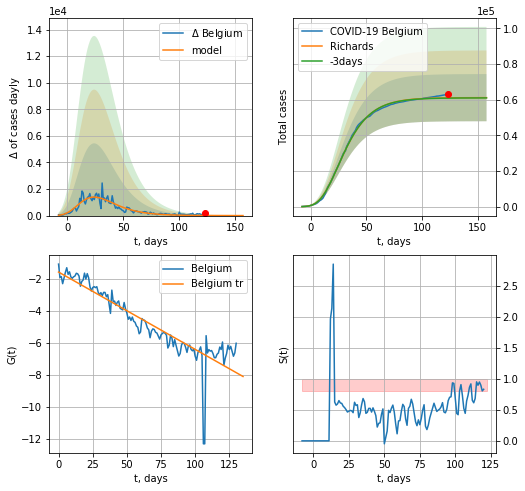

Belgium data at: 2020-09-19
+3 day model MAPE: 0.002325
model: Richards
coeffs: [ 6.11994198e+04  7.57384886e+00 -5.28924887e+01  8.21594131e-03]
rational stdev: 0.216332
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 61184 ± 13236
	 total death: 6039 ± 3919
trend coefficient of determination: 0.812352
 intercept: -1.573316
 slope: -0.048332


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


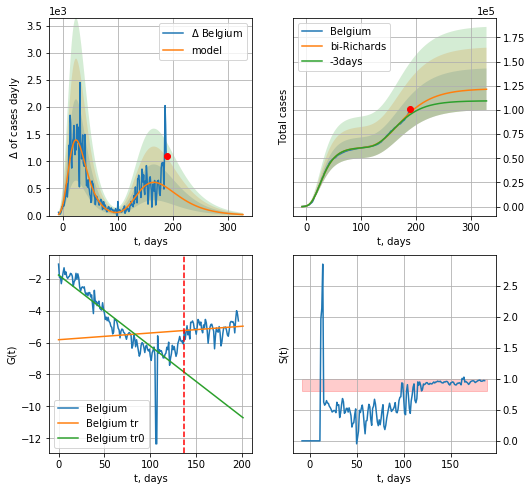

Belgium data at: 2020-09-19
+3 day model MAPE: 0.021825
model: bi-Richards
coeffs: [6.08250607e+04 2.42166822e+00 3.62157618e+00 1.13791647e-02]
rational stdev: 0.177127
forecast at the end of period: +140 days
	 deltaDaycases: 18
	 total cases: 121346 ± 21493
	 total death: 11977 ± 6364
bi-Richards approximation splitting point: 137
trend coefficient of determination: 0.771753
 intercept: -1.775575
 slope: -0.044430
trend coefficient of determination: 0.025943
 intercept: -5.825664
 slope: 0.004215


In [2205]:
iL = 5
vL = 137+ iL
x = forecastRR('Belgium',dfBG[iL:vL-iL],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Belgium',dfBG[iL:],d1,45*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [2206]:
#x = forecastRRR('Belgium',dfBG[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

In [2207]:
dfBZ.tail()

,date,cases,active,death
203,2020-09-15,4384299.0,579964,133207.0
204,2020-09-16,4421686.0,567200,134174.0
205,2020-09-17,4457443.0,569330,135031.0
206,2020-09-18,4497434.0,572438,135857.0
207,2020-09-19,4528347.0,571687,136565.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


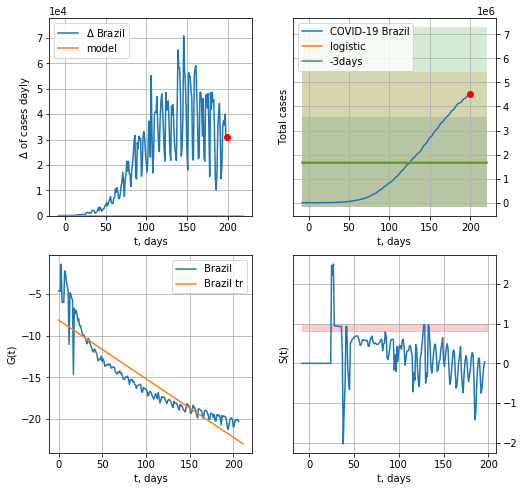

Brazil data at: 2020-09-19
+3 day model MAPE: 0.034752503906285974
model: logistic
coeffs:  [ 1.36400961e+06 -2.46079156e+01  5.90764374e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.095387146409942
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  1705012 ± 1867648
	 total death:  51419 ± 168971
trend coefficient of determination: 0.849795
 intercept: -8.125937
 slope: -0.070329


In [2208]:
x = forecast('Brazil',dfBZ[:],d1,28*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx = forecast2('Brazil',dfBZ[:],d1,4*7-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


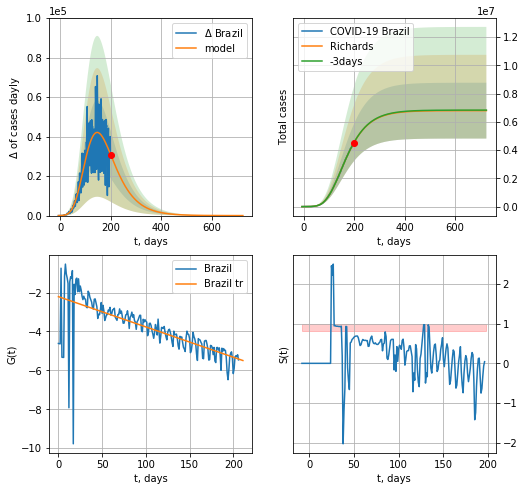

Brazil data at: 2020-09-19
+3 day model MAPE: 0.001235
model: Richards
coeffs: [ 6.79090456e+06  5.53123686e-01 -5.68643570e+01  3.09559162e-02]
rational stdev: 0.290799
forecast at the end of period: +525 days
	 deltaDaycases: 5
	 total cases: 6790562 ± 1974690
	 total death: 204788 ± 178656
trend coefficient of determination: 0.504053
 intercept: -2.207473
 slope: -0.015572


In [2209]:
x = forecastRR('Brazil',dfBZ[:],d1,100*7-dT,addpred=False,xcoef=RkoreaCoeffs)
#x = forecastQR('Brazil',dfBZ[10:],d1,50*7-dT)

In [2210]:
#x = forecastRRR('Brazil',dfBZ[6:],d1,70*7-dT,addpred=True,xcoef=koreaCoeffs)

In [2211]:
#x = forecastRRR('Brazil',dfBZ[5:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

AS
           date    cases  active  death
213 2020-09-15  26779.0    2229  824.0
214 2020-09-16  26813.0    2189  832.0
215 2020-09-17  26861.0    2169  837.0
216 2020-09-18  26885.0    2079  844.0
217 2020-09-19  26898.0    1987  849.0


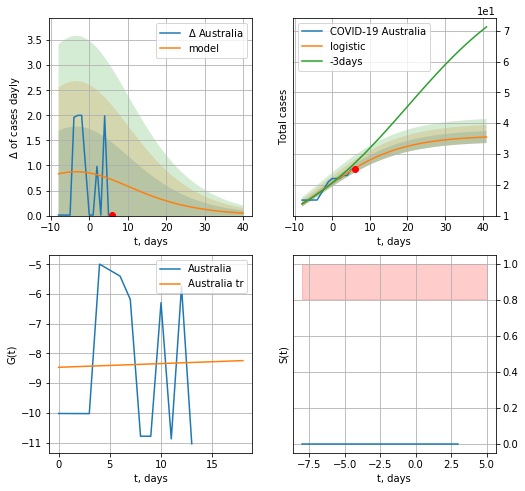

Australia data at: 2020-09-19
model: logistic
coeffs:  [35.98148465  0.0972901  -2.93370788]
rational stdev:  0.05518162900834631
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  35 ± 1
	 total death:  1 ± 0
trend coefficient of determination: 0.000431
 intercept: -8.467221
 slope: 0.012491


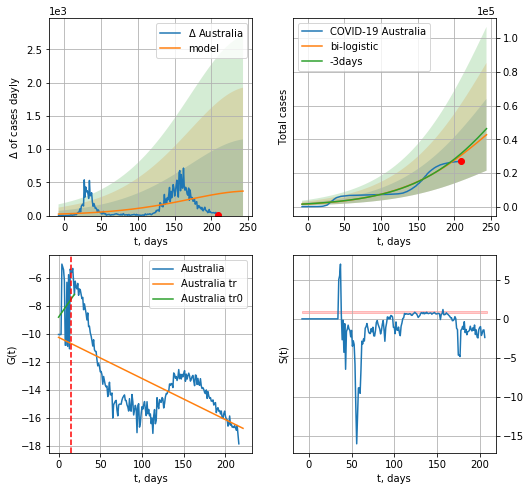

Australia data at: 2020-09-19
+3 day model MAPE: 0.0331860686506941
model: bi-logistic
coeffs:  [9.31302599e+04 1.59288566e-02 2.54582399e+02] [35.98148465  0.0972901  -2.93370788]
rational stdev:  0.4997790454859939
forecast at the end of period: +35 days
	 deltaDaycases:  367
	 total cases:  42685 ± 21333
	 total death:  1347 ± 2019
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.022779
 intercept: -8.785888
 slope: 0.086030
trend coefficient of determination: 0.407461
 intercept: -10.226796
 slope: -0.029414


In [2212]:
dfAS = read_df(pd.DataFrame(),"AS")
try:
    x = forecast('Australia',dfAS[:15],d1,T18*7-dT,pMAPE=False)
    xx = forecast2('Australia',dfAS[:],d1,T18*7-dT,x,vL=15,addpred=False,xcoef=[0.25/4,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


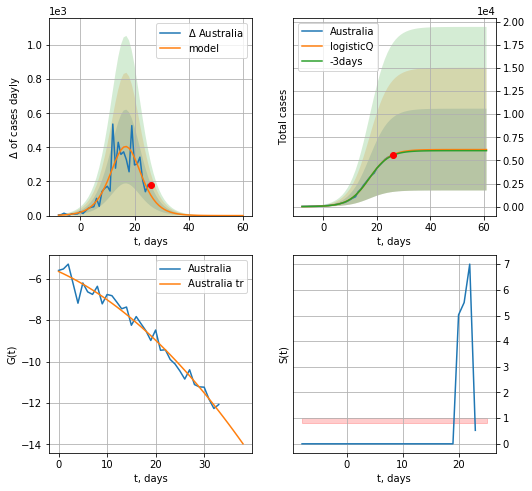

Australia data at: 2020-09-19
+3 day model MAPE: 0.012936
model: logisticQ
coeffs: [ 6.16826027e+03  4.63150668e-05  1.72354354e+01 -5.67232010e+03]
rational stdev: 0.716727
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 6168 ± 4420
	 total death: 194 ± 417
trend coefficient of determination: 0.975101
 intercept_: -5.657250296853678
 coeffs_: [ 0.         -0.10702975 -0.00294069]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


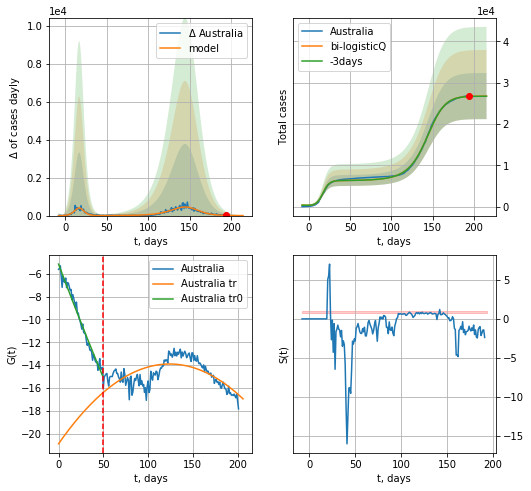

Australia data at: 2020-09-19
+3 day model MAPE: 0.001244
model: bi-logisticQ
coeffs: [ 2.06116543e+04  4.03564363e-04  1.42360211e+02 -7.42840514e+01]
rational stdev: 0.208363
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 26775 ± 5579
	 total death: 845 ± 528
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.978786
 intercept_: -5.1508340728883
 coeffs_: [ 0.00000000e+00 -2.09278795e-01  2.06303704e-04]
trend coefficient of determination: 0.433209
 intercept_: -20.89844065385571
 coeffs_: [ 0.          0.11279376 -0.00045468]


In [2213]:
#axcoef = [koreaCoeffs[0],koreaCoeffs[1],koreaCoeffs[2],koreaCoeffs[3]]
vL = 50
x = forecastRRR('Australia',dfAS[15:vL],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Australia',dfAS[15:],d1,28*7-dT,x,addpred=False,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


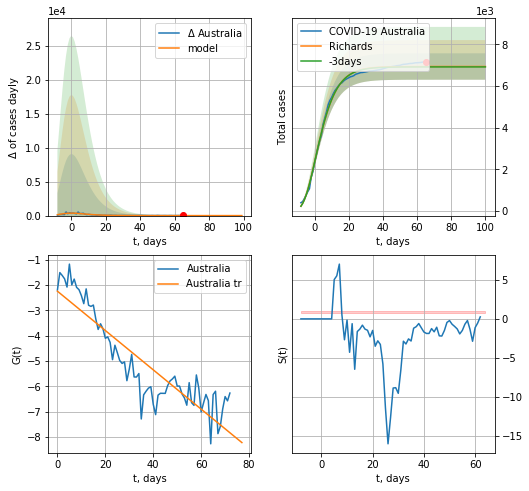

Australia data at: 2020-09-19
+3 day model MAPE: 0.002782
model: Richards
coeffs: [ 6.93376739e+03  1.41182137e+01 -3.14466269e+01  1.01384170e-02]
rational stdev: 0.091309
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 6933 ± 633
	 total death: 218 ± 59
trend coefficient of determination: 0.809708
 intercept: -2.241214
 slope: -0.077557


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


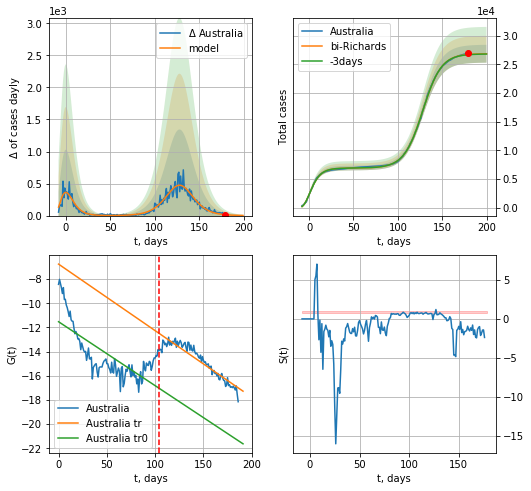

Australia data at: 2020-09-19
+3 day model MAPE: 0.001749
model: bi-Richards
coeffs: [1.99398484e+04 9.31720003e-02 1.28527282e+02 1.03023249e+00]
rational stdev: 0.058023
forecast at the end of period: +21 days
	 deltaDaycases: 2
	 total cases: 26853 ± 1558
	 total death: 847 ± 147
bi-Richards approximation splitting point: 104
trend coefficient of determination: 0.545093
 intercept: -11.525810
 slope: -0.052867
trend coefficient of determination: 0.872039
 intercept: -6.761826
 slope: -0.055015


In [2214]:
iL = 20+10
vL = 104+iL
x = forecastRR('Australia',dfAS[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Australia',dfAS[iL:],d1,28*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

ML
           date    cases  active  death
201 2020-09-15   9969.0     632  128.0
202 2020-09-16  10031.0     668  128.0
203 2020-09-17  10052.0     674  128.0
204 2020-09-18  10147.0     754  129.0
205 2020-09-19  10219.0     734  130.0


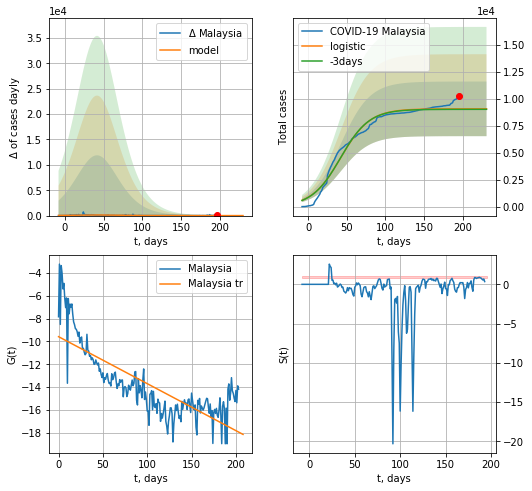

Malaysia data at: 2020-09-19
+3 day model MAPE: 0.004916671781911136
model: logistic
coeffs:  [9.06214227e+03 5.31530897e-02 4.20800049e+01]
rational stdev:  0.2791761204982242
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  9061 ± 2529
	 total death:  115 ± 96
trend coefficient of determination: 0.623678
 intercept: -9.577203
 slope: -0.041276


In [2215]:
try:
    dfML = read_df(pd.DataFrame(),"ML")
    x = forecast('Malaysia',dfML[1:],d1,T18*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])
except:
    print ("Exception occurs")

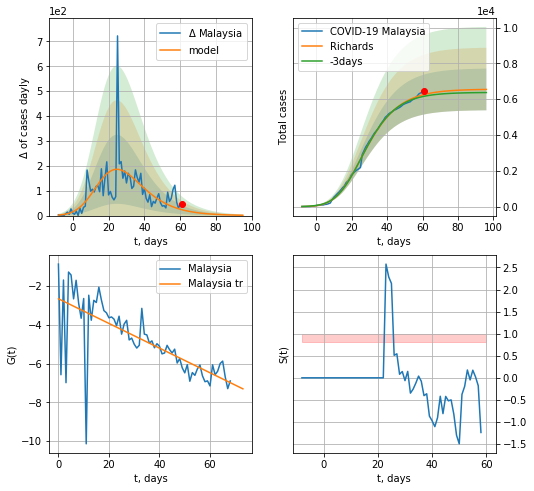

Malaysia data at: 2020-09-19
+3 day model MAPE: 0.016662
model: Richards
coeffs: [6.55737988e+03 3.88576721e-01 7.38244597e+00 2.20016068e-01]
rational stdev: 0.177893
forecast at the end of period: +35 days
	 deltaDaycases: 1
	 total cases: 6542 ± 1163
	 total death: 83 ± 44
trend coefficient of determination: 0.508700
 intercept: -2.652908
 slope: -0.063638


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


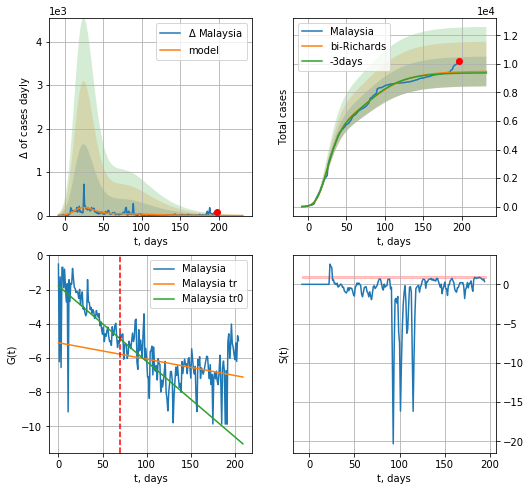

Malaysia data at: 2020-09-19
+3 day model MAPE: 0.009205
model: bi-Richards
coeffs: [ 2.92036434e+03  1.06529957e+01 -7.62864788e+01  3.33533684e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.109978
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 9462 ± 1040
	 total death: 120 ± 39
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.323514
 intercept: -1.797731
 slope: -0.044119
trend coefficient of determination: 0.086479
 intercept: -5.112894
 slope: -0.009574


In [2216]:
vL = 70
x = forecastRR('Malaysia',dfML[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Malaysia',dfML[:],d12f(1),T18*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

In [2218]:
#x = forecastRRR('Malaysia',dfML[:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs)

ZL
           date   cases  active  death
200 2020-09-15  1802.0      79   25.0
201 2020-09-16  1809.0      77   25.0
202 2020-09-17  1809.5      70   25.0
203 2020-09-18  1811.0      67   25.0
204 2020-09-19  1815.0      71   25.0


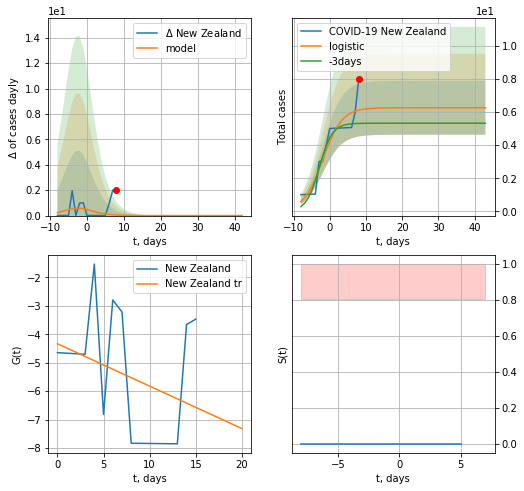

New Zealand data at: 2020-09-19
model: logistic
coeffs:  [ 6.26235964  0.37662733 -1.95315912]
rational stdev:  0.26005250706023997
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  6 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.103357
 intercept: -4.332661
 slope: -0.149156


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


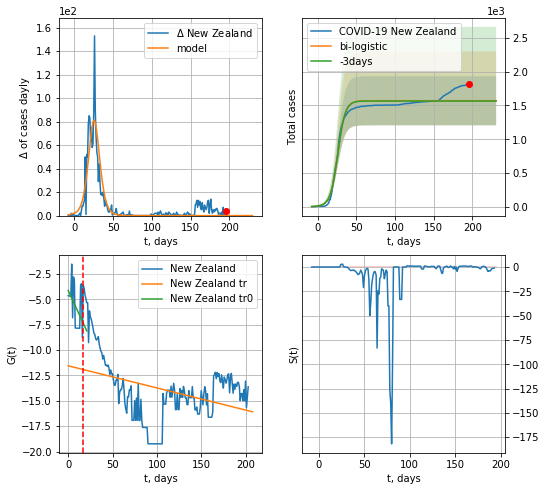

New Zealand data at: 2020-09-19
+3 day model MAPE: 0.0031416494458463592
model: bi-logistic
coeffs:  [1.56460115e+03 2.07720135e-01 2.59130402e+01] [ 6.26235964  0.37662733 -1.95315912]
rational stdev:  0.23220058562121298
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  1570 ± 364
	 total death:  21 ± 14
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.175036
 intercept: -4.131936
 slope: -0.189301
trend coefficient of determination: 0.136708
 intercept: -11.549368
 slope: -0.021802


In [2219]:
vL=17
dfZL = read_df(pd.DataFrame(),"ZL")
try:
    x = forecast('New Zealand',dfZL[:vL],d1,T18*7-dT,pMAPE=False)
    xx = forecast2('New Zealand',dfZL[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)#
except:
    print ("Exception occurs")

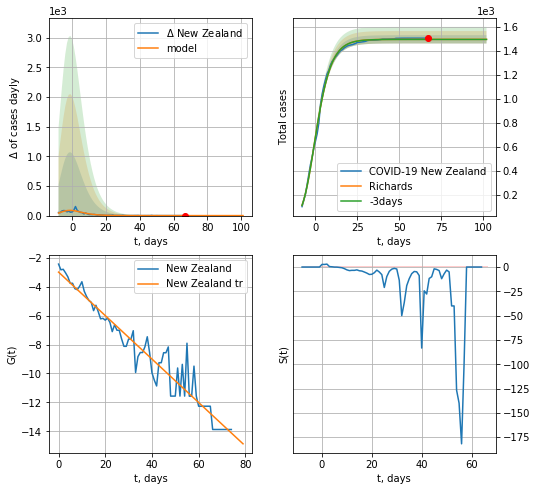

New Zealand data at: 2020-09-19
+3 day model MAPE: 0.000505
model: Richards
coeffs: [ 1.49487953e+03  6.79159620e-01 -8.03485752e+00  2.67314239e-01]
rational stdev: 0.023076
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 1494 ± 34
	 total death: 20 ± 1
trend coefficient of determination: 0.938641
 intercept: -2.993592
 slope: -0.150300


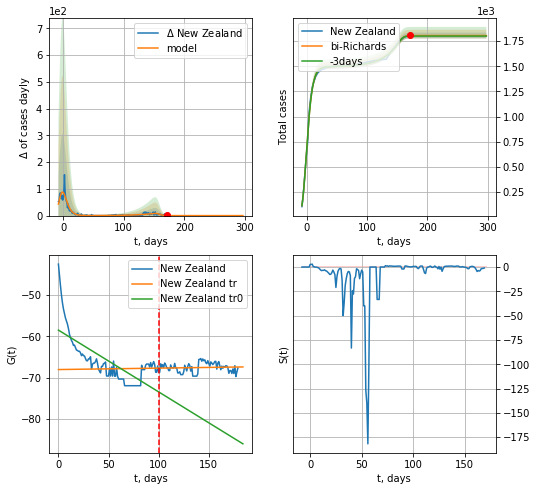

New Zealand data at: 2020-09-19
+3 day model MAPE: 0.002897
model: bi-Richards
coeffs: [3.11236320e+02 3.88010139e-02 1.58866001e+02 8.20389639e+00]
rational stdev: 0.015843
forecast at the end of period: +126 days
	 deltaDaycases: 0
	 total cases: 1806 ± 28
	 total death: 24 ± 1
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.530814
 intercept: -58.468714
 slope: -0.149787
trend coefficient of determination: 0.004640
 intercept: -68.026609
 slope: 0.003436


In [2220]:
iL = 24
vL = 100+iL
x = forecastRR('New Zealand',dfZL[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('New Zealand',dfZL[iL:],d12f(1),43*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [2221]:
#x = forecastRRR('New Zealand',dfZL[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

BR
           date    cases  active  death
200 2020-09-15  74552.0    1130  761.0
201 2020-09-16  74763.0    1186  767.0
202 2020-09-17  74987.0    1249  771.0
203 2020-09-18  75230.0    1359  773.0
204 2020-09-19  75461.0    1473  776.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


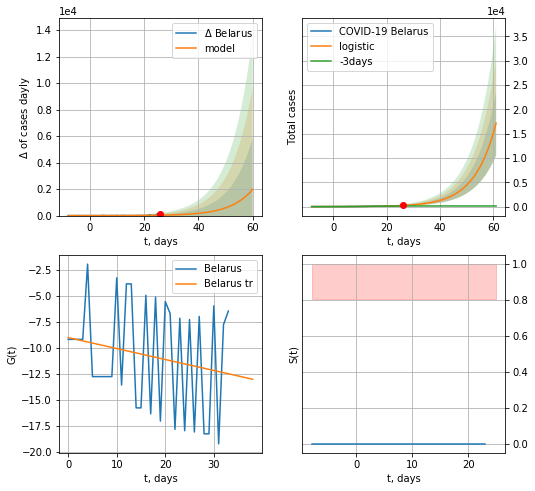

Belarus data at: 2020-09-19
+3 day model MAPE: 1.0426305188408567
model: logistic
coeffs:  [1.42197385e+06 1.24002039e-01 9.65328876e+01]
rational stdev:  0.3845289039536378
forecast at the end of period: +35 days
	 deltaDaycases:  1977
	 total cases:  17141 ± 6591
	 total death:  176 ± 203
trend coefficient of determination: 0.039182
 intercept: -9.040329
 slope: -0.105417


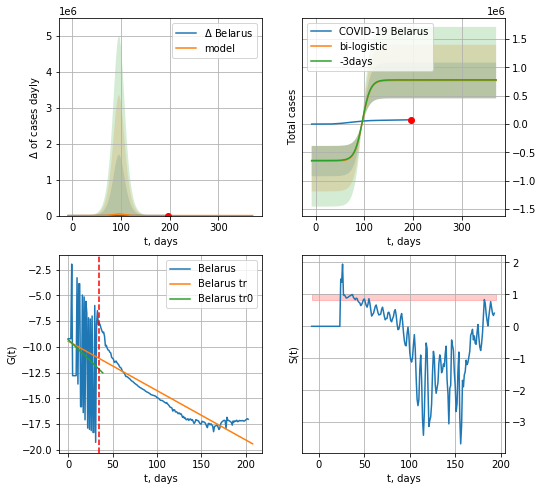

Belarus data at: 2020-09-19
+3 day model MAPE: 0.013221158411928547
model: bi-logistic
coeffs:  [-6.53146077e+05  1.35437613e+01 -3.05856075e+02] [1.42197385e+06 1.24002039e-01 9.65328876e+01]
rational stdev:  0.40940025016426834
forecast at the end of period: +175 days
	 deltaDaycases:  0
	 total cases:  768827 ± 314758
	 total death:  7906 ± 9710
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.026128
 intercept: -9.289300
 slope: -0.082783
trend coefficient of determination: 0.825550
 intercept: -9.449375
 slope: -0.047845


In [2222]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:35],d1,7*T18-dT)
xx = forecast2('Belarus',dfBR[:],d1,50*7-dT,x,addpred=False,xcoef=[0.25,1.,1.8],vL=35)

BR
           date    cases  active  death
200 2020-09-15  74552.0    1130  761.0
201 2020-09-16  74763.0    1186  767.0
202 2020-09-17  74987.0    1249  771.0
203 2020-09-18  75230.0    1359  773.0
204 2020-09-19  75461.0    1473  776.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


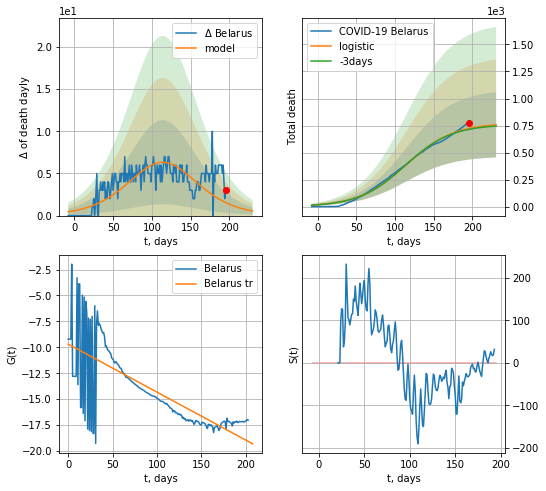

Belarus data at: 2020-09-19
+3 day model MAPE: 0.01229996796062539
model: logistic
coeffs:  [7.73766122e+02 3.27367835e-02 1.14483286e+02]
rational stdev:  0.3985788187496557
forecast at the end of period: +35 days
	 total death:  757 ± 301
trend coefficient of determination: 0.575454
 intercept: -9.690025
 slope: -0.046207


In [2223]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:],d1,T18*7-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


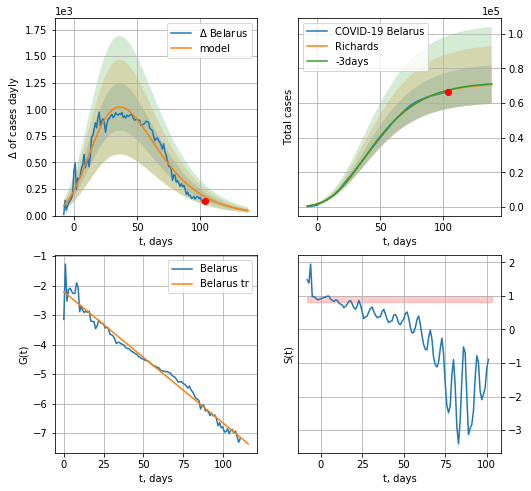

Belarus data at: 2020-09-19
+3 day model MAPE: 0.003761
model: Richards
coeffs: [ 7.18037592e+04  4.57951913e-01 -2.34141452e+01  8.81440501e-02]
rational stdev: 0.157351
forecast at the end of period: +35 days
	 deltaDaycases: 46
	 total cases: 70655 ± 11117
	 total death: 726 ± 342
trend coefficient of determination: 0.978684
 intercept: -2.208926
 slope: -0.044428


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


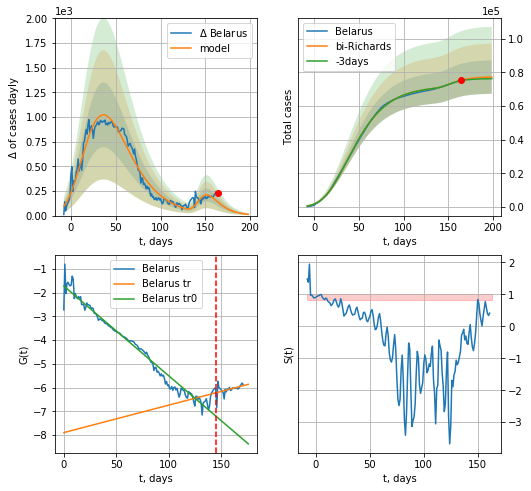

Belarus data at: 2020-09-19
+3 day model MAPE: 0.004299
model: bi-Richards
coeffs: [5.57552570e+03 1.38231200e+01 9.59840999e+01 6.43888331e-03]
rational stdev: 0.128809
forecast at the end of period: +35 days
	 deltaDaycases: 12
	 total cases: 77187 ± 9942
	 total death: 793 ± 306
bi-Richards approximation splitting point: 145
trend coefficient of determination: 0.967298
 intercept: -1.726748
 slope: -0.037709
trend coefficient of determination: 0.199719
 intercept: -7.891491
 slope: 0.011537


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power


In [2224]:
iL=32
vL = 145+iL
x = forecastRR('Belarus',dfBR[iL:vL-iL],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Belarus',dfBR[iL:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastRRR('Belarus',dfBR[iL:],d1,30*7-dT,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


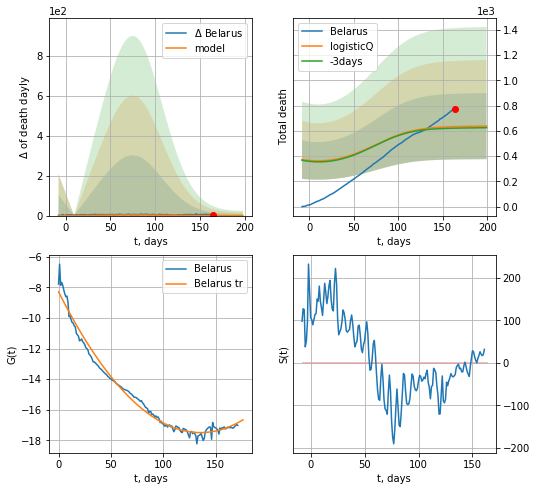

Belarus data at: 2020-09-19
+3 day model MAPE: 0.019744
model: logisticQ
coeffs: [5.36893984e+02 2.44283250e-04 1.65085130e+01 2.56988644e+00]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.410057
forecast at the end of period: +35 days
	 total death: 637 ± 261
trend coefficient of determination: 0.983014
 intercept_: -8.297019761618941
 coeffs_: [ 0.         -0.13591023  0.00050226]


In [2225]:
x = forecastRRR('Belarus',dfBR[32:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

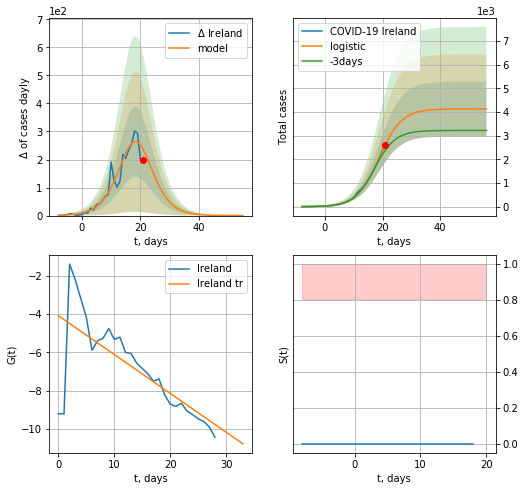

Ireland data at: 2020-09-19
+3 day model MAPE: 0.12282208937722881
model: logistic
coeffs:  [4.12730398e+03 2.56984382e-01 1.88154165e+01]
rational stdev:  0.27980533262906077
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  4127 ± 1154
	 total death:  227 ± 190
trend coefficient of determination: 0.521820
 intercept: -4.083344
 slope: -0.202899


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


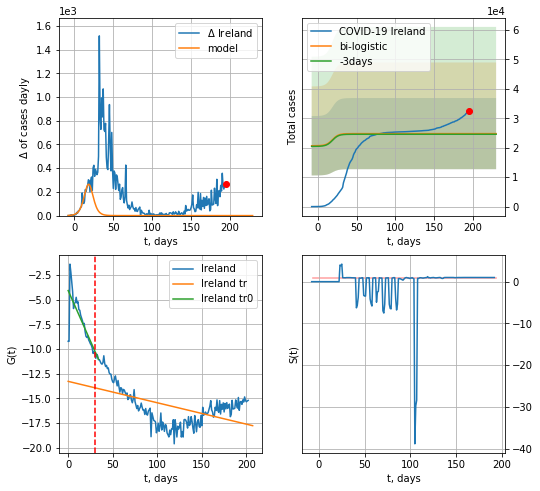

Ireland data at: 2020-09-19
+3 day model MAPE: 0.00880810299059873
model: bi-logistic
coeffs:  [ 1.65417320e+04 -1.25089821e+01  3.11642373e+02] [4.12730398e+03 2.56984382e-01 1.88154165e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.48734395418730114
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  24804 ± 12088
	 total death:  1366 ± 1997
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.551550
 intercept: -4.065434
 slope: -0.204818
trend coefficient of determination: 0.275350
 intercept: -13.266884
 slope: -0.021683


In [2226]:
vL=30
x = forecast('Ireland',dfIR[:vL],d1,T18*7-dT)
xx = forecast2('Ireland',dfIR[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


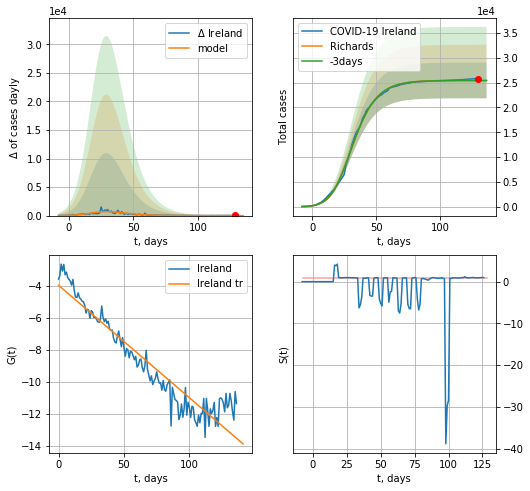

Ireland data at: 2020-09-19
+3 day model MAPE: 0.000894
model: Richards
coeffs: [2.54407353e+04 2.28847737e-01 1.92916171e+01 3.96517588e-01]
rational stdev: 0.141278
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 25439 ± 3593
	 total death: 1401 ± 593
trend coefficient of determination: 0.901596
 intercept: -3.946012
 slope: -0.070416


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


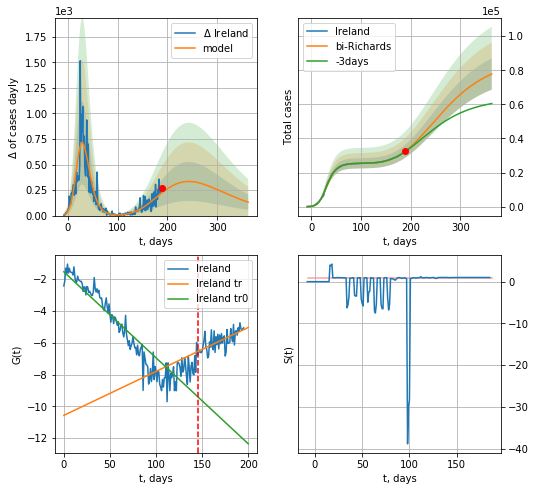

Ireland data at: 2020-09-19
+3 day model MAPE: 0.007032
model: bi-Richards
coeffs: [ 6.19801522e+04  5.82532981e-01 -4.23623820e+00  2.54814733e-02]
rational stdev: 0.118266
forecast at the end of period: +175 days
	 deltaDaycases: 131
	 total cases: 77833 ± 9205
	 total death: 4286 ± 1520
bi-Richards approximation splitting point: 145
trend coefficient of determination: 0.863106
 intercept: -1.544460
 slope: -0.054057
trend coefficient of determination: 0.454847
 intercept: -10.567807
 slope: 0.027627


In [2227]:
ivL = 7
vL = 145 +ivL
x = forecastRR('Ireland',dfIR[ivL:vL-ivL],d1,26*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Ireland',dfIR[ivL:],d1,50*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-ivL)
#x = forecastRRR('Ireland',dfIR[3:],d1,66*7-dT,addpred=True,xcoef=koreaCoeffs)

CL
           date   cases  active    death
196 2020-09-15  437983   15999  12040.0
197 2020-09-16  439287   15376  12058.0
198 2020-09-17  441150   15080  12142.0
199 2020-09-18  442827   14647  12199.0
200 2020-09-19  444674   14319  12254.0


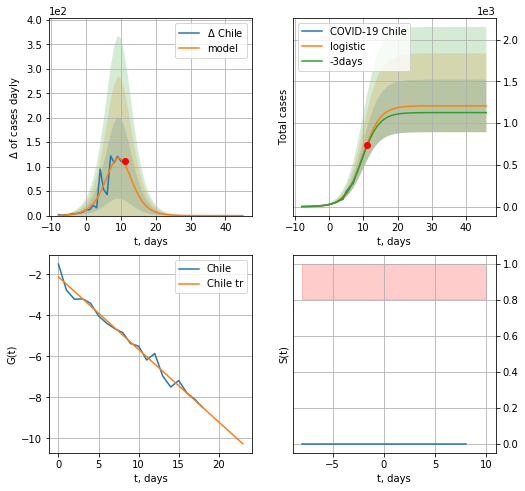

Chile data at: 2020-09-19
+3 day model MAPE: 0.03908993891192624
model: logistic
coeffs:  [1.20759839e+03 3.93191843e-01 9.80781865e+00]
rational stdev:  0.2610672451056305
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  1207 ± 315
	 total death:  33 ± 25
trend coefficient of determination: 0.982168
 intercept: -2.127319
 slope: -0.354074


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


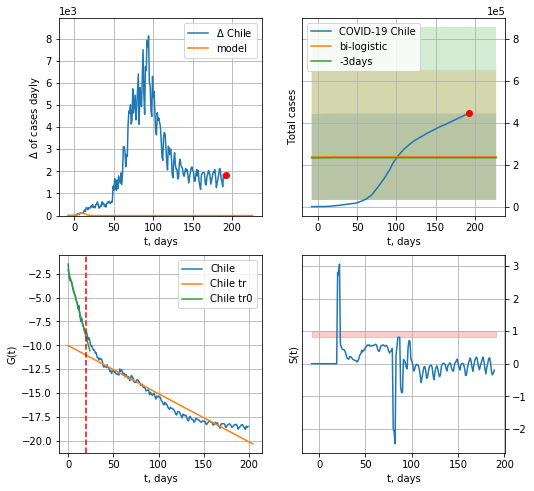

Chile data at: 2020-09-19
+3 day model MAPE: 0.020432308829940054
model: bi-logistic
coeffs:  [ 1.89702172e+05 -3.81205619e+01  9.13681704e+02] [1.20759839e+03 3.93191843e-01 9.80781865e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.86636850574423
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  238335 ± 206486
	 total death:  6567 ± 17068
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.984051
 intercept: -2.144368
 slope: -0.351232
trend coefficient of determination: 0.928387
 intercept: -10.032353
 slope: -0.050397


In [2228]:
vL=20
dfCL = read_df(pd.DataFrame(),"CL")
x = forecast('Chile',dfCL[:vL],d1,7*T18-dT)
xx = forecast2('Chile',dfCL[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


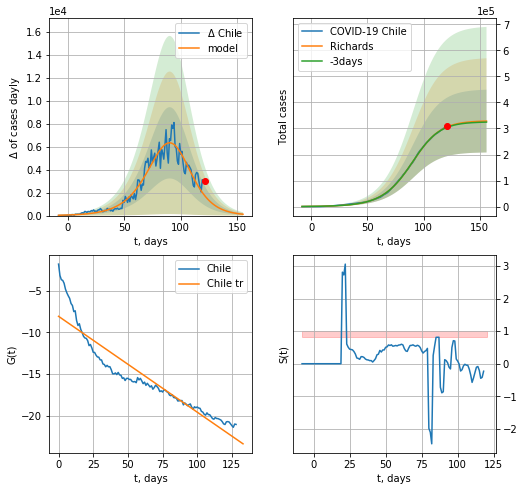

Chile data at: 2020-09-19
+3 day model MAPE: 0.006062
model: Richards
coeffs: [3.29740872e+05 6.47237974e-02 9.37490232e+01 1.29835958e+00]
rational stdev: 0.366980
forecast at the end of period: +35 days
	 deltaDaycases: 117
	 total cases: 328389 ± 120512
	 total death: 9049 ± 9962
trend coefficient of determination: 0.871763
 intercept: -8.084056
 slope: -0.114797


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: RuntimeWarning: overflow encountered in power


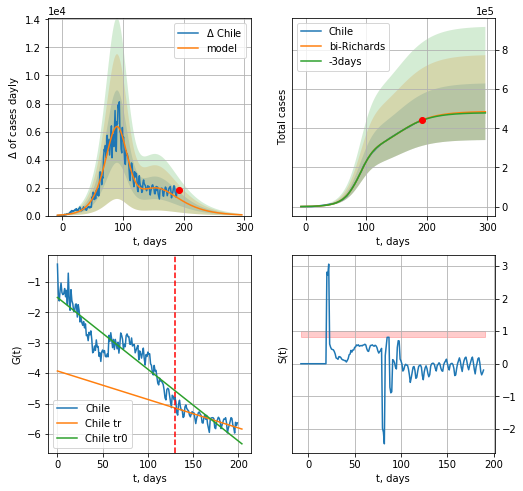

Chile data at: 2020-09-19
+3 day model MAPE: 0.003416
model: bi-Richards
coeffs: [1.56144951e+05 2.92255042e+00 2.15323637e+01 1.12103536e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.298232
forecast at the end of period: +105 days
	 deltaDaycases: 55
	 total cases: 484218 ± 144409
	 total death: 13343 ± 11937
bi-Richards approximation splitting point: 130
trend coefficient of determination: 0.819894
 intercept: -1.513038
 slope: -0.023554
trend coefficient of determination: 0.585006
 intercept: -3.926291
 slope: -0.009348


In [2230]:
vL = 130
x = forecastRR('Chile',dfCL[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Chile',dfCL[:],d1,40*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastRRR('Chile',dfCL[:],d1,24*7-dT,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


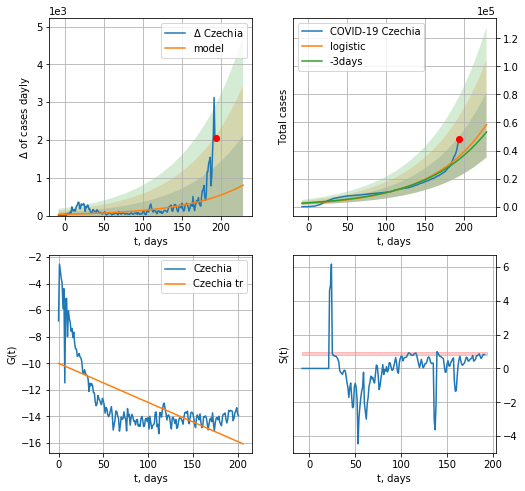

Czechia data at: 2020-09-19
+3 day model MAPE: 0.06430639757736321
model: logistic
coeffs:  [1.26751576e+08 1.38685415e-02 7.82829349e+02]
rational stdev:  0.3972903370690838
forecast at the end of period: +35 days
	 deltaDaycases:  805
	 total cases:  58481 ± 23234
	 total death:  604 ± 719
trend coefficient of determination: 0.445406
 intercept: -10.002202
 slope: -0.029424


In [2231]:
x = forecast('Czechia',dfCH[:],d1,T18*7-dT,shift=1.,addpred=False,xcoef=[0.25,1.,2.4])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


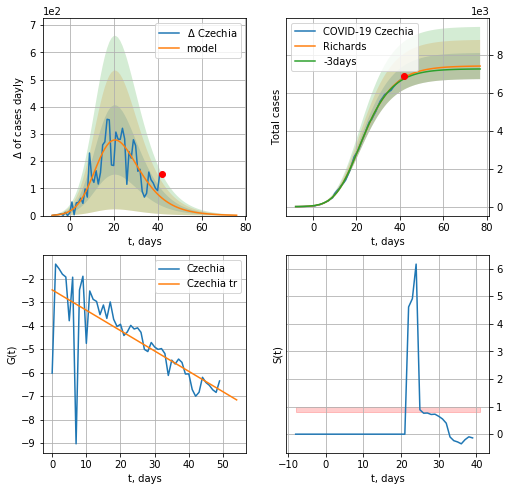

Czechia data at: 2020-09-19
+3 day model MAPE: 0.010228
model: Richards
coeffs: [7.42051660e+03 4.02436253e-01 1.04335240e+01 2.89181992e-01]
rational stdev: 0.092864
forecast at the end of period: +35 days
	 deltaDaycases: 1
	 total cases: 7409 ± 688
	 total death: 76 ± 21
trend coefficient of determination: 0.545044
 intercept: -2.483478
 slope: -0.086661


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


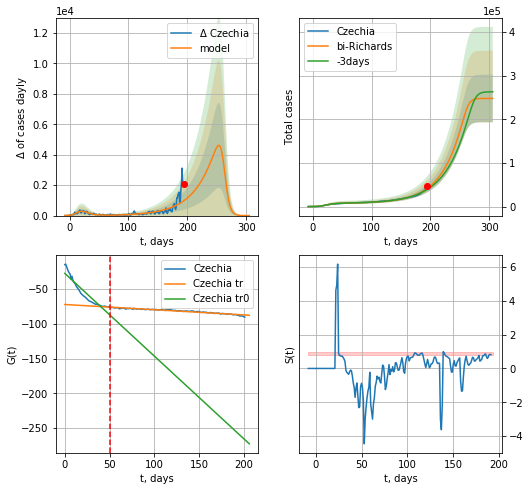

Czechia data at: 2020-09-19
+3 day model MAPE: 0.066129
model: bi-Richards
coeffs: [2.40377063e+05 2.83830954e-02 2.62915093e+02 8.07397113e+00]
rational stdev: 0.220397
forecast at the end of period: +112 days
	 deltaDaycases: 0
	 total cases: 247796 ± 54613
	 total death: 2559 ± 1691
bi-Richards approximation splitting point: 51
trend coefficient of determination: 0.879059
 intercept: -27.269563
 slope: -1.191412
trend coefficient of determination: 0.943966
 intercept: -72.072507
 slope: -0.075031


In [2232]:
vL= 51
x = forecastRR('Czechia',dfCH[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Czechia',dfCH[:],d1,41*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastRRR('Czechia',dfCH[:],d1,60*7-dT,addpred=True,xcoef=koreaCoeffs)

          date   cases    active    death
191 2020-09-15  676487  123741.0  71678.0
192 2020-09-16  680931  123929.0  71978.0
193 2020-09-17  684113  123518.0  72179.0
194 2020-09-18  688954  123959.0  72803.0
195 2020-09-19  694121  124639.0  73258.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:86: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


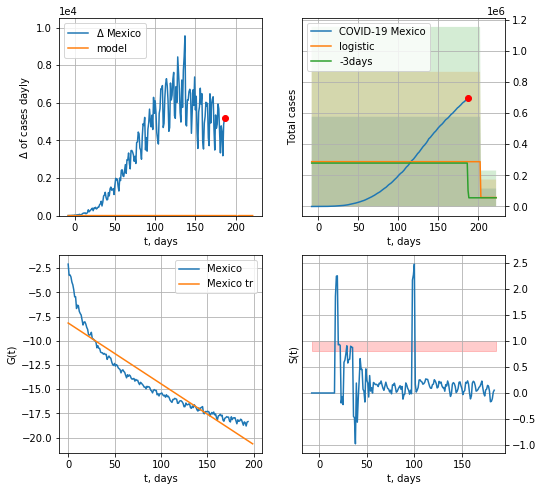

Mexico data at: 2020-09-19
+3 day model MAPE: 4.160020994811847
model: logistic
coeffs:  [ 2.30062580e+05 -8.37467178e+01  2.02875636e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.0030214403202817
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  57515 ± 57689
	 total death:  6070 ± 18265
trend coefficient of determination: 0.860784
 intercept: -8.164679
 slope: -0.062719


In [2233]:
print (dfMX.tail())
x = forecast('Mexico',dfMX[:],d1,T18*7-dT,addpred=True,xcoef=[.25,1.,2.])#

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


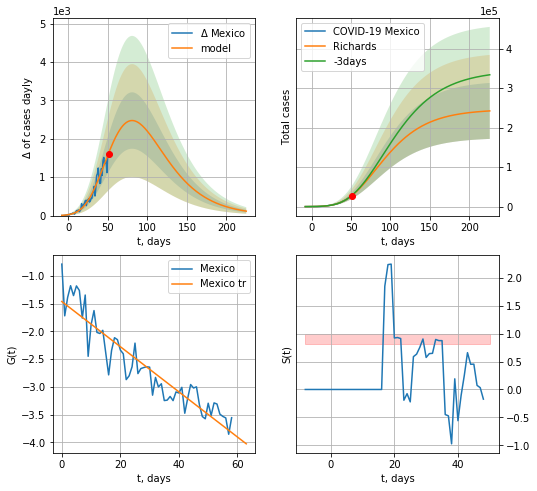

Mexico data at: 2020-09-19
+3 day model MAPE: 0.013781
model: Richards
coeffs: [ 2.46197399e+05  4.05650878e-01 -1.28761086e+01  6.97244909e-02]
rational stdev: 0.292607
forecast at the end of period: +175 days
	 deltaDaycases: 115
	 total cases: 242125 ± 70847
	 total death: 25554 ± 22431
trend coefficient of determination: 0.864363
 intercept: -1.463809
 slope: -0.040682


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


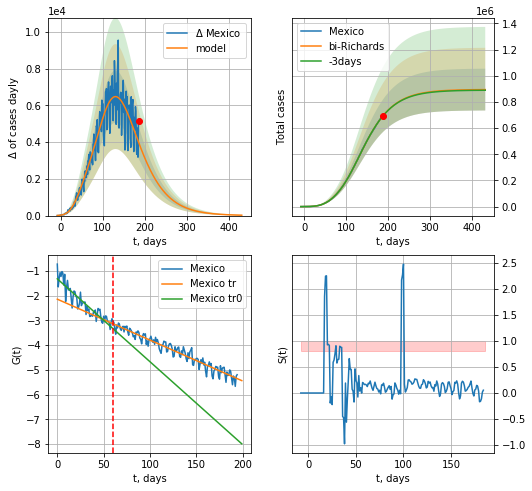

Mexico data at: 2020-09-19
+3 day model MAPE: 0.001499
model: bi-Richards
coeffs: [ 6.49098636e+05  1.03058101e+00 -2.99279575e+01  2.17613727e-02]
rational stdev: 0.178546
forecast at the end of period: +245 days
	 deltaDaycases: 21
	 total cases: 894339 ± 159680
	 total death: 94389 ± 50558
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.831337
 intercept: -1.317540
 slope: -0.033502
trend coefficient of determination: 0.929823
 intercept: -2.140196
 slope: -0.016536


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


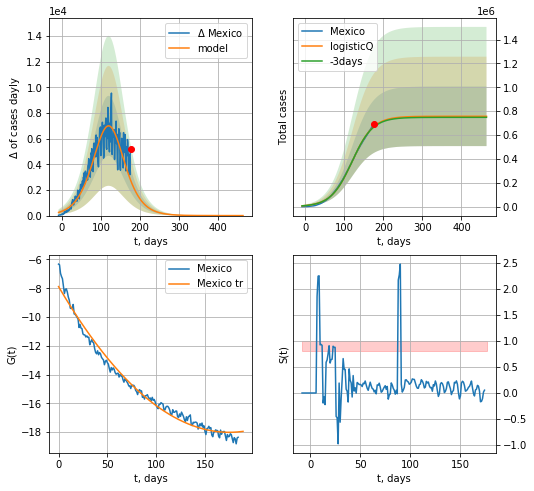

Mexico data at: 2020-09-19
+3 day model MAPE: 0.006487
model: logisticQ
coeffs: [ 7.57298652e+05  2.63288085e-07  1.20163241e+02 -1.40366498e+05]
rational stdev: 0.329815
forecast at the end of period: +287 days
	 deltaDaycases: 0
	 total cases: 757296 ± 249768
	 total death: 79925 ± 79081
trend coefficient of determination: 0.983276
 intercept_: -7.88347378551903
 coeffs_: [ 0.         -0.11578306  0.00033102]


In [2234]:
vL = 60
x = forecastRR('Mexico',dfMX[:vL],d1,50*7-dT,addpred=False,xcoef=RkoreaCoeffs)#
xx = forecast2RR('Mexico',dfMX[:],d1,60*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRRR('Mexico',dfMX[10:],d1,66*7-dT,addpred=False,xcoef=koreaCoeffs)#

LT
           date   cases  active  death     tests
190 2020-09-15  3442.0    1230   87.0  706219.0
191 2020-09-16  3504.0    1268   87.0  711108.0
192 2020-09-17  3565.0    1297   87.0  716972.0
193 2020-09-18  3664.0    1380   87.0  722897.0
194 2020-09-19  3744.0    1459   87.0  725127.0


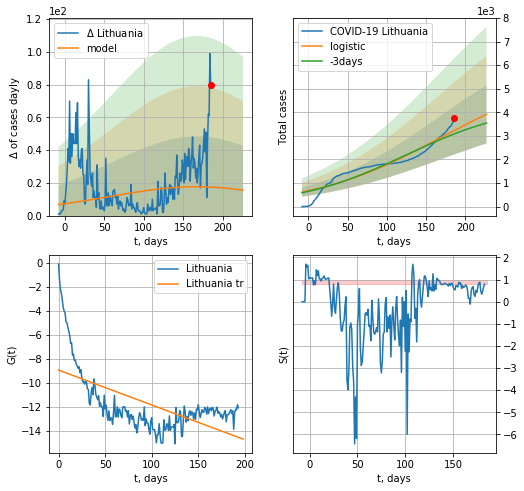

Lithuania data at: 2020-09-19
+3 day model MAPE: 0.049473643340600885
model: logistic
coeffs:  [5.81504055e+03 1.21298375e-02 1.67509951e+02]
rational stdev:  0.31571560860263914
forecast at the end of period: +41 days
	 deltaDaycases:  15
	 total cases:  3913 ± 1235
	 total death:  90 ± 85
trend coefficient of determination: 0.375889
 intercept: -8.934873
 slope: -0.029005


In [2236]:
vL = 1
dfLT = read_df(pd.DataFrame(),"LT")
try:
    x = forecast('Lithuania',dfLT[:],d1,6*7-1)
except:
    print("Exception occurs")
#xx = forecast2('Lithuania',dfLT[:],d1,8*7-1,x,shift=1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

In [2237]:
#dfLT = read_df(pd.DataFrame(),"LT")
#plt.plot(range(len(dfLT[3:])),dfLT[3:].cases/dfLT[3:].tests)

#plt.grid()#

In [2238]:
#np.diff(dfLT["cases"])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


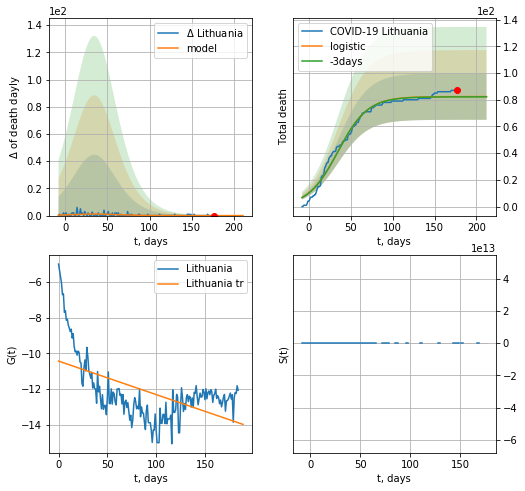

Lithuania data at: 2020-09-19
+3 day model MAPE: 0.0024296605055747884
model: logistic
coeffs:  [8.23601652e+01 5.62702615e-02 3.47945708e+01]
rational stdev:  0.21106227781651754
forecast at the end of period: +35 days
	 total death:  82 ± 17
trend coefficient of determination: 0.306329
 intercept: -10.437194
 slope: -0.018767


In [2239]:
x = forecast('Lithuania',dfLT[9:],d1,7*T18-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


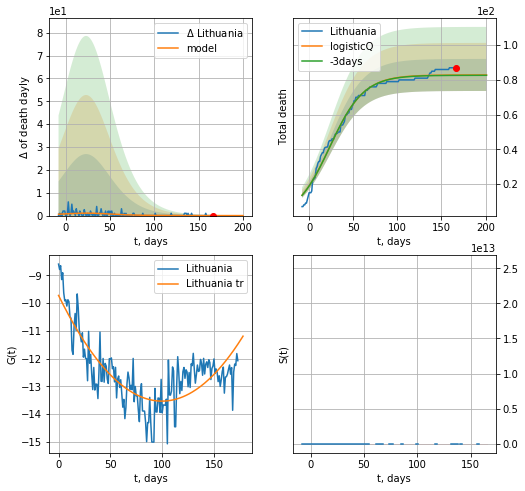

Lithuania data at: 2020-09-19
+3 day model MAPE: 0.002367
model: logisticQ
coeffs: [ 8.28570223e+01  1.36232705e-07  2.34849140e+01 -3.80102738e+05]
rational stdev: 0.111383
forecast at the end of period: +35 days
	 total death: 82 ± 9
trend coefficient of determination: 0.667340
 intercept_: -9.720363280403177
 coeffs_: [ 0.         -0.076418    0.00038294]


In [2240]:
#x = forecast('Lithuania',dfLT[10-4:],d1,6*7-1,cases='active')
#x = forecastRRR('Lithuania',dfLT[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Lithuania',dfLT[20:],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


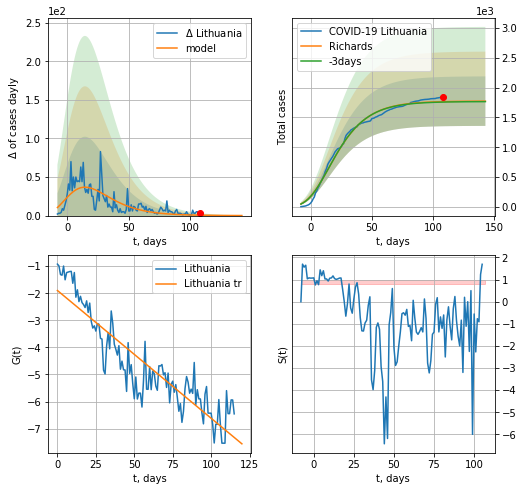

Lithuania data at: 2020-09-19
+3 day model MAPE: 0.004317
model: Richards
coeffs: [ 1.77501763e+03  1.31639926e+01 -8.14596876e+01  4.29803165e-03]
rational stdev: 0.234279
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 1773 ± 415
	 total death: 41 ± 28
trend coefficient of determination: 0.820394
 intercept: -1.897700
 slope: -0.047186


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


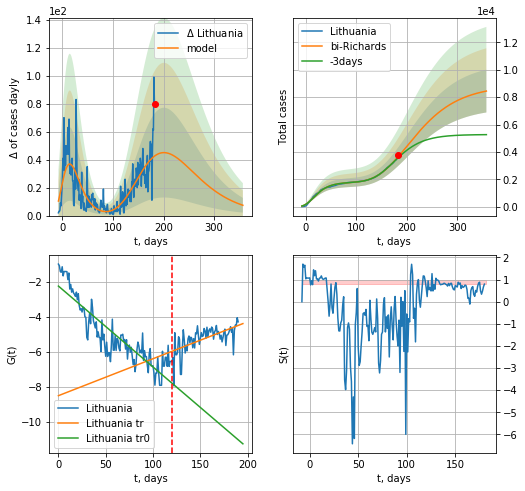

Lithuania data at: 2020-09-19
+3 day model MAPE: 0.022310
model: bi-Richards
coeffs: [7.09500081e+03 3.23803047e-01 3.71835407e+01 5.47124270e-02]
rational stdev: 0.185059
forecast at the end of period: +175 days
	 deltaDaycases: 7
	 total cases: 8443 ± 1562
	 total death: 196 ± 108
bi-Richards approximation splitting point: 120
trend coefficient of determination: 0.801660
 intercept: -2.257616
 slope: -0.046133
trend coefficient of determination: 0.382191
 intercept: -8.507848
 slope: 0.021081


In [2241]:
iL = 3
vL =120+iL
x = forecastRR('Lithuania',dfLT[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)#
xx = forecast2RR('Lithuania',dfLT[iL:],d1,50*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)#
#xx = forecast2R('Lithuania',dfLT[:],d1,2*7-1,x,shift=1.0,addpred=True,xcoef=[0.25,1.,1.5])

In [2242]:
#dfLT['cases'].values
#x = forecastRR('Lithuania',dfLT[130:],d1,30*7-dT,addpred=False)#

In [2243]:
#x = forecastQR('Lithuania',dfLT[:],d1,16*7-dT,addpred=False,xcoef=[0.35,.52,4.,1.,1.])

LX
           date   cases  active  death
192 2020-09-15  7284.0     599  124.0
193 2020-09-16  7394.0     677  124.0
194 2020-09-17  7541.0     776  124.0
195 2020-09-18  7718.0     891  124.0
196 2020-09-19  7804.0     977  124.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


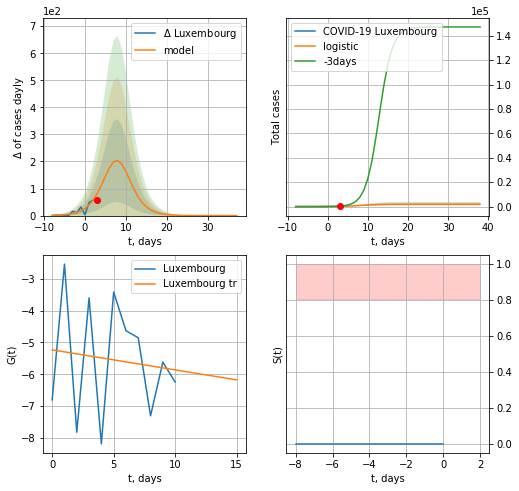

Luxembourg data at: 2020-09-19
model: logistic
coeffs:  [1.87757966e+03 4.36654344e-01 8.24919508e+00]
rational stdev:  0.35795936969501296
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  1877 ± 672
	 total death:  29 ± 31
trend coefficient of determination: 0.012091
 intercept: -5.231862
 slope: -0.063083


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


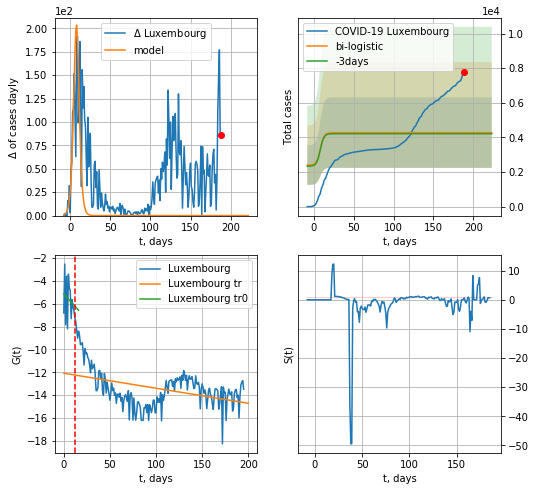

Luxembourg data at: 2020-09-19
+3 day model MAPE: 0.015181332033993885
model: bi-logistic
coeffs:  [2133.21384103  -12.37275482  326.30181817] [1.87757966e+03 4.36654344e-01 8.24919508e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.4759219566809611
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  4277 ± 2035
	 total death:  67 ± 95
bi-logistic approximation splitting point: 12
trend0 coefficient of determination: 0.030158
 intercept: -5.146907
 slope: -0.088569
trend coefficient of determination: 0.167313
 intercept: -12.079244
 slope: -0.013130


In [2244]:
try:
    dfLX = read_df(pd.DataFrame(),"LX")
    x = forecast("Luxembourg",dfLX[:12],d1,T18*7-dT,pMAPE=False)
    xx = forecast2("Luxembourg",dfLX[:],d1,T18*7-dT,x,vL=12,addpred=True,xcoef=[0.25/2,1.,2.])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


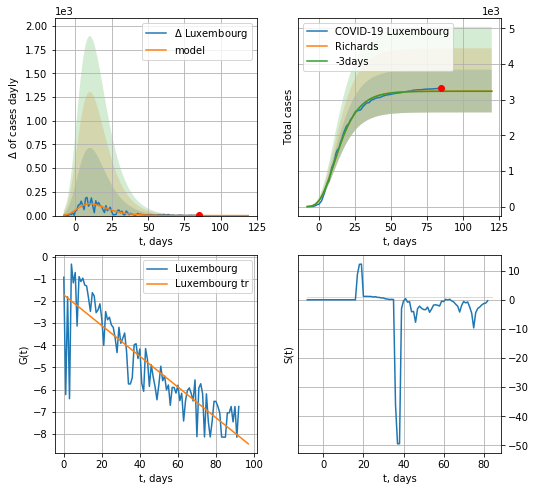

Luxembourg data at: 2020-09-19
+3 day model MAPE: 0.002007
model: Richards
coeffs: [ 3.24138545e+03  2.02715004e+01 -3.96622957e+01  5.18542030e-03]
rational stdev: 0.184858
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 3241 ± 599
	 total death: 51 ± 28
trend coefficient of determination: 0.764532
 intercept: -1.723997
 slope: -0.069294


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


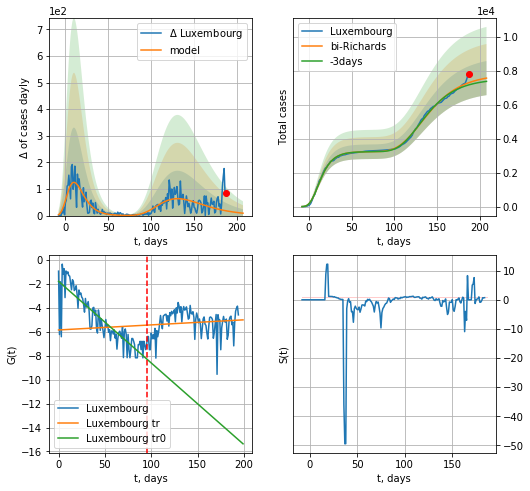

Luxembourg data at: 2020-09-19
+3 day model MAPE: 0.018281
model: bi-Richards
coeffs: [4.57650772e+03 4.16750181e+00 7.38930538e+00 9.11414331e-03]
rational stdev: 0.132746
forecast at the end of period: +21 days
	 deltaDaycases: 9
	 total cases: 7578 ± 1005
	 total death: 120 ± 47
bi-Richards approximation splitting point: 95
trend coefficient of determination: 0.767465
 intercept: -1.783609
 slope: -0.068214
trend coefficient of determination: 0.013562
 intercept: -5.847722
 slope: 0.004235


In [2245]:
iL=1
vL = 105+iL-10
x = forecastRR("Luxembourg",dfLX[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Luxembourg",dfLX[iL:],d1,28*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


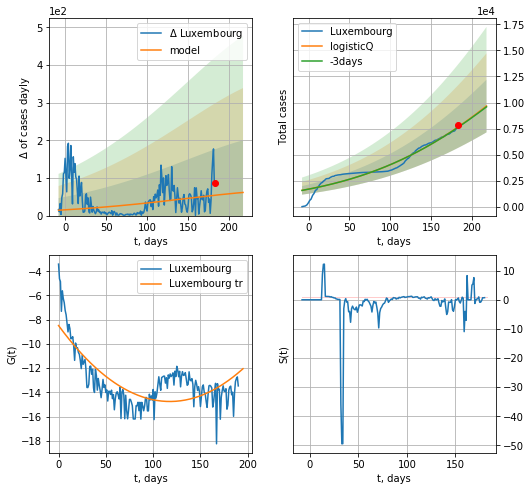

Luxembourg data at: 2020-09-19
+3 day model MAPE: 0.003948
model: logisticQ
coeffs: [ 2.75836180e+04  4.05962084e-07  2.80836773e+02 -2.39719901e+04]
rational stdev: 0.261905
forecast at the end of period: +35 days
	 deltaDaycases: 61
	 total cases: 9666 ± 2531
	 total death: 153 ± 120
trend coefficient of determination: 0.552493
 intercept_: -8.485177307826016
 coeffs_: [ 0.         -0.10661966  0.00045304]


In [2246]:
x = forecastRRR("Luxembourg",dfLX[5:],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)

In [2247]:
dfED = read_df(pd.DataFrame(),"ED")
#x = forecast("Ecuador",dfED[11:],d1,24*7-dT)
#xx = forecast2(c,adf[:],d1,4*7-dT,x)

ED
           date     cases   active    death
199 2020-09-15  119553.0  11527.0  10963.0
200 2020-09-16  121525.0  13466.0  10996.0
201 2020-09-17  122257.0  14165.0  11029.0
202 2020-09-18  124129.0  16022.0  11044.0
203 2020-09-19  125620.0  17473.0  11084.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


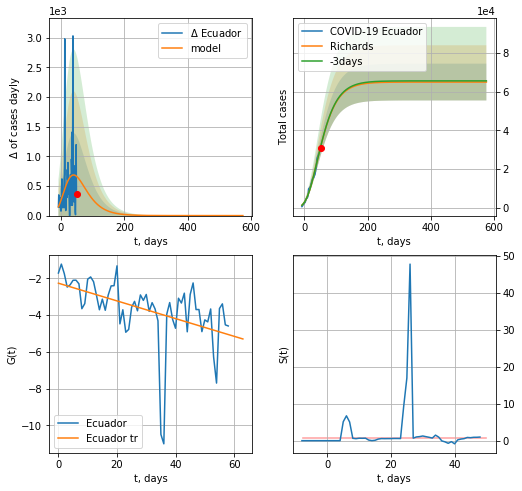

Ecuador data at: 2020-09-19
+3 day model MAPE: 0.001443
model: Richards
coeffs: [ 6.49031363e+04  1.85787235e+00 -1.03613231e+02  1.55703468e-02]
rational stdev: 0.146273
forecast at the end of period: +525 days
	 deltaDaycases: 0
	 total cases: 64903 ± 9493
	 total death: 5726 ± 2512
trend coefficient of determination: 0.218364
 intercept: -2.268609
 slope: -0.048096


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


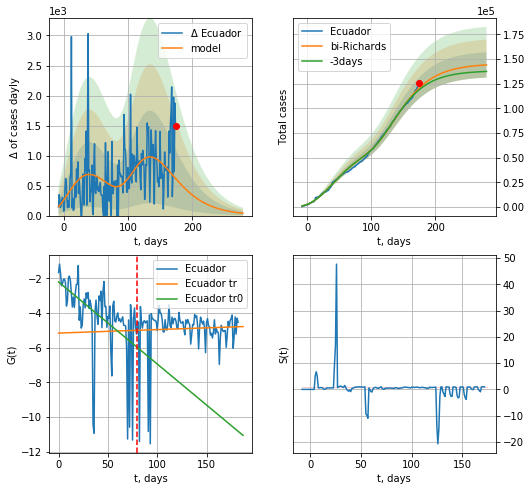

Ecuador data at: 2020-09-19
+3 day model MAPE: 0.015308
model: bi-Richards
coeffs: [ 8.05162633e+04  3.23194243e+00 -2.06700450e+01  9.12034482e-03]
rational stdev: 0.089037
forecast at the end of period: +105 days
	 deltaDaycases: 38
	 total cases: 144116 ± 12831
	 total death: 12715 ± 3396
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.273472
 intercept: -2.214212
 slope: -0.047286
trend coefficient of determination: 0.002351
 intercept: -5.161102
 slope: 0.002003


In [2248]:
vL = 80+20
x = forecastRR("Ecuador",dfED[20:vL-20],d1,100*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Ecuador",dfED[20:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

In [2249]:
#x = forecastRRR("Ecuador",dfED[:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

FI
           date   cases  active  death
203 2020-09-15  8725.0     886  339.0
204 2020-09-16  8750.0     711  339.0
205 2020-09-17  8799.0     760  339.0
206 2020-09-18  8858.0     819  339.0
207 2020-09-19  8980.0     941  339.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


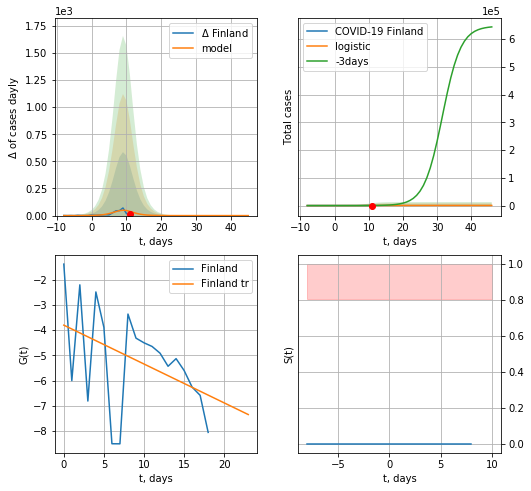

Finland data at: 2020-09-19
+3 day model MAPE: 0.3536795630191518
model: logistic
coeffs:  [373.20900186   0.53490302   9.59276199]
rational stdev:  11.028448708024662
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  373 ± 4115
	 total death:  14 ± 463
trend coefficient of determination: 0.182614
 intercept: -3.802910
 slope: -0.153962


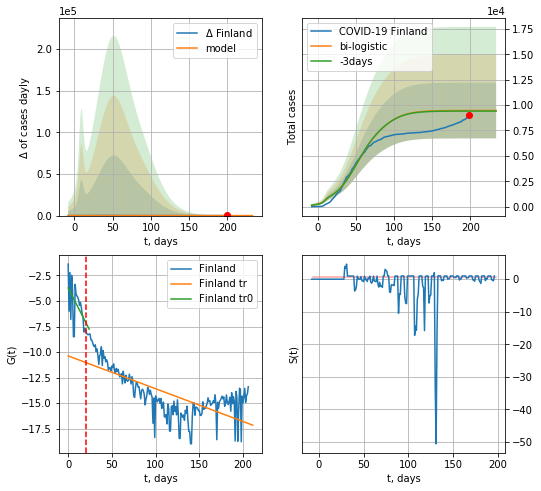

Finland data at: 2020-09-19
+3 day model MAPE: 0.005776350115846262
model: bi-logistic
coeffs:  [7.27469605e+03 6.74622651e-02 5.03681924e+01] [373.20900186   0.53490302   9.59276199]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.289915737703055
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  9466 ± 2744
	 total death:  357 ± 310
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.234981
 intercept: -3.717136
 slope: -0.168257
trend coefficient of determination: 0.519098
 intercept: -10.380817
 slope: -0.032134


In [2250]:
try:
    dfFI = read_df(pd.DataFrame(),"FI")
    vL=20
    x = forecast("Finland",dfFI[:vL],d1,7*T18-dT)
    xx = forecast2("Finland",dfFI[:],d1,T18*7-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


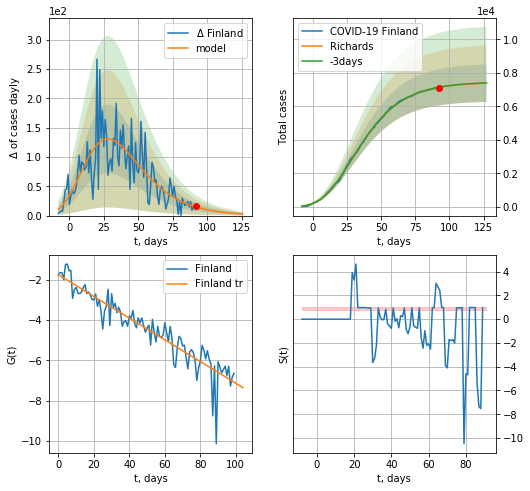

Finland data at: 2020-09-19
+3 day model MAPE: 0.001115
model: Richards
coeffs: [ 7.44184304e+03  7.14884094e-01 -2.55188087e+01  6.92679823e-02]
rational stdev: 0.151514
forecast at the end of period: +35 days
	 deltaDaycases: 2
	 total cases: 7385 ± 1119
	 total death: 278 ± 126
trend coefficient of determination: 0.862147
 intercept: -1.759889
 slope: -0.053817


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


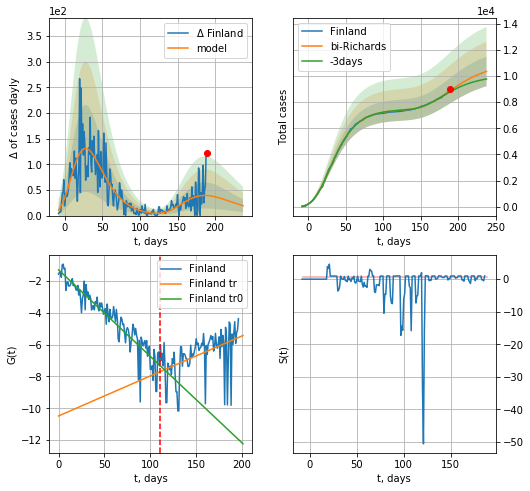

Finland data at: 2020-09-19
+3 day model MAPE: 0.009565
model: bi-Richards
coeffs: [3.63248487e+03 3.72715969e+00 2.26172464e+01 7.89852511e-03]
rational stdev: 0.109609
forecast at the end of period: +49 days
	 deltaDaycases: 19
	 total cases: 10347 ± 1134
	 total death: 390 ± 128
bi-Richards approximation splitting point: 111
trend coefficient of determination: 0.868511
 intercept: -1.302528
 slope: -0.054382
trend coefficient of determination: 0.214808
 intercept: -10.483213
 slope: 0.025141


In [2251]:
vL = 86 + 10 + 25
x = forecastRR("Finland",dfFI[10:vL-10],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Finland",dfFI[10:],d1,32*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10)

In [2252]:
#x = forecastRRR("Finland",dfFI[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

BL
           date  cases  active  death
189 2020-09-15  18216  4423.0  736.0
190 2020-09-16  18390  4410.0  739.0
191 2020-09-17  18544  4404.0  749.0
192 2020-09-18  18733  4470.0  753.0
193 2020-09-19  18819  4506.0  755.0


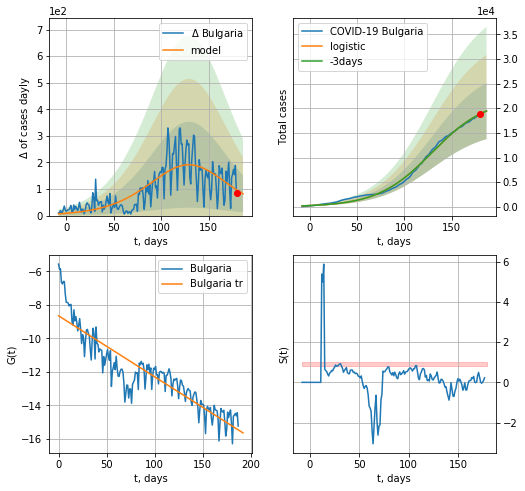

Bulgaria data at: 2020-09-19
+3 day model MAPE: 0.00018820259954873694
model: logistic
coeffs:  [2.20693399e+04 3.46782065e-02 1.29448070e+02]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  0.2927711507337375
forecast at the end of period: +7 days
	 deltaDaycases:  81
	 total cases:  19429 ± 5688
	 total death:  779 ± 684
trend coefficient of determination: 0.819505
 intercept: -8.646121
 slope: -0.036427


In [2253]:
dfBL = read_df(pd.DataFrame(),"BL").fillna(0)
try:
    x = forecast('Bulgaria',dfBL[5:],d1,26*7-dT,shift=1.0,addpred=True,xcoef=[0.25,1.,3.5])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


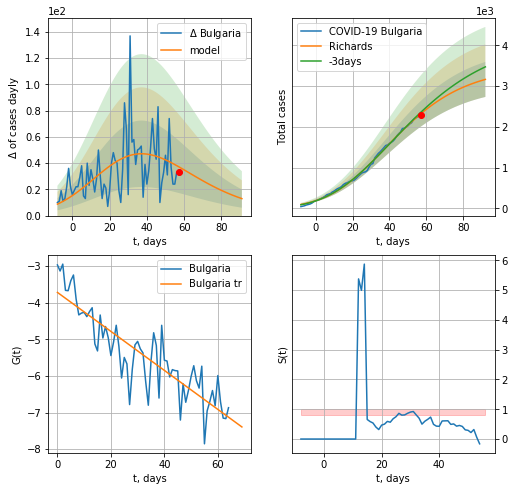

Bulgaria data at: 2020-09-19
+3 day model MAPE: 0.017233
model: Richards
coeffs: [3.47700846e+03 1.26494247e-01 1.24704401e+01 3.39632264e-01]
rational stdev: 0.135837
forecast at the end of period: +35 days
	 deltaDaycases: 12
	 total cases: 3161 ± 429
	 total death: 126 ± 51
trend coefficient of determination: 0.758376
 intercept: -3.716233
 slope: -0.053312


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


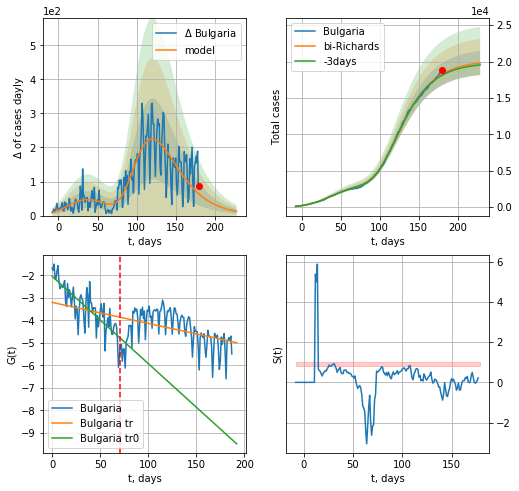

Bulgaria data at: 2020-09-19
+3 day model MAPE: 0.008088
model: bi-Richards
coeffs: [ 1.66593708e+04  3.53819479e+00 -5.18116307e+00  1.02368855e-02]
rational stdev: 0.083591
forecast at the end of period: +49 days
	 deltaDaycases: 12
	 total cases: 19801 ± 1655
	 total death: 794 ± 199
bi-Richards approximation splitting point: 71
trend coefficient of determination: 0.673319
 intercept: -2.039570
 slope: -0.038797
trend coefficient of determination: 0.168238
 intercept: -3.197759
 slope: -0.009338


In [2254]:
vL = 71+5
x = forecastRR('Bulgaria',dfBL[5:vL-5],d1,T18*7-dT,shift=1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bulgaria',dfBL[5:],d1,32*7-dT,x,shift=1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

In [2255]:
#x = forecastRRR('Bulgaria',dfBL[5:],d1,35*7-dT,shift=1.0,addpred=True,xcoef=koreaCoeffs)

TH
           date   cases  active  death
201 2020-09-15  3490.0   116.0   58.0
202 2020-09-16  3490.5   107.0   58.0
203 2020-09-17  3497.0   111.0   58.0
204 2020-09-18  3500.0   103.0   59.0
205 2020-09-19  3506.0   107.0   59.0


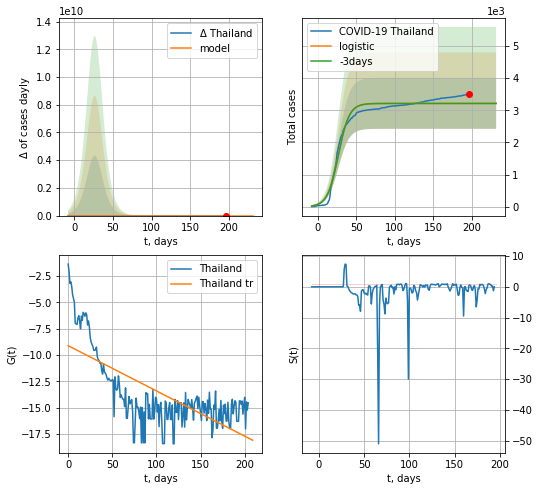

Thailand data at: 2020-09-19
+3 day model MAPE: 0.001967781798210995
model: logistic
coeffs:  [3.21748995e+03 1.40510677e-01 2.67803759e+01]
rational stdev:  0.24645441985738725
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  3217 ± 792
	 total death:  54 ± 39
trend coefficient of determination: 0.509544
 intercept: -9.117907
 slope: -0.042878


In [2256]:
dfTH = read_df(pd.DataFrame(),"TH")
dfTH = dfTH.fillna(0)
try:
    x = forecast("Thailand",dfTH[:],d1,T18*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])
except:
    print("Exception occurs")
#xx = forecast2("Thailand",dfTH[:],d1,8*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

In [2257]:
#x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


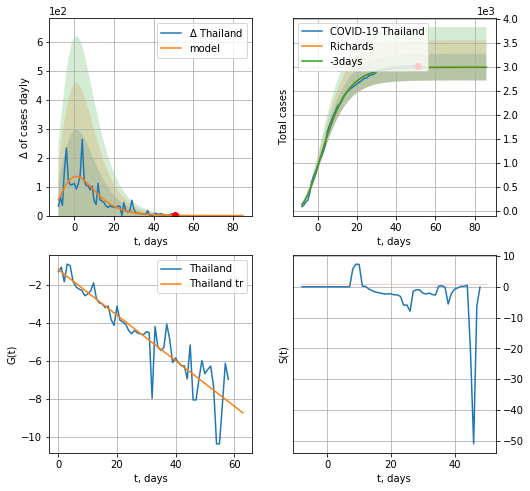

Thailand data at: 2020-09-19
+3 day model MAPE: 0.001958
model: Richards
coeffs: [ 2.99625224e+03  1.57427901e+01 -3.79340304e+01  7.81992540e-03]
rational stdev: 0.093292
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 2996 ± 279
	 total death: 50 ± 13
trend coefficient of determination: 0.845848
 intercept: -1.208254
 slope: -0.119672


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


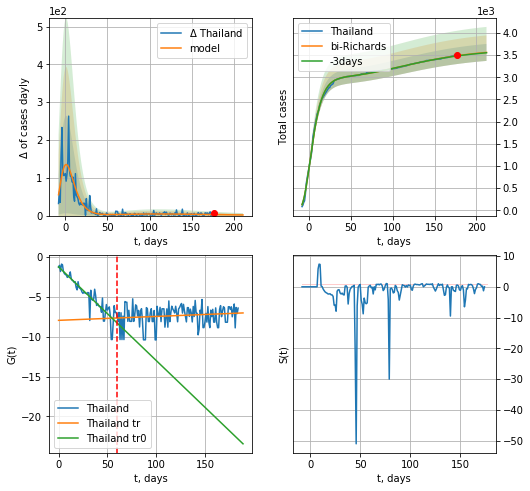

Thailand data at: 2020-09-19
+3 day model MAPE: 0.001242
model: bi-Richards
coeffs: [ 6.65315871e+02  2.97413005e+00 -1.79688902e+02  5.94158314e-03]
rational stdev: 0.053854
forecast at the end of period: +35 days
	 deltaDaycases: 1
	 total cases: 3559 ± 191
	 total death: 59 ± 9
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.843195
 intercept: -1.236591
 slope: -0.117501
trend coefficient of determination: 0.020675
 intercept: -7.954697
 slope: 0.004911


In [2258]:
vL = 80
x = forecastRR("Thailand",dfTH[20:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Thailand",dfTH[20:],d12f(1),30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

In [2259]:
#x = forecastRRR("Thailand",dfTH[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


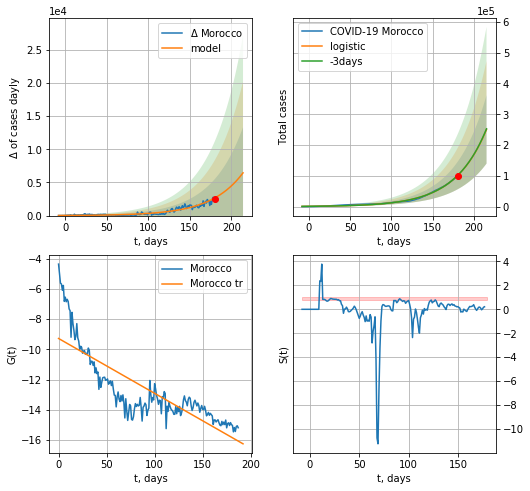

Morocco data at: 2020-09-19
+3 day model MAPE: 0.003729341858244203
model: logistic
coeffs:  [7.03767041e+07 2.61397055e-02 4.30512623e+02]
rational stdev:  0.4424923244817586
forecast at the end of period: +35 days
	 deltaDaycases:  6448
	 total cases:  250788 ± 110972
	 total death:  4509 ± 5985
trend coefficient of determination: 0.681167
 intercept: -9.276206
 slope: -0.036268


In [2260]:
x = forecast("Morocco",dfMR[5:],d1,T18*7-dT)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


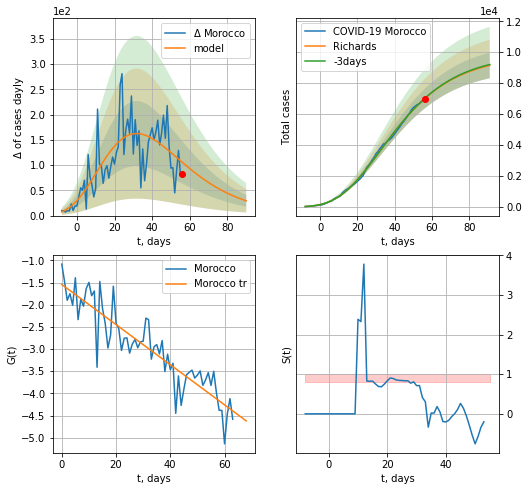

Morocco data at: 2020-09-19
+3 day model MAPE: 0.002854
model: Richards
coeffs: [ 9.80051535e+03  2.80051836e+00 -5.84633428e+01  1.62270604e-02]
rational stdev: 0.090760
forecast at the end of period: +35 days
	 deltaDaycases: 29
	 total cases: 9145 ± 830
	 total death: 164 ± 44
trend coefficient of determination: 0.815717
 intercept: -1.543258
 slope: -0.045268


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


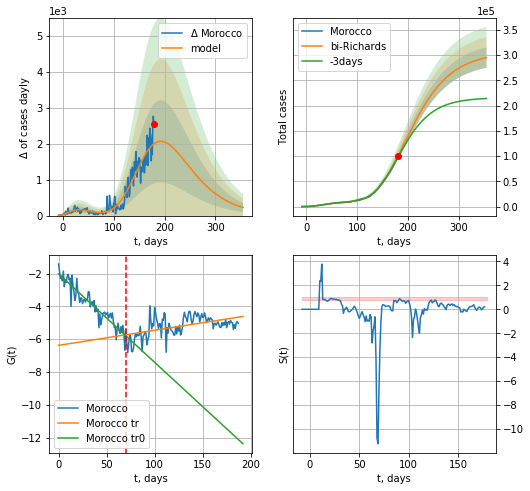

Morocco data at: 2020-09-19
+3 day model MAPE: 0.017693
model: bi-Richards
coeffs: [2.96468331e+05 1.69116964e-01 8.66387260e+01 1.18417112e-01]
rational stdev: 0.068544
forecast at the end of period: +175 days
	 deltaDaycases: 224
	 total cases: 294916 ± 20214
	 total death: 5303 ± 1090
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.878152
 intercept: -2.012847
 slope: -0.053967
trend coefficient of determination: 0.269874
 intercept: -6.373468
 slope: 0.009169


In [2261]:
vL = 75 
x = forecastRR("Morocco",dfMR[5:vL-5],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Morocco",dfMR[5:],d1,50*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

In [2263]:
#x = forecastRRR("Morocco",dfMR[5:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

In [2266]:
dfRM = read_df(pd.DataFrame(),"RM")
#x = forecast("Romania",dfRM[5:],d1,24*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

RM
           date     cases   active   death
202 2020-09-15  105298.0  57818.0  4236.0
203 2020-09-16  107011.0  59482.0  4285.0
204 2020-09-17  108690.0  61134.0  4312.0
205 2020-09-18  110217.0  17622.0  4360.0
206 2020-09-19  111550.0  18575.0  4435.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


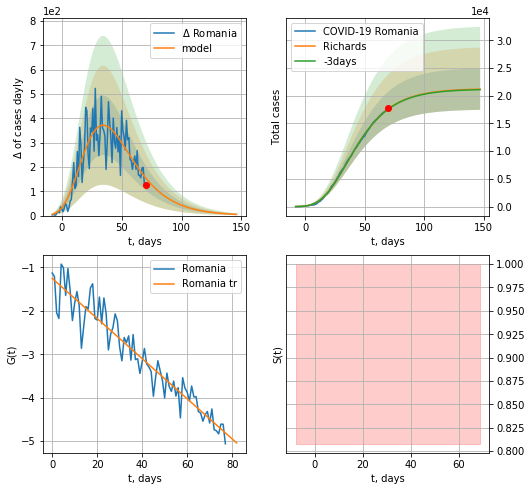

Romania data at: 2020-09-19
+3 day model MAPE: 0.002252
model: Richards
coeffs: [ 2.13019559e+04  3.77233819e+00 -5.65502366e+01  1.26521698e-02]
rational stdev: 0.176385
forecast at the end of period: +77 days
	 deltaDaycases: 4
	 total cases: 21200 ± 3739
	 total death: 833 ± 440
trend coefficient of determination: 0.908550
 intercept: -1.252366
 slope: -0.046196


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


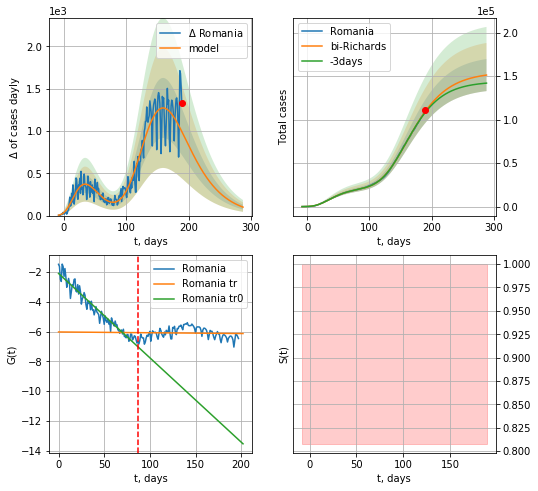

Romania data at: 2020-09-19
+3 day model MAPE: 0.011320
model: bi-Richards
coeffs: [1.33414960e+05 1.60108307e-01 9.79259098e+01 1.75634911e-01]
rational stdev: 0.122003
forecast at the end of period: +98 days
	 deltaDaycases: 100
	 total cases: 151149 ± 18440
	 total death: 5943 ± 2175
bi-Richards approximation splitting point: 87
trend coefficient of determination: 0.940720
 intercept: -2.102197
 slope: -0.056611
trend coefficient of determination: 0.002157
 intercept: -6.028894
 slope: -0.000520


In [2267]:
vL = 87+8
x = forecastRR("Romania",dfRM[8:vL-8],d1,36*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Romania",dfRM[8:],d1,39*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL = vL-8)

In [2268]:
#xx = forecastRRR("Romania",dfRM[8:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

In [2269]:
#x = forecastRRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/4,.5,2.2,1])

EU
           date    cases  active     death
220 2020-09-15  2288484  548728  142910.0
221 2020-09-16  2324065  567768  143316.0
222 2020-09-17  2363997  588920  143649.0
223 2020-09-18  2430013  566394  144041.0
224 2020-09-19  2459883  582844  144220.0


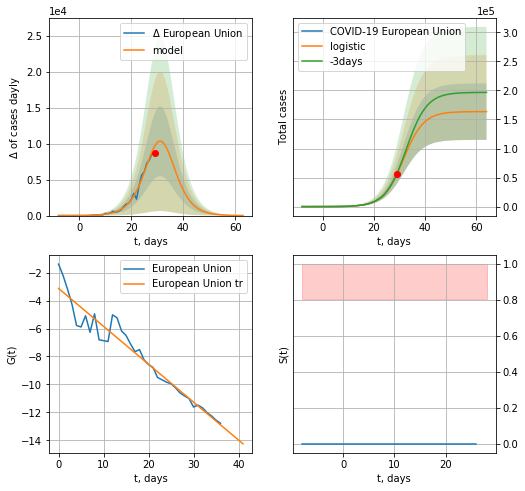

European Union data at: 2020-09-19
+3 day model MAPE: 0.026430260679971996
model: logistic
coeffs:  [1.63557146e+05 2.54069754e-01 3.15927312e+01]
rational stdev:  0.29731227366451135
forecast at the end of period: +35 days
	 deltaDaycases:  12
	 total cases:  163513 ± 48614
	 total death:  9586 ± 8550
trend coefficient of determination: 0.939076
 intercept: -3.128192
 slope: -0.271364


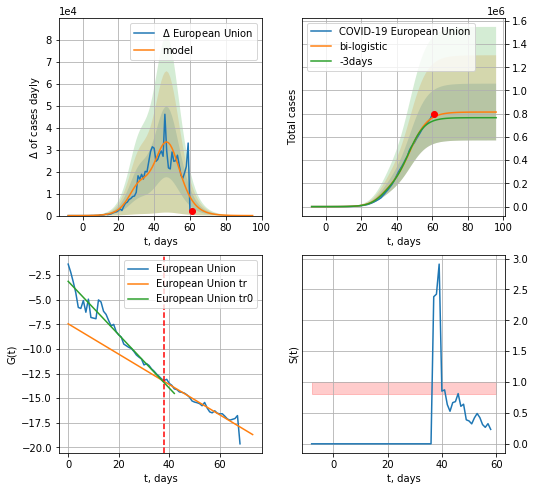

European Union data at: 2020-09-19
+3 day model MAPE: 0.04651915802684479
model: bi-logistic
coeffs:  [6.50647976e+05 2.01824362e-01 4.76677897e+01] [1.63557146e+05 2.54069754e-01 3.15927312e+01]
rational stdev:  0.30016662391822424
forecast at the end of period: +35 days
	 deltaDaycases:  8
	 total cases:  814167 ± 244385
	 total death:  47733 ± 42983
bi-logistic approximation splitting point: 38
trend0 coefficient of determination: 0.943288
 intercept: -3.133643
 slope: -0.270910
trend coefficient of determination: 0.919558
 intercept: -7.446330
 slope: -0.154010


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


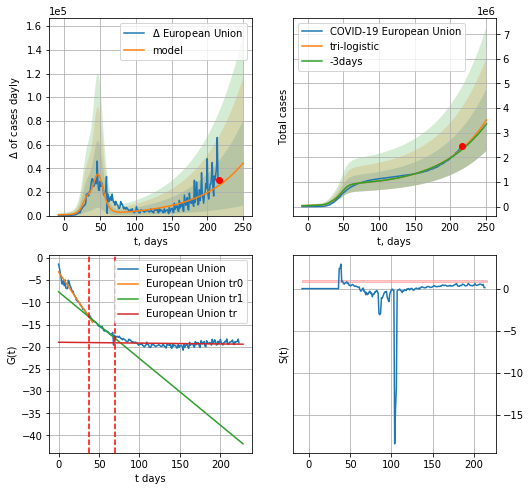

European Union data at: 2020-09-19
+3 day model MAPE: 0.016054802821951174
model: tri-logistic
coeffs:  [8.19704152e+08 1.65209519e-02 5.96517840e+02] [1.63557146e+05 2.54069754e-01 3.15927312e+01 6.50647976e+05
 2.01824362e-01 4.76677897e+01]
forecast rational stdev:  0.3567123938115329
forecast at the end of period: +35 days
	 deltaDaycases:  44277
	 total cases:  3525284 ± 1257512
	 total death:  206683 ± 221179
tri-logistic approximation splitting points: 38,70
trend0 coefficient of determination: 0.943288
 intercept: -3.133643
 slope: -0.270910
trend1 coefficient of determination: 0.917496
 intercept: -7.627918
 slope: -0.150227
trend coefficient of determination: 0.018337
 intercept: -18.991477
 slope: -0.001925


In [2270]:
vL=38
vL1=70
dfEU = read_df(pd.DataFrame(),"EU")
x = forecast("European Union",dfEU[:vL],d1,T18*7-dT)
xx = forecast2("European Union",dfEU[:vL1],d1,T18*7-dT,x,vL=38,addpred=False,xcoef=[0.25,1.,1.5])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("European Union",dfEU,d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


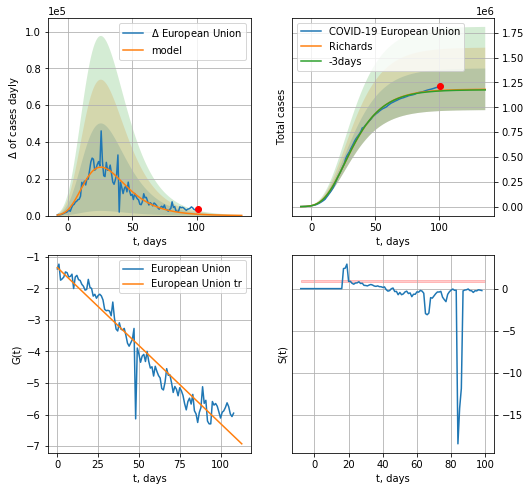

European Union data at: 2020-09-19
+3 day model MAPE: 0.004510
model: Richards
coeffs: [ 1.18204696e+06  8.96706485e+00 -5.59023207e+01  6.77910245e-03]
rational stdev: 0.177380
forecast at the end of period: +35 days
	 deltaDaycases: 93
	 total cases: 1180550 ± 209406
	 total death: 69214 ± 36831
trend coefficient of determination: 0.933679
 intercept: -1.341249
 slope: -0.049432


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


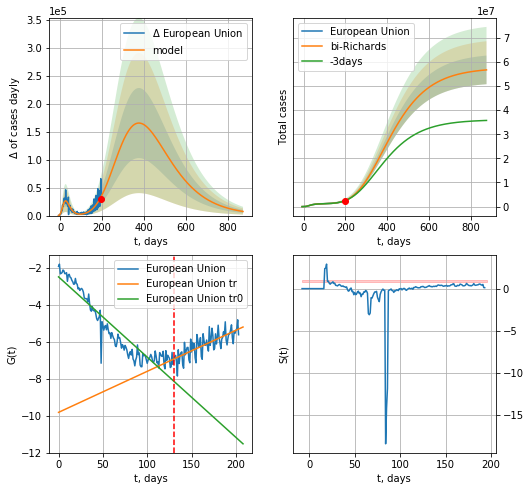

European Union data at: 2020-09-19
+3 day model MAPE: 0.009483
model: bi-Richards
coeffs: [5.63721396e+07 1.00653861e-01 7.63572517e+01 8.25341840e-02]
rational stdev: 0.104776
forecast at the end of period: +679 days
	 deltaDaycases: 7358
	 total cases: 56664348 ± 5937050
	 total death: 3322163 ± 1044246
bi-Richards approximation splitting point: 130
trend coefficient of determination: 0.880036
 intercept: -2.498772
 slope: -0.043366
trend coefficient of determination: 0.566887
 intercept: -9.819086
 slope: 0.022169


In [2271]:
vL = 130+20#83+20+17
x = forecastRR("European Union",dfEU[20:vL-20],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("European Union",dfEU[20:],d1,122*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

In [1885]:
#x = forecastRRR("European Union",dfEU[16:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

In [1886]:
#x = forecastQR("European Union",dfEU[20:],d1,16*7-dT,addpred=True,xcoef=QRkoreaCoeffs)

In [1887]:
#x = forecastRR("Romania",dfRM[5:],d1,14*7-dT)

In [1888]:
#x = forecastRRR("European Union",dfEU[:],d1,8*7-dT)

In [1889]:
#x = forecastRRR("Romania",dfRM[5:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

In [1890]:
#dfIC[:]

IC
           date   cases  active  death
198 2020-09-15  2174.0      62   10.0
199 2020-09-16  2189.0      75   10.0
200 2020-09-17  2206.0      84   10.0
201 2020-09-18  2230.0     108   10.0
202 2020-09-19  2307.0     181   10.0


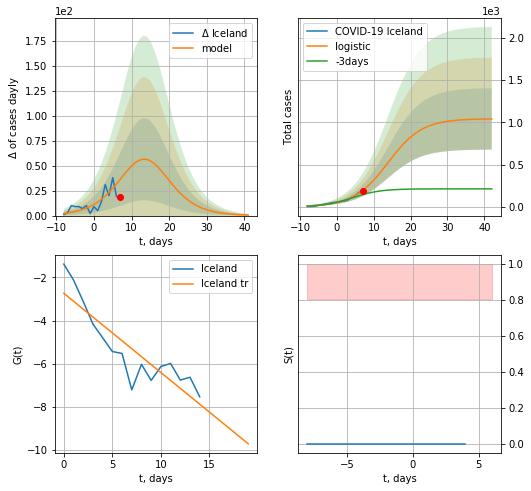

Iceland data at: 2020-09-19
+3 day model MAPE: 0.4751648041928849
model: logistic
coeffs:  [1.04285054e+03 2.17199299e-01 1.38649769e+01]
rational stdev:  0.34947878303574653
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  1040 ± 363
	 total death:  4 ± 4
trend coefficient of determination: 0.782203
 intercept: -2.736046
 slope: -0.366728


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


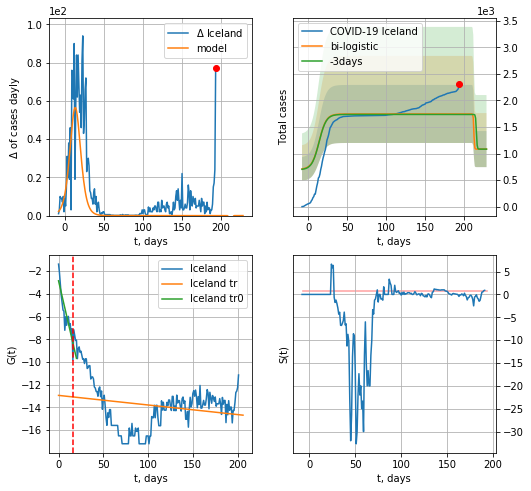

Iceland data at: 2020-09-19
+3 day model MAPE: 0.004979957911856095
model: bi-logistic
coeffs:  [661.9101079   -2.65759894 212.77405507] [1.04285054e+03 2.17199299e-01 1.38649769e+01]
scenario coeffs:  [0.0625, 1.0, 2]
rational stdev:  0.31299387589371225
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  1084 ± 339
	 total death:  4 ± 3
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.774693
 intercept: -2.854940
 slope: -0.341251
trend coefficient of determination: 0.043431
 intercept: -12.937999
 slope: -0.008444


In [2272]:
dfIC = read_df(pd.DataFrame(),"IC")
vL=16
try:
    x = forecast("Iceland",dfIC[:vL],d1,T18*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
    xx = forecast2("Iceland",dfIC[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25/4,1.,2],vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


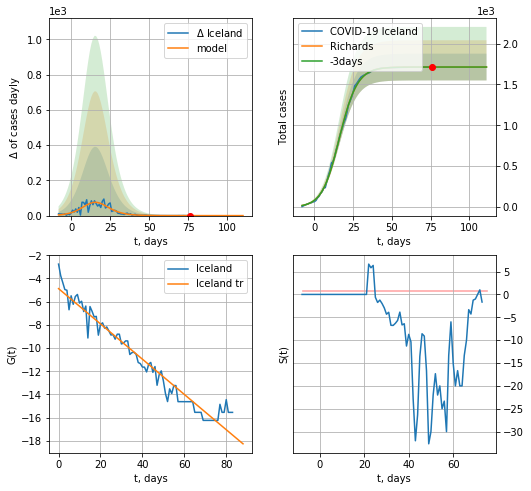

Iceland data at: 2020-09-19
+3 day model MAPE: 0.000010
model: Richards
coeffs: [1.71330052e+03 1.94502632e-01 1.51528095e+01 8.70905557e-01]
rational stdev: 0.095562
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 1713 ± 163
	 total death: 7 ± 2
trend coefficient of determination: 0.952024
 intercept: -4.875300
 slope: -0.151986


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


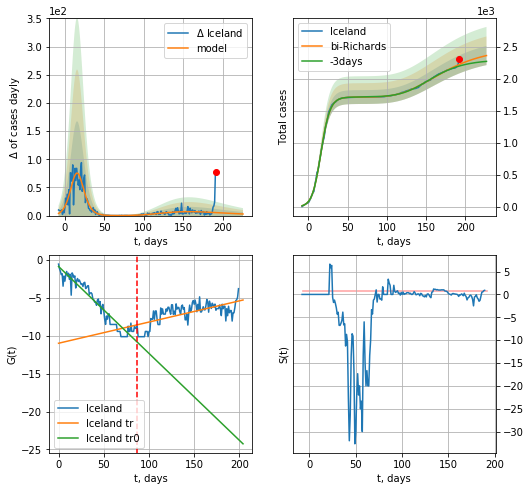

Iceland data at: 2020-09-19
+3 day model MAPE: 0.011829
model: bi-Richards
coeffs: [7.68618783e+02 5.18863256e-01 3.87463030e+01 4.88672146e-02]
rational stdev: 0.063109
forecast at the end of period: +35 days
	 deltaDaycases: 2
	 total cases: 2360 ± 148
	 total death: 10 ± 1
bi-Richards approximation splitting point: 87
trend coefficient of determination: 0.918985
 intercept: -0.848463
 slope: -0.114720
trend coefficient of determination: 0.447785
 intercept: -10.980761
 slope: 0.027971


In [2274]:
vL = 87+2
x = forecastRR("Iceland",dfIC[2:vL-2],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iceland",dfIC[2:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-2)
#x = forecastRRR("Iceland",dfIC[:20],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])

In [2275]:
#x = forecastRRR("Iceland",dfIC[5:],d1,T18*7-dT,addpred=False,xcoef=[0.35/6,.5,4.,1.])

PM
           date   cases   active   death
189 2020-09-15  102832  25053.0  2187.0
190 2020-09-16  103466  24481.0  2198.0
191 2020-09-17  104138  24044.0  2213.0
192 2020-09-18  104879  23557.0  2229.0
193 2020-09-19  105601  23164.0  2247.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


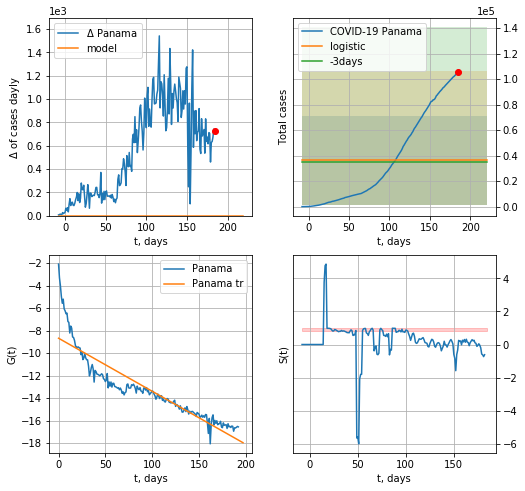

Panama data at: 2020-09-19
+3 day model MAPE: 0.030693203777353906
model: logistic
coeffs:  [ 3.62136701e+04 -3.07296870e+01  7.52618061e+02]
rational stdev:  0.9639117928924374
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  36213 ± 34906
	 total death:  770 ± 2226
trend coefficient of determination: 0.821417
 intercept: -8.681443
 slope: -0.047100


In [2276]:
dfPM = read_df(pd.DataFrame(),"PM").fillna(0)
x = forecast("Panama",dfPM[:],d1,T18*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


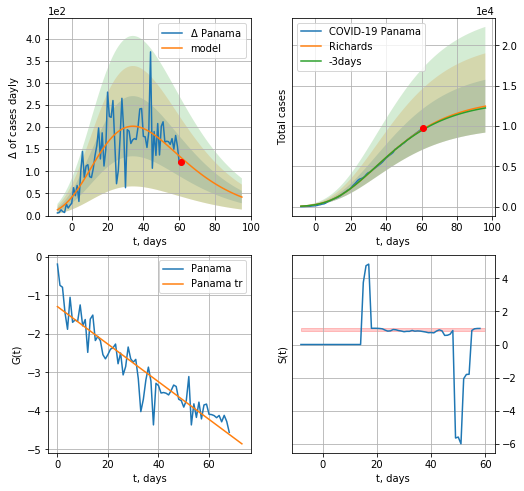

Panama data at: 2020-09-19
+3 day model MAPE: 0.008202
model: Richards
coeffs: [ 1.34884806e+04  2.34095265e+00 -6.38236986e+01  1.75426471e-02]
rational stdev: 0.263123
forecast at the end of period: +35 days
	 deltaDaycases: 41
	 total cases: 12446 ± 3275
	 total death: 264 ± 208
trend coefficient of determination: 0.871686
 intercept: -1.291509
 slope: -0.048815


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


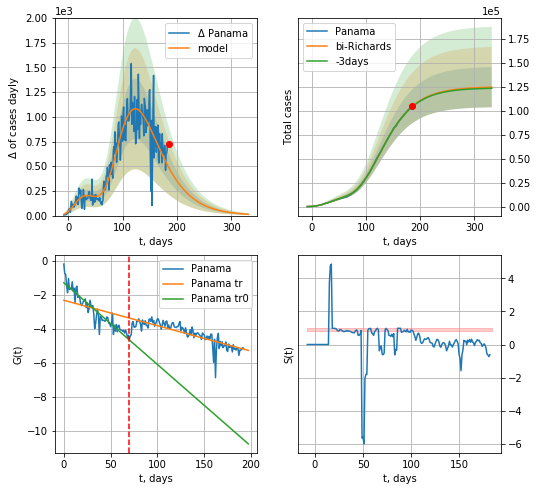

Panama data at: 2020-09-19
+3 day model MAPE: 0.003007
model: bi-Richards
coeffs: [ 1.11812005e+05  2.14264084e+00 -4.39820485e+01  1.21975099e-02]
rational stdev: 0.168217
forecast at the end of period: +147 days
	 deltaDaycases: 13
	 total cases: 124806 ± 20994
	 total death: 2655 ± 1339
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.873816
 intercept: -1.272739
 slope: -0.048092
trend coefficient of determination: 0.673443
 intercept: -2.303507
 slope: -0.014969


In [2277]:
vL = 70
x = forecastRR("Panama",dfPM[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Panama",dfPM[:],d1,46*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [2278]:
#x = forecastRRR("Panama",dfPM[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


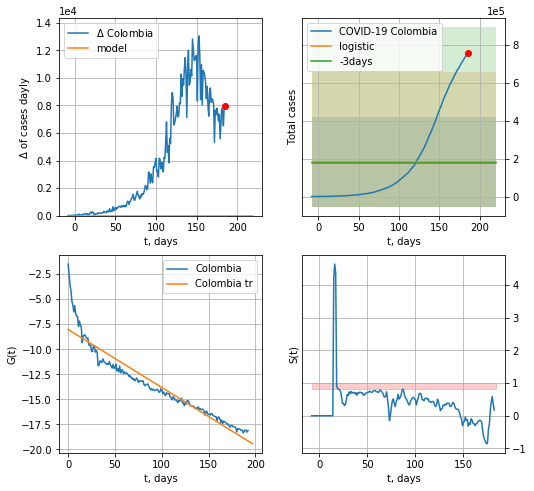

Colombia data at: 2020-09-19
+3 day model MAPE: 0.051016030075013194
model: logistic
coeffs:  [ 1.83587161e+05 -1.38046557e+01  3.37431220e+02]
rational stdev:  1.2898883071442915
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  183587 ± 236806
	 total death:  5819 ± 22517
trend coefficient of determination: 0.898558
 intercept: -8.026900
 slope: -0.057911


In [2279]:
dfCB = dfCB.fillna(0)
x = forecast("Colombia",dfCB[:],d1,T18*7-dT)

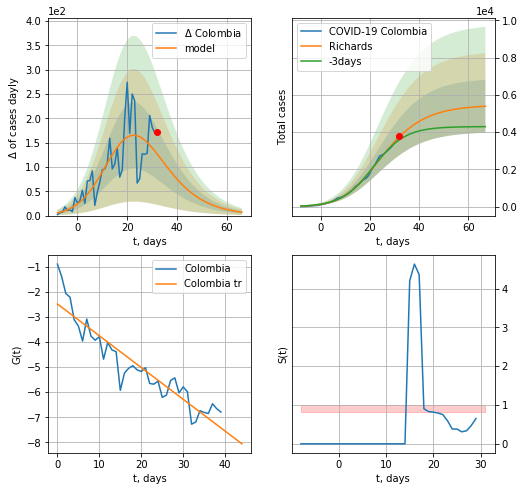

Colombia data at: 2020-09-19
+3 day model MAPE: 0.053959
model: Richards
coeffs: [5.45324012e+03 2.23852503e-01 1.50938863e+01 4.47627095e-01]
rational stdev: 0.263661
forecast at the end of period: +35 days
	 deltaDaycases: 6
	 total cases: 5386 ± 1420
	 total death: 170 ± 134
trend coefficient of determination: 0.864435
 intercept: -2.485430
 slope: -0.126591


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


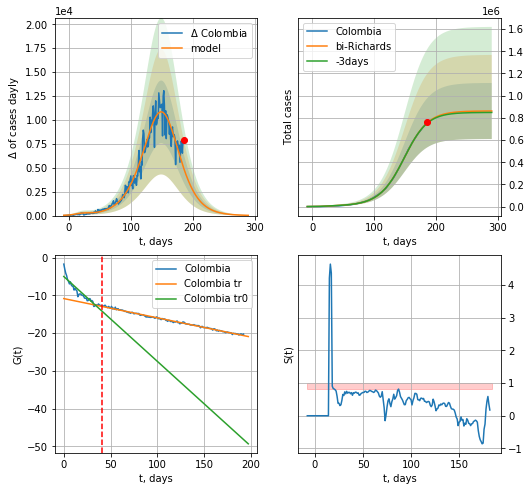

Colombia data at: 2020-09-19
+3 day model MAPE: 0.004980
model: bi-Richards
coeffs: [8.56759882e+05 4.58472520e-02 1.52037117e+02 1.15781589e+00]
rational stdev: 0.293195
forecast at the end of period: +105 days
	 deltaDaycases: 26
	 total cases: 861725 ± 252653
	 total death: 27314 ± 24025
bi-Richards approximation splitting point: 41
trend coefficient of determination: 0.885905
 intercept: -4.965979
 slope: -0.225259
trend coefficient of determination: 0.993618
 intercept: -10.819597
 slope: -0.051117


In [2280]:
vL = 41
x = forecastRR("Colombia",dfCB[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Colombia",dfCB[:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [2281]:
#x = forecastRRR("Colombia",dfCB[:],d1,84*7-dT,addpred=True,xcoef=koreaCoeffs)

AR
           date    cases   active   death
195 2020-09-15  48734.0  12717.0  1632.0
196 2020-09-16  48966.0  12804.0  1645.0
197 2020-09-17  49194.0  12865.0  1654.0
198 2020-09-18  49413.0  12936.0  1659.0
199 2020-09-19  49623.0  13035.0  1665.0


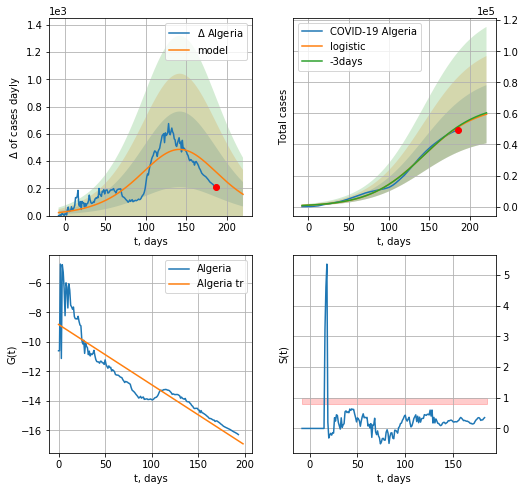

Algeria data at: 2020-09-19
+3 day model MAPE: 0.008548417467043315
model: logistic
coeffs:  [6.51279928e+04 2.98259300e-02 1.42214012e+02]
rational stdev:  0.31501662725586166
forecast at the end of period: +35 days
	 deltaDaycases:  156
	 total cases:  59456 ± 18729
	 total death:  1994 ± 1884
trend coefficient of determination: 0.829992
 intercept: -8.817619
 slope: -0.040838


In [2282]:
dfAR = read_df(pd.DataFrame(),"AR")
dfAR = dfAR.fillna(0)
x = forecast("Algeria",dfAR[5:],d1,T18*7-dT)
#dfAG

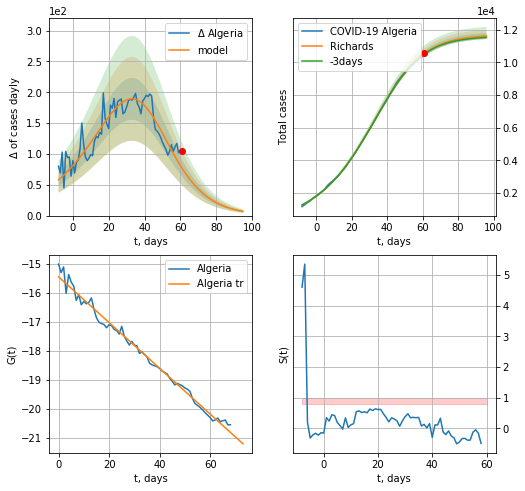

Algeria data at: 2020-09-19
+3 day model MAPE: 0.002873
model: Richards
coeffs: [1.17018124e+04 4.57679581e-02 4.02904334e+01 1.72065937e+00]
rational stdev: 0.015955
forecast at the end of period: +35 days
	 deltaDaycases: 6
	 total cases: 11618 ± 185
	 total death: 389 ± 18
trend coefficient of determination: 0.988499
 intercept: -15.458346
 slope: -0.078873


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


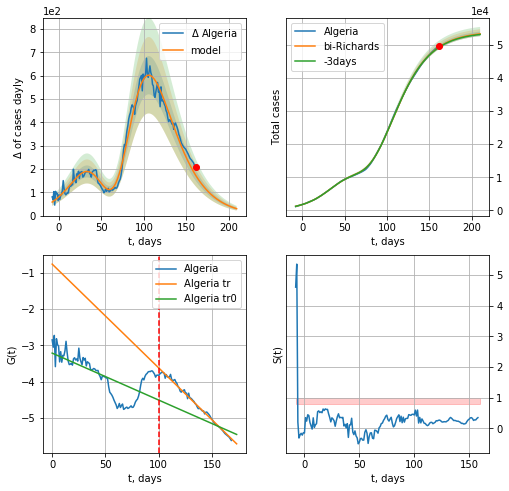

Algeria data at: 2020-09-19
+3 day model MAPE: 0.002216
model: bi-Richards
coeffs: [ 4.23176581e+04  2.75993317e+00 -3.71269138e+00  1.40418425e-02]
rational stdev: 0.013090
forecast at the end of period: +49 days
	 deltaDaycases: 29
	 total cases: 53264 ± 697
	 total death: 1787 ± 70
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.466184
 intercept: -3.214790
 slope: -0.012931
trend coefficient of determination: 0.990964
 intercept: -0.766492
 slope: -0.028574


In [2283]:
iL = 30
vL = 100+iL
x = forecastRR("Algeria",dfAR[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Algeria",dfAR[iL:],d1,32*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [2284]:
#x = forecastRRR("Algeria",dfAR[10:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

IE
           date   cases   active   death
190 2020-09-15  225030  55000.0  8965.0
191 2020-09-16  228993  55792.0  9100.0
192 2020-09-17  232628  56720.0  9222.0
193 2020-09-18  240687  56889.0  9448.0
194 2020-09-19  244676  57796.0  9553.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


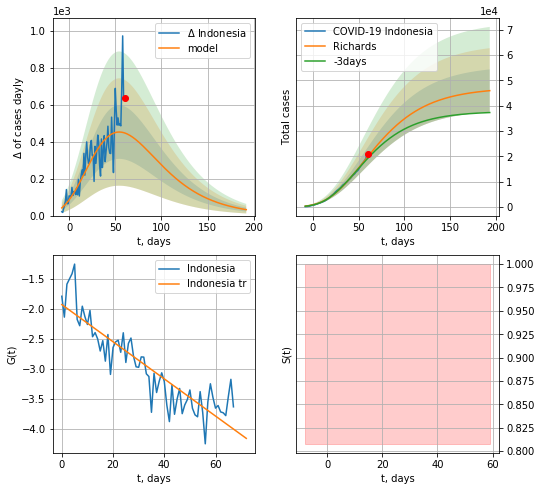

Indonesia data at: 2020-09-19
+3 day model MAPE: 0.038052
model: Richards
coeffs: [ 4.71241400e+04  1.80052285e+00 -1.05975004e+02  1.46057737e-02]
rational stdev: 0.182929
forecast at the end of period: +133 days
	 deltaDaycases: 32
	 total cases: 45898 ± 8396
	 total death: 1792 ± 983
trend coefficient of determination: 0.798542
 intercept: -1.926266
 slope: -0.031064


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


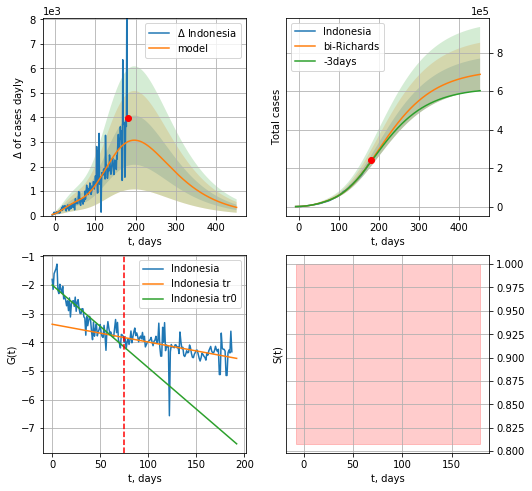

Indonesia data at: 2020-09-19
+3 day model MAPE: 0.014609
model: bi-Richards
coeffs: [ 6.67313362e+05  7.23947583e-01 -1.25300163e+02  1.72910404e-02]
rational stdev: 0.119557
forecast at the end of period: +273 days
	 deltaDaycases: 334
	 total cases: 687303 ± 82172
	 total death: 26834 ± 9624
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.798501
 intercept: -1.996842
 slope: -0.028909
trend coefficient of determination: 0.249709
 intercept: -3.368096
 slope: -0.006213


In [2285]:
dfIE = read_df(pd.DataFrame(),"IE")
try:
    #x = forecast("Indonesia",dfIE[5:],d1,T18*7-dT)
    vL = 75+6
    x = forecastRR("Indonesia",dfIE[6:vL-6],d1,44*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Indonesia",dfIE[6:],d12f(1),64*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-6)
except:
    print ("Exception occurs")

In [2286]:
#x = forecastRRR("Indonesia",dfIE[13:],d1,46*7-dT,addpred=True,xcoef=koreaCoeffs)

PH
           date   cases   active   death
192 2020-09-15  272934  60344.0  4732.0
193 2020-09-16  276289  63408.0  4785.0
194 2020-09-17  279851  63408.0  4785.0
195 2020-09-18  283460  68645.0  4930.0
196 2020-09-19  286743  51894.0  4984.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


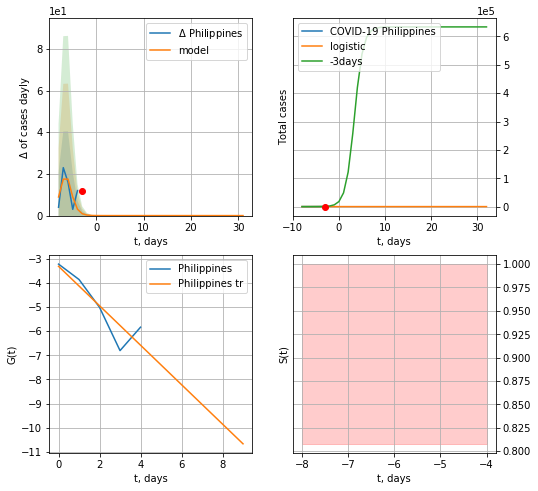

Philippines data at: 2020-09-19
+3 day model MAPE: 0.9724006926427327
model: logistic
coeffs:  [61.5169203   1.2919553  -5.99802409]
rational stdev:  0.193485507182797
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  61 ± 11
	 total death:  1 ± 0
trend coefficient of determination: 0.794507
 intercept: -3.309972
 slope: -0.817432


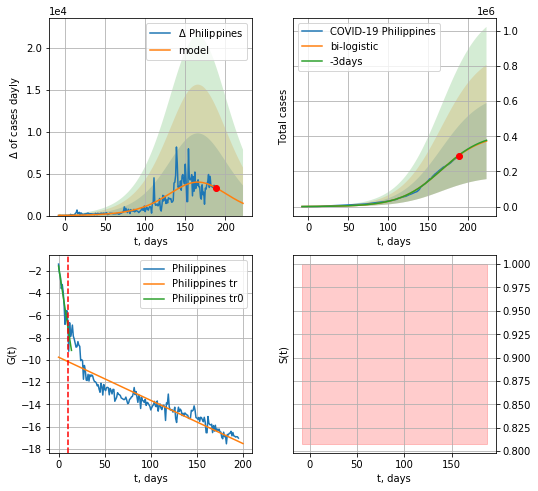

Philippines data at: 2020-09-19
+3 day model MAPE: 0.005265881007535568
model: bi-logistic
coeffs:  [4.13966078e+05 3.85708740e-02 1.66121568e+02] [61.5169203   1.2919553  -5.99802409]
rational stdev:  0.5807234838063245
forecast at the end of period: +35 days
	 deltaDaycases:  1463
	 total cases:  372505 ± 216322
	 total death:  6474 ± 11278
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend coefficient of determination: 0.841307
 intercept: -9.758055
 slope: -0.038850


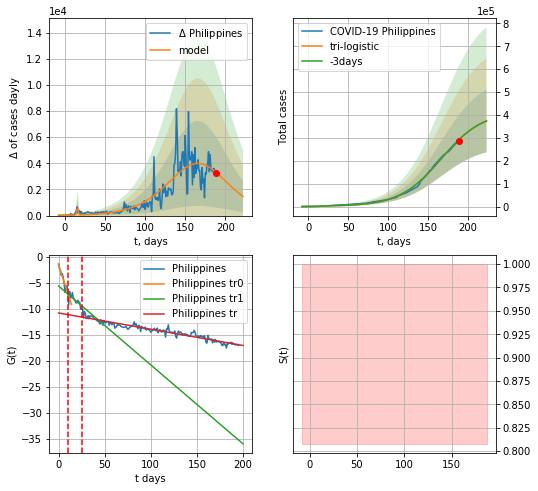

Philippines data at: 2020-09-19
+3 day model MAPE: 0.00025397056914303637
model: tri-logistic
coeffs:  [1366.96052584    1.63309464   16.15255548] [ 6.15169203e+01  1.29195530e+00 -5.99802409e+00  4.13966078e+05
  3.85708740e-02  1.66121568e+02]
forecast rational stdev:  0.36617783378888685
forecast at the end of period: +35 days
	 deltaDaycases:  1463
	 total cases:  373872 ± 136903
	 total death:  6498 ± 7138
tri-logistic approximation splitting points: 10,25
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend1 coefficient of determination: 0.474240
 intercept: -5.600607
 slope: -0.151865
trend coefficient of determination: 0.917849
 intercept: -10.786108
 slope: -0.031287


In [2287]:
vL=10
vL1=25
try:
    dfPH = read_df(pd.DataFrame(),"PH")
    x = forecast("Philippines",dfPH[4:vL],d1,T18*7-dT,addpred=False,xcoef=[0.25,1.,2.3])
    xx = forecast2("Philippines",dfPH[:],d1,T18*7-dT,x,vL=vL,addpred=False,xcoef=[0.25,1.,1.8])
    xx = np.concatenate((x, xx), axis=0)
    xxx = forecast3("Philippines",dfPH,d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])
except:
    print ("Exception occurs")

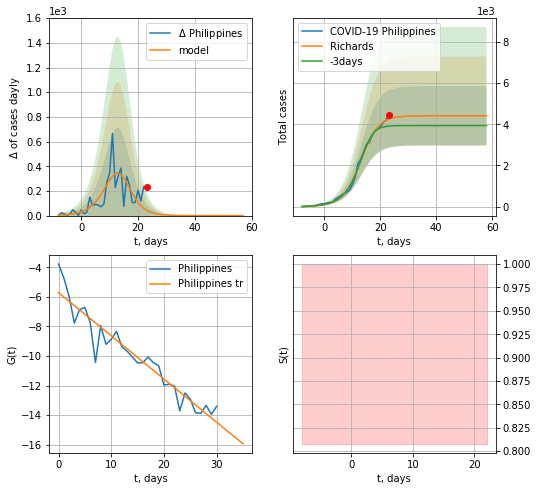

Philippines data at: 2020-09-19
+3 day model MAPE: 0.095041
model: Richards
coeffs: [4.40831989e+03 2.70678377e-01 1.39356489e+01 1.24523177e+00]
rational stdev: 0.326084
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 4408 ± 1437
	 total death: 76 ± 74
trend coefficient of determination: 0.911495
 intercept: -5.712821
 slope: -0.292234


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


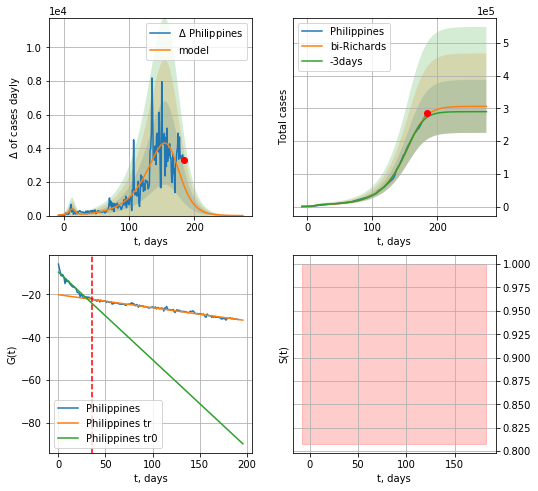

Philippines data at: 2020-09-19
+3 day model MAPE: 0.023263
model: bi-Richards
coeffs: [3.02092749e+05 3.54941088e-02 1.64968704e+02 2.16973227e+00]
rational stdev: 0.264264
forecast at the end of period: +91 days
	 deltaDaycases: 2
	 total cases: 306471 ± 80989
	 total death: 5326 ± 4222
bi-Richards approximation splitting point: 36
trend coefficient of determination: 0.925015
 intercept: -9.632200
 slope: -0.408302
trend coefficient of determination: 0.977321
 intercept: -20.187661
 slope: -0.060369


In [2288]:
vL = 36 + 4
x = forecastRR("Philippines",dfPH[4:vL-4],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Philippines",dfPH[4:],d1,38*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-4)

In [2289]:
#x = forecastRRR("Philippines",dfPH[4:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

GC
           date    cases  active  death
199 2020-09-15  13730.0    9613  313.0
200 2020-09-16  14041.0    9921  316.0
201 2020-09-17  14400.0   10271  325.0
202 2020-09-18  14738.0   10607  327.0
203 2020-09-19  14978.0    4658  331.0


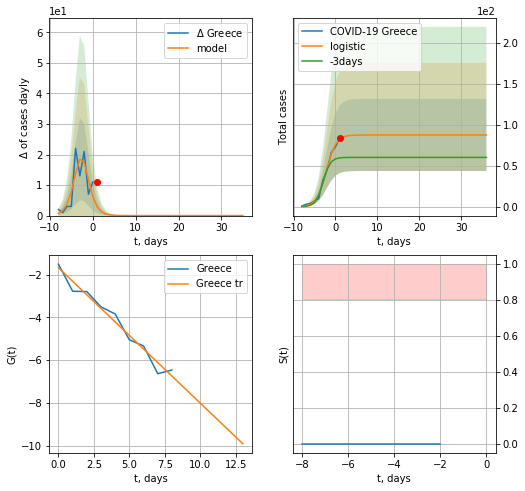

Greece data at: 2020-09-19
+3 day model MAPE: 0.4212876769828872
model: logistic
coeffs:  [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.5018417290456435
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  87 ± 43
	 total death:  1 ± 1
trend coefficient of determination: 0.966991
 intercept: -1.674249
 slope: -0.634181


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


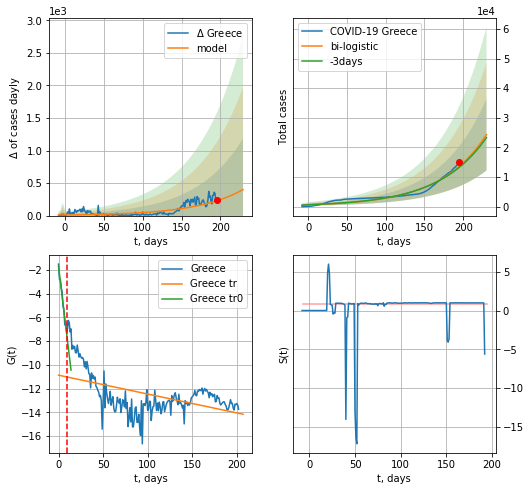

Greece data at: 2020-09-19
+3 day model MAPE: 0.025791619710170927
model: bi-logistic
coeffs:  [6.82184162e+07 1.66160134e-02 7.07990967e+02] [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.4983754618571143
forecast at the end of period: +35 days
	 deltaDaycases:  399
	 total cases:  24322 ± 12121
	 total death:  537 ± 802
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.974467
 intercept: -1.699561
 slope: -0.624689
trend coefficient of determination: 0.258426
 intercept: -10.873319
 slope: -0.015913


In [2290]:
dfGC = read_df(pd.DataFrame(),"GC")
x = forecast("Greece",dfGC[:10],d1,T18*7-dT)
xx = forecast2("Greece",dfGC[:],d1,T18*7-dT,x,addpred=False,xcoef=[.25/2,1.,2.3],vL=10)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


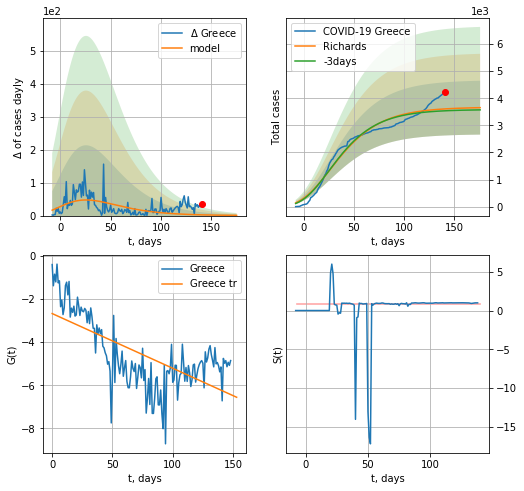

Greece data at: 2020-09-19
+3 day model MAPE: 0.019952
model: Richards
coeffs: [ 3.67300317e+03  8.86166446e+00 -1.31342745e+02  3.96579151e-03]
rational stdev: 0.271998
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 3654 ± 993
	 total death: 80 ± 65
trend coefficient of determination: 0.441158
 intercept: -2.678204
 slope: -0.025333


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


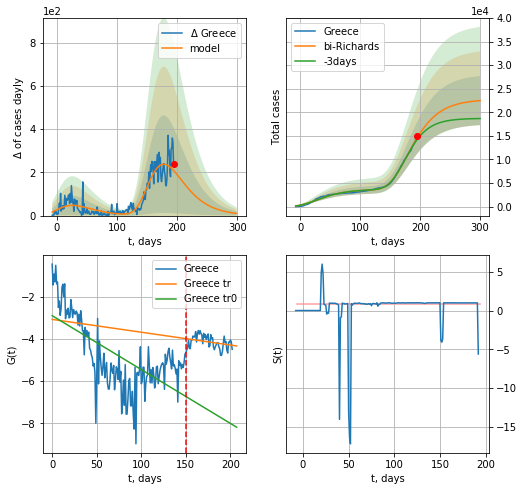

Greece data at: 2020-09-19
+3 day model MAPE: 0.029093
model: bi-Richards
coeffs: [1.91067601e+04 9.19291712e-01 8.26701539e+01 3.74150272e-02]
rational stdev: 0.231661
forecast at the end of period: +105 days
	 deltaDaycases: 9
	 total cases: 22492 ± 5210
	 total death: 497 ± 345
bi-Richards approximation splitting point: 150
trend coefficient of determination: 0.439344
 intercept: -2.895207
 slope: -0.025565
trend coefficient of determination: 0.088243
 intercept: -3.071371
 slope: -0.006085


In [2291]:
iL = 0
vL = 150+iL
x = forecastRR("Greece",dfGC[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Greece",dfGC[iL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


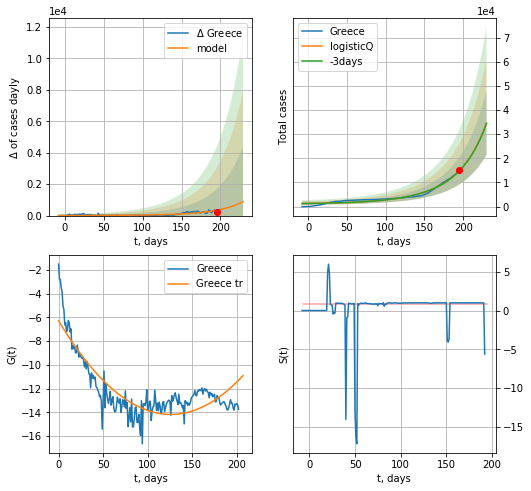

Greece data at: 2020-09-19
+3 day model MAPE: 0.003734
model: logisticQ
coeffs: [ 1.67778528e+07  5.06959568e-05  4.06717037e+02 -4.59600323e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.381307
forecast at the end of period: +35 days
	 deltaDaycases: 887
	 total cases: 34734 ± 13244
	 total death: 767 ± 877
trend coefficient of determination: 0.734059
 intercept_: -6.277874684355951
 coeffs_: [ 0.         -0.12553706  0.00049824]


In [2292]:
x = forecastRRR("Greece",dfGC[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

HG
           date    cases  active  death
193 2020-09-15  14460.0    9653  654.0
194 2020-09-16  15170.0   10280  663.0
195 2020-09-17  16111.0   11202  669.0
196 2020-09-18  16920.0   11863  675.0
197 2020-09-19  17990.0   12916  683.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


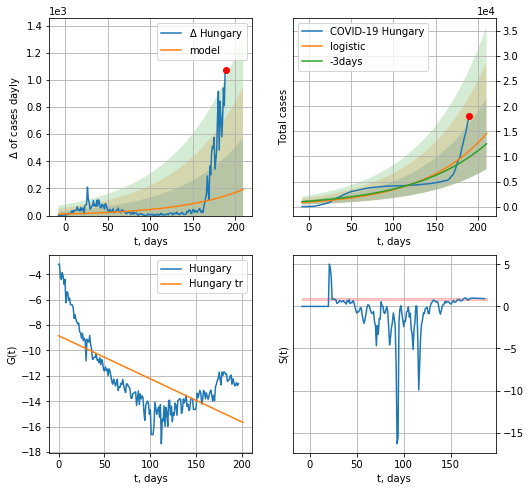

Hungary data at: 2020-09-19
+3 day model MAPE: 0.12412390524326586
model: logistic
coeffs:  [7.11755610e+07 1.32769061e-02 8.49799996e+02]
scenario coeffs:  [0.35, 0.5, 4, 1]
rational stdev:  0.48699122335370165
forecast at the end of period: +21 days
	 deltaDaycases:  191
	 total cases:  14557 ± 7089
	 total death:  552 ± 806
trend coefficient of determination: 0.447192
 intercept: -8.833321
 slope: -0.034005


In [2293]:
dfHG = read_df(pd.DataFrame(),"HG")
try:
    x = forecast("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=[.35,.5,4,1])
except:
    print("Exception occurs")
#xx = forecast2("Hungary",dfHG[:],d1,4*7-dT,x,vL=10)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


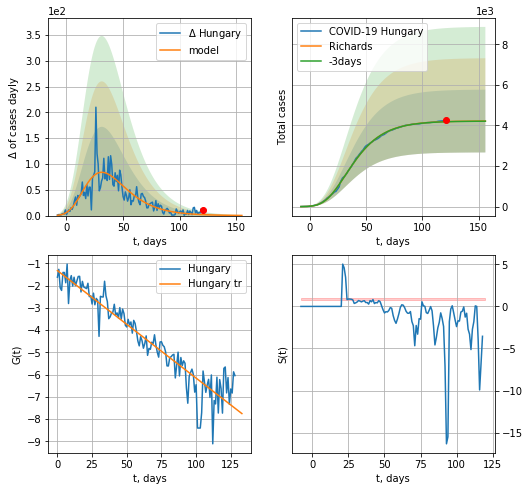

Hungary data at: 2020-09-19
+3 day model MAPE: 0.001493
model: Richards
coeffs: [ 4.22179468e+03  5.32490155e+00 -5.27402788e+01  1.02006678e-02]
rational stdev: 0.366758
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 4216 ± 1546
	 total death: 160 ± 176
trend coefficient of determination: 0.884632
 intercept: -1.330170
 slope: -0.048257


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


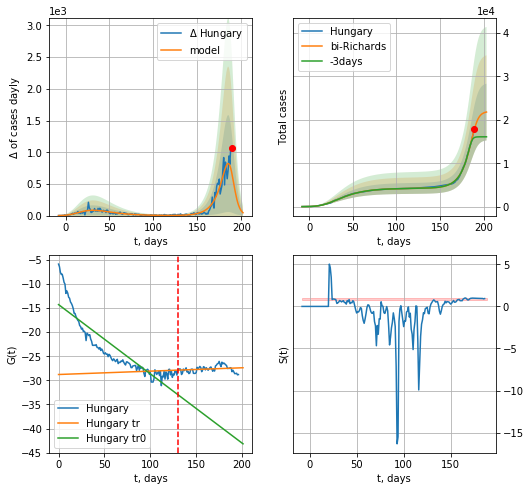

Hungary data at: 2020-09-19
+3 day model MAPE: 0.153801
model: bi-Richards
coeffs: [1.77264518e+04 1.04218711e-01 1.89141923e+02 2.65161143e+00]
rational stdev: 0.300051
forecast at the end of period: +14 days
	 deltaDaycases: 44
	 total cases: 21804 ± 6542
	 total death: 827 ± 744
bi-Richards approximation splitting point: 130
trend coefficient of determination: 0.796129
 intercept: -14.277675
 slope: -0.143755
trend coefficient of determination: 0.040050
 intercept: -28.786752
 slope: 0.006971


In [2294]:
vL = 130
x = forecastRR("Hungary",dfHG[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Hungary",dfHG[:],d1,27*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [2295]:
#x = forecastRRR("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='cases')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


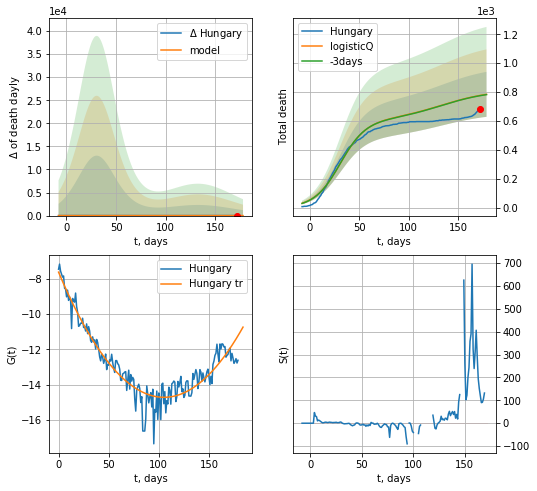

Hungary data at: 2020-09-19
+3 day model MAPE: 0.002234
model: logisticQ
coeffs: [ 6.03004805e+02  1.47285412e-07  3.07078706e+01 -5.17682250e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.198187
forecast at the end of period: +7 days
	 total death: 784 ± 155
trend coefficient of determination: 0.893513
 intercept_: -7.632598805720967
 coeffs_: [ 0.         -0.13468056  0.00064006]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: divide by zero encountered in true_divide


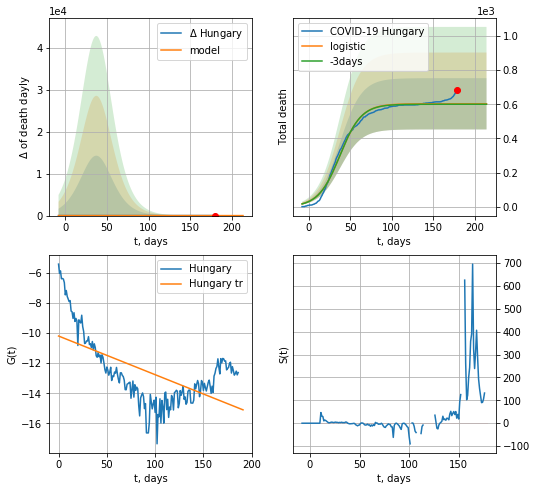

Hungary data at: 2020-09-19
+3 day model MAPE: 0.004270702718304432
model: logistic
coeffs:  [6.02605468e+02 7.71907630e-02 3.77085805e+01]
rational stdev:  0.24889370244724243
forecast at the end of period: +35 days
	 total death:  602 ± 149
trend coefficient of determination: 0.357948
 intercept: -10.196948
 slope: -0.025646


In [2296]:
x = forecastRRR("Hungary",dfHG[17:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')
x = forecast("Hungary",dfHG[10:],d1,T18*7-dT,cases='death')

MT
           date   cases  active  death
191 2020-09-15  2454.0     507   16.0
192 2020-09-16  2560.0     591   16.0
193 2020-09-17  2595.0     601   16.0
194 2020-09-18  2634.0     621   17.0
195 2020-09-19  2731.0     664   20.0


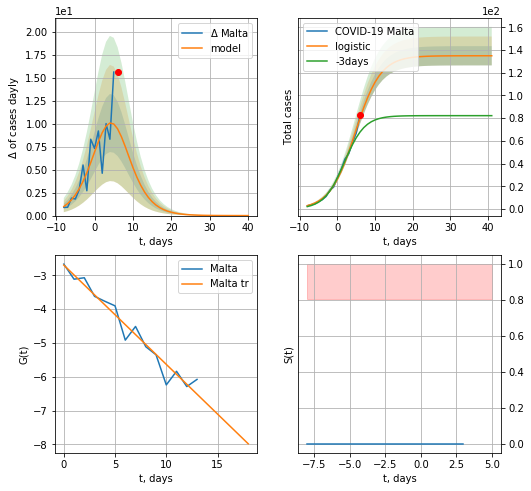

Malta data at: 2020-09-19
model: logistic
coeffs:  [135.01423457   0.29914202   4.75768623]
rational stdev:  0.06279874283082902
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  135 ± 8
	 total death:  0 ± 0
trend coefficient of determination: 0.952124
 intercept: -2.695789
 slope: -0.293811


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


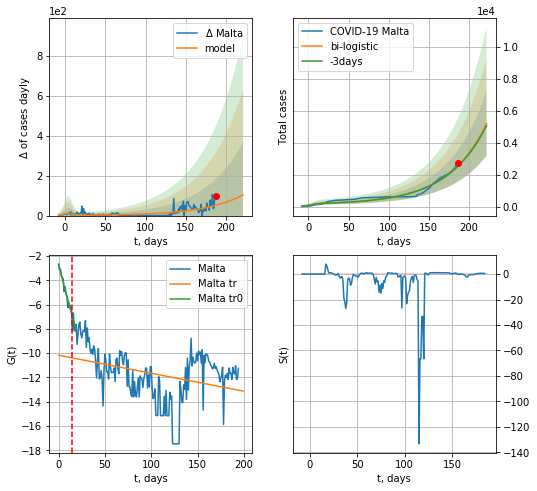

Malta data at: 2020-09-19
+3 day model MAPE: 0.01513664712493589
model: bi-logistic
coeffs:  [1.00867090e+07 2.06819609e-02 5.89309400e+02] [135.01423457   0.29914202   4.75768623]
scenario coeffs:  [0.125, 1.0, 1.8]
rational stdev:  0.38740609688120126
forecast at the end of period: +35 days
	 deltaDaycases:  103
	 total cases:  5197 ± 2013
	 total death:  38 ± 44
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.953633
 intercept: -2.737437
 slope: -0.284200
trend coefficient of determination: 0.123779
 intercept: -10.165635
 slope: -0.014834


In [2297]:
try:
    dfMT = read_df(pd.DataFrame(),"MT")
    x = forecast("Malta",dfMT[:15],d1,7*T18-dT,pMAPE=False)
    xx = forecast2("Malta",dfMT[:],d1,7*T18-dT,x,vL=15,addpred=True,xcoef=[0.25/2,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


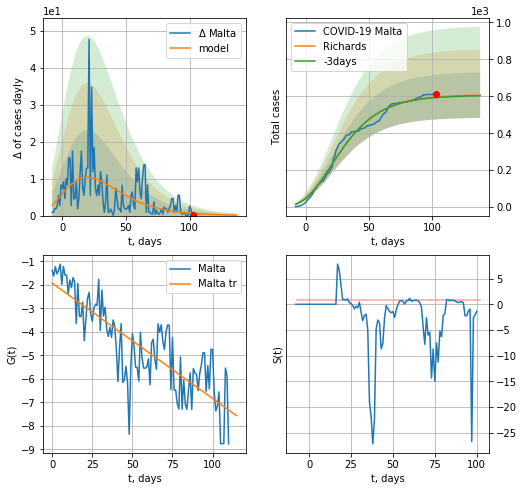

Malta data at: 2020-09-19
+3 day model MAPE: 0.004738
model: Richards
coeffs: [ 6.08571201e+02  8.24808839e+00 -9.10069288e+01  5.64853369e-03]
rational stdev: 0.203304
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 606 ± 123
	 total death: 4 ± 2
trend coefficient of determination: 0.678551
 intercept: -1.925365
 slope: -0.049026


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


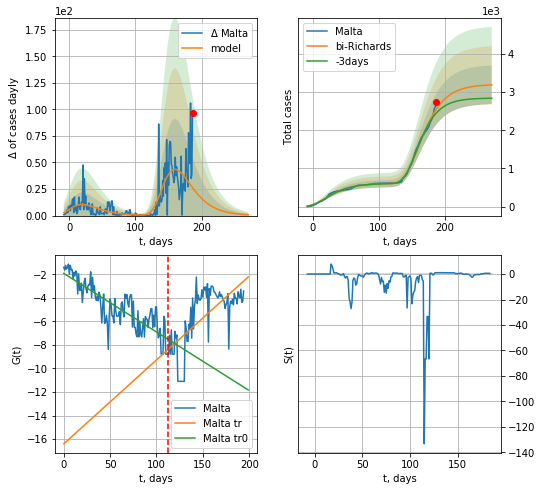

Malta data at: 2020-09-19
+3 day model MAPE: 0.043644
model: bi-Richards
coeffs: [2.59587771e+03 4.79854168e+00 5.82794877e+01 9.53089960e-03]
rational stdev: 0.158460
forecast at the end of period: +84 days
	 deltaDaycases: 0
	 total cases: 3188 ± 505
	 total death: 23 ± 10
bi-Richards approximation splitting point: 112
trend coefficient of determination: 0.687730
 intercept: -1.917022
 slope: -0.049794
trend coefficient of determination: 0.465072
 intercept: -16.405261
 slope: 0.071315


In [2298]:
vL = 112
x = forecastRR("Malta",dfMT[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Malta",dfMT[:],d1,37*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [2299]:
#x = forecastRRR("Malta",dfMT[:30],d1,T18*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1.])
#xx = forecast2RRR("Malta",dfMT[:],d1,40*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=30)

SL
           date   cases  active  death
189 2020-09-15  5860.0  2602.0   38.0
190 2020-09-16  6021.0  2694.0   39.0
191 2020-09-17  6256.0  2694.0   39.0
192 2020-09-18  6463.0  2827.0   39.0
193 2020-09-19  6677.0  3090.0   39.0


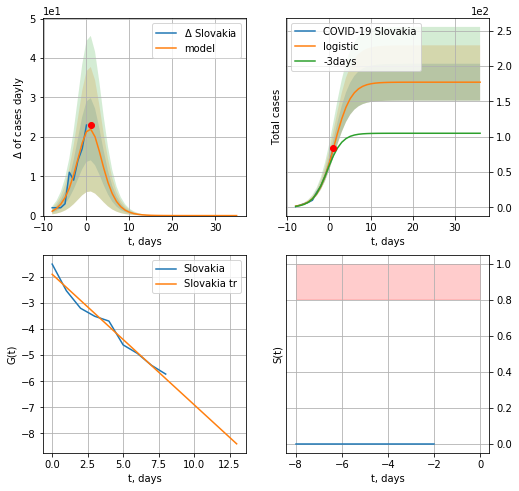

Slovakia data at: 2020-09-19
model: logistic
coeffs:  [177.28786061   0.49967231   1.23158076]
rational stdev:  0.14723855931524674
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  177 ± 26
	 total death:  1 ± 0
trend coefficient of determination: 0.974721
 intercept: -1.894823
 slope: -0.500610


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


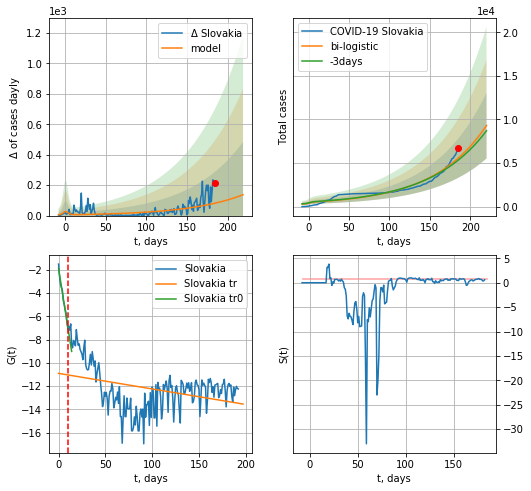

Slovakia data at: 2020-09-19
+3 day model MAPE: 0.04326146007878555
model: bi-logistic
coeffs:  [2.47976582e+07 1.51218766e-02 7.42862798e+02] [177.28786061   0.49967231   1.23158076]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.40539563810410884
forecast at the end of period: +35 days
	 deltaDaycases:  136
	 total cases:  9307 ± 3773
	 total death:  54 ± 65
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.981202
 intercept: -1.868036
 slope: -0.510655
trend coefficient of determination: 0.126944
 intercept: -10.908983
 slope: -0.013395


In [2301]:
dfSL = read_df(pd.DataFrame(),"SL")
dfSL = dfSL.fillna(0)
try:
    x = forecast("Slovakia",dfSL[:10],d1,T18*7-dT,pMAPE=False)
    xx = forecast2("Slovakia",dfSL[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=10)
except:
    print("Exception ocurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


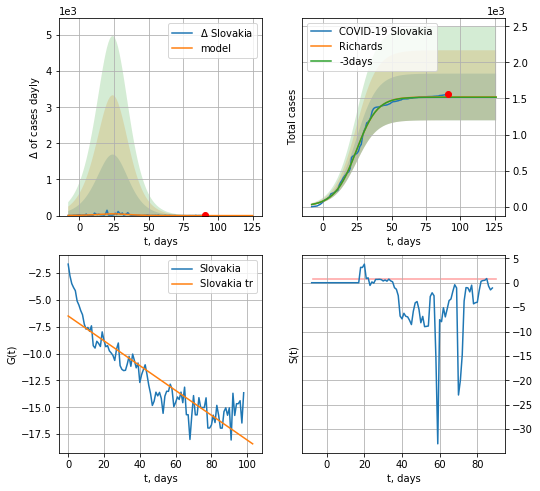

Slovakia data at: 2020-09-19
+3 day model MAPE: 0.002372
model: Richards
coeffs: [1.52109568e+03 1.16938732e-01 2.55808264e+01 1.14750291e+00]
rational stdev: 0.212800
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 1521 ± 323
	 total death: 8 ± 5
trend coefficient of determination: 0.817560
 intercept: -6.499033
 slope: -0.115624


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


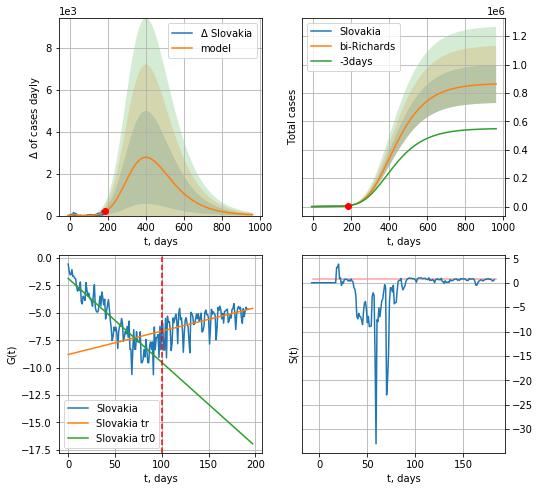

Slovakia data at: 2020-09-19
+3 day model MAPE: 0.012051
model: bi-Richards
coeffs: [8.66111814e+05 6.74915809e-02 1.88973383e+02 1.38346617e-01]
rational stdev: 0.155165
forecast at the end of period: +777 days
	 deltaDaycases: 42
	 total cases: 863055 ± 133915
	 total death: 5041 ± 2346
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.809376
 intercept: -1.862606
 slope: -0.076555
trend coefficient of determination: 0.272199
 intercept: -8.801470
 slope: 0.021377


In [2302]:
vL = 100
x = forecastRR("Slovakia",dfSL[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Slovakia",dfSL[:],d12f(1),136*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [2303]:
#x = forecastRRR("Slovakia",dfSL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

SV
           date   cases  active  death
194 2020-09-15  3954.0   975.0  135.0
195 2020-09-16  4058.0  1025.0  136.0
196 2020-09-17  4125.0  1025.0  136.0
197 2020-09-18  4195.0  1116.0  140.0
198 2020-09-19  4420.0  1255.0  142.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


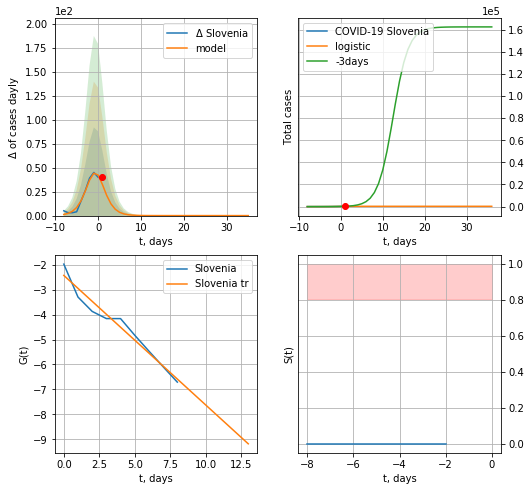

Slovenia data at: 2020-09-19
model: logistic
coeffs:  [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
rational stdev:  0.5312441686508605
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  261 ± 138
	 total death:  8 ± 12
trend coefficient of determination: 0.958485
 intercept: -2.427236
 slope: -0.519636


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


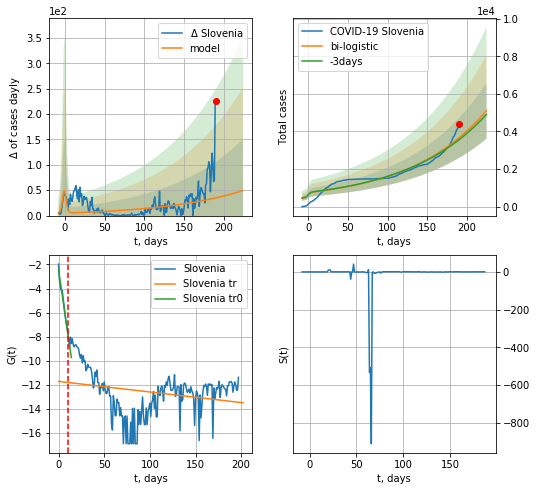

Slovenia data at: 2020-09-19
+3 day model MAPE: 0.02777078959994877
model: bi-logistic
coeffs:  [5.47764875e+06 1.02472054e-02 9.10982298e+02] [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.29100841834924424
forecast at the end of period: +35 days
	 deltaDaycases:  49
	 total cases:  5107 ± 1486
	 total death:  164 ± 143
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.969651
 intercept: -2.421914
 slope: -0.521632
trend coefficient of determination: 0.060051
 intercept: -11.710638
 slope: -0.008784


In [2304]:
dfSV = read_df(pd.DataFrame(),"SV").fillna(0)
try:
    x = forecast("Slovenia",dfSV[:10],d1,7*T18-dT,pMAPE=False)
    xx = forecast2("Slovenia",dfSV[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,3.],vL=10)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


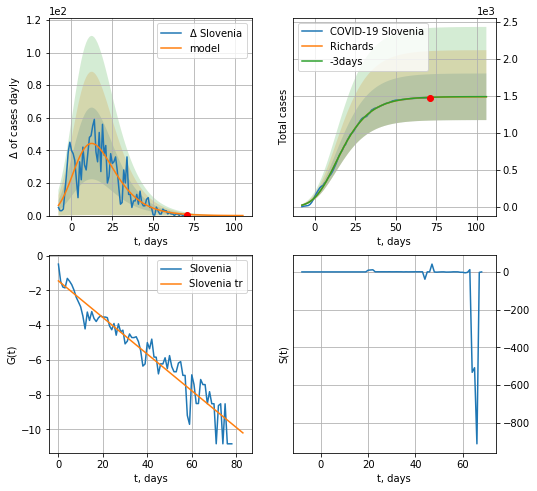

Slovenia data at: 2020-09-19
+3 day model MAPE: 0.001063
model: Richards
coeffs: [ 1.48543612e+03  5.20176508e-01 -7.42026148e+00  1.68829761e-01]
rational stdev: 0.211962
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 1485 ± 314
	 total death: 47 ± 29
trend coefficient of determination: 0.919511
 intercept: -1.449330
 slope: -0.105393


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


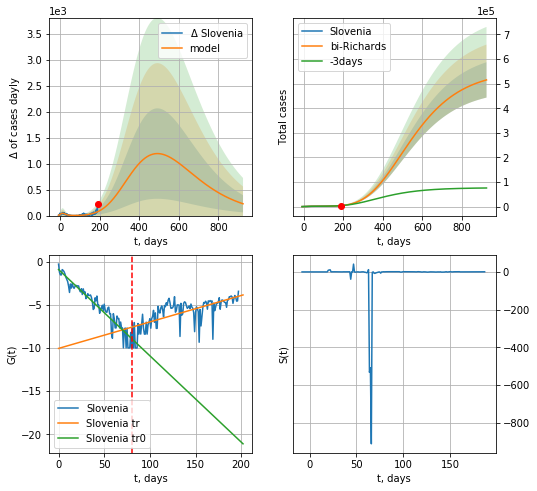

Slovenia data at: 2020-09-19
+3 day model MAPE: 0.037899
model: bi-Richards
coeffs: [5.52946626e+05 1.11950053e-01 7.41668599e+00 5.38470312e-02]
rational stdev: 0.139451
forecast at the end of period: +735 days
	 deltaDaycases: 227
	 total cases: 515295 ± 71858
	 total death: 16554 ± 6925
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.912963
 intercept: -0.903285
 slope: -0.099962
trend coefficient of determination: 0.460305
 intercept: -10.044799
 slope: 0.030665


In [2305]:
vL = 80
x = forecastRR("Slovenia",dfSV[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Slovenia",dfSV[:],d1,130*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [2306]:
#print(koreaCoeffs)
#x = forecastRRR("Slovenia",dfSV[:10],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR("Slovenia",dfSV[:],d1,T18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=10)

SB
           date  cases  active  death
189 2020-09-15  32511   463.0  735.0
190 2020-09-16  32613   466.0  736.0
191 2020-09-17  32695   445.0  738.0
192 2020-09-18  32757   607.0  739.0
193 2020-09-19  32840   689.0  740.0


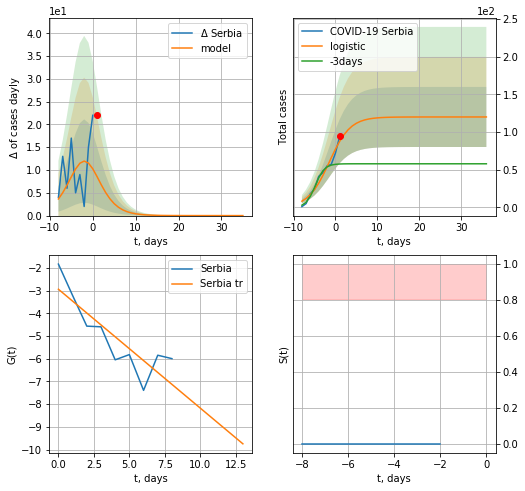

Serbia data at: 2020-09-19
model: logistic
coeffs:  [119.86808879   0.40041875  -1.48148474]
rational stdev:  0.33210329199703215
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  119 ± 39
	 total death:  2 ± 1
trend coefficient of determination: 0.723021
 intercept: -2.939233
 slope: -0.523684


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


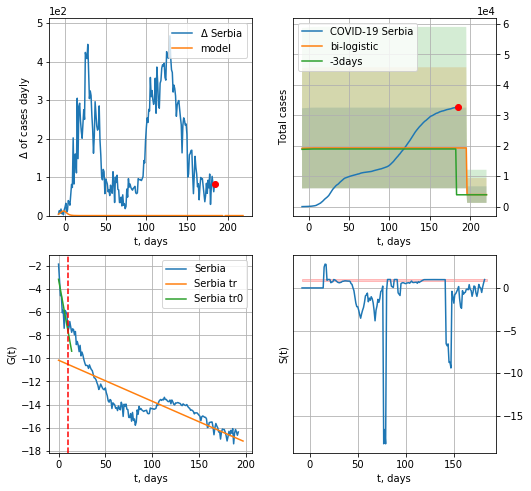

Serbia data at: 2020-09-19
+3 day model MAPE: 3.964113077206669
model: bi-logistic
coeffs:  [15317.00141885   -21.32831256   195.64993213] [119.86808879   0.40041875  -1.48148474]
scenario coeffs:  [0.25, 1.0, 2.2]
rational stdev:  0.6877794506313362
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  3949 ± 2716
	 total death:  88 ± 181
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.680312
 intercept: -3.149496
 slope: -0.444835
trend coefficient of determination: 0.686172
 intercept: -10.163176
 slope: -0.035549


In [2307]:
dfSB = read_df(pd.DataFrame(),"SB")
dfSB = dfSB.fillna(0)
x = forecast("Serbia",dfSB[:10],d1,T18*7-dT,pMAPE=False)
xx = forecast2("Serbia",dfSB[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,2.2],vL=10)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


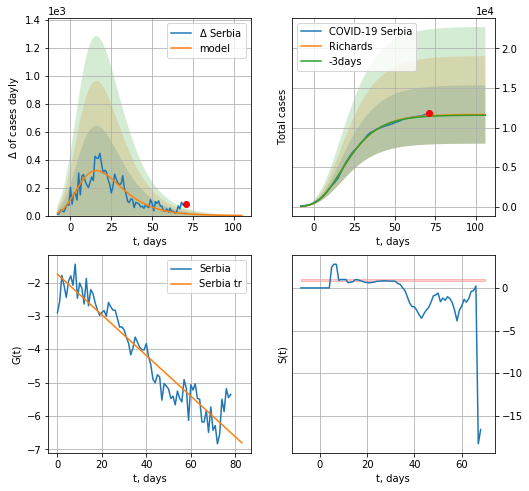

Serbia data at: 2020-09-19
+3 day model MAPE: 0.006988
model: Richards
coeffs: [ 1.16624341e+04  1.86550219e+00 -2.54632436e+01  4.09637438e-02]
rational stdev: 0.315870
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 11650 ± 3679
	 total death: 262 ± 248
trend coefficient of determination: 0.902509
 intercept: -1.751737
 slope: -0.060887


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


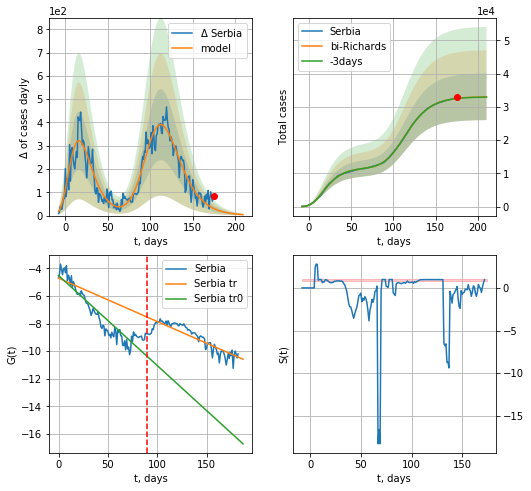

Serbia data at: 2020-09-19
+3 day model MAPE: 0.001862
model: bi-Richards
coeffs: [2.14365443e+04 1.45955339e-01 9.75277476e+01 4.06003183e-01]
rational stdev: 0.211972
forecast at the end of period: +35 days
	 deltaDaycases: 4
	 total cases: 33031 ± 7001
	 total death: 744 ± 473
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.864351
 intercept: -4.524112
 slope: -0.065122
trend coefficient of determination: 0.769919
 intercept: -4.713923
 slope: -0.031371


In [2308]:
iL=10
vL=90+iL
x = forecastRR("Serbia",dfSB[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Serbia",dfSB[iL:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [2309]:
#x = forecastRRR("Serbia",dfSB[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

CT
           date    cases  active  death
199 2020-09-15  14029.0  2103.0  236.0
200 2020-09-16  14279.0  2108.0  238.0
201 2020-09-17  14500.0  2108.0  238.0
202 2020-09-18  14725.0  2128.0  244.0
203 2020-09-19  14922.0  2138.0  248.0


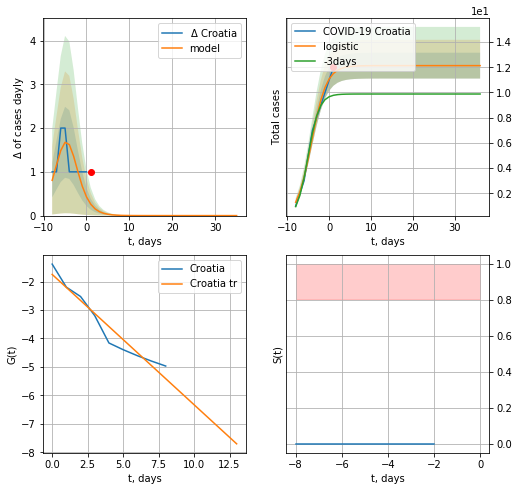

Croatia data at: 2020-09-19
model: logistic
coeffs:  [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.08430442468045289
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  12 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.936719
 intercept: -1.749041
 slope: -0.458074


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


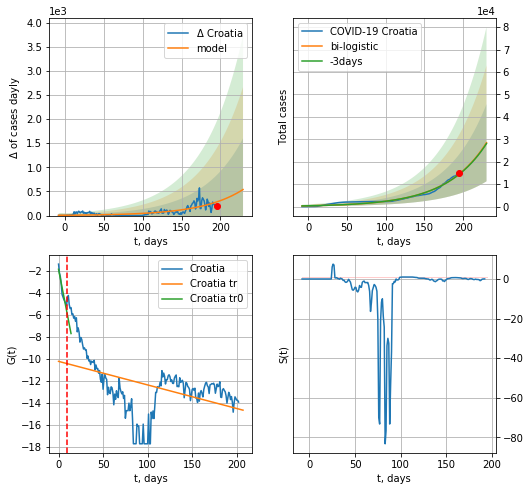

Croatia data at: 2020-09-19
+3 day model MAPE: 0.008268748120610738
model: bi-logistic
coeffs:  [5.30984833e+07 1.91364086e-02 6.23491214e+02] [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.6039117474545792
forecast at the end of period: +35 days
	 deltaDaycases:  539
	 total cases:  28496 ± 17209
	 total death:  473 ± 856
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.922384
 intercept: -1.856940
 slope: -0.417612
trend coefficient of determination: 0.197330
 intercept: -10.236078
 slope: -0.021455


In [2310]:
try:
    dfCT = read_df(pd.DataFrame(),"CT")
    dfCT = dfCT.fillna(0)
    x = forecast("Croatia",dfCT[:10],d1,T18*7-dT,pMAPE=False)
    xx = forecast2("Croatia",dfCT[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25/2,1.,2.],vL=10)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


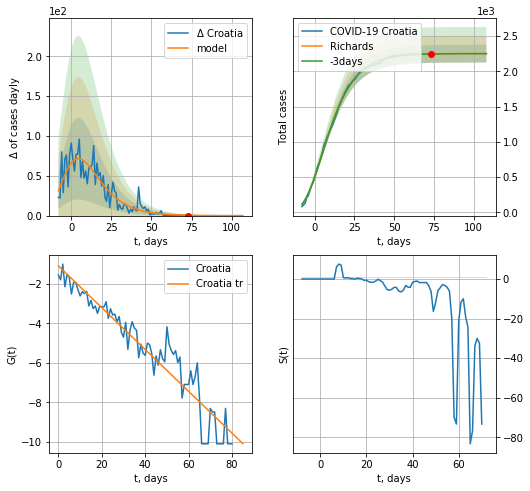

Croatia data at: 2020-09-19
+3 day model MAPE: 0.000062
model: Richards
coeffs: [ 2.25221314e+03  8.22861964e+00 -4.74876633e+01  1.05637631e-02]
rational stdev: 0.056077
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 2251 ± 126
	 total death: 37 ± 6
trend coefficient of determination: 0.906222
 intercept: -1.091343
 slope: -0.105900


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


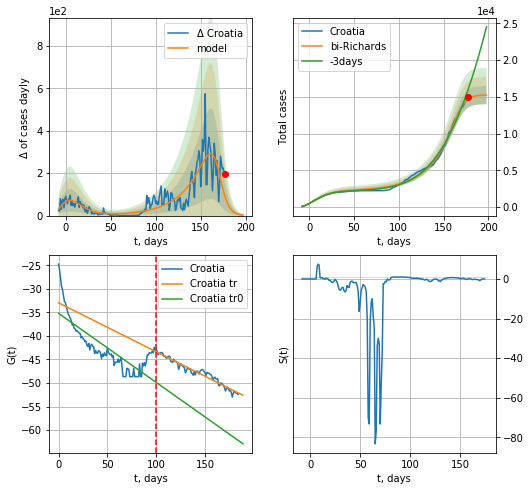

Croatia data at: 2020-09-19
+3 day model MAPE: 0.087176
model: bi-Richards
coeffs: [1.29960072e+04 3.86051000e-02 1.69803002e+02 5.00533711e+00]
rational stdev: 0.081145
forecast at the end of period: +21 days
	 deltaDaycases: 2
	 total cases: 15237 ± 1236
	 total death: 253 ± 61
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.648327
 intercept: -35.201315
 slope: -0.146536
trend coefficient of determination: 0.948998
 intercept: -32.969790
 slope: -0.103831


In [2311]:
iL = 18
vL = 100+iL
x = forecastRR("Croatia",dfCT[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Croatia",dfCT[iL:],d12f(1),28*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [2312]:
#x = forecastRRR("Croatia",dfCT[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

EG
           date   cases  active   death
193 2020-09-15  101340    9916  5679.0
194 2020-09-16  101500    9255  5696.0
195 2020-09-17  101641    8768  5715.0
196 2020-09-18  101772    8081  5733.0
197 2020-09-19  101900    7484  5750.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


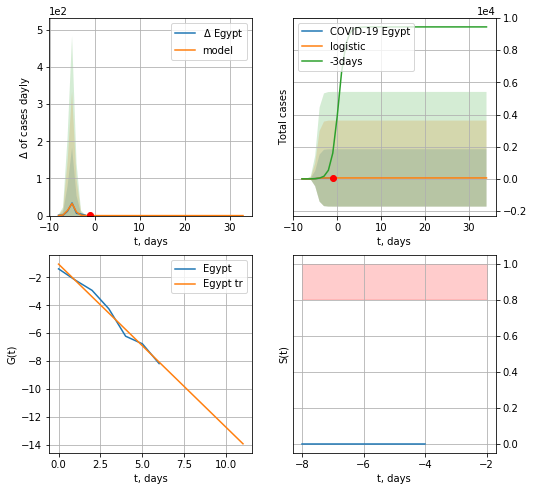

Egypt data at: 2020-09-19
+3 day model MAPE: 0.9848539099062313
model: logistic
coeffs:  [58.57021122  2.53530653 -4.60228222]
rational stdev:  30.428321363178444
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  58 ± 1782
	 total death:  3 ± 273
trend coefficient of determination: 0.982412
 intercept: -1.045837
 slope: -1.172929


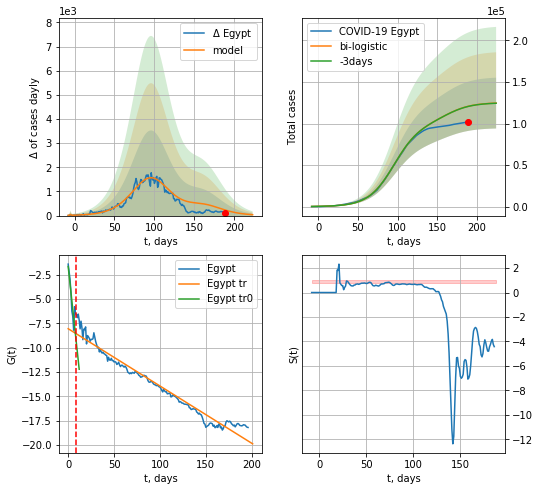

Egypt data at: 2020-09-19
+3 day model MAPE: 0.0011787475436867633
model: bi-logistic
coeffs:  [1.00145998e+05 6.16636534e-02 9.56937805e+01] [58.57021122  2.53530653 -4.60228222]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.24526701203833368
forecast at the end of period: +35 days
	 deltaDaycases:  36
	 total cases:  124646 ± 30571
	 total death:  7033 ± 5174
bi-logistic approximation splitting point: 8
trend0 coefficient of determination: 0.807637
 intercept: -1.627174
 slope: -0.882261
trend coefficient of determination: 0.960671
 intercept: -8.039799
 slope: -0.058981


In [2313]:
dfEG = read_df(pd.DataFrame(),"EG")
x = forecast("Egypt",dfEG[:8],d1,7*T18-dT)
xx = forecast2("Egypt",dfEG[:],d1,30*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=8)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


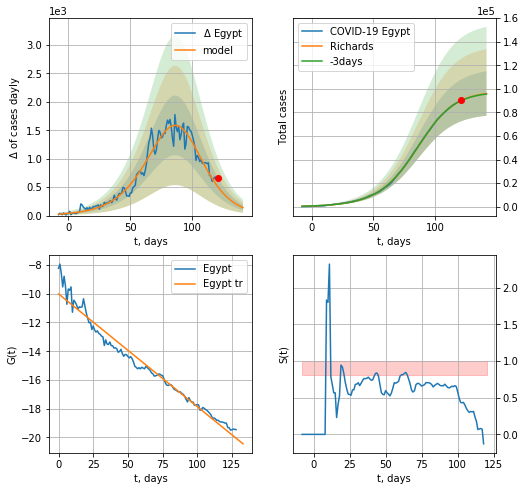

Egypt data at: 2020-09-19
+3 day model MAPE: 0.002349
model: Richards
coeffs: [9.80452652e+04 5.49784423e-02 9.01515288e+01 1.27472002e+00]
rational stdev: 0.196169
forecast at the end of period: +21 days
	 deltaDaycases: 140
	 total cases: 96059 ± 18843
	 total death: 5420 ± 3189
trend coefficient of determination: 0.969341
 intercept: -10.012670
 slope: -0.078415


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


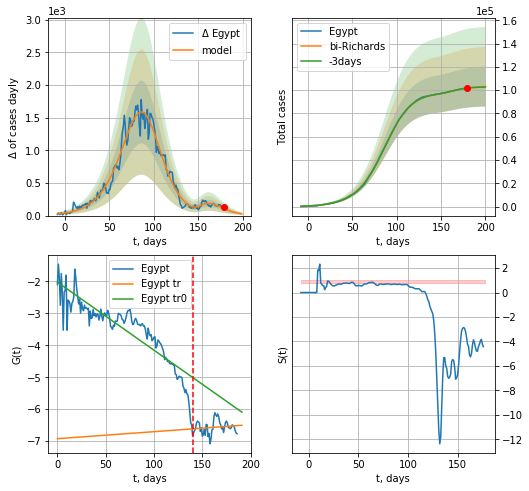

Egypt data at: 2020-09-19
+3 day model MAPE: 0.001239
model: bi-Richards
coeffs: [5.36259684e+03 1.05784691e+01 1.02630899e+02 7.50347495e-03]
rational stdev: 0.165697
forecast at the end of period: +21 days
	 deltaDaycases: 26
	 total cases: 103067 ± 17077
	 total death: 5815 ± 2890
bi-Richards approximation splitting point: 140
trend coefficient of determination: 0.794969
 intercept: -2.025285
 slope: -0.021294
trend coefficient of determination: 0.020158
 intercept: -6.922531
 slope: 0.002198


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power


In [2314]:
iL = 10
vL = 140+iL
x = forecastRR("Egypt",dfEG[iL:vL-iL],d1,28*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Egypt",dfEG[iL:],d1,28*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [2315]:
#x = forecastRRR("Egypt",dfEG[12:],d1,85*7-dT,addpred=True,xcoef=koreaCoeffs)

IQ
           date   cases   active   death
196 2020-09-15  298702  57190.0  8166.0
197 2020-09-16  303059  57570.0  8248.0
198 2020-09-17  307385  57953.0  8332.0
199 2020-09-18  311690  57977.0  8408.0
200 2020-09-19  315597  57567.0  8491.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


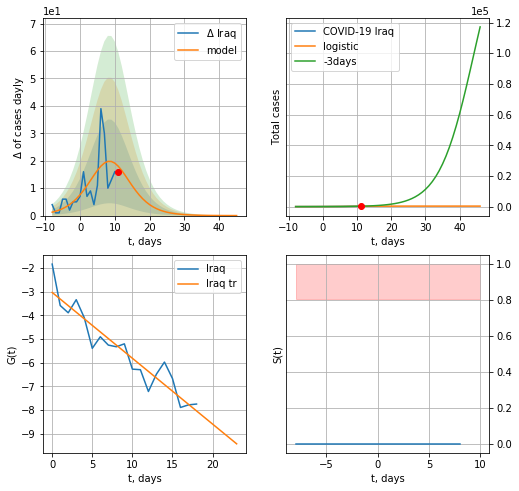

Iraq data at: 2020-09-19
+3 day model MAPE: 0.34474037669474106
model: logistic
coeffs:  [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.20777406895257303
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  317 ± 65
	 total death:  8 ± 4
trend coefficient of determination: 0.889033
 intercept: -3.031672
 slope: -0.278416


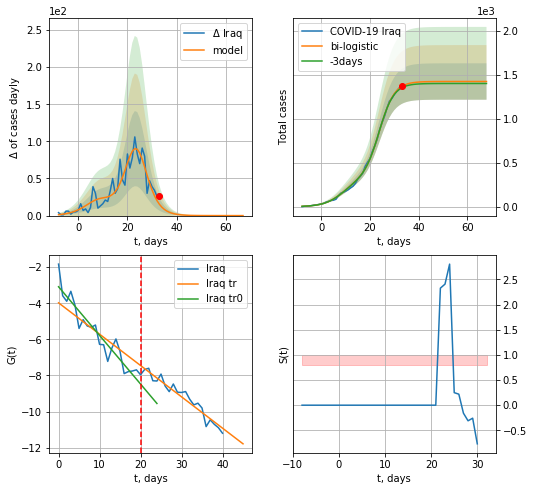

Iraq data at: 2020-09-19
+3 day model MAPE: 0.012548655608678476
model: bi-logistic
coeffs:  [1.10877596e+03 3.20225975e-01 2.39035989e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.14537179336300032
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  1425 ± 207
	 total death:  38 ± 16
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend coefficient of determination: 0.928562
 intercept: -3.976586
 slope: -0.173518


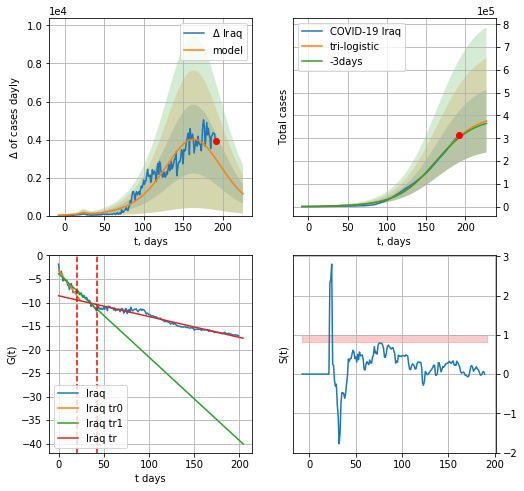

Iraq data at: 2020-09-19
+3 day model MAPE: 0.013993322242922268
model: tri-logistic
coeffs:  [4.04312546e+05 3.97596056e-02 1.63814144e+02] [3.17081296e+02 2.50431387e-01 8.98163530e+00 1.10877596e+03
 3.20225975e-01 2.39035989e+01]
forecast rational stdev:  0.3668249599568519
forecast at the end of period: +35 days
	 deltaDaycases:  1134
	 total cases:  375413 ± 137710
	 total death:  10100 ± 11114
tri-logistic approximation splitting points: 20,42
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend1 coefficient of determination: 0.937217
 intercept: -3.879636
 slope: -0.177153
trend coefficient of determination: 0.949487
 intercept: -8.553536
 slope: -0.044214


In [2316]:
vL=20
vL1=42
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIQ = dfIQ.fillna(0)
x = forecast("Iraq",dfIQ[:vL],d1,T18*7-dT)
xx = forecast2("Iraq",dfIQ[:vL1],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Iraq",dfIQ[:],d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


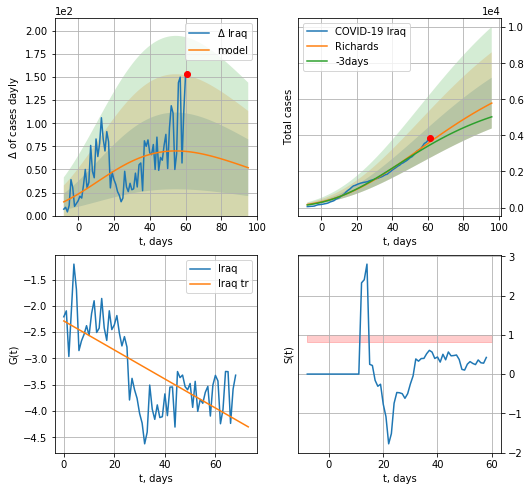

Iraq data at: 2020-09-19
+3 day model MAPE: 0.049876
model: Richards
coeffs: [ 8.66913850e+03  2.11659471e+00 -1.51652885e+02  1.04324891e-02]
rational stdev: 0.242987
forecast at the end of period: +35 days
	 deltaDaycases: 51
	 total cases: 5791 ± 1407
	 total death: 155 ± 112
trend coefficient of determination: 0.498225
 intercept: -2.287589
 slope: -0.027573


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


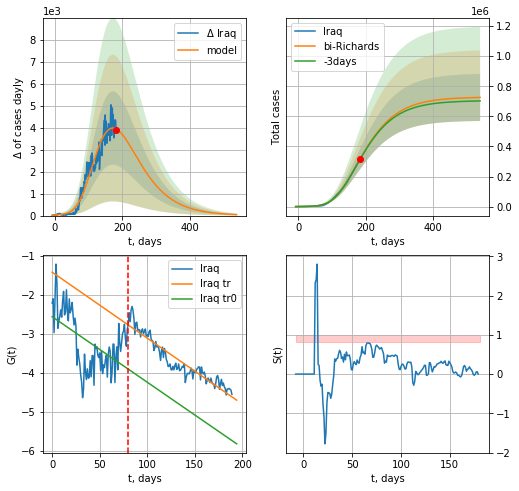

Iraq data at: 2020-09-19
+3 day model MAPE: 0.004878
model: bi-Richards
coeffs: [ 7.20074435e+05  1.18677156e+00 -1.17153672e+02  1.27009464e-02]
rational stdev: 0.215384
forecast at the end of period: +357 days
	 deltaDaycases: 43
	 total cases: 725876 ± 156342
	 total death: 19529 ± 12618
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.277787
 intercept: -2.564449
 slope: -0.016783
trend coefficient of determination: 0.890145
 intercept: -1.424831
 slope: -0.016892


In [2317]:
iL = 10
vL=80+iL#25+10
x = forecastRR("Iraq",dfIQ[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iraq",dfIQ[iL:],d1,76*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [2318]:
#x = forecastRRR("Iraq",dfIQ[9:42],d1,T18*7-dT,addpred=False,xcoef=[0.35,.5,4.,1])
#xx = forecast2RRR("Iraq",dfIQ[9:],d1,24*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=42)

In [2319]:
#len(dfAR)

AR
           date    cases   active   death
195 2020-09-15  48734.0  12717.0  1632.0
196 2020-09-16  48966.0  12804.0  1645.0
197 2020-09-17  49194.0  12865.0  1654.0
198 2020-09-18  49413.0  12936.0  1659.0
199 2020-09-19  49623.0  13035.0  1665.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


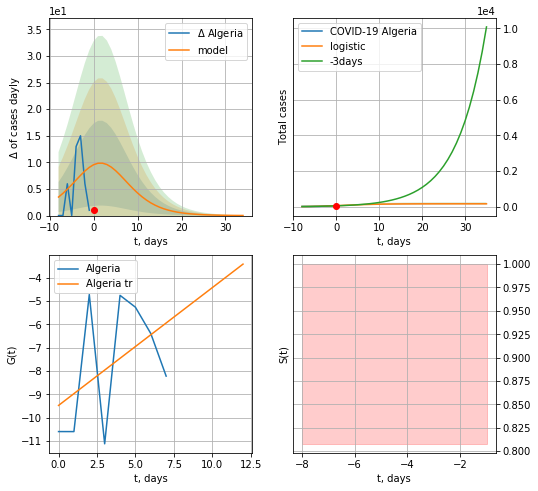

Algeria data at: 2020-09-19
+3 day model MAPE: 0.16392519582549905
model: logistic
coeffs:  [169.67149558   0.23328995   2.04236169]
rational stdev:  0.1546785167835457
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  169 ± 26
	 total death:  5 ± 2
trend coefficient of determination: 0.198482
 intercept: -9.477734
 slope: 0.504434


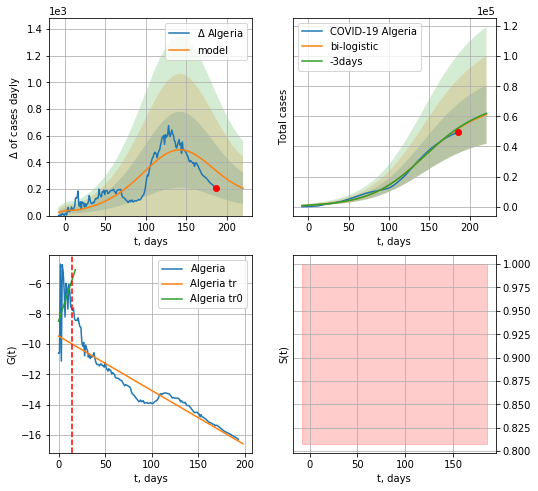

Algeria data at: 2020-09-19
+3 day model MAPE: 0.007641218789653369
model: bi-logistic
coeffs:  [6.43159718e+04 3.03074198e-02 1.41662399e+02] [169.67149558   0.23328995   2.04236169]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.31672410599666806
forecast at the end of period: +35 days
	 deltaDaycases:  204
	 total cases:  61270 ± 19405
	 total death:  2055 ± 1952
bi-logistic approximation splitting point: 14
trend0 coefficient of determination: 0.134003
 intercept: -8.492024
 slope: 0.188486
trend coefficient of determination: 0.884216
 intercept: -9.473036
 slope: -0.035870


In [2322]:
dfAR = read_df(pd.DataFrame(),"AR")
x = forecast("Algeria",dfAR[5:14],d1,7*T18-dT)
xx = forecast2("Algeria",dfAR[5:],d1,7*T18-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=14)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


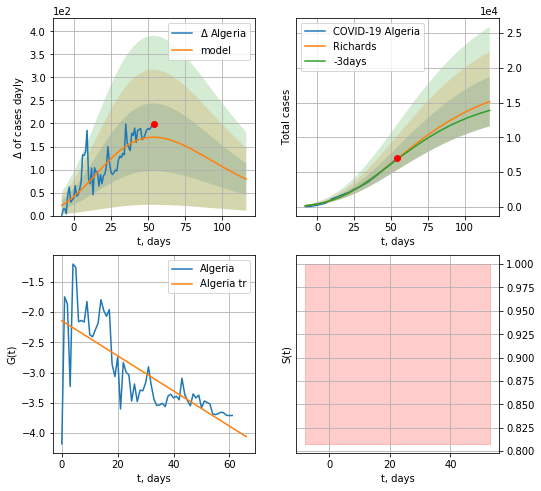

Algeria data at: 2020-09-19
+3 day model MAPE: 0.017361
model: Richards
coeffs: [ 1.86312269e+04  1.59750196e+00 -1.12063742e+02  1.56623086e-02]
rational stdev: 0.235608
forecast at the end of period: +63 days
	 deltaDaycases: 79
	 total cases: 15151 ± 3569
	 total death: 508 ± 359
trend coefficient of determination: 0.563244
 intercept: -2.140644
 slope: -0.029042


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


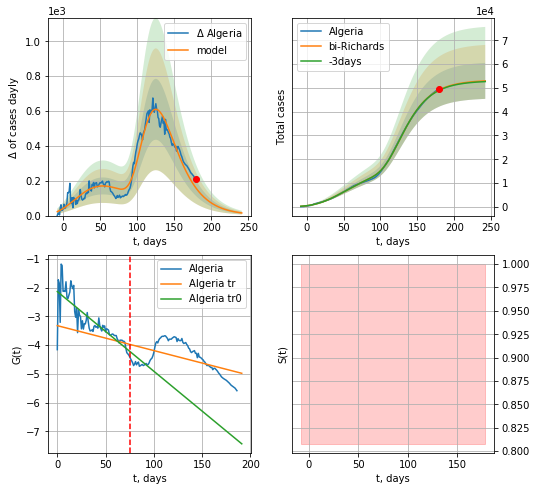

Algeria data at: 2020-09-19
+3 day model MAPE: 0.003243
model: bi-Richards
coeffs: [3.47635048e+04 3.94085685e+00 2.13064471e+01 1.08748181e-02]
rational stdev: 0.142962
forecast at the end of period: +63 days
	 deltaDaycases: 15
	 total cases: 52977 ± 7573
	 total death: 1777 ± 762
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.671166
 intercept: -2.135792
 slope: -0.027714
trend coefficient of determination: 0.277023
 intercept: -3.320629
 slope: -0.008675


In [2323]:
vL = 75+12
x = forecastRR("Algeria",dfAR[12:vL-12],d1,34*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Algeria",dfAR[12:],d1,34*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)

In [2324]:
#x = forecastRRR("Algeria",dfAR[12:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

CP
           date   cases  active  death
187 2020-09-15  1540.0   236.0   22.0
188 2020-09-16  1548.0   244.0   22.0
189 2020-09-17  1558.0   254.0   22.0
190 2020-09-18  1565.0   261.0   22.0
191 2020-09-19  1590.0   286.0   22.0


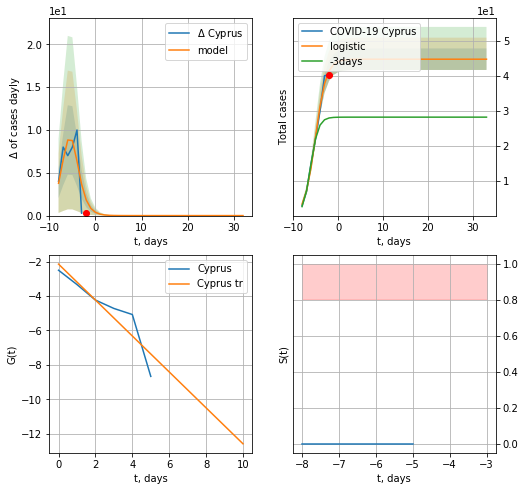

Cyprus data at: 2020-09-19
+3 day model MAPE: 0.5347775670777937
model: logistic
coeffs:  [44.71273924  0.83168064 -5.024159  ]
rational stdev:  0.06852146203610965
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  44 ± 3
	 total death:  0 ± 0
trend coefficient of determination: 0.837222
 intercept: -2.149855
 slope: -1.042802


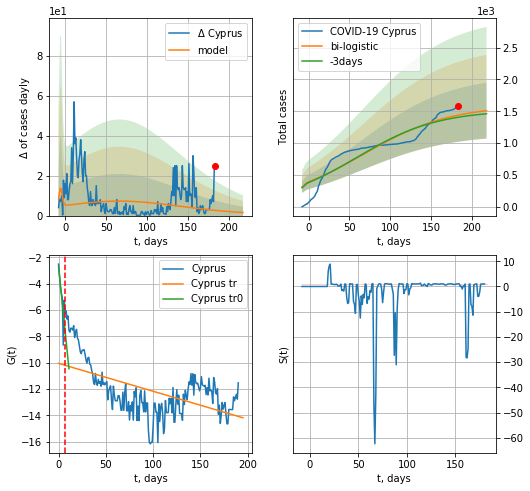

Cyprus data at: 2020-09-19
+3 day model MAPE: 0.023477625153076918
model: bi-logistic
coeffs:  [1.55137580e+03 1.87230257e-02 6.65714091e+01] [44.71273924  0.83168064 -5.024159  ]
rational stdev:  0.2902977127930641
forecast at the end of period: +35 days
	 deltaDaycases:  1
	 total cases:  1510 ± 438
	 total death:  20 ± 17
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.605369
 intercept: -2.714226
 slope: -0.704180
trend coefficient of determination: 0.311811
 intercept: -10.046639
 slope: -0.021204


In [2325]:
try:
    dfCP = read_df(pd.DataFrame(),"CP")
    dfCP = dfCP.fillna(0)
    x = forecast("Cyprus",dfCP[:7],d1,7*T18-dT)
    xx = forecast2("Cyprus",dfCP[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,2.3],vL=7)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


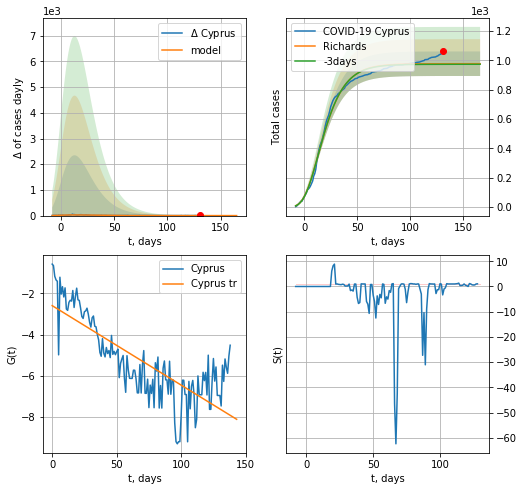

Cyprus data at: 2020-09-19
+3 day model MAPE: 0.003899
model: Richards
coeffs: [ 9.76316968e+02  1.29526584e+01 -5.80116939e+01  5.60254248e-03]
rational stdev: 0.085570
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 976 ± 83
	 total death: 13 ± 3
trend coefficient of determination: 0.611365
 intercept: -2.592811
 slope: -0.038703


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


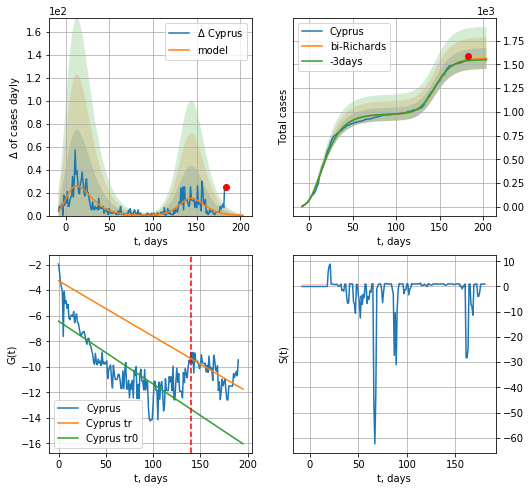

Cyprus data at: 2020-09-19
+3 day model MAPE: 0.006981
model: bi-Richards
coeffs: [5.88379397e+02 1.30740329e-01 1.40839054e+02 7.20219608e-01]
rational stdev: 0.070784
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 1562 ± 110
	 total death: 21 ± 4
bi-Richards approximation splitting point: 140
trend coefficient of determination: 0.624949
 intercept: -6.427934
 slope: -0.049240
trend coefficient of determination: 0.416104
 intercept: -3.266396
 slope: -0.043525


In [2326]:
iL = 0
vL=140+iL
x = forecastRR("Cyprus",dfCP[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
x = forecast2RR("Cyprus",dfCP[iL:],d1,28*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [2327]:
#vL=33
#x = forecastRRR("Cyprus",dfCP[:],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)
#xx = forecast2RRR("Cyprus",dfCP[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,4,1],vL=vL)

PU
           date   cases    active    death
192 2020-09-15  738020  126340.0  30927.0
193 2020-09-16  744400  125632.0  31051.0
194 2020-09-17  750098  124439.0  31146.0
195 2020-09-18  756412  124334.0  31283.0
196 2020-09-19  762865  123659.0  31369.0


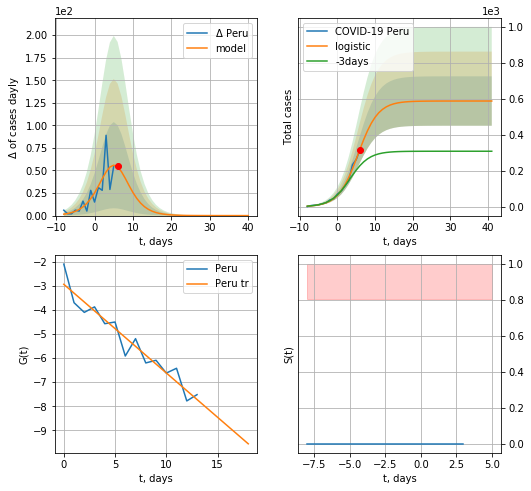

Peru data at: 2020-09-19
+3 day model MAPE: 0.4976759510371563
model: logistic
coeffs:  [5.88914141e+02 3.80777382e-01 5.52424877e+00]
rational stdev:  0.23355774891059702
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  588 ± 137
	 total death:  24 ± 16
trend coefficient of determination: 0.924015
 intercept: -2.937528
 slope: -0.367722


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


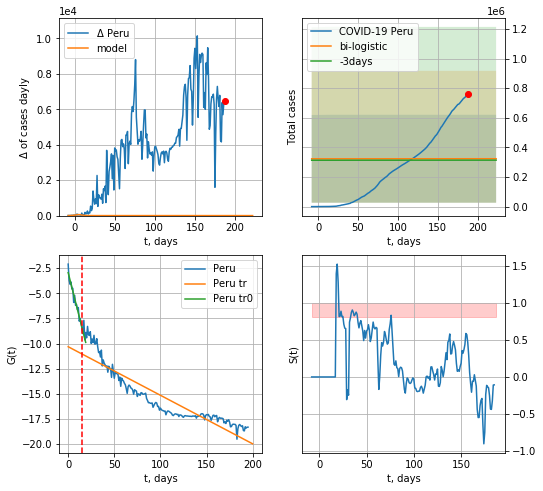

Peru data at: 2020-09-19
+3 day model MAPE: 0.03065803632070393
model: bi-logistic
coeffs:  [ 2.58232448e+05 -3.01968150e+01  7.25597336e+02] [5.88914141e+02 3.80777382e-01 5.52424877e+00]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.9178483046389596
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  323379 ± 296813
	 total death:  13297 ± 36613
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.936345
 intercept: -2.948740
 slope: -0.365135
trend coefficient of determination: 0.838678
 intercept: -10.317098
 slope: -0.048292


In [2328]:
dfPU = read_df(pd.DataFrame(),"PU")
dfPU = dfPU.fillna(0)
x = forecast("Peru",dfPU[:15],d1,7*T18-dT)
xx = forecast2("Peru",dfPU[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=15)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


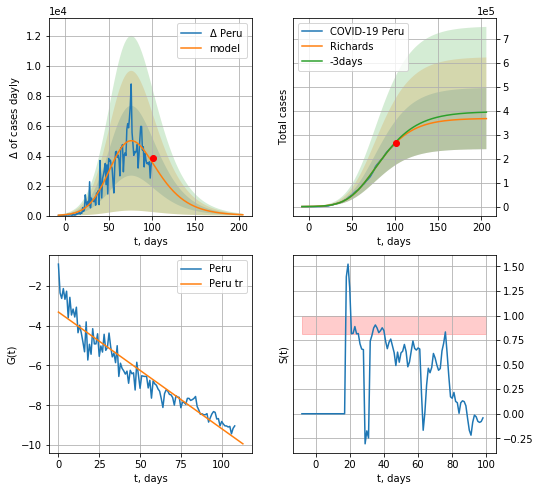

Peru data at: 2020-09-19
+3 day model MAPE: 0.011915
model: Richards
coeffs: [3.68474787e+05 1.13868989e-01 5.48653842e+01 3.85481107e-01]
rational stdev: 0.347400
forecast at the end of period: +105 days
	 deltaDaycases: 56
	 total cases: 367220 ± 127572
	 total death: 15100 ± 15737
trend coefficient of determination: 0.910589
 intercept: -3.314617
 slope: -0.058598


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


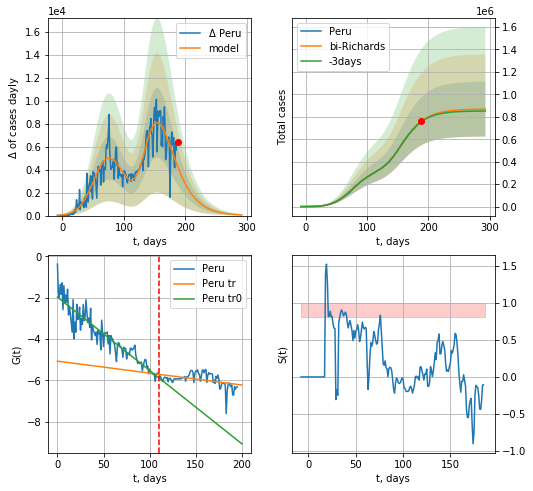

Peru data at: 2020-09-19
+3 day model MAPE: 0.004386
model: bi-Richards
coeffs: [5.01378900e+05 3.81285017e-01 1.06508593e+02 1.14394904e-01]
rational stdev: 0.281187
forecast at the end of period: +105 days
	 deltaDaycases: 58
	 total cases: 868542 ± 244223
	 total death: 35714 ± 30126
bi-Richards approximation splitting point: 110
trend coefficient of determination: 0.867940
 intercept: -1.974932
 slope: -0.035498
trend coefficient of determination: 0.192209
 intercept: -5.074135
 slope: -0.005766


In [2329]:
vL = 110
x = forecastRR("Peru",dfPU[:vL],d1,40*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Peru",dfPU[:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR("Peru",dfPU[:],d1,36*7-dT)

In [2330]:
#x = forecastRRR("Peru",dfPU[:].fillna(0),d1,62*7-dT,addpred=True,xcoef=koreaCoeffs)

ID
           date    cases     active    death
199 2020-09-15  5020359   995908.0  82091.0
200 2020-09-16  5118253  1009944.0  83230.0
201 2020-09-17  5214677  1017722.0  84404.0
202 2020-09-18  5308014  1013958.0  85625.0
203 2020-09-19  5405252  1015413.0  86796.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


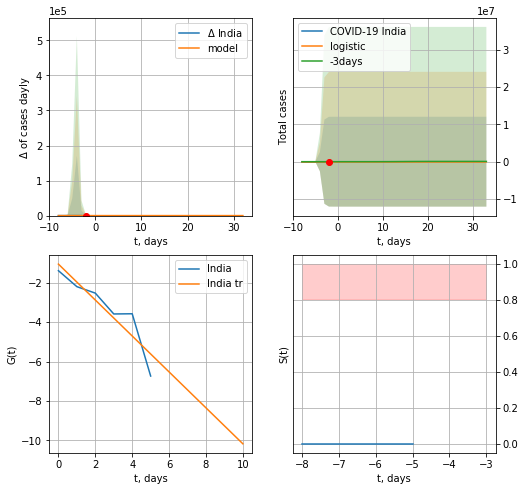

India data at: 2020-09-19
+3 day model MAPE: 0.19486002826260063
model: logistic
coeffs:  [29.4003363   4.01436821 -3.67575825]
rational stdev:  409417.6299021335
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  29 ± 12037016
	 total death:  0 ± 0
trend coefficient of determination: 0.835838
 intercept: -1.052904
 slope: -0.912220


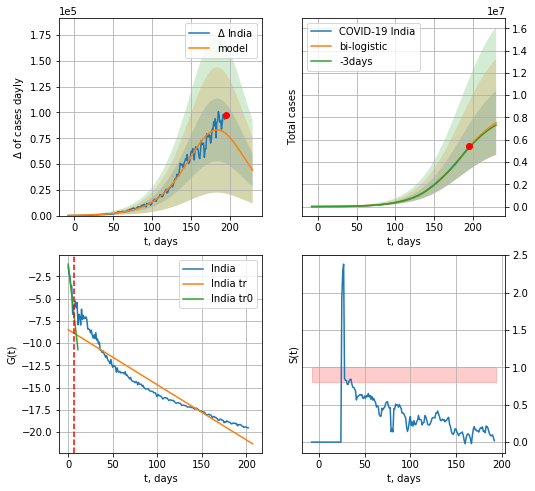

India data at: 2020-09-19
+3 day model MAPE: 0.010324949294336873
model: bi-logistic
coeffs:  [8.77259589e+06 3.77247507e-02 1.83644836e+02] [29.4003363   4.01436821 -3.67575825]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.381347312584981
forecast at the end of period: +35 days
	 deltaDaycases:  44085
	 total cases:  7520757 ± 2868020
	 total death:  120766 ± 138161
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.879788
 intercept: -1.115653
 slope: -0.874570
trend coefficient of determination: 0.905338
 intercept: -8.479864
 slope: -0.062074


In [2331]:
dfID = read_df(pd.DataFrame(),"ID")
dfID = dfID.fillna(0)
x = forecast("India",dfID[:7],d1,7*T18-dT)
xx = forecast2("India",dfID[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=7)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


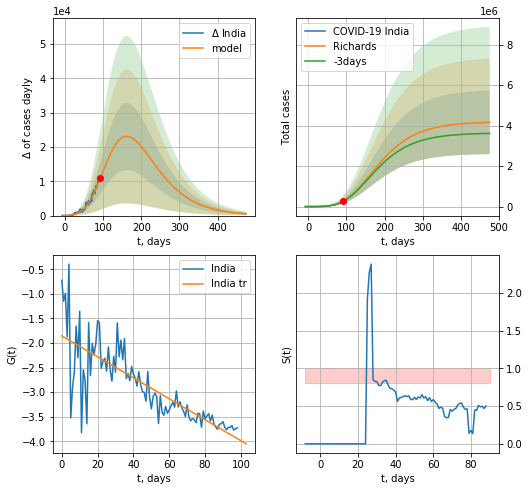

India data at: 2020-09-19
+3 day model MAPE: 0.006994
model: Richards
coeffs: [ 4.19766377e+06  3.32044249e-01 -3.85411502e+01  4.61089241e-02]
rational stdev: 0.377105
forecast at the end of period: +385 days
	 deltaDaycases: 527
	 total cases: 4163299 ± 1570001
	 total death: 66853 ± 75631
trend coefficient of determination: 0.633758
 intercept: -1.855387
 slope: -0.021306


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


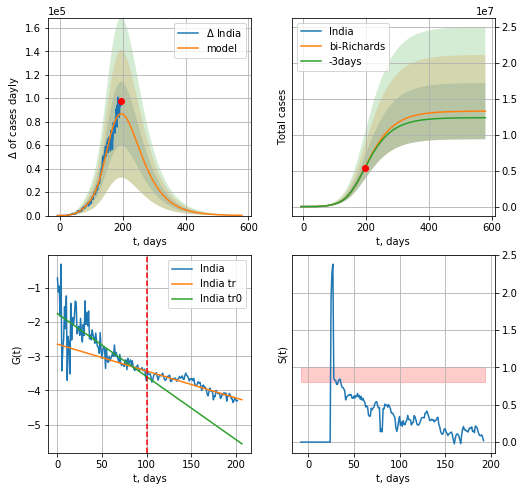

India data at: 2020-09-19
+3 day model MAPE: 0.007829
model: bi-Richards
coeffs: [ 9.08726919e+06  1.11803078e+00 -1.21057227e+00  1.78879893e-02]
rational stdev: 0.294236
forecast at the end of period: +385 days
	 deltaDaycases: 199
	 total cases: 13273371 ± 3905508
	 total death: 213140 ± 188140
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.574672
 intercept: -1.750761
 slope: -0.018411
trend coefficient of determination: 0.823467
 intercept: -2.645165
 slope: -0.007854


In [2332]:
vL = 100
x = forecastRR("India",dfID[:vL],d1,80*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("India",dfID[:],d1,80*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [2333]:
#x = forecastRRR("India",dfID[31:].fillna(0),d1,86*7-dT,addpred=True,xcoef=koreaCoeffs)

AG
           date     cases    active    death
195 2020-09-15  577338.0  126603.0  11852.0
196 2020-09-16  589012.0  128633.0  12116.0
197 2020-09-17  601713.0  132906.0  12460.0
198 2020-09-18  613658.0  133716.0  12656.0
199 2020-09-19  622934.0  132058.0  12799.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


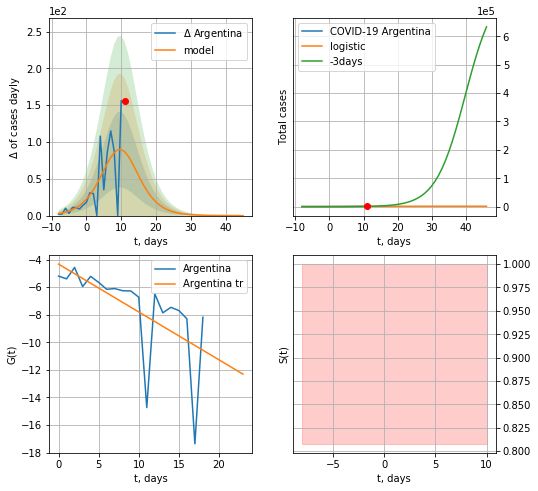

Argentina data at: 2020-09-19
+3 day model MAPE: 0.34277903234874524
model: logistic
coeffs:  [1.30607345e+03 2.75914265e-01 1.01155997e+01]
rational stdev:  0.27772613105407934
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  1306 ± 362
	 total death:  26 ± 21
trend coefficient of determination: 0.364190
 intercept: -4.325611
 slope: -0.347113


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


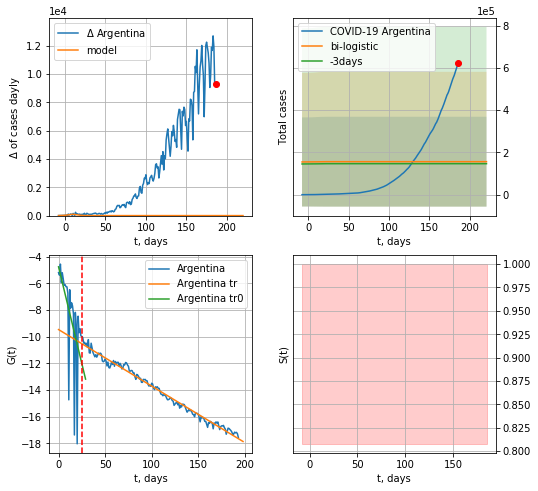

Argentina data at: 2020-09-19
+3 day model MAPE: 0.06493490265651362
model: bi-logistic
coeffs:  [ 1.23894645e+05 -1.04935454e+01  2.58853044e+02] [1.30607345e+03 2.75914265e-01 1.01155997e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.3616528481971317
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  156174 ± 212655
	 total death:  3208 ± 13104
bi-logistic approximation splitting point: 25
trend0 coefficient of determination: 0.360462
 intercept: -4.766843
 slope: -0.290012
trend coefficient of determination: 0.986513
 intercept: -9.467691
 slope: -0.042333


In [2334]:
vL = 25
#vL1 = 40
dfAG = read_df(pd.DataFrame(),"AG")
x = forecast('Argentina',dfAG[5:vL],d1,7*T18-dT,1.0)
xx = forecast2('Argentina',dfAG[5:],d1,T18*7-dT,x,1.0,vL=vL,addpred=True,xcoef=[.25,1.,2.0])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Argentina",dfAG[5:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

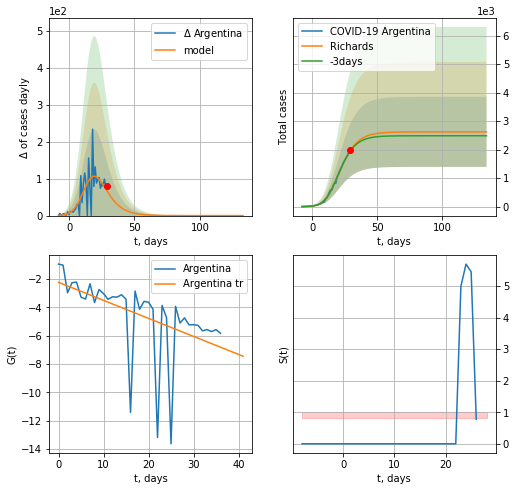

Argentina data at: 2020-09-19
+3 day model MAPE: 0.013138
model: Richards
coeffs: [2.62031767e+03 3.73237042e-01 1.15845098e+01 3.46306086e-01]
rational stdev: 0.468281
forecast at the end of period: +105 days
	 deltaDaycases: 0
	 total cases: 2620 ± 1227
	 total death: 53 ± 74
trend coefficient of determination: 0.244505
 intercept: -2.222432
 slope: -0.127357


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


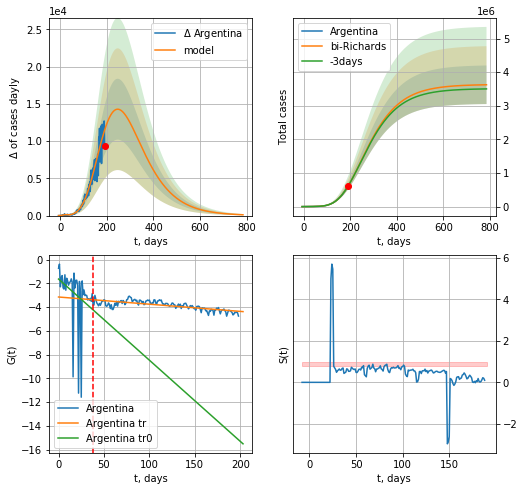

Argentina data at: 2020-09-19
+3 day model MAPE: 0.002613
model: bi-Richards
coeffs: [ 3.63289163e+06  2.67914351e-01 -4.69747428e+01  4.06936908e-02]
rational stdev: 0.158268
forecast at the end of period: +595 days
	 deltaDaycases: 111
	 total cases: 3625371 ± 573779
	 total death: 74488 ± 35367
bi-Richards approximation splitting point: 38
trend coefficient of determination: 0.092295
 intercept: -1.630860
 slope: -0.068395
trend coefficient of determination: 0.559689
 intercept: -3.144320
 slope: -0.006062


In [2335]:
vL = 38
x = forecastRR('Argentina',dfAG[:vL].fillna(0),d1,40*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Argentina',dfAG[:].fillna(0),d1,110*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [2336]:
#x = forecastRRR('Argentina',dfAG[10:],d1,104*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

In [2337]:
#vL=33
#x = forecastRRR('Qatar',dfQR[:vL].fillna(0),d1,7*T18-dT,1.0,addpred=False,xcoef=[.35,.5,4.0,1])
#xx = forecast2RRR('Qatar',dfQR[:].fillna(0),d1,38*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

QR
           date   cases  active  death
194 2020-09-15  122214  2862.0  208.0
195 2020-09-16  122449  2841.0  208.0
196 2020-09-17  122693  2872.0  208.0
197 2020-09-18  122917  2886.0  209.0
198 2020-09-19  123146  2863.0  210.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


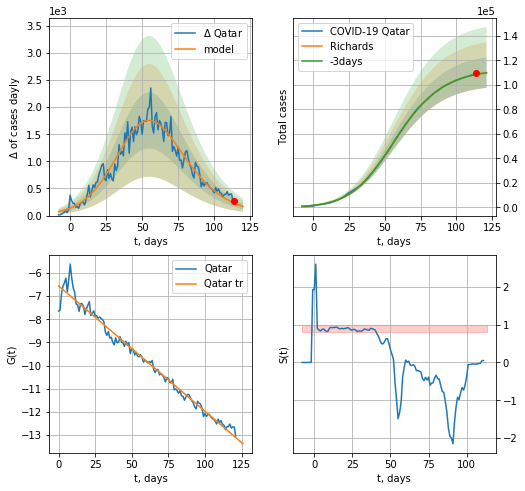

Qatar data at: 2020-09-19
+3 day model MAPE: 0.001883
model: Richards
coeffs: [1.13070089e+05 8.99170413e-02 4.60810469e+01 6.06536184e-01]
rational stdev: 0.112907
forecast at the end of period: +7 days
	 deltaDaycases: 167
	 total cases: 110005 ± 12420
	 total death: 187 ± 63
trend coefficient of determination: 0.979229
 intercept: -6.558422
 slope: -0.054146


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: RuntimeWarning: overflow encountered in power


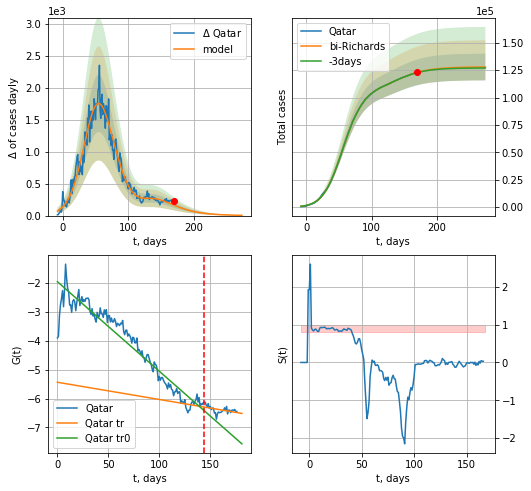

Qatar data at: 2020-09-19
+3 day model MAPE: 0.001592
model: bi-Richards
coeffs: [1.49403047e+04 2.92191455e+00 3.47655061e+01 1.33349108e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.095325
forecast at the end of period: +105 days
	 deltaDaycases: 3
	 total cases: 127909 ± 12192
	 total death: 217 ± 62
bi-Richards approximation splitting point: 144
trend coefficient of determination: 0.919203
 intercept: -1.963730
 slope: -0.030948
trend coefficient of determination: 0.221114
 intercept: -5.438219
 slope: -0.005951


In [2339]:
iL = 21
vL = 144 + iL
dfQR = read_df(pd.DataFrame(),"QR")
x = forecastRR('Qatar',dfQR[iL:vL-iL].fillna(0),d1,26*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Qatar',dfQR[iL:].fillna(0),d1,40*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-iL)

In [2340]:
#x = forecast('Qatar',dfQR[:],d1,18*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.0,1])

UAE
           date    cases  active  death
213 2020-09-15  80940.0    9904  401.0
214 2020-09-16  81782.0    9924  402.0
215 2020-09-17  82568.0   10049  402.0
216 2020-09-18  83433.0   10240  403.0
217 2020-09-19  84916.0   10239  404.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


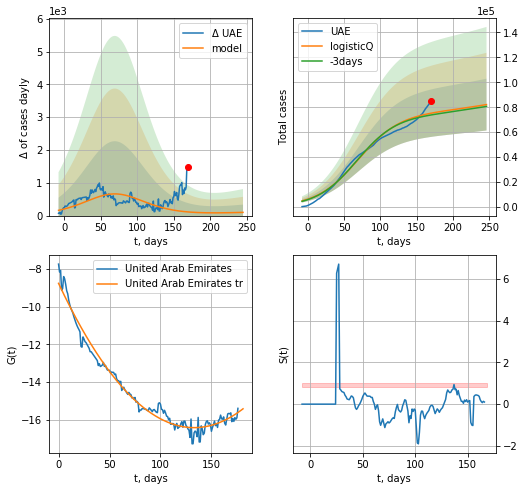

UAE data at: 2020-09-19
+3 day model MAPE: 0.019017
model: logisticQ
coeffs: [ 7.50066317e+04  6.45167087e-08  6.91949949e+01 -5.40600447e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.252723
forecast at the end of period: +77 days
	 deltaDaycases: 97
	 total cases: 82122 ± 20754
	 total death: 390 ± 295
trend coefficient of determination: 0.976739
 intercept_: -8.7535468038622
 coeffs_: [ 0.         -0.11536904  0.00043387]


In [2341]:
try:
    dfUAE = read_df(pd.DataFrame(),"UAE")
    x = forecastRRR('UAE',dfUAE[40:],d1,36*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


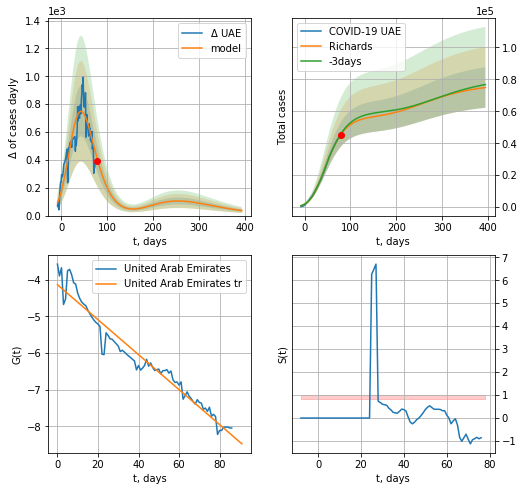

UAE data at: 2020-09-19
+3 day model MAPE: 0.009864
model: Richards
coeffs: [5.69575832e+04 1.33404785e-01 1.50634020e+01 3.08321872e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.168958
forecast at the end of period: +315 days
	 deltaDaycases: 35
	 total cases: 74870 ± 12649
	 total death: 356 ± 180
trend coefficient of determination: 0.950927
 intercept: -4.139656
 slope: -0.047646


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


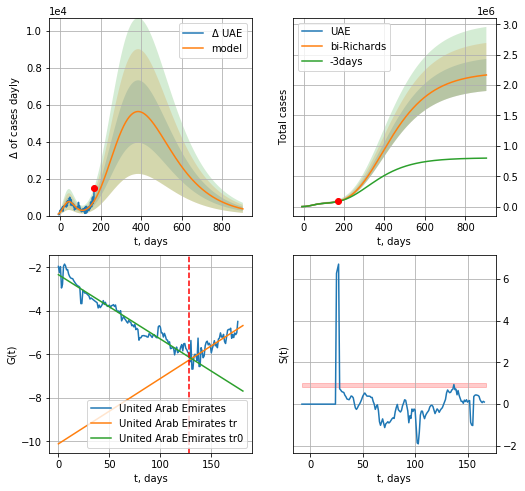

UAE data at: 2020-09-19
+3 day model MAPE: 0.011022
model: bi-Richards
coeffs: [ 2.16026954e+06  1.83484584e-01 -6.22145886e+01  3.93437905e-02]
rational stdev: 0.121677
forecast at the end of period: +735 days
	 deltaDaycases: 362
	 total cases: 2166523 ± 263616
	 total death: 10307 ± 3762
bi-Richards approximation splitting point: 128
trend coefficient of determination: 0.943969
 intercept: -2.343136
 slope: -0.029552
trend coefficient of determination: 0.672228
 intercept: -10.117264
 slope: 0.030026


In [2342]:
iL = 40
vL = 128 + iL
x = forecastRR('UAE',dfUAE[iL:vL-iL],d1,70*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR('UAE',dfUAE[iL:],d1,130*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastQR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [2343]:
#plt.plot(range(len(dfUAE[45:])-1),np.log(np.log(np.log(np.diff(dfUAE[45:].cases)))))

SA
           date     cases  active   death
196 2020-09-15  326930.0   17570  4338.0
197 2020-09-16  327551.0   17178  4369.0
198 2020-09-17  328144.0   16538  4399.0
199 2020-09-18  328720.0   15938  4430.0
200 2020-09-19  329271.0   15383  4458.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


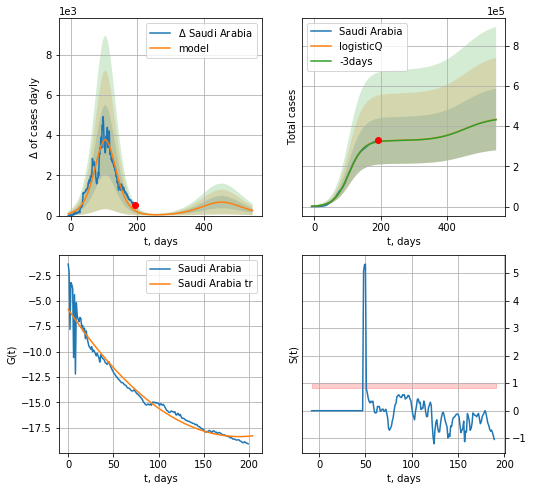

Saudi Arabia data at: 2020-09-19
+3 day model MAPE: 0.002364
model: logisticQ
coeffs: [ 3.28293337e+05  3.24967433e-07  1.04315840e+02 -1.41072335e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.354183
forecast at the end of period: +357 days
	 deltaDaycases: 247
	 total cases: 432715 ± 153260
	 total death: 5858 ± 6224
trend coefficient of determination: 0.949445
 intercept_: -5.839484274190864
 coeffs_: [ 0.         -0.13246878  0.00034968]


In [2344]:
dfSA = read_df(pd.DataFrame(),"SA")
x = forecastRRR('Saudi Arabia',dfSA[:],d1,76*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


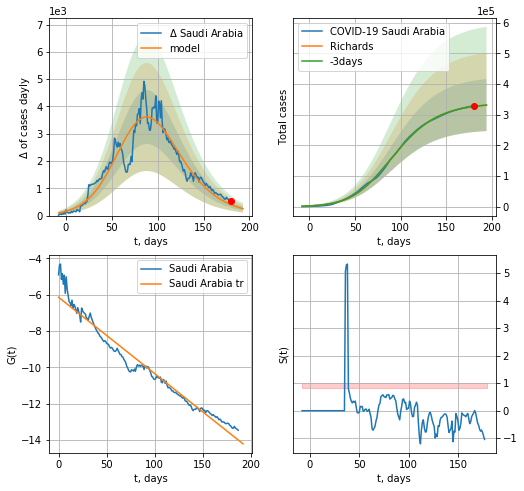

Saudi Arabia data at: 2020-09-19
+3 day model MAPE: 0.001271
model: Richards
coeffs: [3.38359332e+05 6.62041952e-02 7.25603138e+01 5.55976831e-01]
rational stdev: 0.256031
forecast at the end of period: +14 days
	 deltaDaycases: 252
	 total cases: 331502 ± 84874
	 total death: 4488 ± 3447
trend coefficient of determination: 0.960828
 intercept: -6.134462
 slope: -0.042043


In [2345]:
x = forecastRR('Saudi Arabia',dfSA[12:],d1,27*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Saudi Arabia',dfSA[12:],d1,27*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=75)
#x = forecastQR('Saudi Arabia',dfSA[12:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

Sri
           date   cases  active  death
189 2020-09-15  3271.0     242   13.0
190 2020-09-16  3271.5     237   13.0
191 2020-09-17  3276.0     220   13.0
192 2020-09-18  3281.0     208   13.0
193 2020-09-19  3283.0     200   13.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


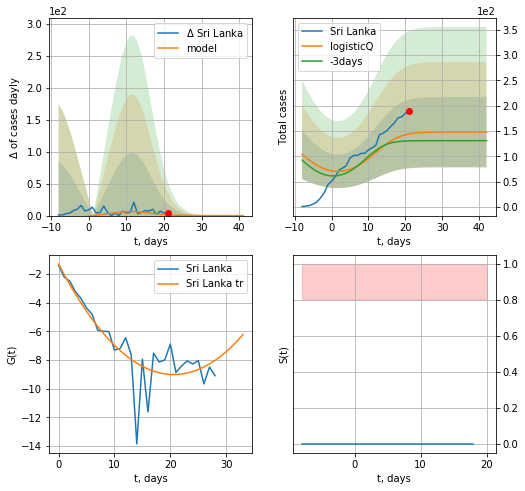

Sri Lanka data at: 2020-09-19
+3 day model MAPE: 0.111838
model: logisticQ
coeffs: [ 1.47873593e+02  1.02177717e-02  4.75700419e+00 -1.32326165e+00]
rational stdev: 0.468204
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 147 ± 69
	 total death: 0 ± 0
trend coefficient of determination: 0.737116
 intercept_: -1.300425972375204
 coeffs_: [ 0.         -0.74879164  0.01816974]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


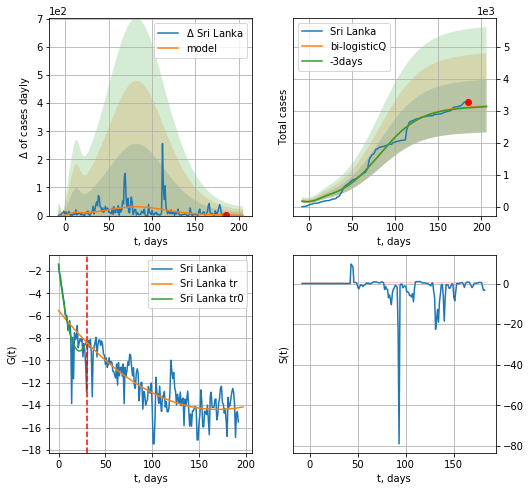

Sri Lanka data at: 2020-09-19
+3 day model MAPE: 0.006473
model: bi-logisticQ
coeffs: [ 2.97341166e+03  1.42752768e-07  8.23809322e+01 -2.96225996e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.262131
forecast at the end of period: +21 days
	 deltaDaycases: 1
	 total cases: 3144 ± 824
	 total death: 12 ± 9
bi-logisticQ approximation splitting point: 30
trend coefficient of determination: 0.725855
 intercept_: -1.5084890363019623
 coeffs_: [ 0.         -0.68634546  0.01540158]
trend coefficient of determination: 0.655723
 intercept_: -5.539543493972571
 coeffs_: [ 0.         -0.10409717  0.00030642]


In [2346]:
try:
    dfSri = read_df(pd.DataFrame(),"Sri")
    vL= 30
    x = forecastRRR('Sri Lanka',dfSri[:vL],d1,28*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
    xx = forecast2RRR('Sri Lanka',dfSri[:],d1,28*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)
except:
    print ("Exception occurs")

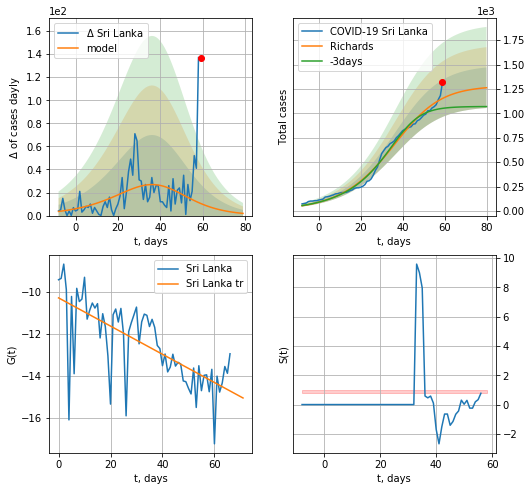

Sri Lanka data at: 2020-09-19
+3 day model MAPE: 0.103361
model: Richards
coeffs: [1.28171157e+03 6.47995832e-02 4.07030001e+01 1.48770145e+00]
rational stdev: 0.164364
forecast at the end of period: +21 days
	 deltaDaycases: 1
	 total cases: 1262 ± 207
	 total death: 4 ± 1
trend coefficient of determination: 0.481079
 intercept: -10.284657
 slope: -0.067327


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


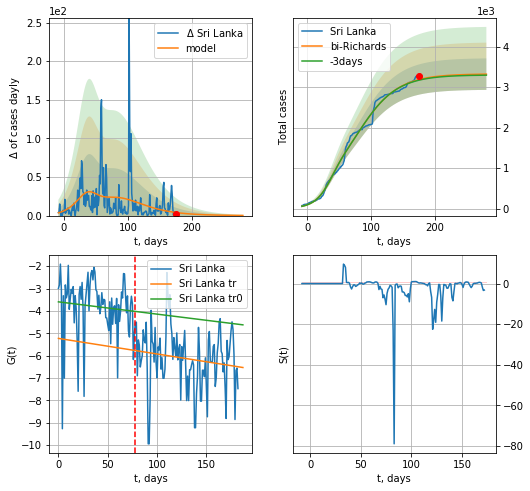

Sri Lanka data at: 2020-09-19
+3 day model MAPE: 0.004819
model: bi-Richards
coeffs: [ 2.04496043e+03  3.27879579e+00 -7.04914386e+01  9.12884742e-03]
rational stdev: 0.117150
forecast at the end of period: +105 days
	 deltaDaycases: 0
	 total cases: 3320 ± 388
	 total death: 13 ± 4
bi-Richards approximation splitting point: 78
trend coefficient of determination: 0.008545
 intercept: -3.596469
 slope: -0.005500
trend coefficient of determination: 0.024184
 intercept: -5.231645
 slope: -0.006964


In [2347]:
vL=88
x = forecastRR('Sri Lanka',dfSri[10:vL-10],d1,28*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Sri Lanka',dfSri[10:],d1,40*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10)
#x = forecastQR('Sri Lanka',dfSri[10:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

PS
           date     cases  active   death
201 2020-09-15  303089.0    5936  6393.0
202 2020-09-16  303634.0    6066  6399.0
203 2020-09-17  304386.0    6295  6408.0
204 2020-09-18  305031.0    6572  6415.0
205 2020-09-19  305671.0    6952  6416.0


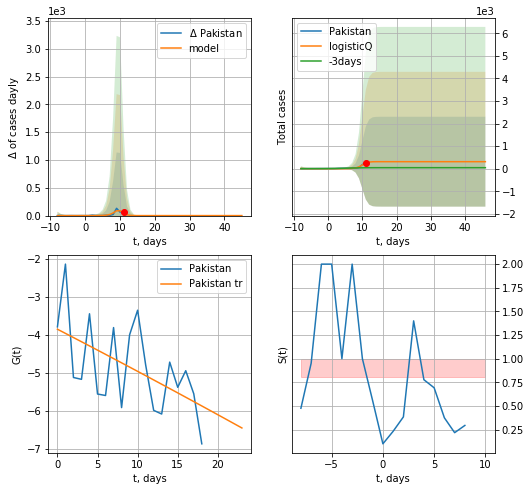

Pakistan data at: 2020-09-19
+3 day model MAPE: 5.954392
model: logisticQ
coeffs: [ 3.10300108e+02  5.80299149e-02  9.88962592e+00 -1.18245382e+01]
rational stdev: 6.420495
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 310 ± 1992
	 total death: 6 ± 115
trend coefficient of determination: 0.293073
 intercept_: -3.8498114630651457
 coeffs_: [ 0.         -0.10964083 -0.00016191]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


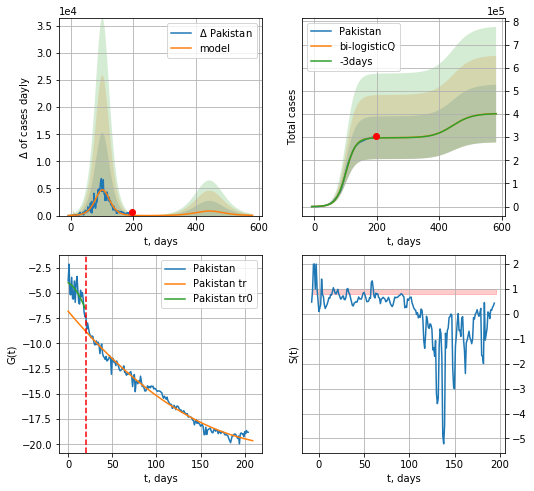

Pakistan data at: 2020-09-19
+3 day model MAPE: 0.002066
model: bi-logisticQ
coeffs: [ 2.97499910e+05  1.26639614e-06  1.01677220e+02 -5.03755449e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.310638
forecast at the end of period: +385 days
	 deltaDaycases: 38
	 total cases: 401969 ± 124867
	 total death: 8437 ± 7862
bi-logisticQ approximation splitting point: 20
trend coefficient of determination: 0.391568
 intercept_: -3.9808806978581046
 coeffs_: [ 0.         -0.04620278 -0.00453428]
trend coefficient of determination: 0.982254
 intercept_: -6.807766015096195
 coeffs_: [ 0.         -0.10402035  0.00020414]


In [2348]:
try:
    dfPS = read_df(pd.DataFrame(),"PS")
    vL= 20
    x = forecastRRR('Pakistan',dfPS[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
    xx = forecast2RRR('Pakistan',dfPS[:],d1,80*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


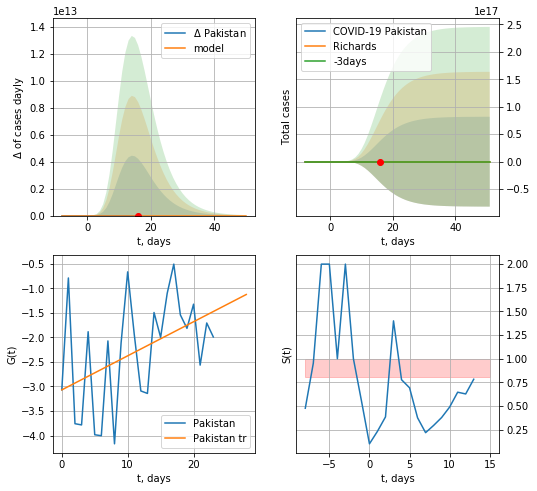

Pakistan data at: 2020-09-19
+3 day model MAPE: 0.118203
model: Richards
coeffs: [ 1.63838701e+03  6.06255652e+00 -3.11642699e+00  3.19416608e-02]
rational stdev: 49944222119087.820312
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 1636 ± 81755997018424080
	 total death: 34 ± 5094310656146958
trend coefficient of determination: 0.194578
 intercept: -3.069491
 slope: 0.069432


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


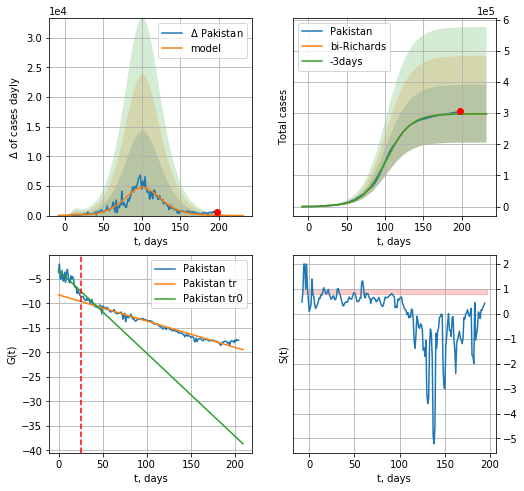

Pakistan data at: 2020-09-19
+3 day model MAPE: 0.002658
model: bi-Richards
coeffs: [2.96635207e+05 6.90198767e-02 9.95005854e+01 9.01321810e-01]
rational stdev: 0.310950
forecast at the end of period: +35 days
	 deltaDaycases: 5
	 total cases: 298187 ± 92721
	 total death: 6258 ± 5837
bi-Richards approximation splitting point: 25
trend coefficient of determination: 0.603657
 intercept: -3.255823
 slope: -0.169447
trend coefficient of determination: 0.962728
 intercept: -8.257030
 slope: -0.053690


In [2350]:
vL = 25
x = forecastRR('Pakistan',dfPS[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Pakistan',dfPS[:],d1,T18*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Pakistan',dfPS[:],d1,48*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

BN
           date     cases  active   death
191 2020-09-15  341056.0   90660  4802.0
192 2020-09-16  342671.0   89879  4823.0
193 2020-09-17  344264.0   88993  4859.0
194 2020-09-18  345805.0   88589  4881.0
195 2020-09-19  348918.0   87414  4939.0


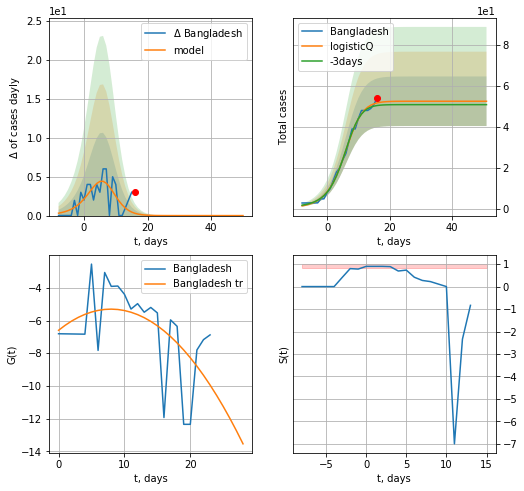

Bangladesh data at: 2020-09-19
+3 day model MAPE: 0.027574
model: logisticQ
coeffs: [ 5.24923910e+01  5.83606353e-03  5.49443194e+00 -5.18823422e+01]
rational stdev: 0.229682
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 52 ± 12
	 total death: 0 ± 0
trend coefficient of determination: 0.276192
 intercept_: -6.599187027141191
 coeffs_: [ 0.          0.32583568 -0.02049035]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


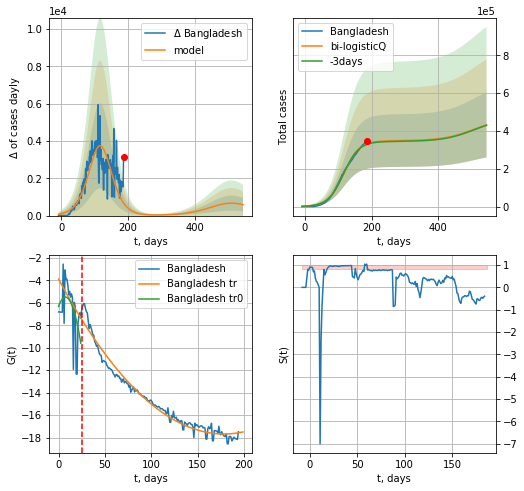

Bangladesh data at: 2020-09-19
+3 day model MAPE: 0.008513
model: bi-logisticQ
coeffs: [ 3.48600871e+05  1.65975648e-07  1.16728997e+02 -2.58718044e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.398941
forecast at the end of period: +357 days
	 deltaDaycases: 581
	 total cases: 432806 ± 172664
	 total death: 6126 ± 7331
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.232653
 intercept_: -6.325425729788838
 coeffs_: [ 0.          0.22449345 -0.0150245 ]
trend coefficient of determination: 0.972419
 intercept_: -3.886326209953591
 coeffs_: [ 0.         -0.15459389  0.00043316]


In [2351]:
dfBN = read_df(pd.DataFrame(),"BN")
vL= 25
try:
    x = forecastRRR('Bangladesh',dfBN[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
    xx = forecast2RRR('Bangladesh',dfBN[:],d1,76*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)
except:
    print ("Exception occurs")

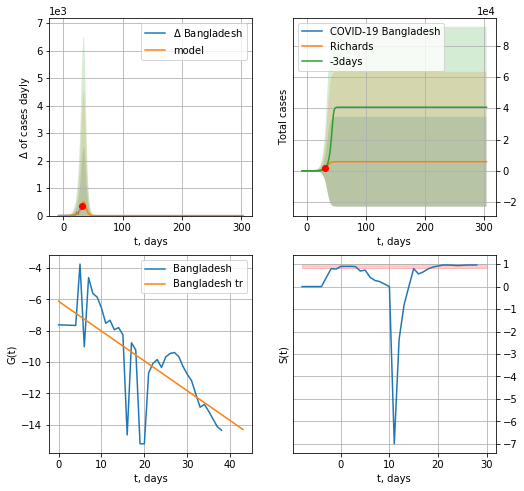

Bangladesh data at: 2020-09-19
+3 day model MAPE: 0.079004
model: Richards
coeffs: [5.83662075e+03 2.41285864e-01 3.62036516e+01 1.74331712e+00]
rational stdev: 4.915459
forecast at the end of period: +273 days
	 deltaDaycases: 0
	 total cases: 5836 ± 28689
	 total death: 82 ± 1209
trend coefficient of determination: 0.544590
 intercept: -6.123432
 slope: -0.190441


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


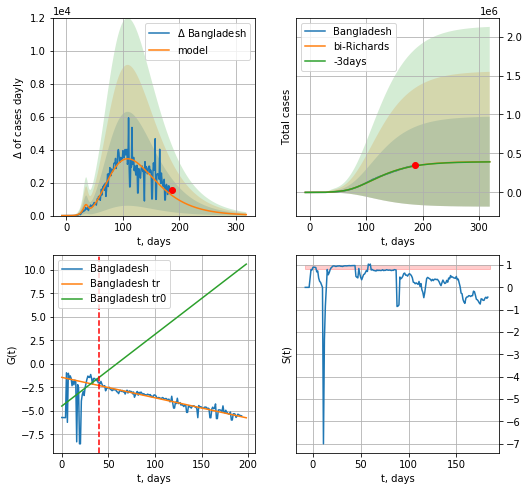

Bangladesh data at: 2020-09-19
+3 day model MAPE: 0.003246
model: bi-Richards
coeffs: [ 3.90891325e+05  2.27866500e+00 -7.98678075e+01  1.05798907e-02]
rational stdev: 1.462636
forecast at the end of period: +133 days
	 deltaDaycases: 59
	 total cases: 394272 ± 576677
	 total death: 5581 ± 24488
bi-Richards approximation splitting point: 40
trend coefficient of determination: 0.166905
 intercept: -4.500825
 slope: 0.076315
trend coefficient of determination: 0.922481
 intercept: -1.444002
 slope: -0.021731


In [2352]:
vL=40
x = forecastRR('Bangladesh',dfBN[:vL],d1,64*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bangladesh',dfBN[:-1],d1,44*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Bangladesh',dfBN[:],d1,16*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

KW
           date    cases  active  death
204 2020-09-15  96301.0    9514  568.0
205 2020-09-16  96999.0    9241  571.0
206 2020-09-17  97824.0    9338  575.0
207 2020-09-18  98528.0    9172  580.0
208 2020-09-19  99049.0    8970  581.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


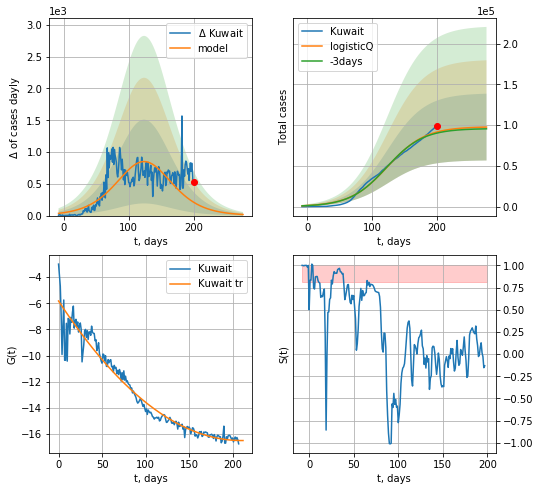

Kuwait data at: 2020-09-19
+3 day model MAPE: 0.015166
model: logisticQ
coeffs: [ 9.81080114e+04  8.01469601e-08  1.24104572e+02 -4.32367768e+05]
rational stdev: 0.419846
forecast at the end of period: +77 days
	 deltaDaycases: 17
	 total cases: 97621 ± 40986
	 total death: 572 ± 720
trend coefficient of determination: 0.946917
 intercept_: -5.824724852922781
 coeffs_: [ 0.         -0.10168638  0.00024212]


In [2353]:
try:
    dfKW = read_df(pd.DataFrame(),"KW")
    x = forecastRRR('Kuwait',dfKW[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


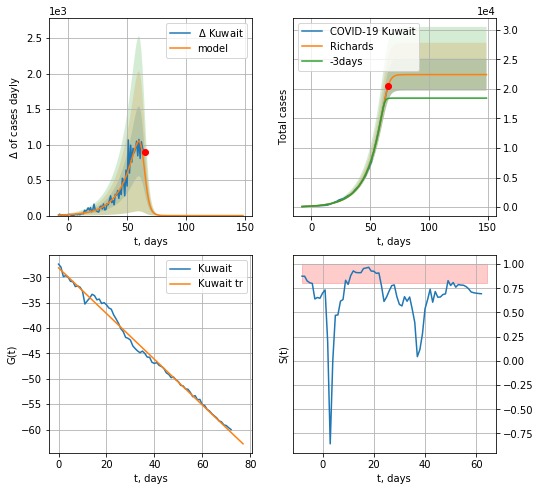

Kuwait data at: 2020-09-19
+3 day model MAPE: 0.136577
model: Richards
coeffs: [2.24365718e+04 7.66634183e-02 6.43548409e+01 5.72971780e+00]
rational stdev: 0.119998
forecast at the end of period: +84 days
	 deltaDaycases: 0
	 total cases: 22436 ± 2692
	 total death: 131 ± 47
trend coefficient of determination: 0.993036
 intercept: -28.143720
 slope: -0.450232


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


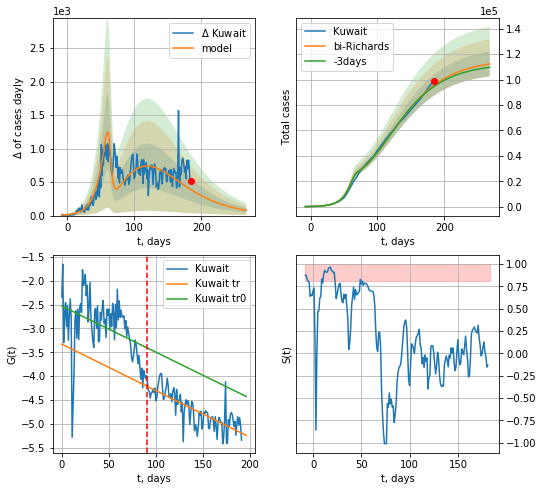

Kuwait data at: 2020-09-19
+3 day model MAPE: 0.010239
model: bi-Richards
coeffs: [ 9.35857817e+04  2.51759492e+00 -1.00335683e+02  8.58169458e-03]
rational stdev: 0.086522
forecast at the end of period: +84 days
	 deltaDaycases: 79
	 total cases: 112284 ± 9715
	 total death: 658 ± 170
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.165877
 intercept: -2.530003
 slope: -0.009685
trend coefficient of determination: 0.603710
 intercept: -3.328890
 slope: -0.009782


In [2354]:
iL= 16
vL = 90 + iL
x = forecastRR('Kuwait',dfKW[iL:vL-iL],d1,37*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Kuwait',dfKW[iL:],d1,37*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

DM
           date     cases  active   death
198 2020-09-15  104803.0   24418  1998.0
199 2020-09-16  105521.0   24621  2009.0
200 2020-09-17  106136.0   24751  2022.0
201 2020-09-18  106732.0   24519  2034.0
202 2020-09-19  107700.0   24836  2044.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


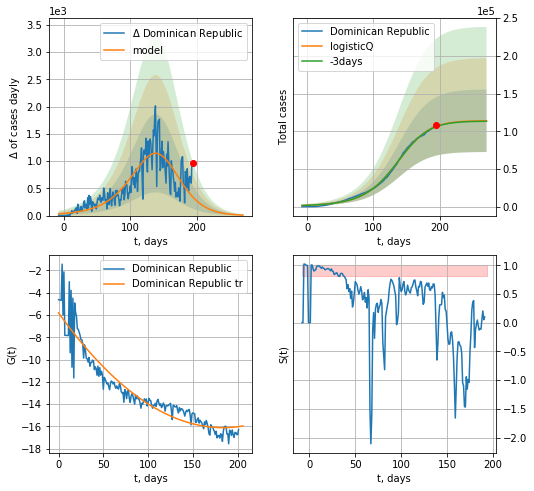

Dominican Republic data at: 2020-09-19
+3 day model MAPE: 0.003237
model: logisticQ
coeffs: [ 1.14101168e+05  6.49817868e-05  1.34674282e+02 -4.77508720e+02]
rational stdev: 0.364240
forecast at the end of period: +77 days
	 deltaDaycases: 8
	 total cases: 113950 ± 41505
	 total death: 2162 ± 2362
trend coefficient of determination: 0.893535
 intercept_: -5.808579239283693
 coeffs_: [ 0.         -0.1123992   0.00030614]


In [2355]:
try:
    dfDM = read_df(pd.DataFrame(),"DM")
    x = forecastRRR('Dominican Republic',dfDM[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


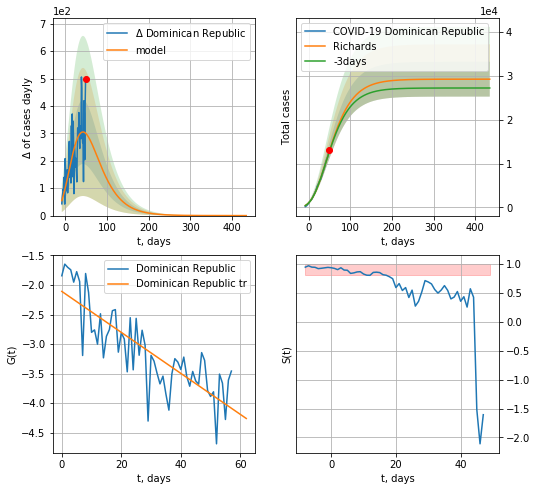

Dominican Republic data at: 2020-09-19
+3 day model MAPE: 0.011985
model: Richards
coeffs: [ 2.92636962e+04  1.52410692e+00 -9.56887865e+01  1.87798018e-02]
rational stdev: 0.135750
forecast at the end of period: +385 days
	 deltaDaycases: 0
	 total cases: 29263 ± 3972
	 total death: 555 ± 226
trend coefficient of determination: 0.671301
 intercept: -2.108314
 slope: -0.034707


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


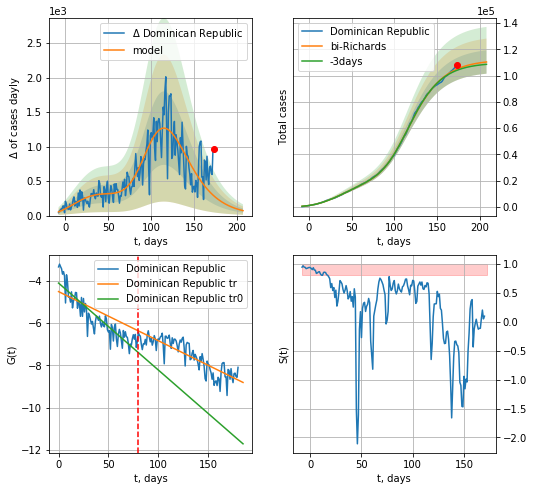

Dominican Republic data at: 2020-09-19
+3 day model MAPE: 0.009157
model: bi-Richards
coeffs: [8.27900438e+04 1.51280349e-01 8.86255864e+01 2.91703934e-01]
rational stdev: 0.080723
forecast at the end of period: +35 days
	 deltaDaycases: 72
	 total cases: 110346 ± 8907
	 total death: 2094 ± 507
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.814557
 intercept: -4.109475
 slope: -0.041062
trend coefficient of determination: 0.736365
 intercept: -4.512250
 slope: -0.023205


In [2356]:
vL = 80+21
x = forecastRR('Dominican Republic',dfDM[21:vL-21],d1,80*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Dominican Republic',dfDM[21:],d1,30*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-21)

MD
           date    cases  active   death
192 2020-09-15  43734.0   10298  1143.0
193 2020-09-16  44361.0   10470  1159.0
194 2020-09-17  44983.0   10574  1170.0
195 2020-09-18  45648.0   10728  1186.0
196 2020-09-19  46336.0   10899  1201.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


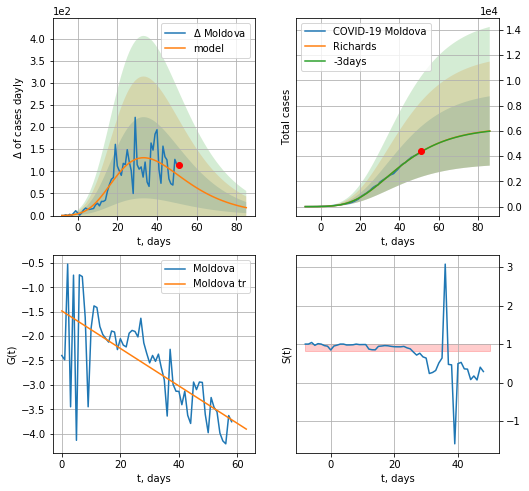

Moldova data at: 2020-09-19
+3 day model MAPE: 0.000798
model: Richards
coeffs: [ 6.30547519e+03  3.98861804e+00 -4.11482156e+01  1.42375767e-02]
rational stdev: 0.458356
forecast at the end of period: +35 days
	 deltaDaycases: 17
	 total cases: 5989 ± 2745
	 total death: 155 ± 213
trend coefficient of determination: 0.512178
 intercept: -1.485670
 slope: -0.038427


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


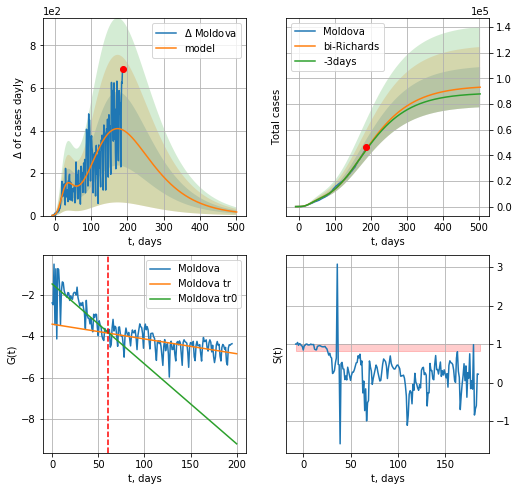

Moldova data at: 2020-09-19
+3 day model MAPE: 0.009475
model: bi-Richards
coeffs: [ 8.81814974e+04  8.60244929e-01 -1.58759873e+02  1.47561745e-02]
rational stdev: 0.168290
forecast at the end of period: +315 days
	 deltaDaycases: 16
	 total cases: 93153 ± 15676
	 total death: 2414 ± 1218
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.526699
 intercept: -1.485424
 slope: -0.038567
trend coefficient of determination: 0.310637
 intercept: -3.425666
 slope: -0.007126


In [2357]:
dfMD = read_df(pd.DataFrame(),"MD")
dfMD = dfMD.fillna(0)
try:
    vL = 60
    x = forecastRR("Moldova",dfMD[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Moldova",dfMD[:],d1,70*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

In [2358]:
#np.diff(dfAF["cases"])

AF
           date     cases  active    death
194 2020-09-15  651521.0   52754  15641.0
195 2020-09-16  653444.0   53544  15705.0
196 2020-09-17  655572.0   54497  15772.0
197 2020-09-18  657627.0   54926  15857.0
198 2020-09-19  659656.0   54282  15940.0


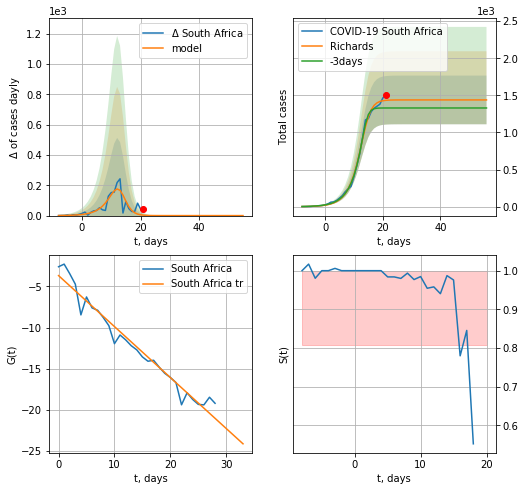

South Africa data at: 2020-09-19
+3 day model MAPE: 0.079443
model: Richards
coeffs: [1.43832006e+03 3.09188711e-01 1.37785511e+01 2.13840843e+00]
rational stdev: 0.227967
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 1438 ± 327
	 total death: 34 ± 23
trend coefficient of determination: 0.961533
 intercept: -3.675972
 slope: -0.619731


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


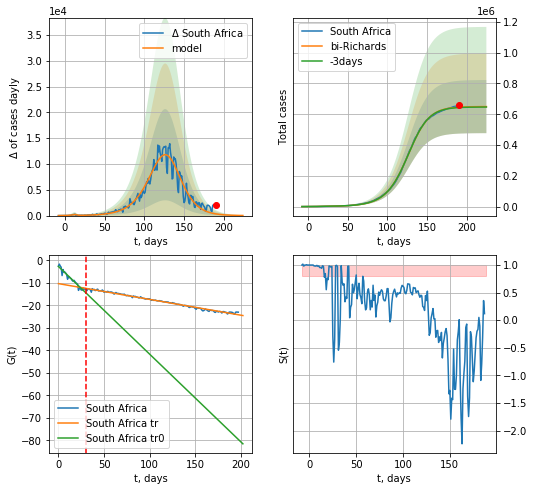

South Africa data at: 2020-09-19
+3 day model MAPE: 0.003876
model: bi-Richards
coeffs: [6.48556310e+05 6.14520589e-02 1.29913880e+02 1.28814490e+00]
rational stdev: 0.265574
forecast at the end of period: +35 days
	 deltaDaycases: 22
	 total cases: 649723 ± 172549
	 total death: 15699 ± 12507
bi-Richards approximation splitting point: 30
trend coefficient of determination: 0.935704
 intercept: -2.729360
 slope: -0.390155
trend coefficient of determination: 0.989325
 intercept: -10.357952
 slope: -0.070220


In [2359]:
dfAF = read_df(pd.DataFrame(),"AF").fillna(0)
#dfAF = dfAF.fillna(0)
try:
    vL = 30
    x = forecastRR("South Africa",dfAF[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("South Africa",dfAF[:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

UB
           date  cases  active  death
184 2020-09-15  48776    3313  405.0
185 2020-09-16  49385    3500  411.0
186 2020-09-17  49761    3254  415.0
187 2020-09-18  50253    3307  419.0
188 2020-09-19  51235    3535  429.0


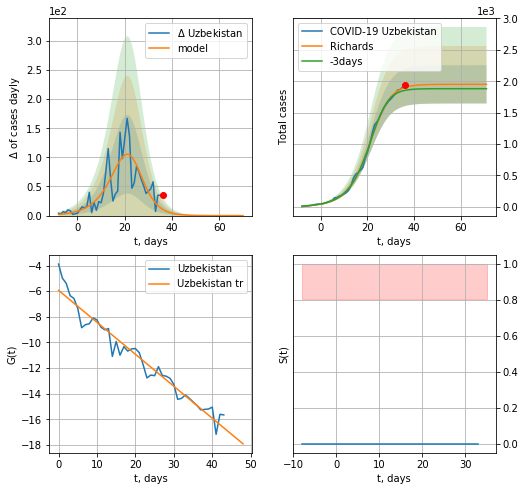

Uzbekistan data at: 2020-09-19
+3 day model MAPE: 0.027380
model: Richards
coeffs: [1.95086939e+03 1.63729535e-01 2.32758397e+01 1.53766466e+00]
rational stdev: 0.156222
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 1950 ± 304
	 total death: 16 ± 7
trend coefficient of determination: 0.953191
 intercept: -5.936816
 slope: -0.249439


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


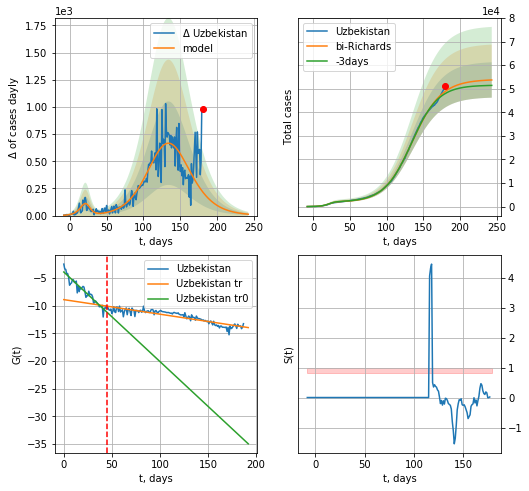

Uzbekistan data at: 2020-09-19
+3 day model MAPE: 0.019691
model: bi-Richards
coeffs: [5.20192173e+04 5.71881877e-02 1.31154229e+02 8.56722892e-01]
rational stdev: 0.139671
forecast at the end of period: +63 days
	 deltaDaycases: 12
	 total cases: 53718 ± 7502
	 total death: 449 ± 188
bi-Richards approximation splitting point: 45
trend coefficient of determination: 0.916837
 intercept: -3.900999
 slope: -0.161774
trend coefficient of determination: 0.814241
 intercept: -8.894362
 slope: -0.026319


In [2360]:
dfUB = read_df(pd.DataFrame(),"UB").fillna(0)
#dfAF = dfAF.fillna(0)
try:
    vL = 45
    x = forecastRR("Uzbekistan",dfUB[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Uzbekistan",dfUB[:],d1,34*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

In [ ]:
cD = {
    "Romania": ["RM",5,4*7],
    #"Finland":"FI",
    "India":["ID",5,6*7],
    "Ecuador":["ED",5,4*7],
    "Philippines":["PH",5,4*7],
    #"Pakistan":"PK",
#    "Luxembourg":"LX",
#    "Saudi Arabia":["SA",5,4*7],
    "Thailand":["TH",5,4*7],
    "Indonesia":["IE",5,16*7],
    "Mexico":["MX",5,8*7],
    "Panama":["PM",12,12*7],
    "Peru":["PU",5,4*7],
    "Serbia":["SB",5,4*7],
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":["UAE",5,8*7],
    "Argentina":["AG",5,8*7],
    "Iceland":["IC",5,4*7],
    "Colombia":["CB",10,16*7],
    "Qatar":["QR",5,6*7],
    "Algeria":["AR",5,16*7],
    "Croatia":["CT",0,12*7],
    "Egypt":["EG",5,4*7],
    "Slovenia":["SV",12,6*7],
    "Morocco":["MR",5,4*7],
    "Iraq":["IQ",2,8*7]
#    "Hong Kong":"HK"
}

dfArray = [dfRM,dfID,dfED,dfPH,dfTH,dfIE,dfMX,dfPM,dfPU,dfSB,dfAG,dfIC,dfCB,dfQR,dfAG,dfCT,dfEG,dfSV,dfMR,dfIQ]
for c,adf in zip(cD,dfArray):
    if c in ["Qatar","Peru","Argentina","Iraq","India","Philippines","Indonesia","Finland","Luxembourg","Ecuador","Thailand","Morocco","Romania","Iceland","Panama","Colombia","Mexico","Algeria", "Croatia","Slovenia","Egypt","Serbia"]:
        continue
    print (c)
    idS = cD[c][1]
    ipd = cD[c][2]
    x = forecast(c,adf[idS:],d1,ipd-dT)
    #xx = forecast2(c,adf[:],d1,ipd-dT,x)

In [1993]:
import requests
import lxml.html as lh
#url='https://www.worldometers.info/coronavirus/#countries'#Create a handle, page, to handle the contents of the website
url='https://www.worldometers.info/coronavirus/#nav-today'
page = requests.get(url)#Store the contents of the website under doc
doc = lh.fromstring(page.content)#Parse data that are stored between <tr>..</tr> of HTML
tr_elements = doc.xpath('//tr')
#Check the length of the first 12 rows
print ([len(T) for T in tr_elements[:12]])
tr_elements = doc.xpath('//tr')#Create empty list
col=[]
i=0#For each row, store each first element (header) and an empty list
for t in tr_elements[0]:
    i+=1
    name=t.text_content()
    print ('%d:"%s"'%(i,name))
    col.append((name,[]))
    
#Since out first row is the header, data is stored on the second row onwards
for j in range(1,len(tr_elements)):
    #T is our j'th row
    T=tr_elements[j]
    #print (len(T))
    #If row is not of size 10, the //tr data is not from our table 
    if len(T)!=19:
        break
    
    #i is the index of our column
    i=0
    
    #Iterate through each element of the row
    for t in T.iterchildren():
        data=t.text_content() 
        #Check if row is empty
        if i>0:
        #Convert any numerical value to integers
            try:
                data=int(data)
            except:
                pass
        #Append the data to the empty list of the i'th column
        col[i][1].append(data)
        #Increment i for the next column
        i+=1
    
print ([len(C) for (title,C) in col])
Dict={title:column for (title,column) in col}
df=pd.DataFrame(Dict)

[19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19]
1:"#"
2:"Country,Other"
3:"TotalCases"
4:"NewCases"
5:"TotalDeaths"
6:"NewDeaths"
7:"TotalRecovered"
8:"NewRecovered"
9:"ActiveCases"
10:"Serious,Critical"
11:"Tot Cases/1M pop"
12:"Deaths/1M pop"
13:"TotalTests"
14:"Tests/
1M pop
"
15:"Population"
16:"Continent"
17:"1 Caseevery X ppl"
18:"1 Deathevery X ppl"
19:"1 Testevery X ppl"
[695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695]


In [1994]:
df.head(10)
#df.columns[18]

,#,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",Tot Cases/1M pop,Deaths/1M pop,TotalTests,Tests/\n1M pop\n,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,"8,309,552","+7,366","298,209",498,"5,171,211","+5,301","2,840,132","17,745",,,,,,North America,\n,,
1,,\nAsia\n,"9,373,052","+24,549","175,839",452,"7,662,188","+33,219","1,535,025","19,663",,,,,,Asia,\n,,
2,,\nSouth America\n,"7,490,758",419,"237,143",36,"6,227,260",575,"1,026,355","15,475",,,,,,South America,\n,,
3,,\nEurope\n,"4,413,290","+14,958","216,084",191,"2,380,679","+5,738","1,816,527","7,040",,,,,,Europe,\n,,
4,,\nAfrica\n,"1,406,759",786,"33,900",21,"1,153,747",108,"219,112","1,455",,,,,,Africa,\n,,
5,,\nOceania\n,"30,558",17,884,5,"27,093",100,"2,581",18,,,,,,Australia/Oceania,\n,,
6,,\n\n,721,,15,,651,,55,4,,,,,,,\n,,
7,,World,"31,024,690","+48,095","962,074","+1,203","22,622,829","+45,041","7,439,787","61,400","3,980",123.4,,,,All,\n,,
8,1,USA,"6,968,918","+1,515","203,844",20,"4,223,918",225,"2,541,156","14,084","21,027",615,"97,312,965","293,615","331,431,037",North America,48,"1,626",3
9,2,India,"5,405,252","+7,022","86,796",22,"4,303,043","+3,319","1,015,413","8,944","3,908",63,"63,661,060","46,032","1,382,974,770",Asia,256,"15,934",22


In [1995]:
#df.rename(columns={"Country,Other":"Country",df.columns[9]:"TotDeathsper1Mpop"})
df=df.rename(columns={"Country,Other":"Country",'Deaths/1M pop':"Deathsper1Mpop","Serious,Critical":"Serious_Critical",'Tests/\n1M pop\n':"Testsper1Mpop",'Tot\xa0Cases/1M pop':"TotCasesper1Mpop"})
df.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,"8,309,552","+7,366","298,209",498,"5,171,211","+5,301","2,840,132","17,745",,,,,,North America,\n,,
1,,\nAsia\n,"9,373,052","+24,549","175,839",452,"7,662,188","+33,219","1,535,025","19,663",,,,,,Asia,\n,,
2,,\nSouth America\n,"7,490,758",419,"237,143",36,"6,227,260",575,"1,026,355","15,475",,,,,,South America,\n,,
3,,\nEurope\n,"4,413,290","+14,958","216,084",191,"2,380,679","+5,738","1,816,527","7,040",,,,,,Europe,\n,,
4,,\nAfrica\n,"1,406,759",786,"33,900",21,"1,153,747",108,"219,112","1,455",,,,,,Africa,\n,,


In [1996]:
df[df["Country"]=="Lithuania"]

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
135,128,Lithuania,"3,744",80,87,,"2,198",1,"1,459",,"1,380",32,"725,127","267,221","2,713,589",Europe,725,"31,191",4
368,129,Lithuania,"3,664",99,87,,"2,197",16,"1,380",,"1,350",32,"722,897","266,399","2,713,589",Europe,741,"31,191",4
600,129,Lithuania,"3,565",61,87,,"2,181",32,"1,297",,"1,314",32,"716,972","264,215","2,713,589",Europe,761,"31,191",4


In [1997]:
totIdx = np.where(df['ActiveCases']=='ActiveCases')[0][0]
print(totIdx)

231


In [1998]:
df.head(55)

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,"8,309,552","+7,366","298,209",498,"5,171,211","+5,301","2,840,132","17,745",,,,,,North America,\n,,
1,,\nAsia\n,"9,373,052","+24,549","175,839",452,"7,662,188","+33,219","1,535,025","19,663",,,,,,Asia,\n,,
2,,\nSouth America\n,"7,490,758",419,"237,143",36,"6,227,260",575,"1,026,355","15,475",,,,,,South America,\n,,
3,,\nEurope\n,"4,413,290","+14,958","216,084",191,"2,380,679","+5,738","1,816,527","7,040",,,,,,Europe,\n,,
4,,\nAfrica\n,"1,406,759",786,"33,900",21,"1,153,747",108,"219,112","1,455",,,,,,Africa,\n,,
5,,\nOceania\n,"30,558",17,884,5,"27,093",100,"2,581",18,,,,,,Australia/Oceania,\n,,
6,,\n\n,721,,15,,651,,55,4,,,,,,,\n,,
7,,World,"31,024,690","+48,095","962,074","+1,203","22,622,829","+45,041","7,439,787","61,400","3,980",123.4,,,,All,\n,,
8,1,USA,"6,968,918","+1,515","203,844",20,"4,223,918",225,"2,541,156","14,084","21,027",615,"97,312,965","293,615","331,431,037",North America,48,"1,626",3
9,2,India,"5,405,252","+7,022","86,796",22,"4,303,043","+3,319","1,015,413","8,944","3,908",63,"63,661,060","46,032","1,382,974,770",Asia,256,"15,934",22


In [1999]:
df.at[21, 'TotalRecovered'] = 0
df.at[16, 'TotalRecovered'] = 0
df.at[46, 'TotalRecovered'] = 0
df.at[47, 'TotalRecovered'] = 0
#df.at[109, 'TotalRecovered'] = 0
df.at[21,"ActiveCases"] = 0
df.at[16,"ActiveCases"] = 0
df.at[46,"ActiveCases"] = 0
df.at[47,"ActiveCases"] = 0
#df.at[109,"ActiveCases"] = 0
#df.at[12, 'TotalRecovered'] = 0
df = df.fillna(0)

In [2000]:
import lxml
def sanitize(data):
    #print (type(data))
    if type(data) == lxml.etree._ElementUnicodeResult:
        data=str(data).strip()
    if str(data).find(',') != -1:
        data = data.replace(',','')
    #print(str(data).find(',') != -1)
    return data
df=df[df.index<totIdx-1]
df["ActiveCases"] = pd.to_numeric(df["ActiveCases"].apply(sanitize))
df["Deathsper1Mpop"] = pd.to_numeric(df["Deathsper1Mpop"].apply(sanitize))
df["NewCases"] = pd.to_numeric(df["NewCases"].apply(sanitize))
df["NewDeaths"] = pd.to_numeric(df["NewDeaths"].apply(sanitize))
df["Serious_Critical"] = pd.to_numeric(df["Serious_Critical"].apply(sanitize))
df["TotalCases"] = pd.to_numeric(df["TotalCases"].apply(sanitize))
df["TotalDeaths"] = pd.to_numeric(df["TotalDeaths"].apply(sanitize))
df["TotalRecovered"] = pd.to_numeric(df["TotalRecovered"].apply(sanitize))
df["TotCasesper1Mpop"] = pd.to_numeric(df["TotCasesper1Mpop"].apply(sanitize))
df["TotalTests"] = pd.to_numeric(df["TotalTests"].apply(sanitize))
df["Testsper1Mpop"] = pd.to_numeric(df["Testsper1Mpop"].apply(sanitize))
df.head(15)

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,8309552,7366.0,298209.0,498.0,5171211.0,"+5,301",2840132,17745.0,NaN,NaN,NaN,NaN,,North America,\n,,
1,,\nAsia\n,9373052,24549.0,175839.0,452.0,7662188.0,"+33,219",1535025,19663.0,NaN,NaN,NaN,NaN,,Asia,\n,,
2,,\nSouth America\n,7490758,419.0,237143.0,36.0,6227260.0,575,1026355,15475.0,NaN,NaN,NaN,NaN,,South America,\n,,
3,,\nEurope\n,4413290,14958.0,216084.0,191.0,2380679.0,"+5,738",1816527,7040.0,NaN,NaN,NaN,NaN,,Europe,\n,,
4,,\nAfrica\n,1406759,786.0,33900.0,21.0,1153747.0,108,219112,1455.0,NaN,NaN,NaN,NaN,,Africa,\n,,
5,,\nOceania\n,30558,17.0,884.0,5.0,27093.0,100,2581,18.0,NaN,NaN,NaN,NaN,,Australia/Oceania,\n,,
6,,\n\n,721,NaN,15.0,NaN,651.0,,55,4.0,NaN,NaN,NaN,NaN,,,\n,,
7,,World,31024690,48095.0,962074.0,1203.0,22622829.0,"+45,041",7439787,61400.0,3980.0,123.4,NaN,NaN,,All,\n,,
8,1,USA,6968918,1515.0,203844.0,20.0,4223918.0,225,2541156,14084.0,21027.0,615.0,97312965.0,293615.0,"331,431,037",North America,48,"1,626",3
9,2,India,5405252,7022.0,86796.0,22.0,4303043.0,"+3,319",1015413,8944.0,3908.0,63.0,63661060.0,46032.0,"1,382,974,770",Asia,256,"15,934",22


In [2001]:
cLst = countriesEU
ActiveCasesEU = sum([ w for w in df[df['Country'].isin(cLst)].ActiveCases if w>0])
CountryEU = "European Union" 
Deathsper1MpopEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])/445.250514
NewCasesEU = sum([w for w in df[df['Country'].isin(cLst)].NewCases if w>0 ])
NewDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].NewDeaths if w>0])
Serious_CriticalEU = sum([w for w in df[df['Country'].isin(cLst)].Serious_Critical if w>0])
Testsper1MpopEU = sum([ w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])/445.250514
TotalCasesEu = sum([w for w in df[df['Country'].isin(cLst)].TotalCases if w>0])
TotalDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])
TotalRecoveredEU = sum([w for w in df[df['Country'].isin(cLst)].TotalRecovered if w>0] )
TotalTestsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])
TotCasesper1MpopEU = TotalCasesEu/445.250514

rowEU = {"ActiveCases":ActiveCasesEU,"Continent":"Europe","Country": CountryEU,"Deathsper1Mpop": Deathsper1MpopEU,"NewCases": NewCasesEU,"NewDeaths": NewDeathsEU,"Serious_Critical": Serious_CriticalEU,"Testsper1Mpop": Testsper1MpopEU,"TotalCases": TotalCasesEu,"TotalDeaths": TotalDeathsEU,"TotalRecovered": TotalRecoveredEU,"TotalTests": TotalTestsEU,"TotCasesper1Mpop": TotCasesper1MpopEU }
df = df.append(rowEU, ignore_index=True)
df.tail()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
226,,Total:,4413290,14958.0,216084.0,191.0,2380679.0,"+5,738",1816527,7040.0,NaN,NaN,NaN,NaN,,Europe,,,
227,,Total:,1406759,786.0,33900.0,21.0,1153747.0,108,219112,1455.0,NaN,NaN,NaN,NaN,,Africa,,,
228,,Total:,30558,17.0,884.0,5.0,27093.0,100,2581,18.0,NaN,NaN,NaN,NaN,,Australia/Oceania,,,
229,,Total:,721,NaN,15.0,NaN,651.0,,55,4.0,NaN,NaN,NaN,NaN,,,,,
230,NaN,European Union,2459883,5633.0,144220.0,66.0,935949.0,NaN,582844,3797.0,5524.716811,323.907543,73150810.0,164291.354417,NaN,Europe,NaN,NaN,NaN


In [2002]:
#df['Reported1st case'] = df['Reported1st case'].map(lambda x: x.lstrip('\n'))
df["Country"] = df["Country"].str.strip('\n')
df.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,North America,8309552,7366.0,298209.0,498.0,5171211.0,"+5,301",2840132,17745.0,NaN,NaN,NaN,NaN,,North America,\n,,
1,,Asia,9373052,24549.0,175839.0,452.0,7662188.0,"+33,219",1535025,19663.0,NaN,NaN,NaN,NaN,,Asia,\n,,
2,,South America,7490758,419.0,237143.0,36.0,6227260.0,575,1026355,15475.0,NaN,NaN,NaN,NaN,,South America,\n,,
3,,Europe,4413290,14958.0,216084.0,191.0,2380679.0,"+5,738",1816527,7040.0,NaN,NaN,NaN,NaN,,Europe,\n,,
4,,Africa,1406759,786.0,33900.0,21.0,1153747.0,108,219112,1455.0,NaN,NaN,NaN,NaN,,Africa,\n,,


In [2003]:
#totIdx0 = np.where(df['Country']=='Total:')[0][0]
#df.at[totIdx0,'Country'] = 'World'

In [2004]:
#df

In [2005]:
#df[df['Country'].isnull()]
#df['Country']=df['Country'].dropna()
##for idx in df['Country'].isnull():
##    #print(idx)
##    if idx == True:
##        ind = df[df['Country'].isnull()].index[0]
##        df = df.drop(df.index[ind])
df = df.drop(df.index[6])
df.head(10)

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,North America,8309552,7366.0,298209.0,498.0,5171211.0,"+5,301",2840132,17745.0,NaN,NaN,NaN,NaN,,North America,\n,,
1,,Asia,9373052,24549.0,175839.0,452.0,7662188.0,"+33,219",1535025,19663.0,NaN,NaN,NaN,NaN,,Asia,\n,,
2,,South America,7490758,419.0,237143.0,36.0,6227260.0,575,1026355,15475.0,NaN,NaN,NaN,NaN,,South America,\n,,
3,,Europe,4413290,14958.0,216084.0,191.0,2380679.0,"+5,738",1816527,7040.0,NaN,NaN,NaN,NaN,,Europe,\n,,
4,,Africa,1406759,786.0,33900.0,21.0,1153747.0,108,219112,1455.0,NaN,NaN,NaN,NaN,,Africa,\n,,
5,,Oceania,30558,17.0,884.0,5.0,27093.0,100,2581,18.0,NaN,NaN,NaN,NaN,,Australia/Oceania,\n,,
7,,World,31024690,48095.0,962074.0,1203.0,22622829.0,"+45,041",7439787,61400.0,3980.0,123.4,NaN,NaN,,All,\n,,
8,1,USA,6968918,1515.0,203844.0,20.0,4223918.0,225,2541156,14084.0,21027.0,615.0,97312965.0,293615.0,"331,431,037",North America,48,"1,626",3
9,2,India,5405252,7022.0,86796.0,22.0,4303043.0,"+3,319",1015413,8944.0,3908.0,63.0,63661060.0,46032.0,"1,382,974,770",Asia,256,"15,934",22
10,3,Brazil,4528347,NaN,136565.0,NaN,3820095.0,,571687,8318.0,21271.0,641.0,15011116.0,70510.0,"212,892,060",South America,47,"1,559",14


In [2006]:
df.to_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)), index=False)

In [2007]:
countryDic = {
  "USA": "US",
"Italy":"IT",
"Spain":"SP",
"Germany":"GR",
"France":"FR",
"Iran":"IN",
"UK":"GB",
"Switzerland":"SZ",
"S. Korea":"KR",
"Norway":"NG",
"Sweden":"SW",
"Israel":"IS",
"Denmark":"DK",
"Poland":"PL",
"Estonia":"ES",
"Ukraine":"Ukr",
"Latvia":"LV",
    "Lithuania":"LT",
    "China":"CN",
    "USA":"US",
    "Russia":"RS",
    "Japan":"JP",
    "Netherlands":"NL",
    "Belgium":"BG",
    "Singapore":"SG",
    "Austria":"AT",
    "Turkey":"TR",
    "Canada":"CA",
    "Portugal":"PT",
    "World":"World",
    "Australia":"AS",
    "Brazil":"BZ",
    "Malaysia":"ML",
    "New Zealand":"ZL",
    "Belarus":"BR",
    "Ireland":"IR",
    "Chile":"CL",
    "Czechia":"CH",
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
#    "Pakistan":"PK",
    "Luxembourg":"LX",
    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
    "South Africa":"AF",
    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "European Union":"EU",
    "Bulgaria":"BL",
    "Hungary":"HG",
    "Malta":"MT",
    "Slovakia":"SL",
    "Cyprus":"CP",
    "Greece":"GC",
    "Dominican Republic":"DM",
    "Kuwait":"KW",
    "Bangladesh":"BN",
    "Sri Lanka":"Sri",
    "Pakistan":"PS",
    "Moldova":"MD",
    "Uzbekistan":"UB"
#    "Hong Kong":"HK"
}
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)

for c in countryDic:
    print (c,countryDic[c])

USA US
Italy IT
Spain SP
Germany GR
France FR
Iran IN
UK GB
Switzerland SZ
S. Korea KR
Norway NG
Sweden SW
Israel IS
Denmark DK
Poland PL
Estonia ES
Ukraine Ukr
Latvia LV
Lithuania LT
China CN
Russia RS
Japan JP
Netherlands NL
Belgium BG
Singapore SG
Austria AT
Turkey TR
Canada CA
Portugal PT
World World
Australia AS
Brazil BZ
Malaysia ML
New Zealand ZL
Belarus BR
Ireland IR
Chile CL
Czechia CH
Romania RM
Finland FI
India ID
Ecuador ED
Philippines PH
Luxembourg LX
Saudi Arabia SA
Thailand TH
Indonesia IE
Mexico MX
Panama PM
Peru PU
Serbia SB
South Africa AF
UAE UAE
Argentina AG
Iceland IC
Colombia CB
Qatar QR
Algeria AR
Croatia CT
Egypt EG
Slovenia SV
Morocco MR
Iraq IQ
European Union EU
Bulgaria BL
Hungary HG
Malta MT
Slovakia SL
Cyprus CP
Greece GC
Dominican Republic DM
Kuwait KW
Bangladesh BN
Sri Lanka Sri
Pakistan PS
Moldova MD
Uzbekistan UB


In [2008]:
len(countryDic)

76

In [2009]:
df = pd.read_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)),',')
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)
from datetime import date, timedelta
for c in df.Country: 
    print (c)
    #if c in ['North America','South America','Asia','Europe','Africa','Oceania','World']:
    #    continue
    f = open("data/tmp/corona%sOneRaw.csv"%(c),'w')
    #print ("corona%sOneRaw.csv"%(c),date.today()- timedelta(days=1),c,df[df.Country == c].TotalCases.values[0])
    print(c)
    if c!='World':
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    else:
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    f.close()

North America
North America
North America 2020-09-19,8309552,2840132,298209.0
Asia
Asia
Asia 2020-09-19,9373052,1535025,175839.0
South America
South America
South America 2020-09-19,7490758,1026355,237143.0
Europe
Europe
Europe 2020-09-19,4413290,1816527,216084.0
Africa
Africa
Africa 2020-09-19,1406759,219112,33900.0
Oceania
Oceania
Oceania 2020-09-19,30558,2581,884.0
World
World
World 2020-09-19,31024690,7439787,962074.0
USA
USA
USA 2020-09-19,6968918,2541156,203844.0
India
India
India 2020-09-19,5405252,1015413,86796.0
Brazil
Brazil
Brazil 2020-09-19,4528347,571687,136565.0
Russia
Russia
Russia 2020-09-19,1103399,174624,19418.0
Peru
Peru
Peru 2020-09-19,762865,123659,31369.0
Colombia
Colombia
Colombia 2020-09-19,758398,106674,24039.0
Mexico
Mexico
Mexico 2020-09-19,694121,124639,73258.0
South Africa
South Africa
South Africa 2020-09-19,659656,54282,15940.0
Spain
Spain
Spain 2020-09-19,659334,0,30495.0
Argentina
Argentina
Argentina 2020-09-19,622934,132058,12799.0
Chile
Chile
Chile 20

Uruguay 2020-09-19,1904,246,46.0
Burkina Faso
Burkina Faso
Burkina Faso 2020-09-19,1816,584,56.0
New Zealand
New Zealand
New Zealand 2020-09-19,1815,71,25.0
Togo
Togo
Togo 2020-09-19,1659,359,41.0
Belize
Belize
Belize 2020-09-19,1606,710,20.0
Cyprus
Cyprus
Cyprus 2020-09-19,1590,286,22.0
Andorra
Andorra
Andorra 2020-09-19,1564,347,53.0
Latvia
Latvia
Latvia 2020-09-19,1525,241,36.0
Lesotho
Lesotho
Lesotho 2020-09-19,1390,603,33.0
Liberia
Liberia
Liberia 2020-09-19,1335,37,82.0
French Polynesia
French Polynesia
French Polynesia 2020-09-19,1271,241,2.0
Niger
Niger
Niger 2020-09-19,1183,10,69.0
Chad
Chad
Chad 2020-09-19,1149,102,81.0
Martinique
Martinique
Martinique 2020-09-19,1122,1006,18.0
Vietnam
Vietnam
Vietnam 2020-09-19,1068,91,35.0
Sao Tome and Principe
Sao Tome and Principe
Sao Tome and Principe 2020-09-19,908,17,15.0
San Marino
San Marino
San Marino 2020-09-19,723,12,42.0
Diamond Princess
Diamond Princess
Diamond Princess 2020-09-19,712,48,13.0
Turks and Caicos
Turks and Caicos
Tu

In [2010]:
#c='World'
#print(c,"%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0]))

In [2011]:
for c in countryDic: 
    #if c not in ['European Union']:
    #    continue
    ff = open("data/tmp/corona%sOneRaw.csv"%(c),'r')
    fff = open("data/corona%s.csv"%(countryDic[c]),'a')
    for l in ff:
        #print(c,l)
        print("append data/corona%s.csv"%(countryDic[c]),"%s"%(l))
        fff.write(l)
    ff.close()
    fff.close()

append data/coronaUS.csv 2020-09-19,6968918,2541156,203844.0

append data/coronaIT.csv 2020-09-19,296569,43161,35692.0

append data/coronaSP.csv 2020-09-19,659334,0,30495.0

append data/coronaGR.csv 2020-09-19,272342,19376,9466.0

append data/coronaFR.csv 2020-09-19,442194,319346,31274.0

append data/coronaIN.csv 2020-09-19,422140,38269,24301.0

append data/coronaGB.csv 2020-09-19,390358,0,41759.0

append data/coronaSZ.csv 2020-09-19,49283,6738,2045.0

append data/coronaKR.csv 2020-09-19,22975,2434,383.0

append data/coronaNG.csv 2020-09-19,12858,2220,267.0

append data/coronaSW.csv 2020-09-19,88237,0,5865.0

append data/coronaIS.csv 2020-09-19,183602,49927,1226.0

append data/coronaDK.csv 2020-09-19,22436,4485,635.0

append data/coronaPL.csv 2020-09-19,79240,12645,2293.0

append data/coronaES.csv 2020-09-19,2924,483,64.0

append data/coronaUkr.csv 2020-09-19,175678,94609,3557.0

append data/coronaLV.csv 2020-09-19,1525,241,36.0

append data/coronaLT.csv 2020-09-19,3744,1459,87.0

appe

In [2012]:
import pandas as pd
import io
import requests
url="https://opendata.ecdc.europa.eu/covid19/casedistribution/csv"
s=requests.get(url).content
#print (s)
dfc=pd.read_csv(io.StringIO(s.decode(encoding='windows-1252')))
dfc.to_csv("data/europa_corona.csv", index=False)

In [2013]:
countryDic1 = {
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "Bulgaria":"BL"
#    "Hong Kong":"HK"
}
countryDic2 = {
    "Austria":"AT",
    "Italy":"IT",
    "Belgium":"BG",
    "Latvia":"LV",
    "Bulgaria":"BL",
    "Lithuania":"LT",
    "Croatia":"CT",
    "Luxembourg":"LX",
    "Cyprus":"CP",
    "Malta":"MT",
    "Czechia":"CH",
    "Netherlands":"NL",
    "Denmark":"DK",
    "Poland":"PL",
    "Estonia":"ES",
    "Portugal":"PT",
    "Finland":"FI",
    "Romania":"RM",
    "France":"FR",
    "Slovakia":"SL",
    "Germany":"GR",
    "Slovenia":"SV",
    "Greece":"GC",
    "Spain":"SP",
    "Hungary":"HG",
    "Sweden":"SW",
    "Ireland":"IR"      
}
cD3 = {"Malta":"MT","Slovakia":"SL","Greece":"GC","Hungary":"HG","Cyprus":"CP","South Africa":"SAF","Afghanistan":"AFG"}
    
for  c in cD3:#countryDic1:
    if c != "Afghanistan":
        continue
    dfc = pd.read_csv("data/europa_corona.csv",",")
    dfc = dfc[dfc['countriesAndTerritories']==c].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
    print(c,sum(dfc["cases"].values))
    dfc=dfc.rename(columns={"dateRep":"date"})
    dfc = dfc[dfc["cases"]>0]
    dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
    #dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
    dfc["cases"]=np.cumsum(dfc["cases"].values)
    dfc[['date', 'cases']].to_csv('data/corona%s.csv'%(cD3[c]), index=False)#countryDic1

Afghanistan 39044


In [1604]:
#dfRM = read_df(pd.DataFrame(),"RM")

In [1200]:
dfc.head()#[['date', 'cases']]

,date,day,month,year,cases,deaths,countriesAndTerritories,geoId,countryterritoryCode,popData2019,continentExp,Cumulative_number_for_14_days_of_COVID-19_cases_per_100000
195,2020-02-25,25,2,2020,1,0,Afghanistan,AF,AFG,38041757.0,Asia,0.002629
188,2020-03-08,8,3,2020,4,0,Afghanistan,AF,AFG,38041757.0,Asia,0.010515
187,2020-03-11,11,3,2020,7,0,Afghanistan,AF,AFG,38041757.0,Asia,0.018401
186,2020-03-15,15,3,2020,10,0,Afghanistan,AF,AFG,38041757.0,Asia,0.026287
185,2020-03-16,16,3,2020,16,0,Afghanistan,AF,AFG,38041757.0,Asia,0.042059


In [1201]:
date(2012, 3, 16)

datetime.date(2012, 3, 16)

In [1202]:
len(countriesEU)

27

In [ ]:
dfc = pd.read_csv("europa_corona.csv",",")
cLst = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania","Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands","Denmark","Poland","Estonia","Portugal","Finland","Romania","France","Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
dfc = dfc[dfc['countriesAndTerritories'].isin(cLst)].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
print(c,sum(dfc["cases"].values))
dfc=dfc.rename(columns={"dateRep":"date"})
dfc = dfc[dfc["cases"]>0]
dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
#dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
dfc["cases"]=np.cumsum(dfc["cases"].values)
dfc[['date', 'cases']].to_csv('/home/algiz/Desktop/corona%s.csv'%("EU"), index=False)

In [ ]:
#subsetDataFrame = dfObj[dfObj['Product'].isin(['Mangos', 'Grapes']) ]

#dfD = dfAll[dfAll['Country'].isin(cLst)].TotalTests


In [ ]:
#dfD

In [ ]:
#dfAll[dfAll['Country'].isin(cLst)]

In [ ]:
TT = sum(dfAll[dfAll.TotalTests>0].TotalTests) - dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]
print(TT,TT/7.7776e3)

In [ ]:
TT/7.7776e3

In [ ]:
dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]/(popEU/1e6)

In [ ]:
sum(dfp.Population)/1e6

In [ ]:
dfAll[dfAll.TotalTests>0]

In [ ]:
cDicEU = {
    "Austria":["AT",dfAT],
    "Italy":["IT",dfIT],
    "Belgium":["BG",dfBG],
    "Latvia":["LV",dfLV],
    "Bulgaria":["BL",dfBL],
    "Lithuania":["LT",dfLT],
    "Croatia":["CT",dfCT],
    "Luxembourg":["LX",dfLX],
    "Cyprus":["CP",dfCP],
    "Malta":["MT",dfMT],
    "Czechia":["CH",dfCH],
    "Netherlands":["NL",dfNL],
    "Denmark":["DK",dfDK],
    "Poland":["PL",dfPL],
    "Estonia":["ES",dfES],
    "Portugal":["PT",dfPT],
    "Finland":["FI",dfFI],
    "Romania":["RM",dfRM],
    "France":["FR",dfFR],
    "Slovakia":["SL",dfSL],
    "Germany":["GR",dfGR],
    "Slovenia":["SV",dfSV],
    "Greece":["GC",dfGC],
    "Spain":["SP",dfSP],
    "Hungary":["HG",dfHG],
    "Sweden":["SW",dfSW],
    "Ireland":["IR",dfIR],
}

In [ ]:
def addDataFrames(f_arg, *argv):
    dfTotal = f_arg
    for arg in argv:
        dfTotal = dfTotal.set_index('date').add(arg.set_index('date'), fill_value = 0)
        dfTotal['date'] = dfTotal.index
    return dfTotal
dfTot = cDicEU["Austria"][1]
for cD in cDicEU:
    if cD == "Austria":
        continue
    dfTot = addDataFrames(dfTot, cDicEU[cD][1])
    
dfTot.to_csv("~/Documents/coronaEU1.csv")

In [ ]:
#cDicEU["Ireland"][1]

In [ ]:
dfAll[df["Country"]=="European Union"].TotalTests.values[0]/445.250514

In [ ]:
dfAll[df["Country"]=="Total:"].TotalTests.values[0]/445

In [ ]:
#dfAll

In [ ]:
(sum(dfAll.TotalTests)-dfAll[df["Country"]=="European Union"].TotalTests.values[0])/(7.777e3-445.250514)

In [ ]:
CList = ["USA",
"Spain", "Italy", "UK", "France", "Germany", "Turkey", "Russia", "Iran", "Brazil", "Canada", "Belgium",
"Peru", "Netherlands", "India", "Switzerland", "Ecuador", "Portugal", "Saudi Arabia", "Sweden", "Ireland",
"Mexico", "Pakistan", "Singapore", "Chile", "Israel", "Austria", "Belarus", "Japan", "Qatar", "Poland",
"UAE", "Romania", "Ukraine", "South_Korea", "Indonesia", "Denmark", "Serbia", "Philippines", "Norway", "Czechia",
"Colombia", "Australia", "Malaysia", "Egypt", "Finland", "Morocco", "Argentina", "Algeria", "Moldova", 
"Luxembourg", "Thailand", "Hungary", "Greece", "Iraq", "Croatia", "Iceland", "Estonia", "Bulgaria",
"New_Zealand", "Slovenia", "Slovakia", "Lithuania", "Latvia", "Cyprus", "Malta","Bangladesh","Kuwait",
"Dominican Republic","Moldova","South Africa","China","Uzbekistan"         
]

In [ ]:
len(CList)

In [ ]:
popModelled = sum(dfp[dfp["Country (or dependency)"].isin(CList) ].Population)
popModelled

In [ ]:
for CItem in CList:
    a = """
    %s
    <br />
    <img src="pictures/covidcases%s35_Q.png" alt="hi" class="inline"/><br /> 

      {%% include_relative _includes/covidcases%s35_Q.txt %%}
          <br /> 
    """%(CItem,CItem,CItem)
    print (a)

In [ ]:
R = (dfLT[:].cases.values/0.9240855762594893).astype(int)+1 -dfLT[:].active.values+dfLT[:].death.values
I = dfLT[:].active.values
S = 1700-R[:]-I
plt.plot(range(len(dfLT)),R,label="R")
plt.plot(range(len(dfLT)),I,label="I")
plt.plot(range(len(dfLT)),S,label="S")
plt.legend()
plt.grid()

In [ ]:
plt.plot(np.multiply(I,S)[1:]/1700,-np.diff(S[:]))
plt.grid()

In [ ]:
plt.plot(np.diff(R[:]),I[1:]/950)
plt.grid()

In [ ]:
plt.plot(np.diff(R[:])+np.diff(I)+np.diff(S))
plt.grid()

In [ ]:
def fS(x0,u):
    return x0*u
def fI(gamma,beta,x0,C1,u):
    return gamma*np.log(u)/beta-x0*u-C1/beta
def fR(gamma,beta,u):
    return -gamma*np.log(u)/beta
def fT(C1,gamma,x0,beta,u,u0):
    from scipy.integrate import quad
    def integrand(x, C1,gamma,x0,beta):
        return 1/(beta*x*(C1/beta-gamma*np.log(x)/beta+x0*x)) 
    return quad(integrand, u0, u, args=(C1,gamma,x0,beta),epsrel=1e-12)
vfS = np.vectorize(fS)
vfI = np.vectorize(fI)
vfR = np.vectorize(fR)
vfT = np.vectorize(fT)

In [ ]:
import scipy.optimize as optimize

T = np.linspace(.00001, 55., num=len(dfLT))
#U = np.linspace(1.0, 10*len(dfLT), num=len(dfLT))

def f(params):
    # print(params)  # <-- you'll see that params is a NumPy array
    gamma, norm = params # <-- for readability you may wish to assign names to the component variables
    C1 = -N*beta
    minT = np.min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
    sumT = np.sum((T[:]-(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm)**2)
    sumS = np.sum((S[:]-vfS(x0,U[:]))**2)
    sumI = np.sum((I[:]-vfI(gamma,beta,x0,C1,U[:]))**2)
    sumR = np.sum((R[:]-vfR(gamma,beta,U[:]))**2)
    return sumR+sumI+sumS+sumT
N = 1700
x0 = N*0.98
gamma = 4.18201705e+01
beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
norma = 55*2
initial_guess = [gamma, norma]
result = optimize.minimize(f, initial_guess)
if result.success:
    fitted_params = result.x
    print(fitted_params)
else:
    fitted_params = result.x
    print(fitted_params)
    raise ValueError(result.message)

In [ ]:
55*19

In [ ]:
N = 1700
#x0 = N*0.995
gamma =  fitted_params[0]
#beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02*0.13
norm = fitted_params[1]
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
minT = min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
plt.plot(U[:-1],(np.diff(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT))*norm)
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfS(x0,U[:]))
plt.plot(range(len(dfLT)),S,label="S")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfI(gamma,beta,x0,C1,U[:]))
plt.plot(range(len(dfLT)),I,label="I")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfR(gamma,beta,U[:]))
plt.plot(range(len(dfLT)),R,label="R")
plt.grid()

In [ ]:
#T = np.linspace(1.0, len(dfLT), num=len(dfLT))

In [ ]:
#u0 = [1,0.01]
#vfS(x0,u0),vfI(gamma,beta,x0,C1,u0),vfR(gamma,beta,u0)

In [ ]:
gamma/(beta*x0)*55*4

In [ ]:
np.logspace(0.1,0.9,num=9-2+1,dtype='float64')/10

In [ ]:
10**0.1

In [ ]:
np.multiply(I,S)[1:].shape

In [ ]:
np.diff(S).shape

In [ ]:
50./400